## Setup

In [2]:
import torch
from matplotlib import pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler
from torch import nn, optim
from torch.utils.data import TensorDataset
from torcheval.metrics import functional as funcmetrics
from ucimlrepo import fetch_ucirepo

from common import *

In [3]:
torch.manual_seed(2024)
torch.use_deterministic_algorithms(True)

In [4]:
# import students dataset
students = fetch_ucirepo(id=320)

X = students.data.features
y = students.data.targets[['G3']]

label_encoders = {}
categorical_columns = X.select_dtypes(include='object').columns

for column in categorical_columns:
    le = LabelEncoder()
    X.loc[:, column] = le.fit_transform(X.loc[:, column])
    label_encoders[column] = le

In [5]:
students_scaler = StandardScaler()
students_target_scaler = MinMaxScaler()
students_dataset = TensorDataset(
    torch.tensor(students_scaler.fit_transform(X), dtype=torch.float),
    torch.tensor(students_target_scaler.fit_transform(y), dtype=torch.float).flatten()
)

students_datasets = shuffle_train_valid_test_split(students_dataset)
students_headers: list = students.data.headers[:-3].to_list()

In [6]:
def optimizer_factory(model):
    return optim.Adam(model.parameters(), lr=0.001)


criterion = nn.MSELoss()

In [7]:
labels = ("r2-score")


def score_outputs(outputs, targets):
    return (
        funcmetrics.r2_score(outputs, targets).item(),
    )

## Base model

In [8]:
class StudentsNN(nn.Module):
    def __init__(self, num_features=30, hidden_sizes=(100, 100)):
        super(StudentsNN, self).__init__()

        self.layer1 = nn.Sequential(
            nn.Linear(num_features, hidden_sizes[0]),
            nn.BatchNorm1d(hidden_sizes[0]),
            nn.ReLU(),
        )
        self.layer2 = nn.Sequential(
            nn.Linear(hidden_sizes[0], hidden_sizes[1]),
            nn.BatchNorm1d(hidden_sizes[1]),
            nn.ReLU(),
        )
        self.out = nn.Linear(hidden_sizes[1], 1)

    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.out(x)
        return x.squeeze()

test: r2-score: (-0.1444706916809082,)


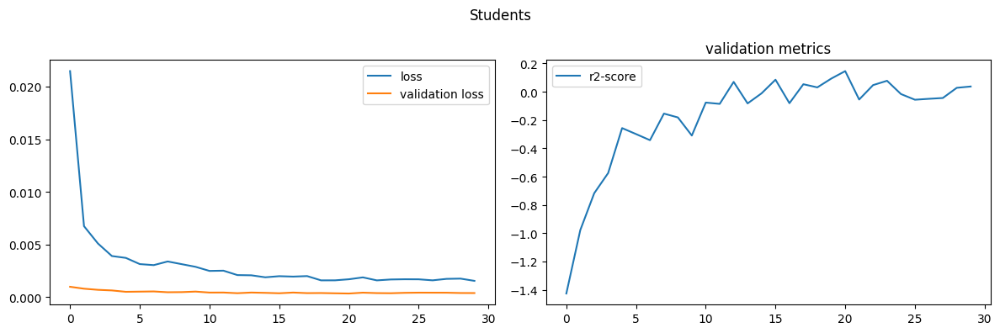

In [9]:
datasets = students_datasets

model = StudentsNN()
optimizer = optimizer_factory(model)

metrics = model_train(datasets, model, optimizer, criterion, score_outputs, 30)

model.eval()
with torch.no_grad():
    inputs, targets = datasets["test"][:]
    outputs = model(inputs)

    test_metrics = score_outputs(outputs, targets)

print(f"test: {labels}: {test_metrics}")
plot_metrics('Students', metrics, labels)

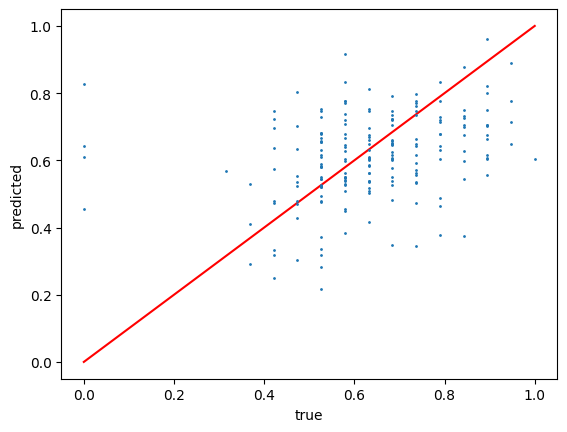

In [10]:
plt.plot([0, 1], [0, 1], c='r')
plt.plot(datasets["test"].tensors[1], outputs, '.', ms=2)
plt.xlabel("true")
plt.ylabel("predicted")
plt.show()

## DGSM

In [11]:
best_model = StudentsNN()

### input layer

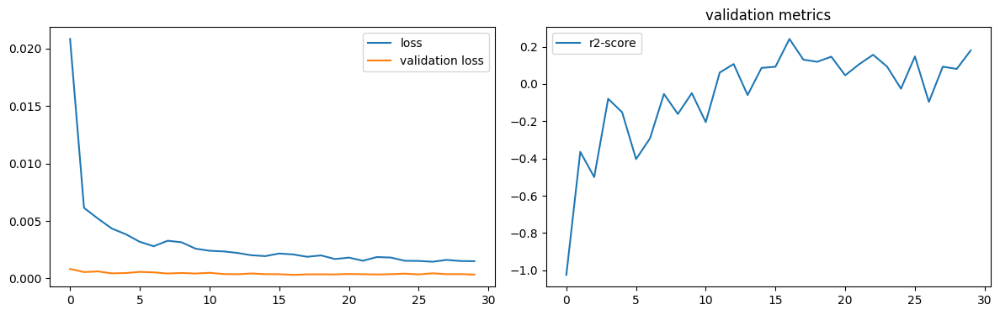

num of dropped: 0
Test: loss: 0.03081713430583477, avg metrics: (-0.10887384414672852,)
dropping feature: (17, 'paid')


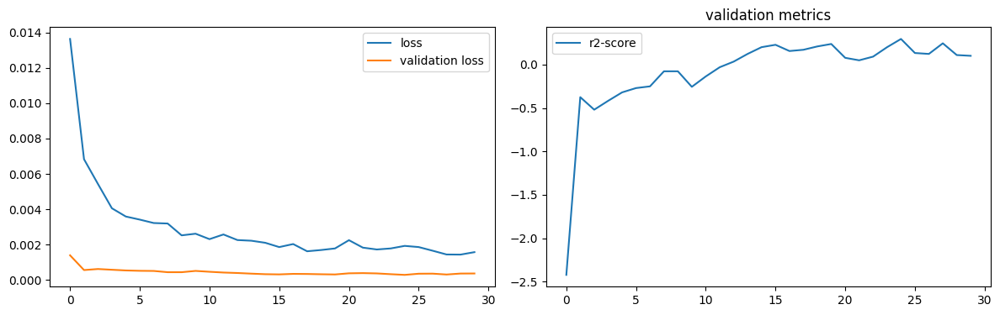

num of dropped: 1
Test: loss: 0.030905626714229584, avg metrics: (-0.06127231121063233,)
dropping feature: (20, 'internet')


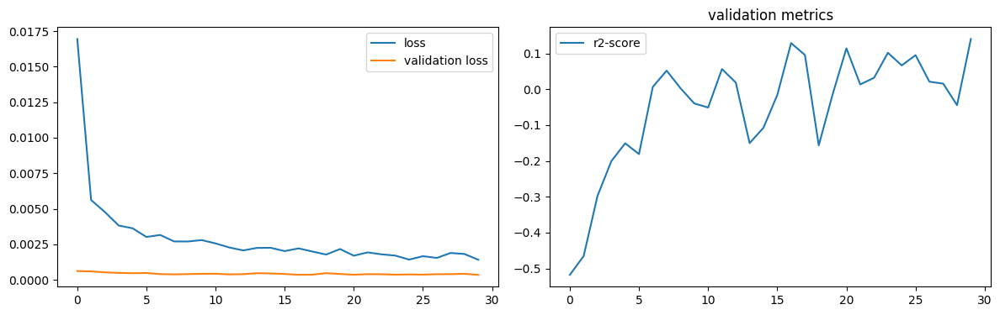

num of dropped: 2
Test: loss: 0.033593468368053436, avg metrics: (-0.07850812673568726,)
dropping feature: (12, 'traveltime')


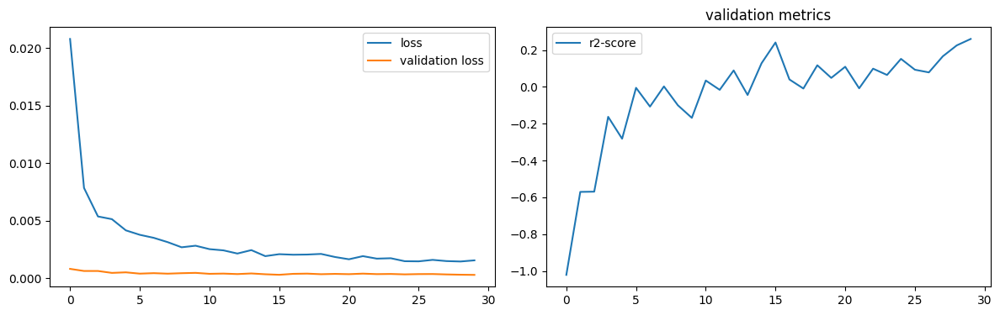

num of dropped: 3
Test: loss: 0.03381653502583504, avg metrics: (-0.18086640834808348,)
dropping feature: (20, 'famrel')


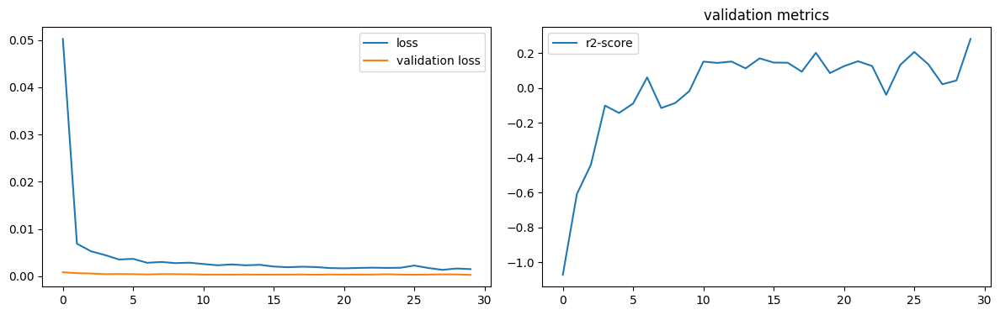

num of dropped: 4
Test: loss: 0.029693741351366043, avg metrics: (-0.05988236665725708,)
dropping feature: (11, 'guardian')


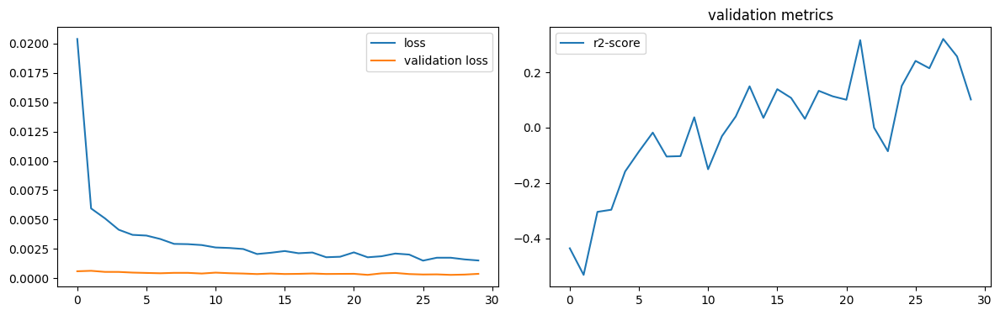

num of dropped: 5
Test: loss: 0.02703460119664669, avg metrics: (-0.0817372441291809,)
dropping feature: (16, 'nursery')


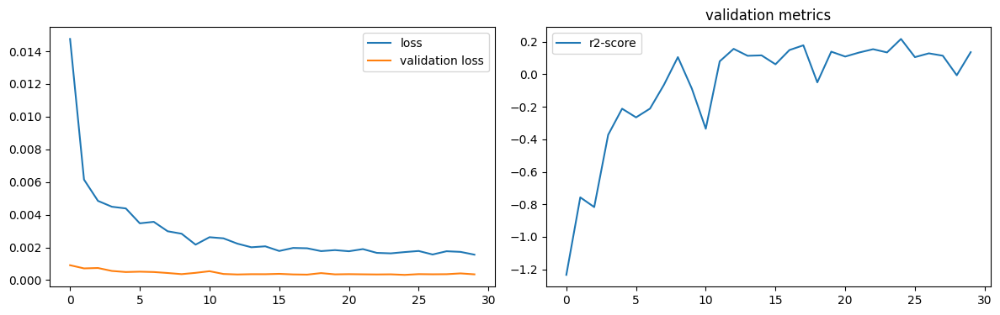

num of dropped: 6
Test: loss: 0.026651034131646156, avg metrics: (-0.009827184677124023,)
dropping feature: (18, 'freetime')


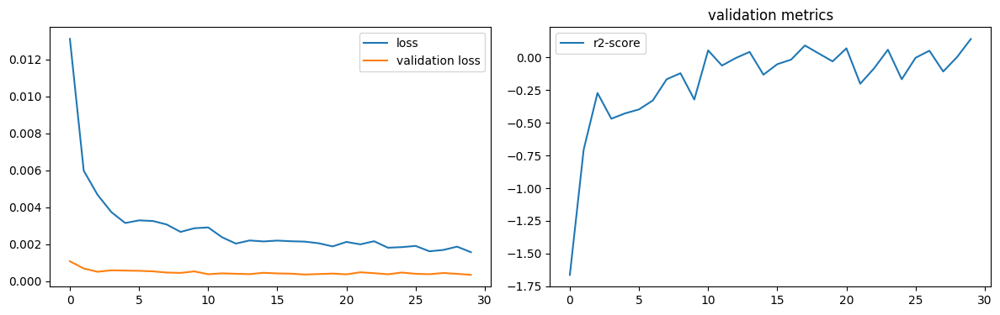

num of dropped: 7
Test: loss: 0.0264652781188488, avg metrics: (-0.07796446084976197,)
dropping feature: (15, 'activities')


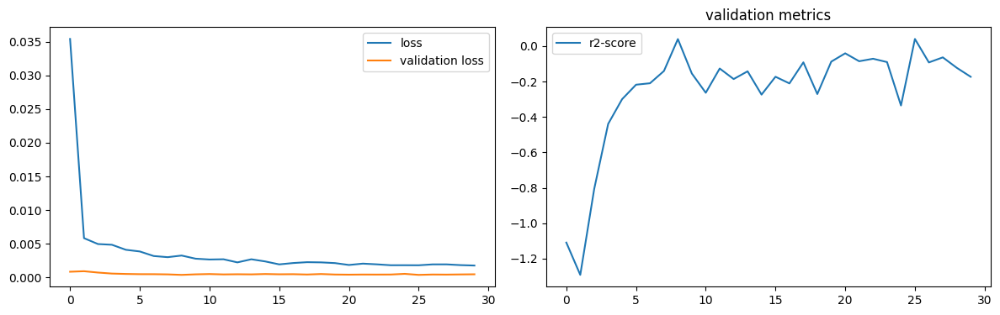

num of dropped: 8
Test: loss: 0.03144143149256706, avg metrics: (-0.05391967296600342,)
dropping feature: (4, 'famsize')


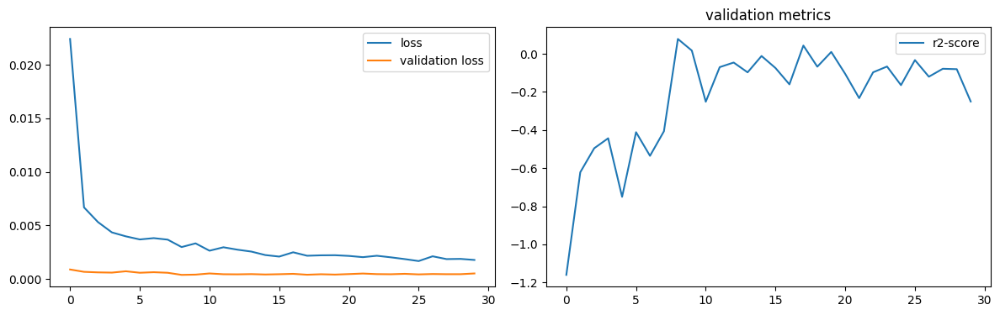

num of dropped: 9
Test: loss: 0.028518589213490486, avg metrics: (-0.04449622631072998,)
dropping feature: (4, 'Pstatus')


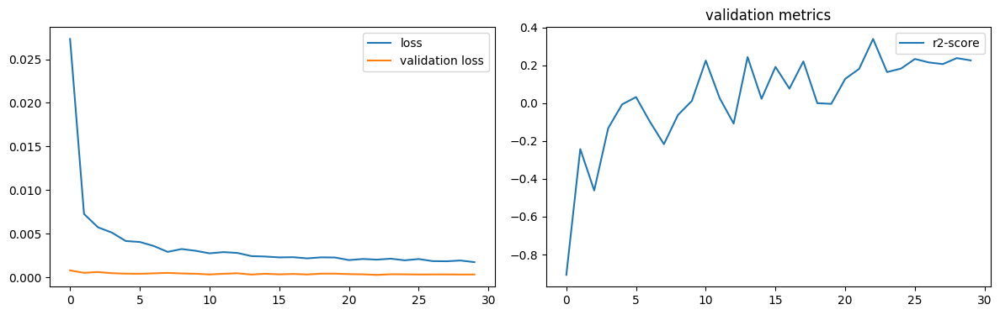

num of dropped: 10
Test: loss: 0.025167129933834076, avg metrics: (-0.07054725885391236,)
dropping feature: (2, 'age')


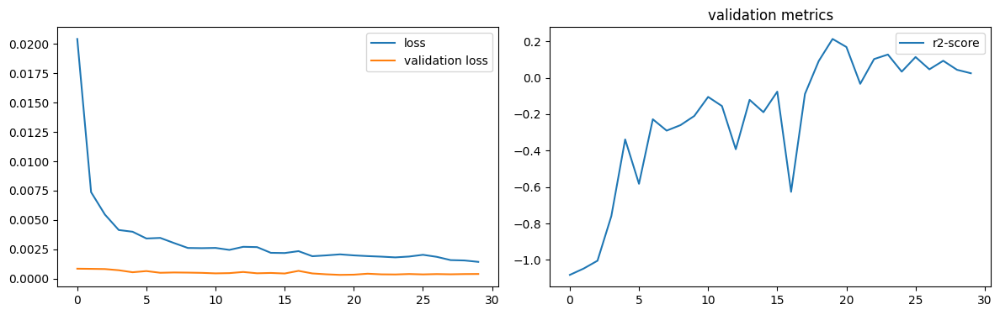

num of dropped: 11
Test: loss: 0.023360412567853928, avg metrics: (-0.030827975273132323,)
dropping feature: (8, 'studytime')


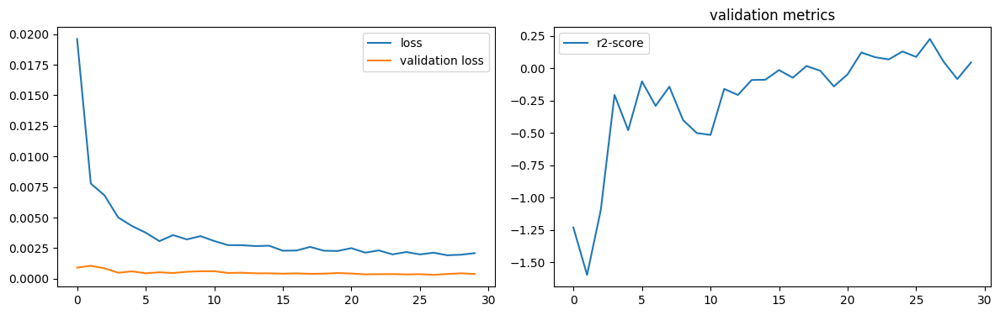

num of dropped: 12
Test: loss: 0.031149135902523994, avg metrics: (0.0071680545806884766,)
dropping feature: (11, 'higher')


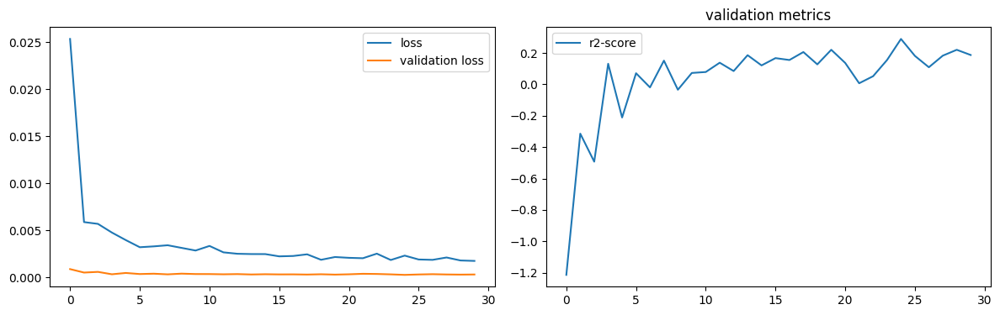

num of dropped: 13
Test: loss: 0.02530863881111145, avg metrics: (-0.053162550926208495,)
dropping feature: (4, 'Fedu')


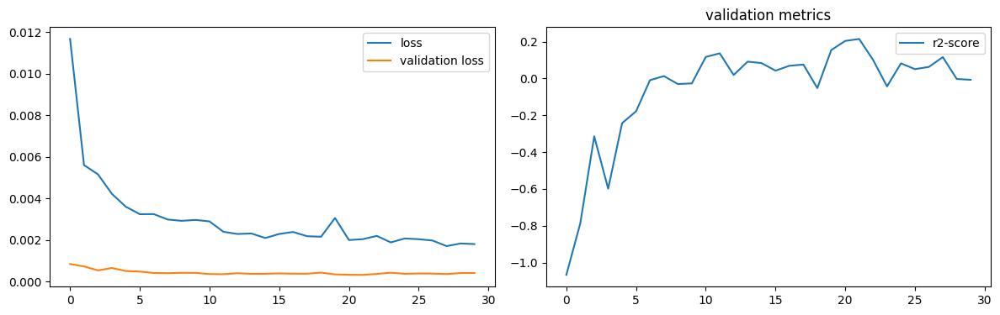

num of dropped: 14
Test: loss: 0.026817115023732185, avg metrics: (-0.04297416210174561,)
dropping feature: (4, 'Mjob')


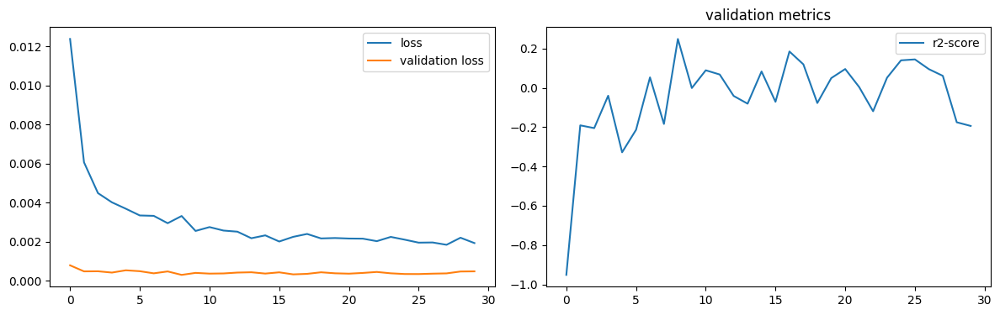

num of dropped: 15
Test: loss: 0.026873039081692696, avg metrics: (0.020484578609466553,)
dropping feature: (4, 'Fjob')


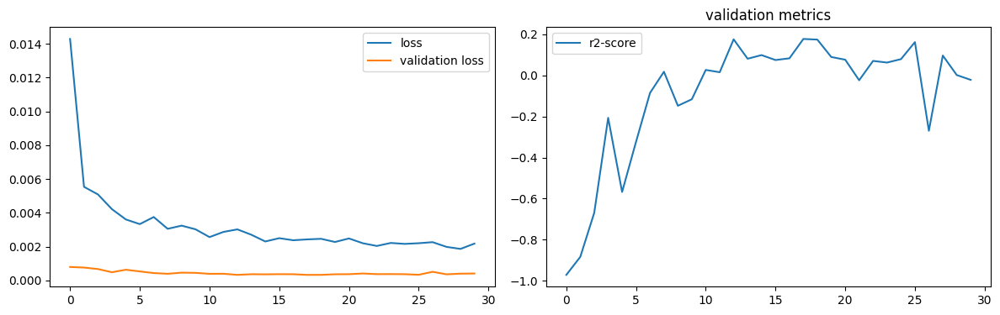

num of dropped: 16
Test: loss: 0.024729060009121895, avg metrics: (0.026141643524169922,)
dropping feature: (4, 'reason')


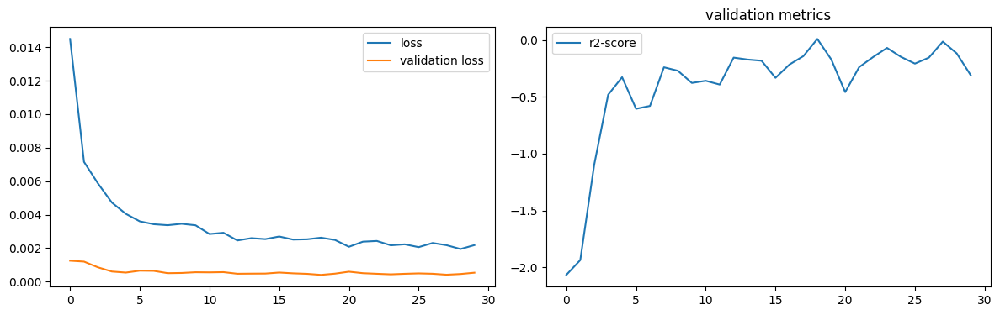

num of dropped: 17
Test: loss: 0.02820102497935295, avg metrics: (-0.026989591121673585,)
dropping feature: (11, 'health')


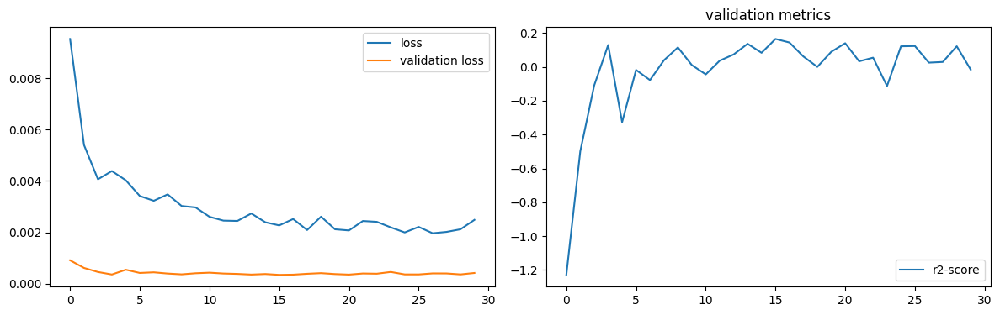

num of dropped: 18
Test: loss: 0.025366734713315964, avg metrics: (-0.02718644142150879,)
dropping feature: (5, 'schoolsup')


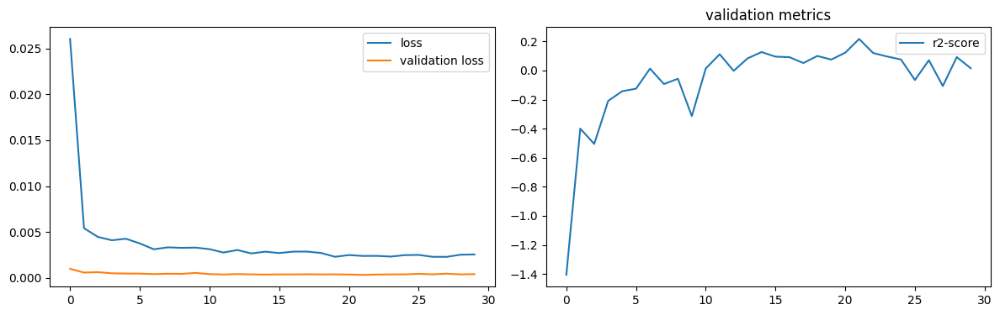

num of dropped: 19
Test: loss: 0.03319081664085388, avg metrics: (0.027664124965667725,)
dropping feature: (6, 'romantic')


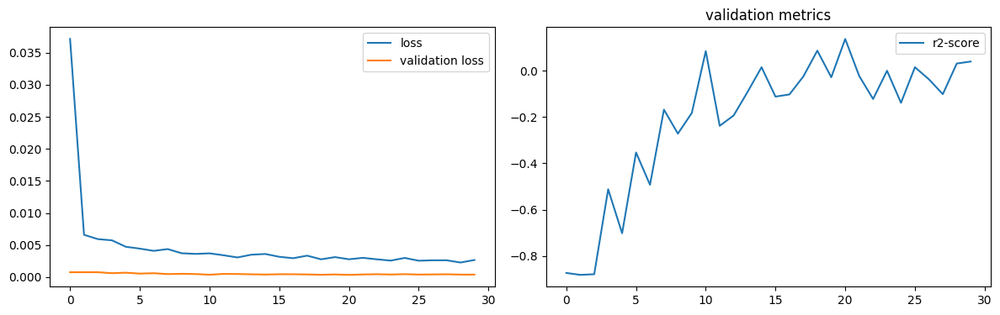

num of dropped: 20
Test: loss: 0.029729271307587624, avg metrics: (-0.004003417491912842,)
dropping feature: (7, 'Dalc')


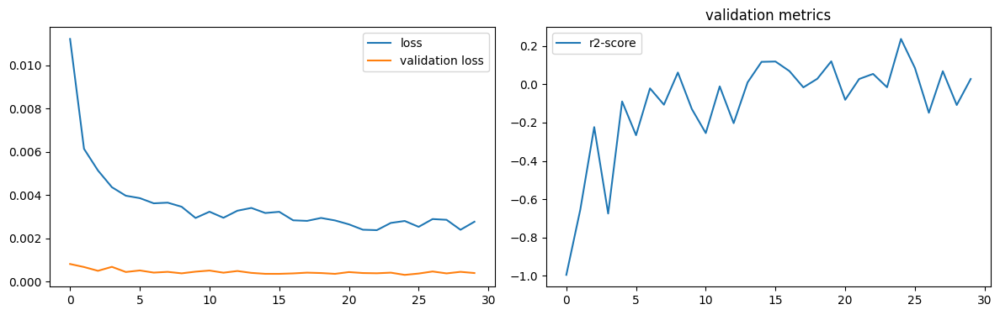

num of dropped: 21
Test: loss: 0.028240010142326355, avg metrics: (0.06587733030319214,)
dropping feature: (2, 'address')


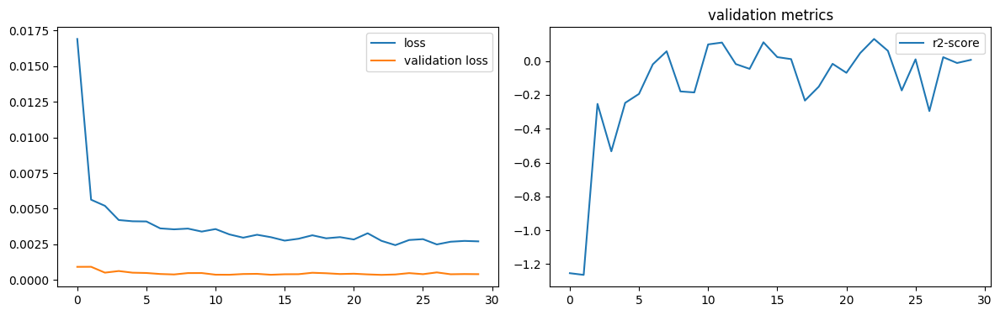

num of dropped: 22
Test: loss: 0.02458985522389412, avg metrics: (0.08412187099456787,)
dropping feature: (5, 'goout')


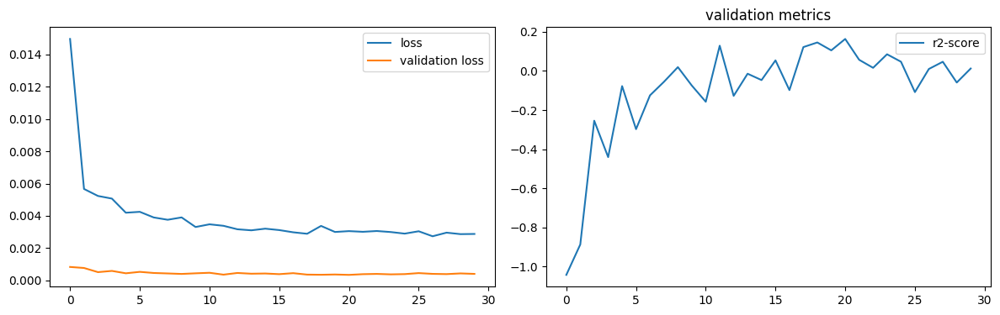

num of dropped: 23
Test: loss: 0.027725037187337875, avg metrics: (0.039767253398895266,)
dropping feature: (5, 'Walc')


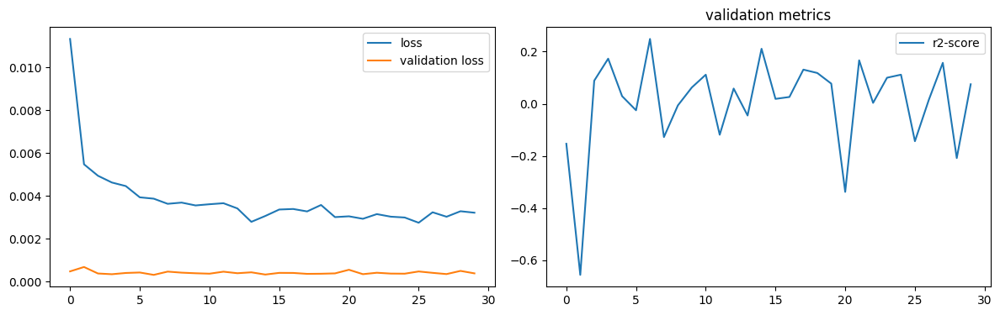

num of dropped: 24
Test: loss: 0.024189824238419533, avg metrics: (0.12930175065994262,)
dropping feature: (4, 'famsup')


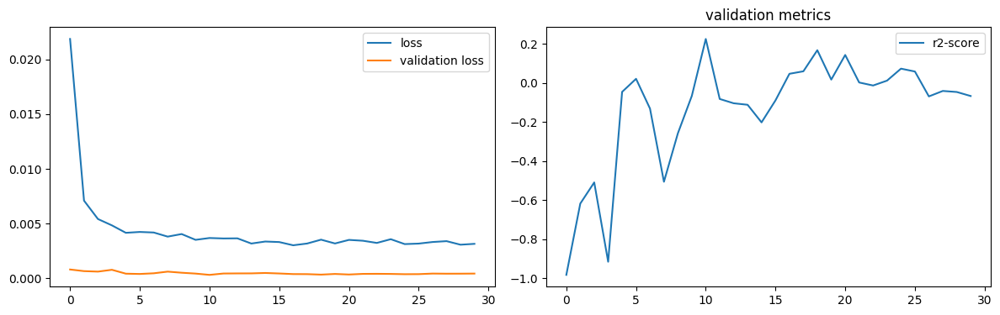

num of dropped: 25
Test: loss: 0.026847995817661285, avg metrics: (0.06709136962890624,)
dropping feature: (2, 'Medu')


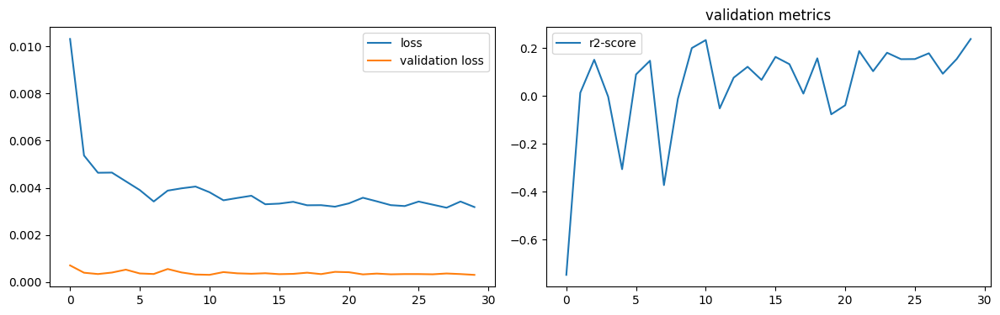

num of dropped: 26
Test: loss: 0.02325359918177128, avg metrics: (0.11958242654800415,)
dropping feature: (3, 'absences')


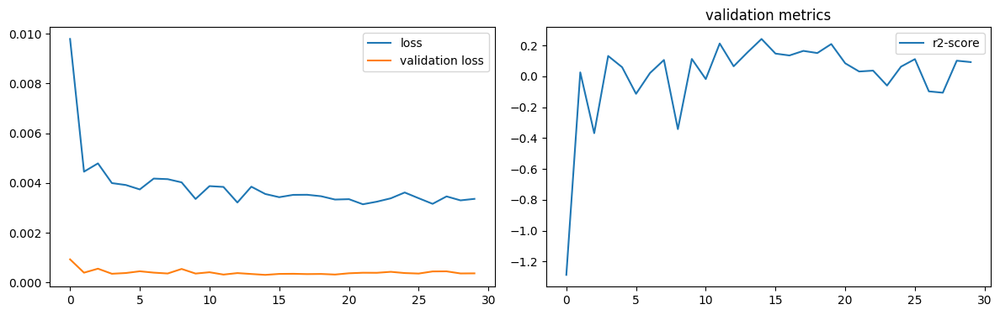

num of dropped: 27
Test: loss: 0.02367153950035572, avg metrics: (0.1487658977508545,)
dropping feature: (1, 'sex')


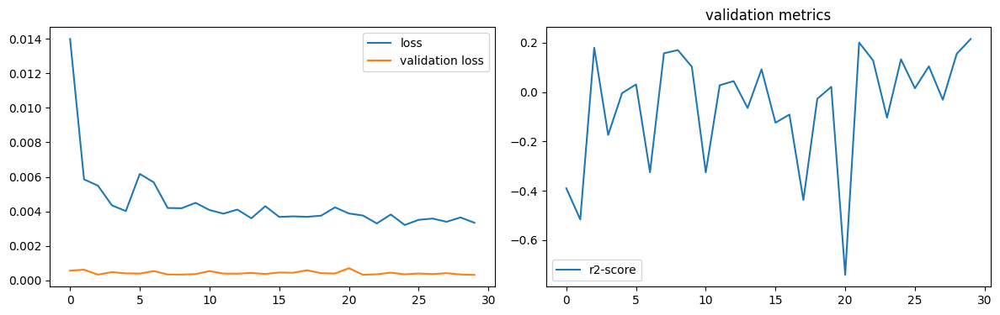

num of dropped: 28
Test: loss: 0.024972155690193176, avg metrics: (0.04458531141281128,)
dropping feature: (0, 'school')


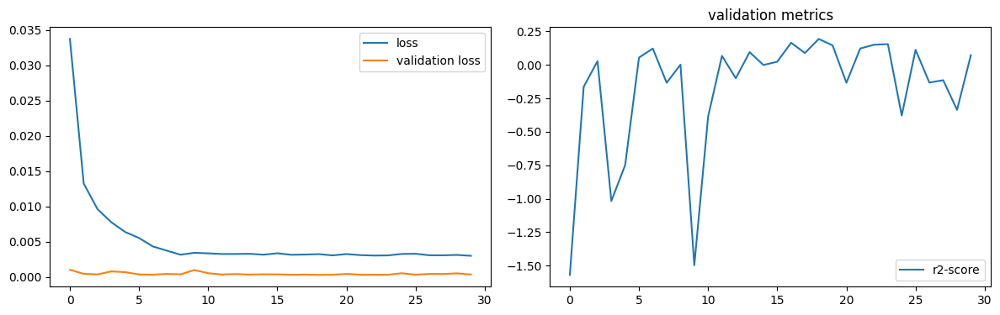

num of dropped: 29
Test: loss: 0.025201981887221336, avg metrics: (-0.8234162569046021,)


In [12]:
torch.manual_seed(2024)

datasets = students_datasets.copy()
headers = students_headers.copy()


def model_factory(size):
    return StudentsNN(size)


test_metrics, dropped, models = prune(
    datasets, headers, analyze_dgsm,
    model_factory, optimizer_factory, criterion, score_outputs, 30,
    labels, "", None
)

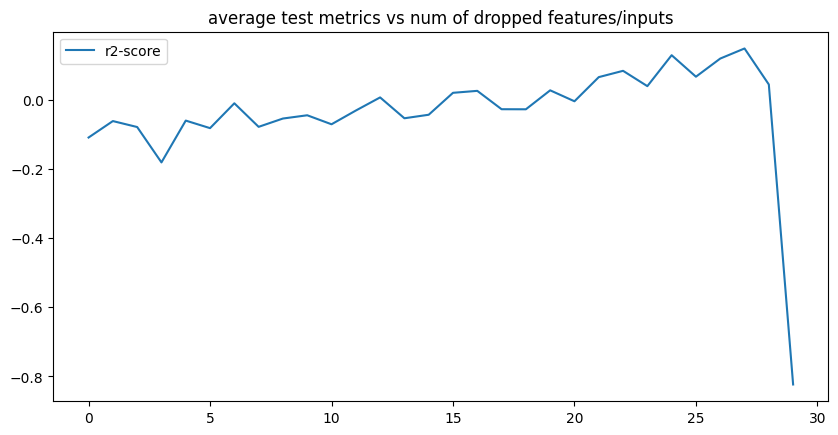

In [13]:
plot_dropping_metrics(test_metrics, labels)

In [14]:
num_drop_features = 27

save_models("students", "dgsm-layer1", models, dropped)

reduced_datasets, reduced_headers = reduce_datasets(datasets, headers, dropped, num_drop_features)
layer = models[num_drop_features].layer1

best_model.layer1 = layer

dgsm_datasets = reduced_datasets

features left [3]:  ['school', 'sex', 'failures']


### 1st hidden layer

In [15]:
layer.eval()

datasets = {
    key: TensorDataset(
        layer(dataset.tensors[0]).detach(),
        dataset.tensors[1]
    )
    for key, dataset in reduced_datasets.items()
}

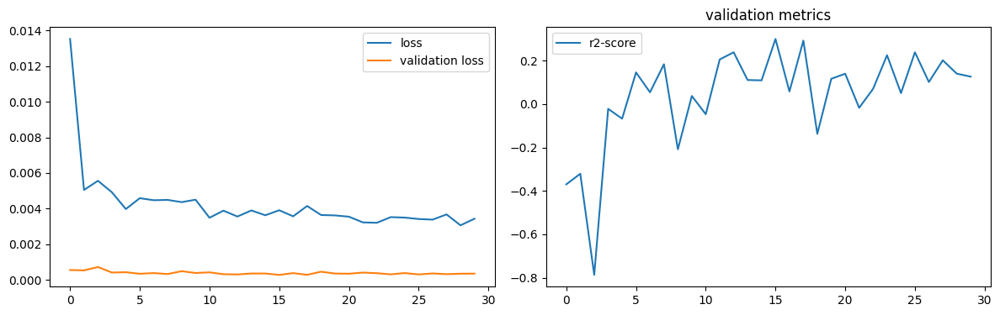

num of dropped: 0
Test: loss: 0.02614877186715603, avg metrics: (0.010687482357025147,)
dropping feature: (29, 'neuron29')


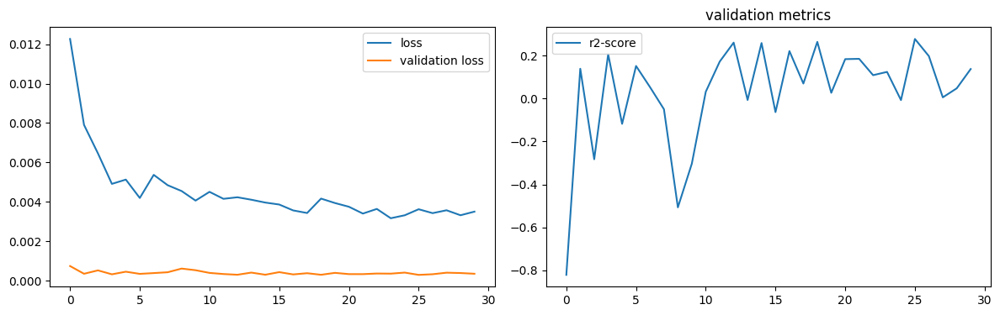

num of dropped: 1
Test: loss: 0.025041284039616585, avg metrics: (0.12361326217651367,)
dropping feature: (39, 'neuron40')


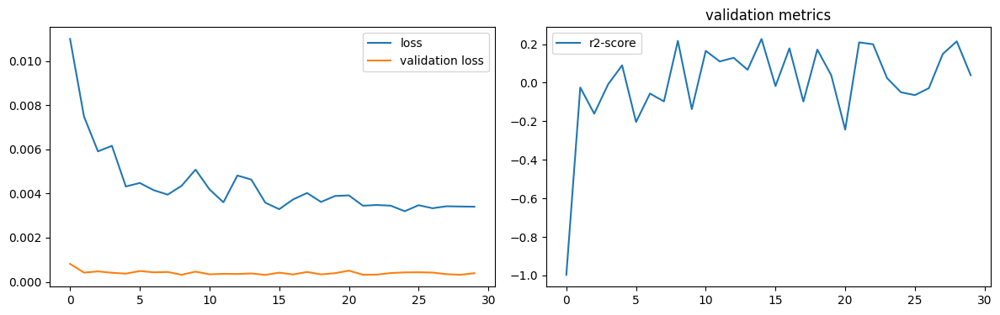

num of dropped: 2
Test: loss: 0.0249113030731678, avg metrics: (0.13585660457611085,)
dropping feature: (55, 'neuron57')


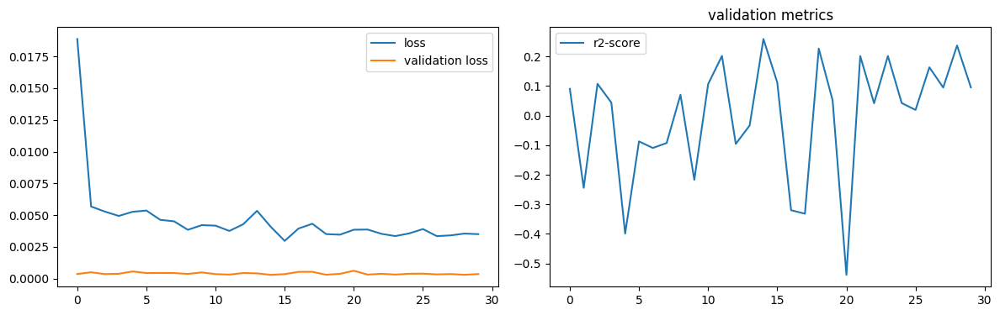

num of dropped: 3
Test: loss: 0.022632310166954994, avg metrics: (0.08131552934646606,)
dropping feature: (27, 'neuron27')


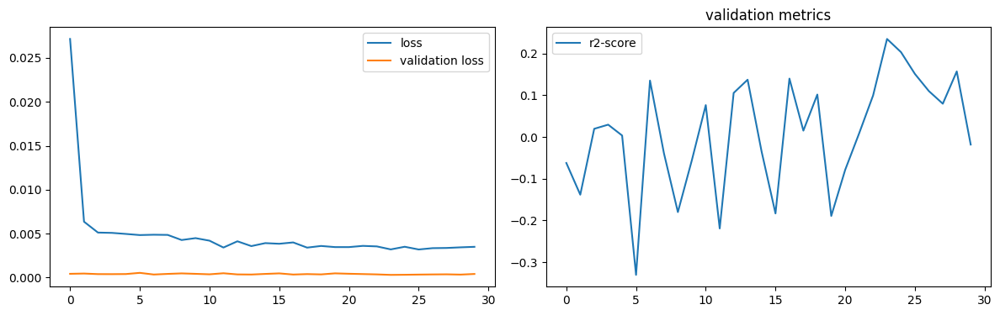

num of dropped: 4
Test: loss: 0.02554016374051571, avg metrics: (0.12833125591278077,)
dropping feature: (11, 'neuron11')


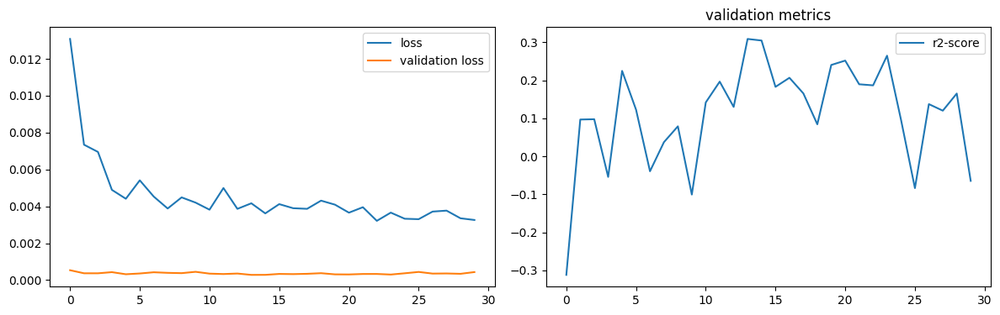

num of dropped: 5
Test: loss: 0.025865381583571434, avg metrics: (0.12788965702056884,)
dropping feature: (24, 'neuron25')


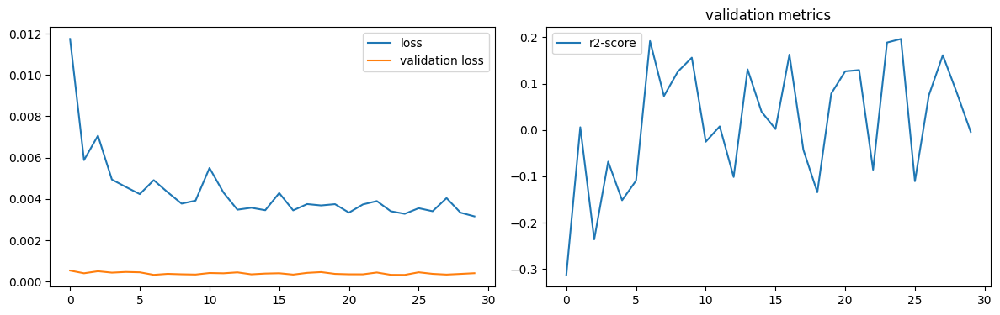

num of dropped: 6
Test: loss: 0.023564595729112625, avg metrics: (0.1648094415664673,)
dropping feature: (51, 'neuron56')


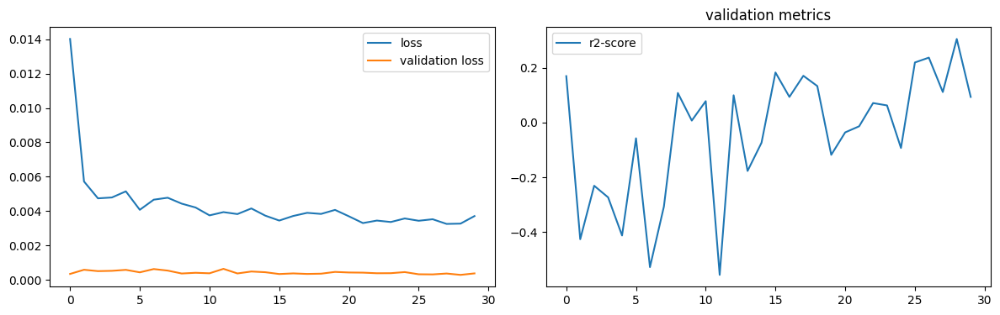

num of dropped: 7
Test: loss: 0.023198893293738365, avg metrics: (0.15513238906860352,)
dropping feature: (27, 'neuron31')


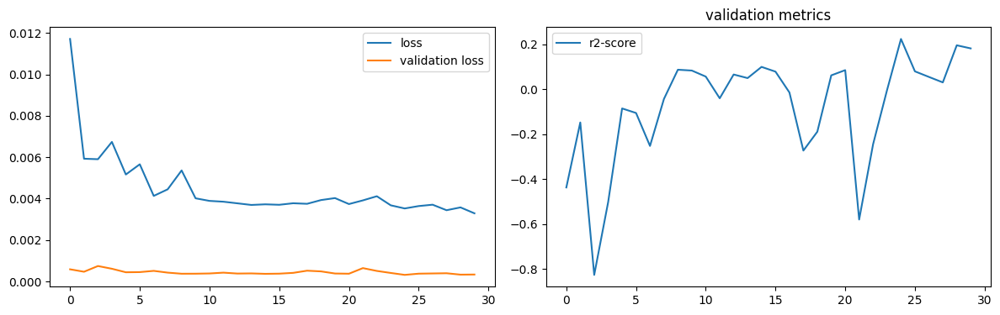

num of dropped: 8
Test: loss: 0.024616235867142677, avg metrics: (0.04359191656112671,)
dropping feature: (87, 'neuron95')


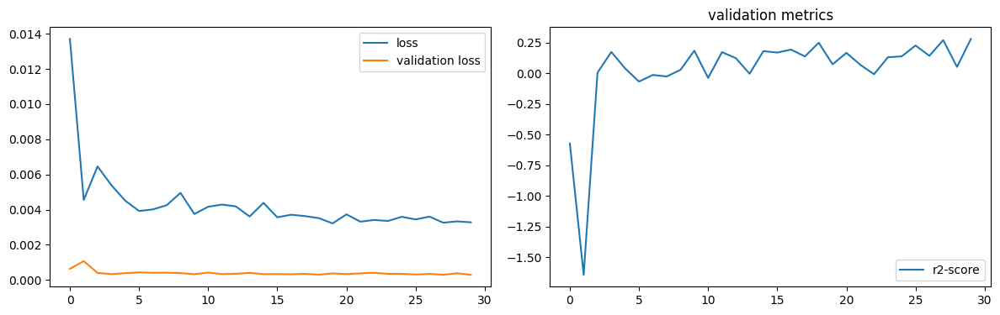

num of dropped: 9
Test: loss: 0.028661442920565605, avg metrics: (0.04712234735488892,)
dropping feature: (67, 'neuron75')


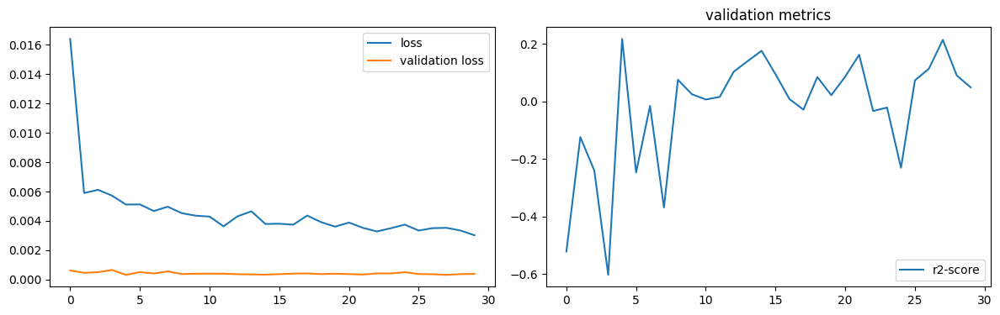

num of dropped: 10
Test: loss: 0.023450443521142006, avg metrics: (0.1552828073501587,)
dropping feature: (32, 'neuron37')


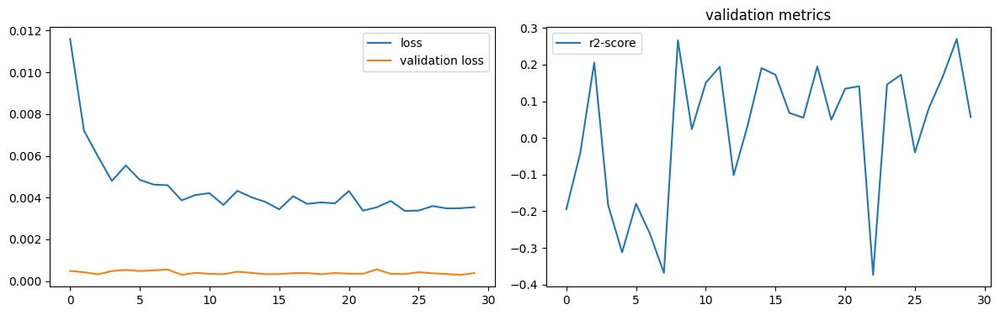

num of dropped: 11
Test: loss: 0.025203529745340347, avg metrics: (0.12612881660461425,)
dropping feature: (69, 'neuron79')


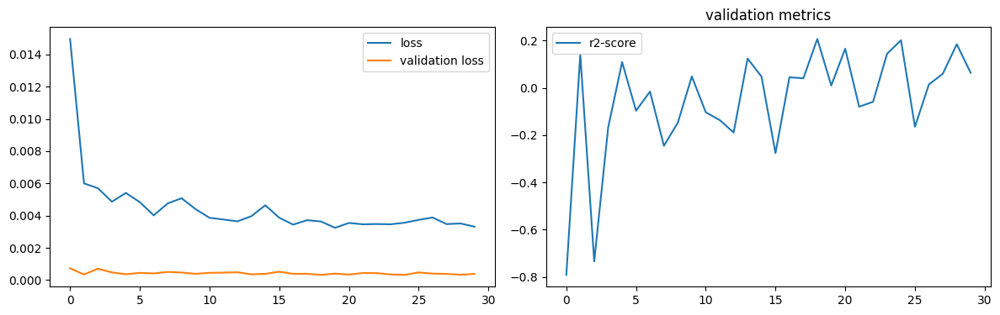

num of dropped: 12
Test: loss: 0.032619792968034744, avg metrics: (0.010114741325378419,)
dropping feature: (2, 'neuron2')


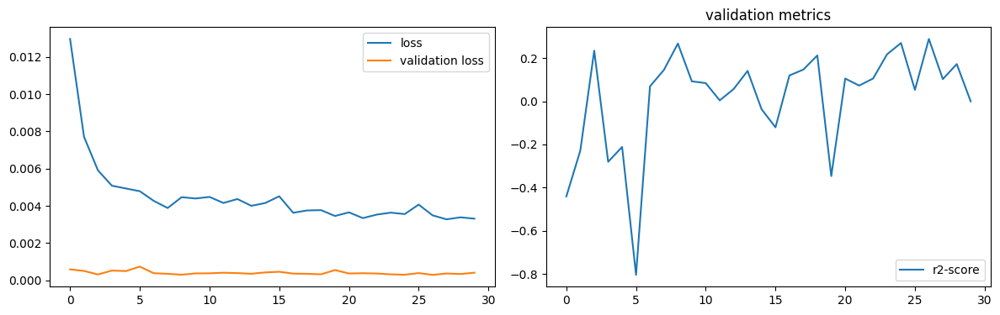

num of dropped: 13
Test: loss: 0.027091898024082184, avg metrics: (0.007182157039642334,)
dropping feature: (16, 'neuron18')


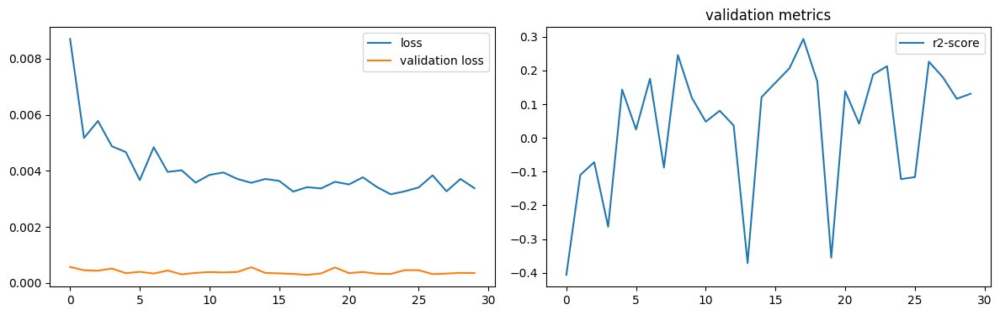

num of dropped: 14
Test: loss: 0.02241760678589344, avg metrics: (0.15237669944763182,)
dropping feature: (79, 'neuron92')


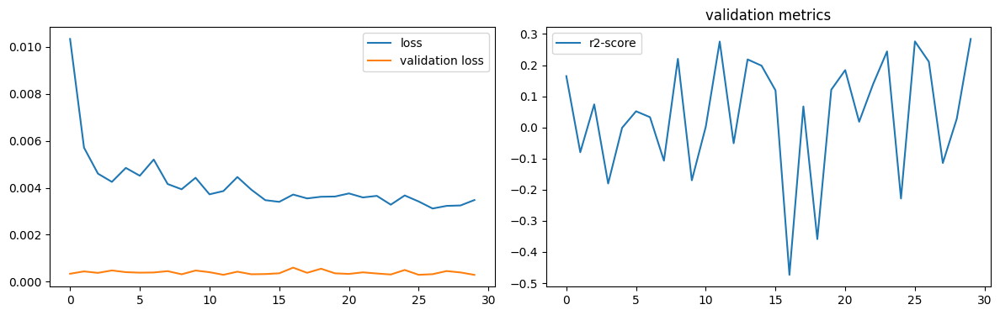

num of dropped: 15
Test: loss: 0.025612222030758858, avg metrics: (0.1225094199180603,)
dropping feature: (10, 'neuron12')


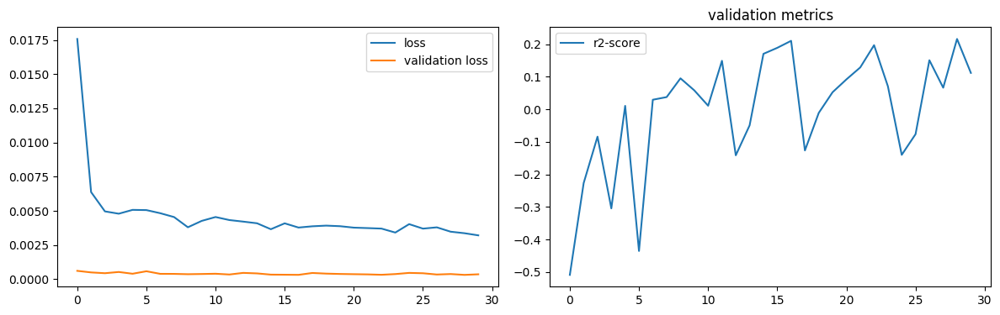

num of dropped: 16
Test: loss: 0.02676459774374962, avg metrics: (0.11333342790603637,)
dropping feature: (12, 'neuron15')


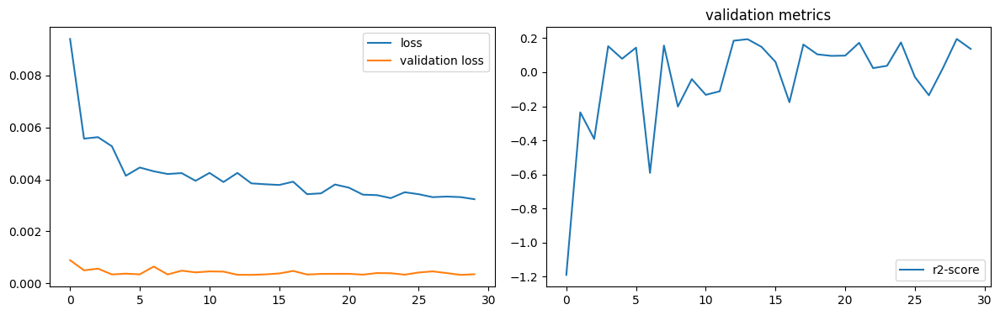

num of dropped: 17
Test: loss: 0.023779338225722313, avg metrics: (0.12694976329803467,)
dropping feature: (45, 'neuron58')


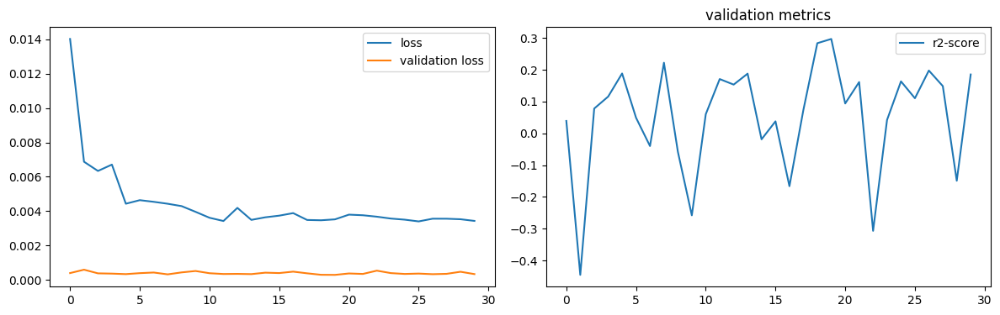

num of dropped: 18
Test: loss: 0.028933975845575333, avg metrics: (0.034663498401641846,)
dropping feature: (26, 'neuron35')


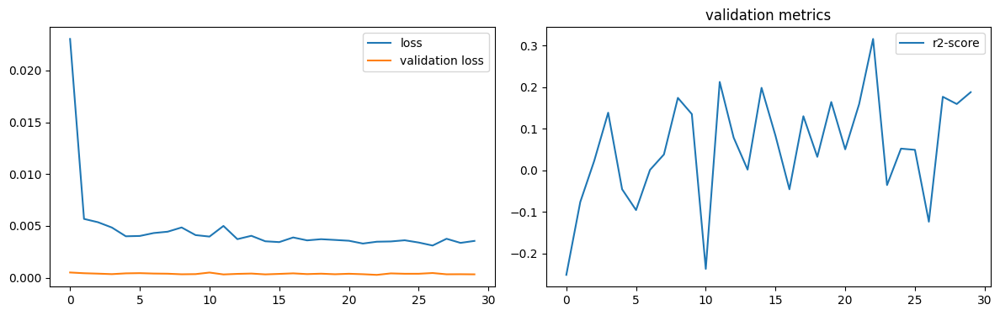

num of dropped: 19
Test: loss: 0.028698332607746124, avg metrics: (-0.06377869844436646,)
dropping feature: (31, 'neuron43')


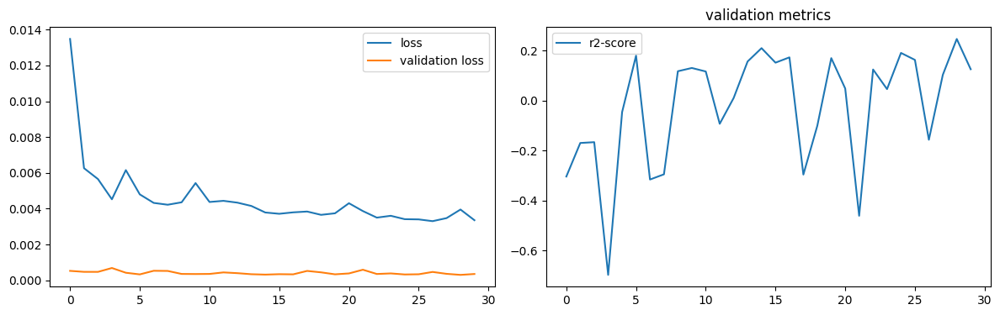

num of dropped: 20
Test: loss: 0.02324088290333748, avg metrics: (0.15239545106887817,)
dropping feature: (22, 'neuron30')


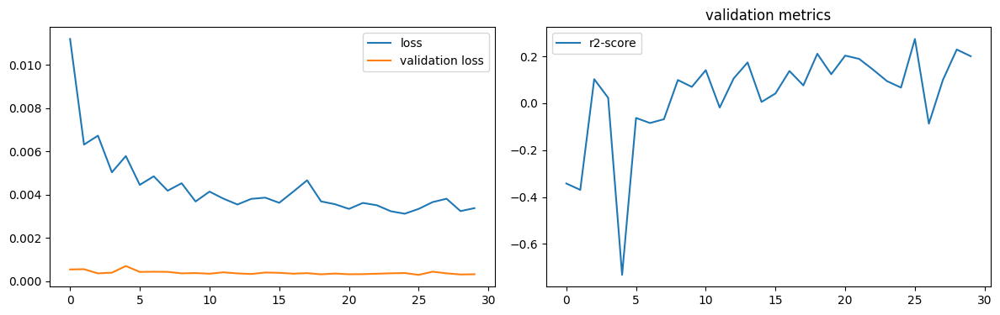

num of dropped: 21
Test: loss: 0.024448920041322708, avg metrics: (0.005157649517059326,)
dropping feature: (69, 'neuron88')


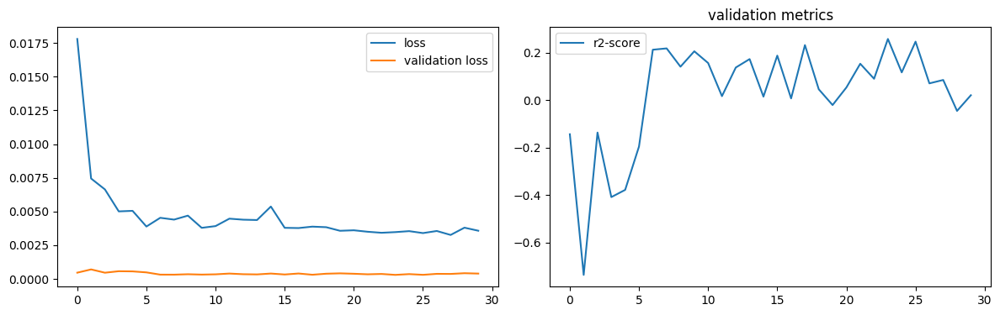

num of dropped: 22
Test: loss: 0.02464788220822811, avg metrics: (0.12952414751052857,)
dropping feature: (55, 'neuron72')


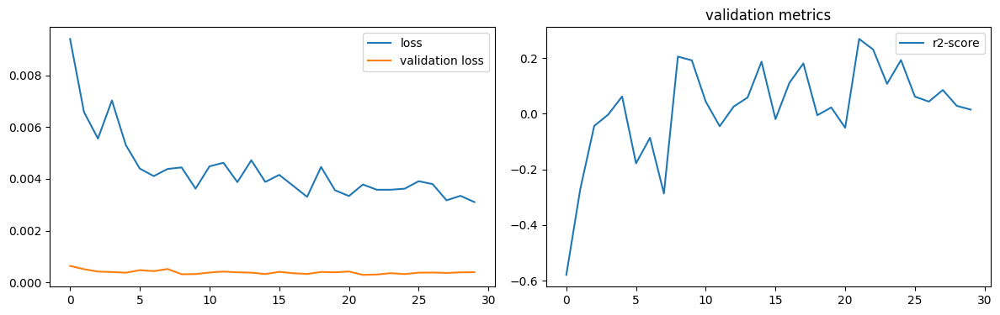

num of dropped: 23
Test: loss: 0.025100713595747948, avg metrics: (0.13617023229598998,)
dropping feature: (2, 'neuron3')


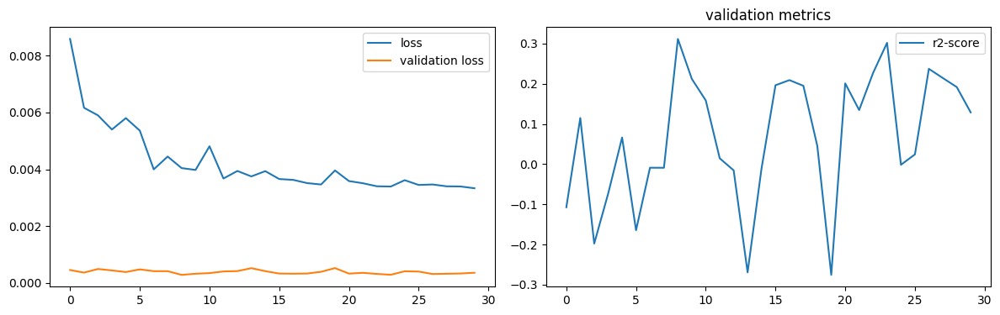

num of dropped: 24
Test: loss: 0.0286504328250885, avg metrics: (0.05369060039520264,)
dropping feature: (42, 'neuron60')


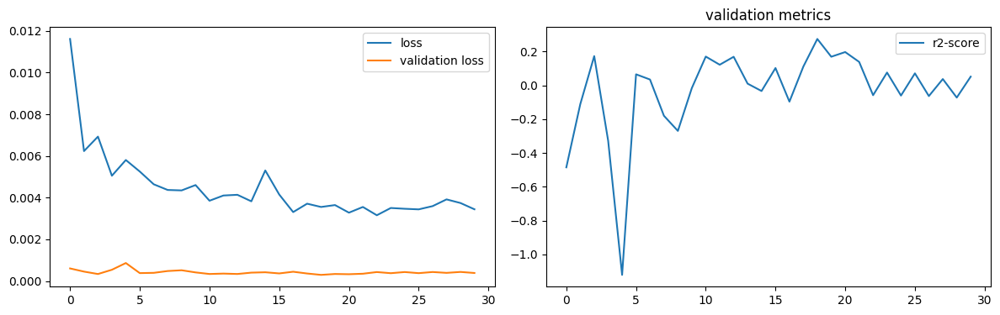

num of dropped: 25
Test: loss: 0.028985269367694855, avg metrics: (0.03690227270126343,)
dropping feature: (21, 'neuron32')


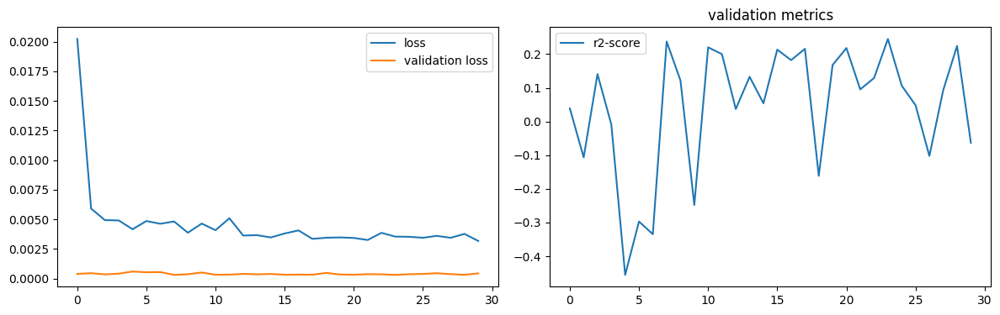

num of dropped: 26
Test: loss: 0.024988604709506035, avg metrics: (0.021381545066833495,)
dropping feature: (69, 'neuron94')


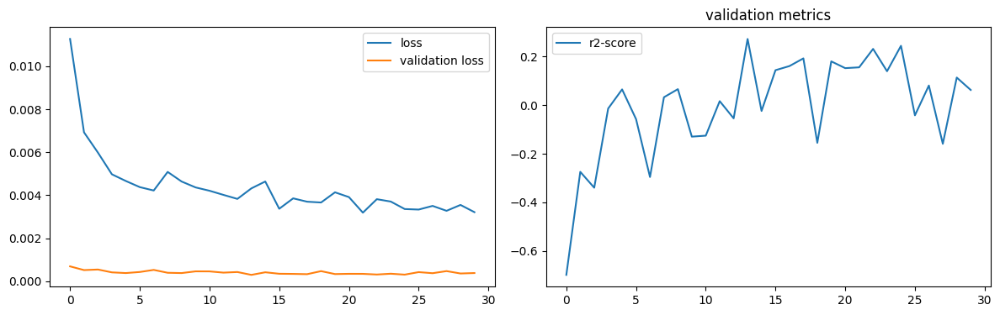

num of dropped: 27
Test: loss: 0.023992525413632393, avg metrics: (0.14310131072998047,)
dropping feature: (42, 'neuron62')


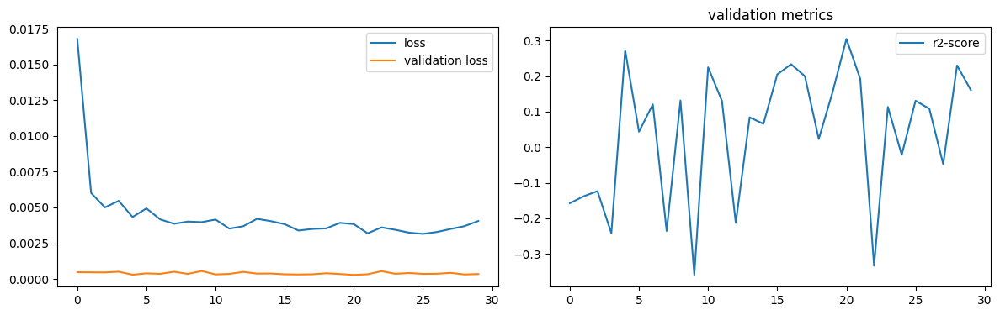

num of dropped: 28
Test: loss: 0.024161608889698982, avg metrics: (0.08808399438858032,)
dropping feature: (44, 'neuron65')


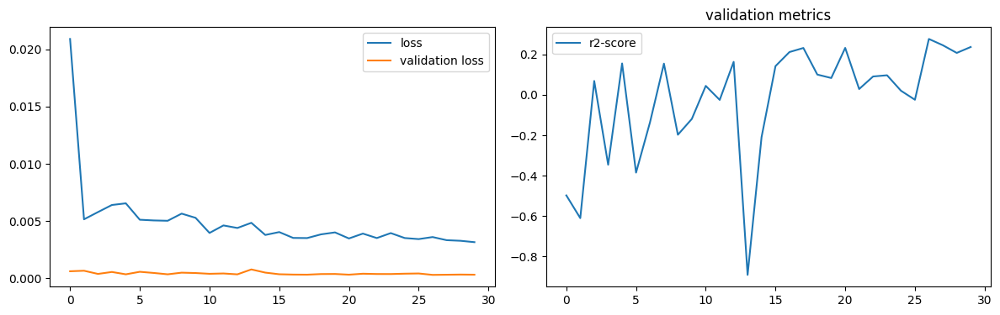

num of dropped: 29
Test: loss: 0.025054415687918663, avg metrics: (0.149292254447937,)
dropping feature: (9, 'neuron13')


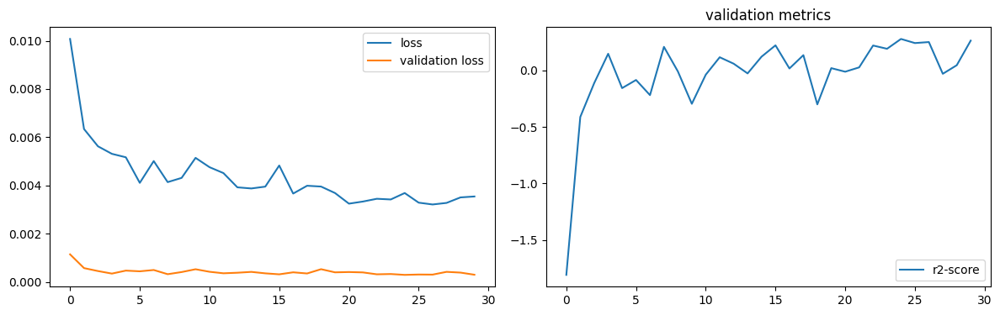

num of dropped: 30
Test: loss: 0.02699173241853714, avg metrics: (0.08534928560256957,)
dropping feature: (24, 'neuron39')


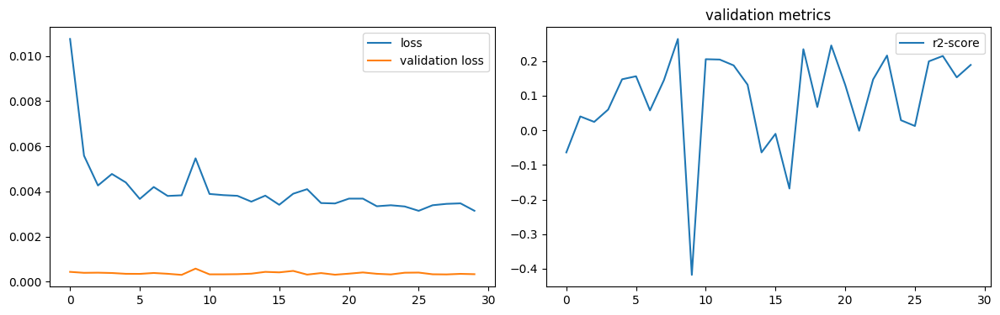

num of dropped: 31
Test: loss: 0.029309649020433426, avg metrics: (0.10205678939819336,)
dropping feature: (61, 'neuron89')


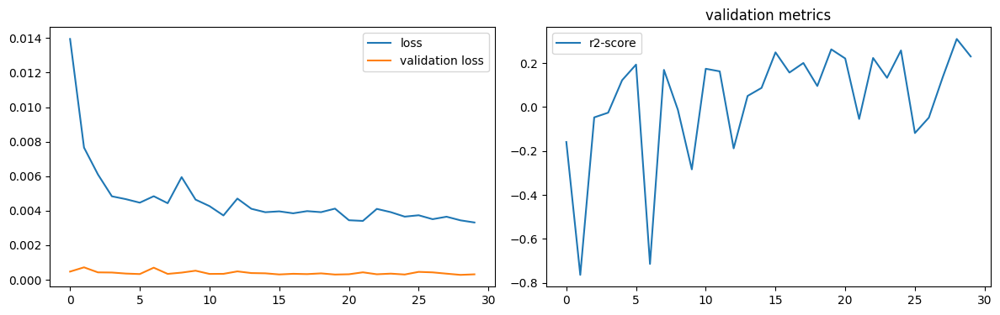

num of dropped: 32
Test: loss: 0.022956162691116333, avg metrics: (0.14750311374664307,)
dropping feature: (43, 'neuron67')


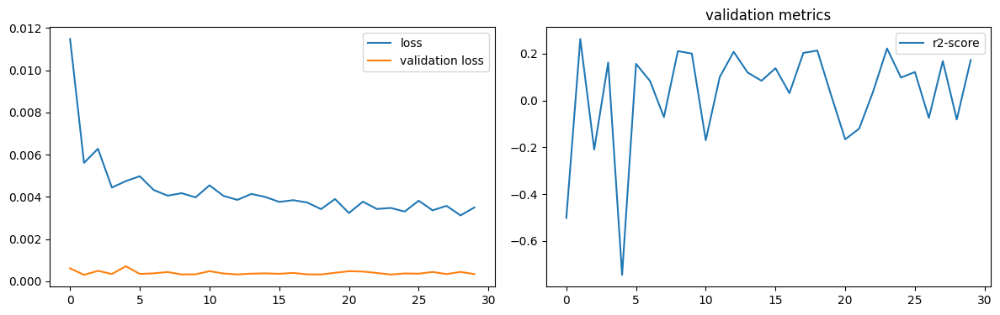

num of dropped: 33
Test: loss: 0.02244817651808262, avg metrics: (0.1651239275932312,)
dropping feature: (25, 'neuron42')


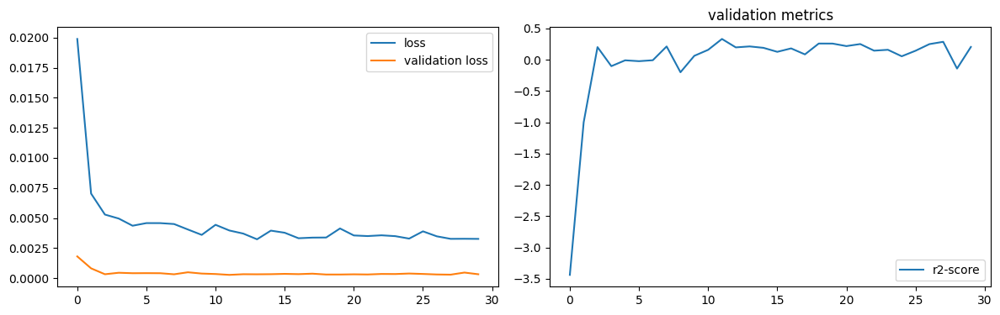

num of dropped: 34
Test: loss: 0.03061179257929325, avg metrics: (0.07597872018814086,)
dropping feature: (28, 'neuron47')


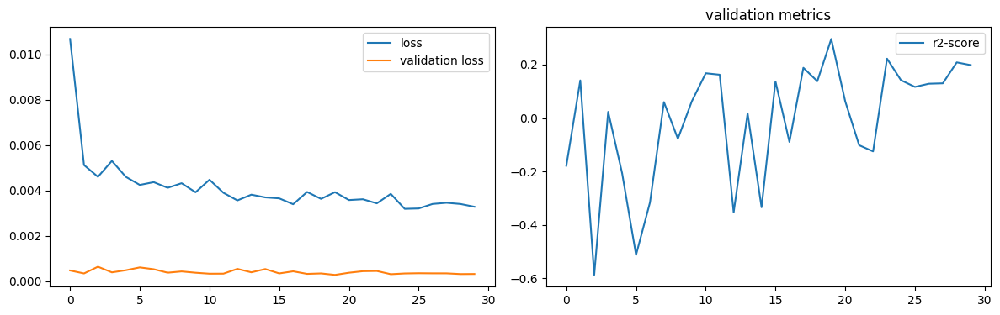

num of dropped: 35
Test: loss: 0.02444787137210369, avg metrics: (0.03679304122924805,)
dropping feature: (55, 'neuron85')


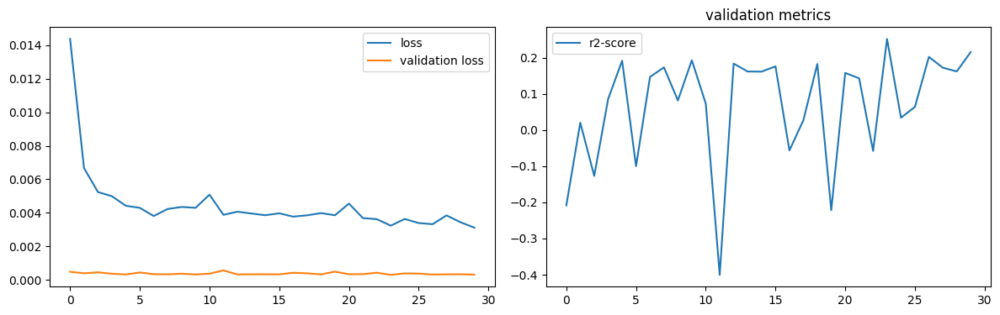

num of dropped: 36
Test: loss: 0.023690875619649887, avg metrics: (0.11901357173919677,)
dropping feature: (27, 'neuron46')


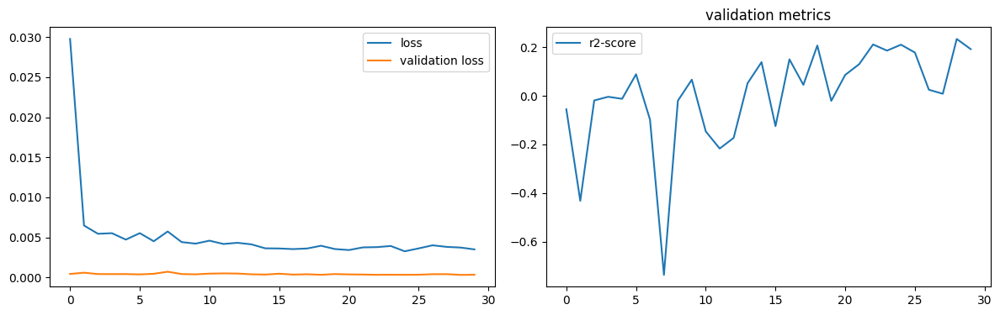

num of dropped: 37
Test: loss: 0.031349748373031616, avg metrics: (0.09787434339523315,)
dropping feature: (8, 'neuron10')


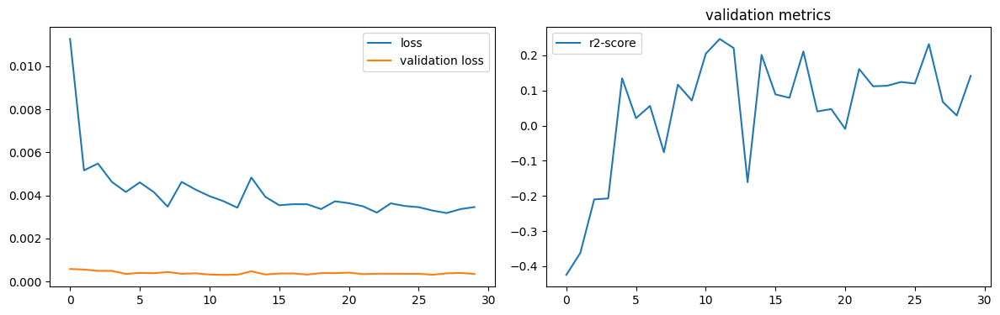

num of dropped: 38
Test: loss: 0.02348662167787552, avg metrics: (0.10640177726745606,)
dropping feature: (23, 'neuron41')


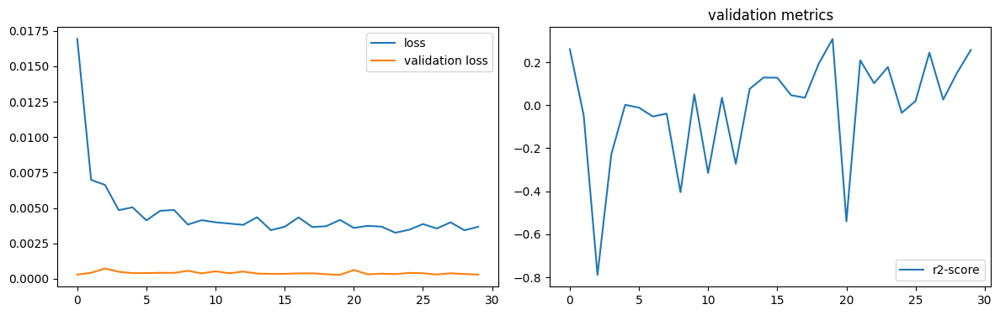

num of dropped: 39
Test: loss: 0.02574538253247738, avg metrics: (0.0014598608016967774,)
dropping feature: (8, 'neuron14')


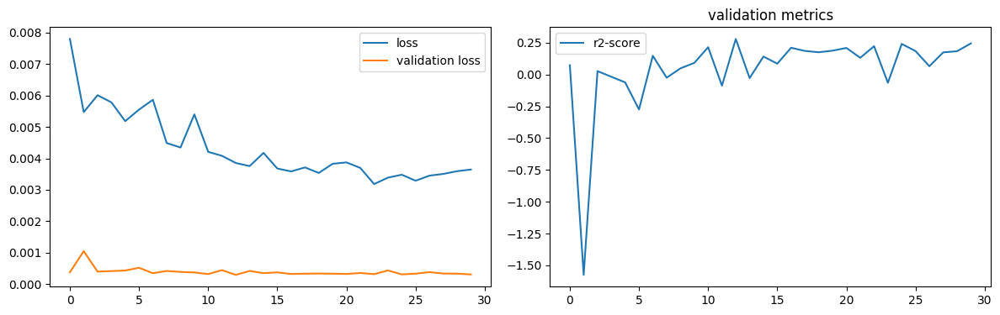

num of dropped: 40
Test: loss: 0.025580994784832, avg metrics: (0.10107918977737426,)
dropping feature: (7, 'neuron9')


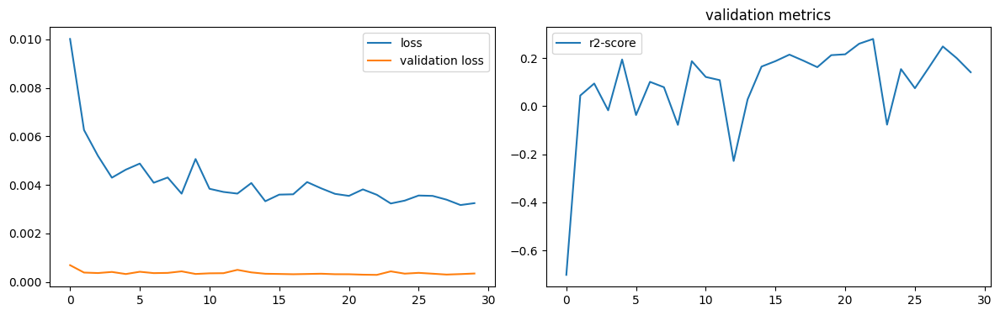

num of dropped: 41
Test: loss: 0.021862301975488663, avg metrics: (0.13104114532470704,)
dropping feature: (0, 'neuron0')


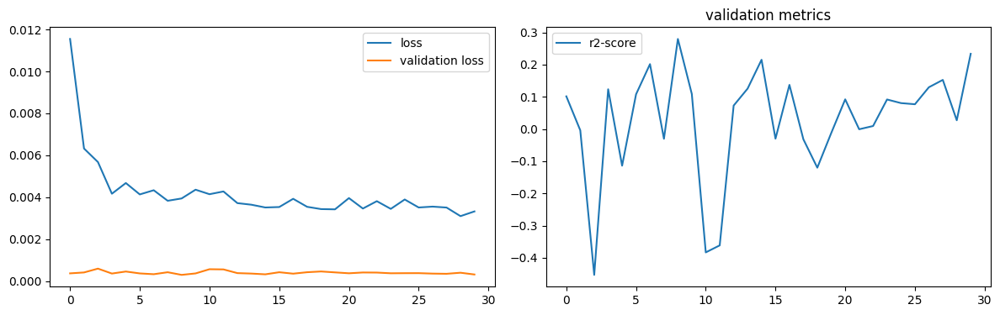

num of dropped: 42
Test: loss: 0.024262625724077225, avg metrics: (0.07157387733459472,)
dropping feature: (35, 'neuron68')


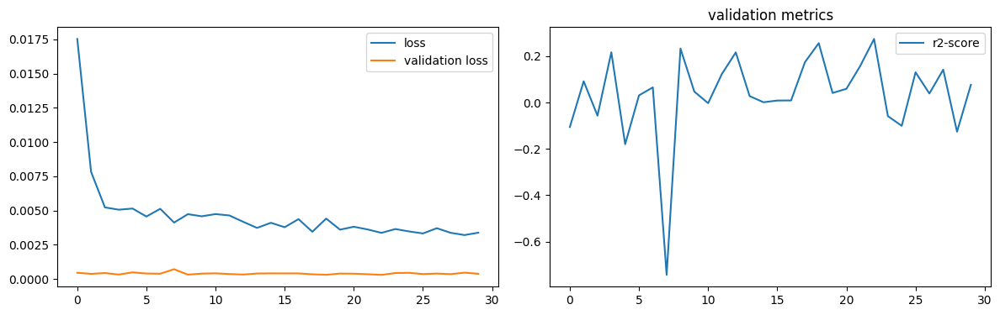

num of dropped: 43
Test: loss: 0.02498428151011467, avg metrics: (0.07251816987991333,)
dropping feature: (25, 'neuron51')


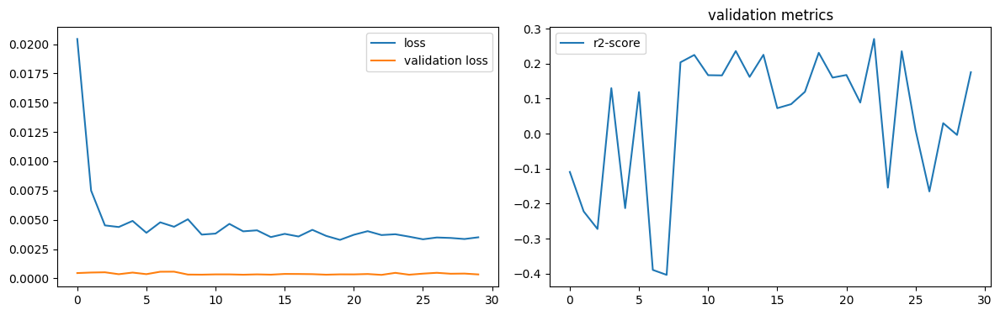

num of dropped: 44
Test: loss: 0.023717159405350685, avg metrics: (0.10240592956542968,)
dropping feature: (9, 'neuron20')


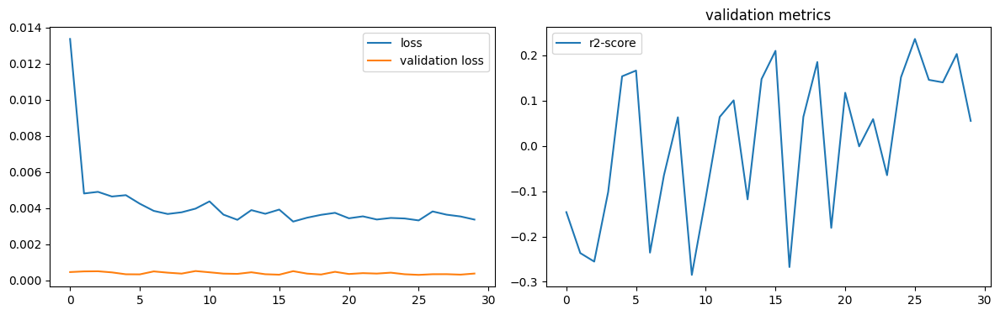

num of dropped: 45
Test: loss: 0.02817510813474655, avg metrics: (0.015520036220550537,)
dropping feature: (10, 'neuron22')


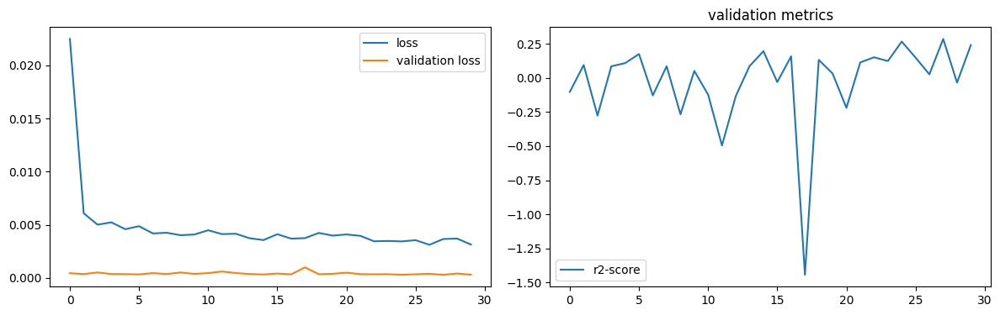

num of dropped: 46
Test: loss: 0.02408677712082863, avg metrics: (0.13114944696426392,)
dropping feature: (45, 'neuron86')


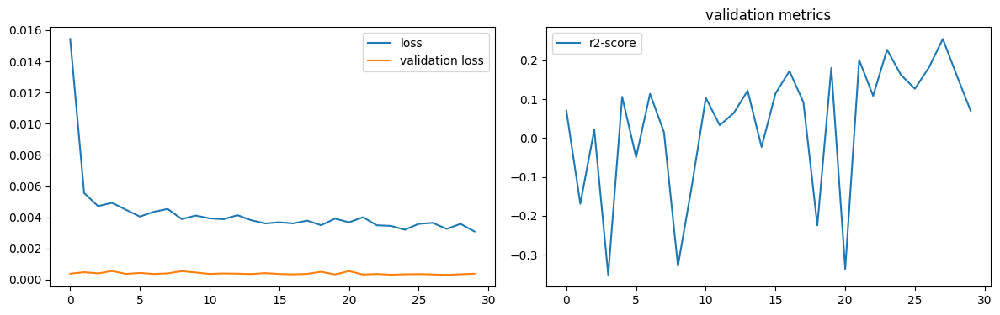

num of dropped: 47
Test: loss: 0.025644341483712196, avg metrics: (0.11783714294433593,)
dropping feature: (22, 'neuron50')


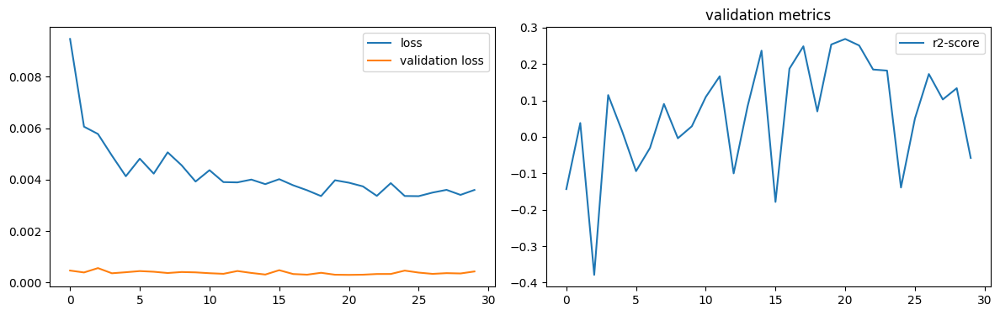

num of dropped: 48
Test: loss: 0.026300637051463127, avg metrics: (0.12470948696136475,)
dropping feature: (19, 'neuron45')


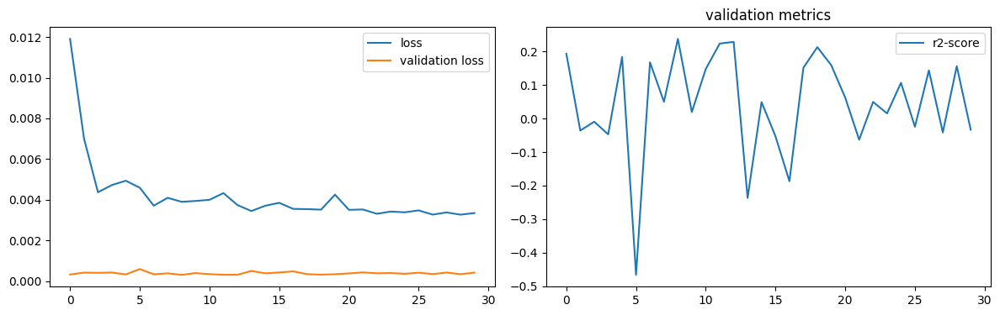

num of dropped: 49
Test: loss: 0.0266457237303257, avg metrics: (0.10697985887527466,)
dropping feature: (49, 'neuron98')


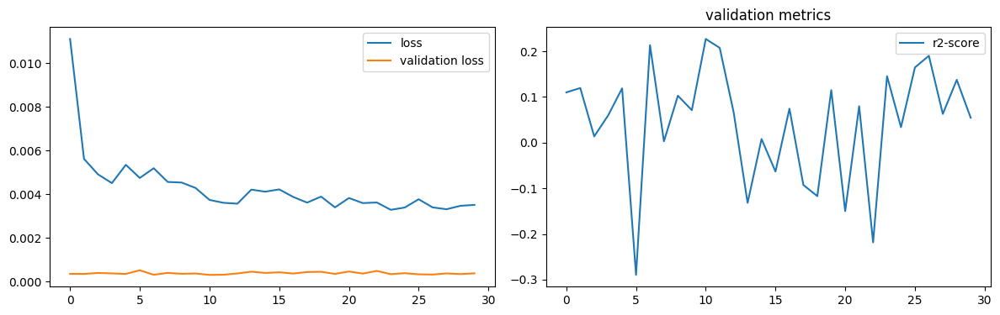

num of dropped: 50
Test: loss: 0.024323973804712296, avg metrics: (0.09935413599014283,)
dropping feature: (35, 'neuron76')


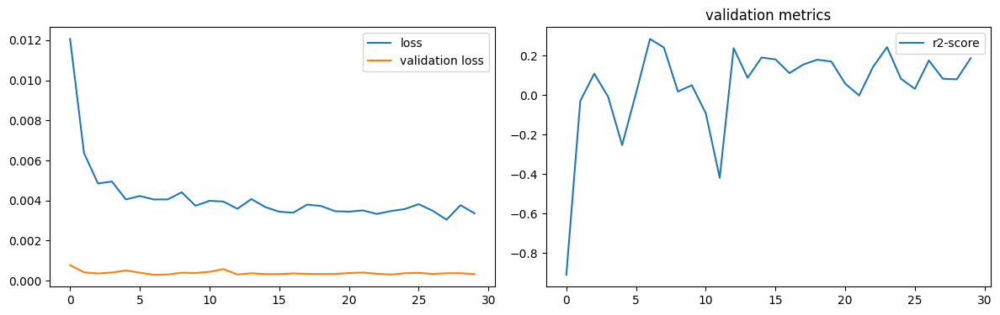

num of dropped: 51
Test: loss: 0.022531813010573387, avg metrics: (0.11240748167037964,)
dropping feature: (12, 'neuron26')


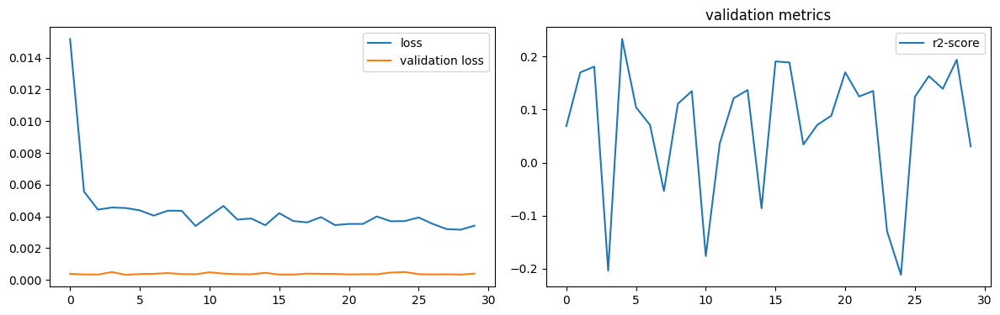

num of dropped: 52
Test: loss: 0.02225322835147381, avg metrics: (0.045858991146087644,)
dropping feature: (36, 'neuron80')


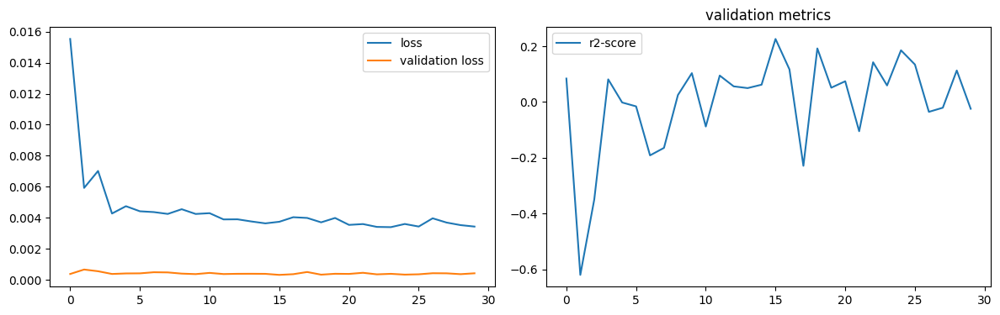

num of dropped: 53
Test: loss: 0.028227640315890312, avg metrics: (0.11722207069396973,)
dropping feature: (38, 'neuron83')


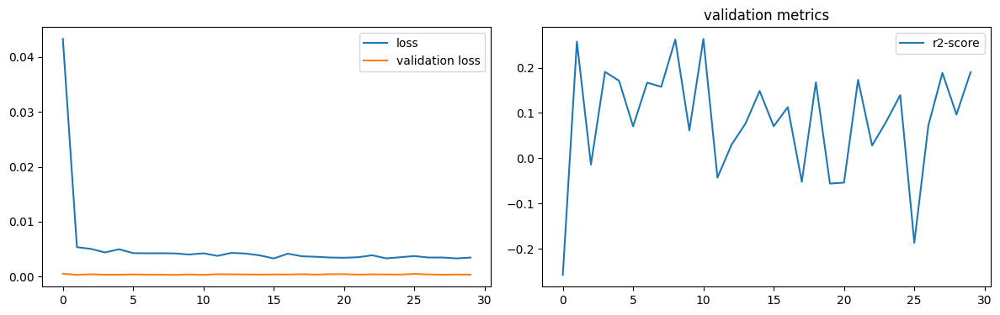

num of dropped: 54
Test: loss: 0.0229848213493824, avg metrics: (0.131145703792572,)
dropping feature: (13, 'neuron33')


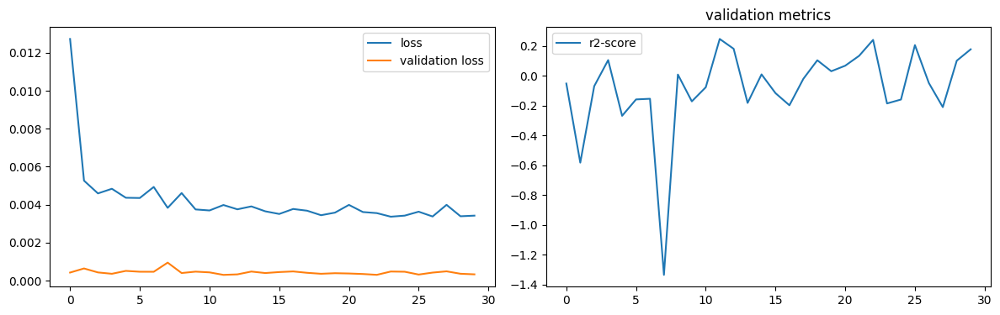

num of dropped: 55
Test: loss: 0.02497900277376175, avg metrics: (0.0896296501159668,)
dropping feature: (12, 'neuron28')


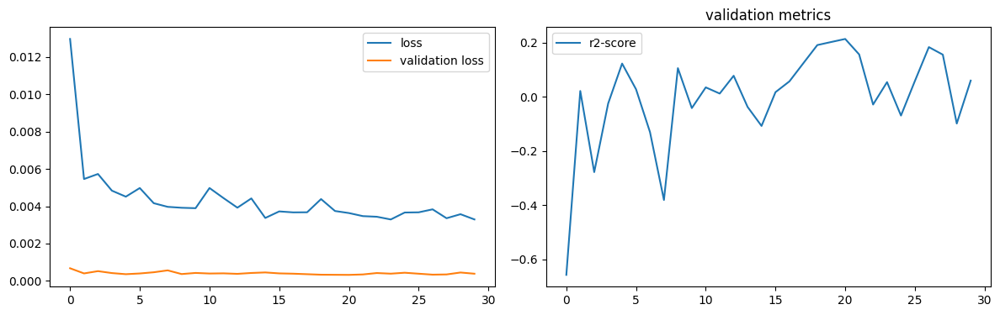

num of dropped: 56
Test: loss: 0.02965518832206726, avg metrics: (0.0670354723930359,)
dropping feature: (36, 'neuron84')


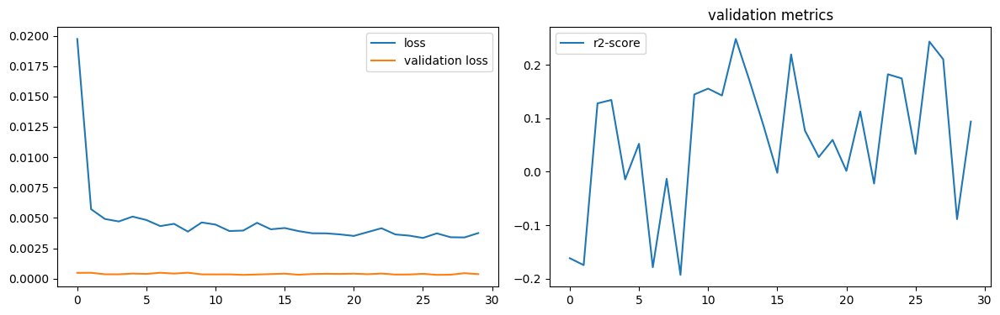

num of dropped: 57
Test: loss: 0.028132852166891098, avg metrics: (0.005691826343536377,)
dropping feature: (23, 'neuron61')


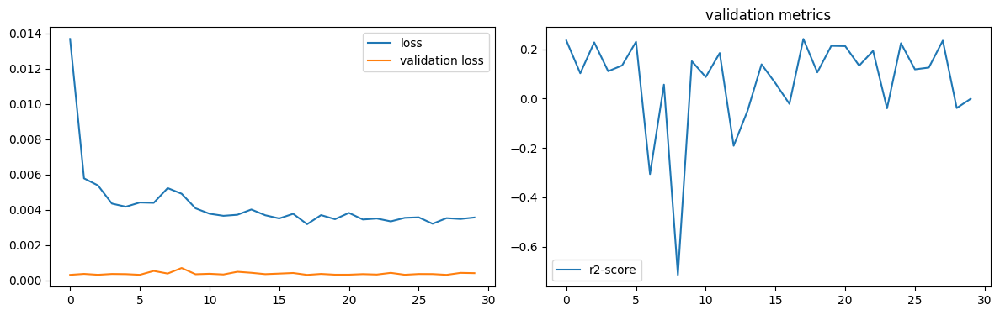

num of dropped: 58
Test: loss: 0.024999167770147324, avg metrics: (0.1356175422668457,)
dropping feature: (23, 'neuron63')


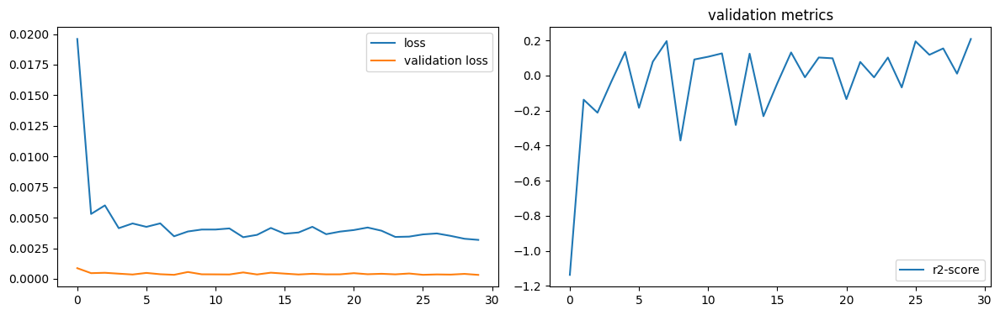

num of dropped: 59
Test: loss: 0.022217581048607826, avg metrics: (0.13959568738937378,)
dropping feature: (10, 'neuron23')


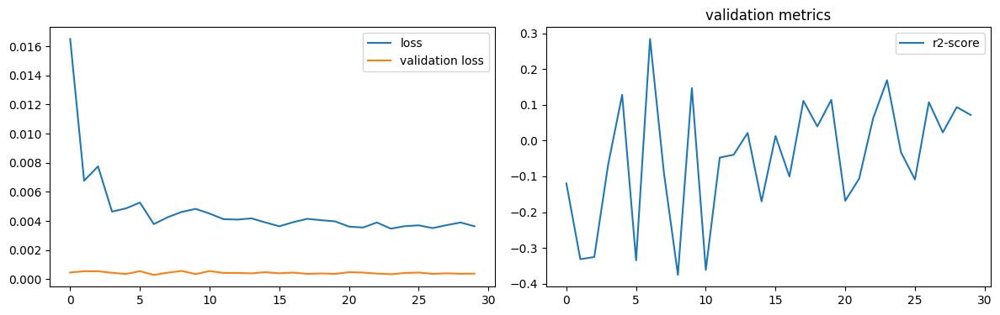

num of dropped: 60
Test: loss: 0.03459537774324417, avg metrics: (0.04419302940368652,)
dropping feature: (33, 'neuron87')


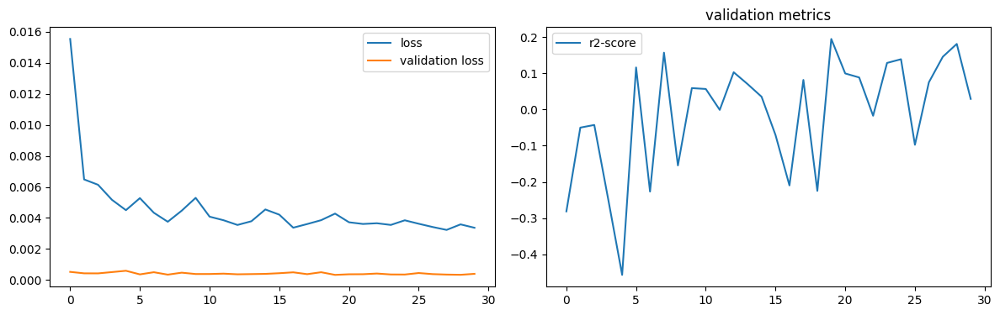

num of dropped: 61
Test: loss: 0.026443546637892723, avg metrics: (0.04701181650161743,)
dropping feature: (30, 'neuron78')


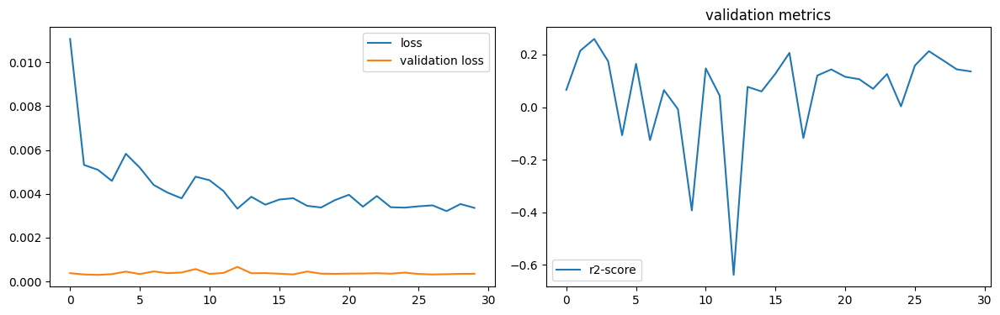

num of dropped: 62
Test: loss: 0.023447707295417786, avg metrics: (0.03992021083831787,)
dropping feature: (11, 'neuron34')


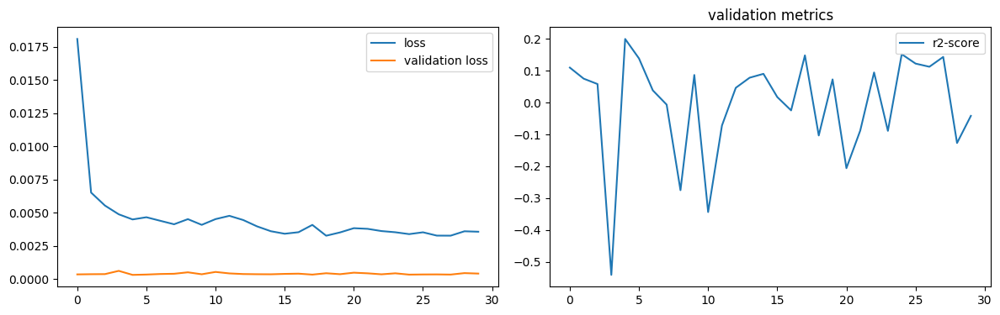

num of dropped: 63
Test: loss: 0.02423054352402687, avg metrics: (0.08503501415252686,)
dropping feature: (24, 'neuron70')


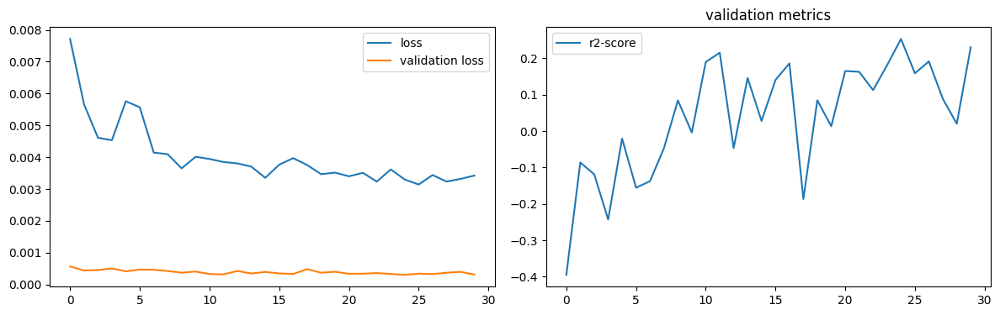

num of dropped: 64
Test: loss: 0.024601761251688004, avg metrics: (0.0752830147743225,)
dropping feature: (19, 'neuron55')


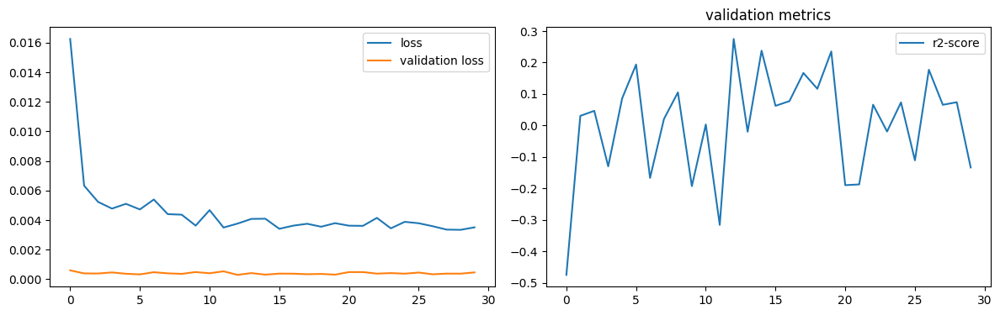

num of dropped: 65
Test: loss: 0.0251763965934515, avg metrics: (0.11215503215789795,)
dropping feature: (2, 'neuron5')


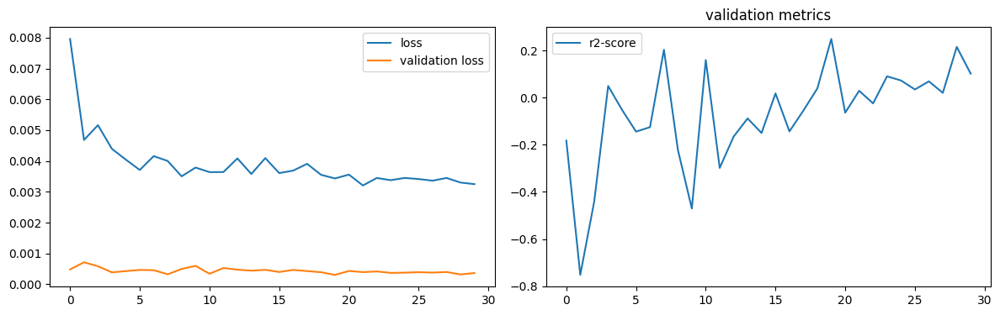

num of dropped: 66
Test: loss: 0.02793017216026783, avg metrics: (-0.07876714468002319,)
dropping feature: (27, 'neuron82')


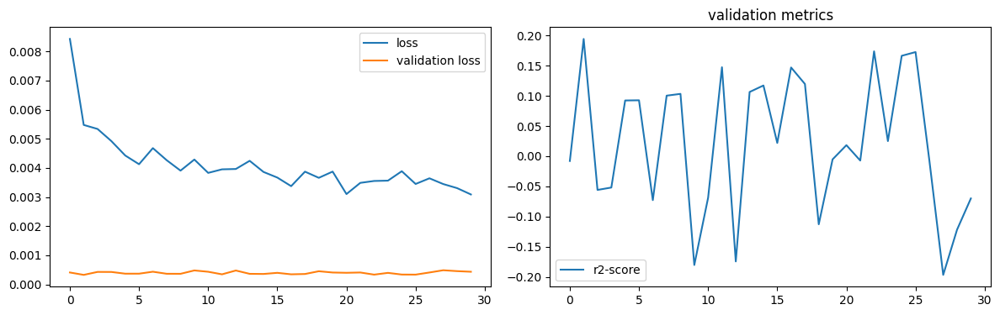

num of dropped: 67
Test: loss: 0.025314148515462875, avg metrics: (0.05647346973419189,)
dropping feature: (20, 'neuron66')


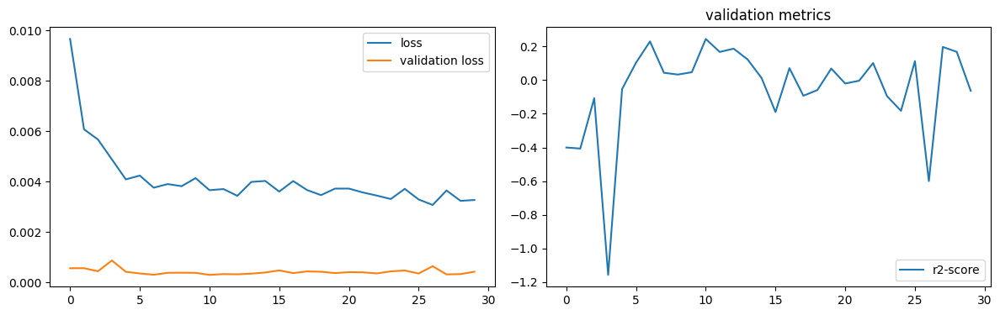

num of dropped: 68
Test: loss: 0.025171548128128052, avg metrics: (-0.03260165452957153,)
dropping feature: (31, 'neuron99')


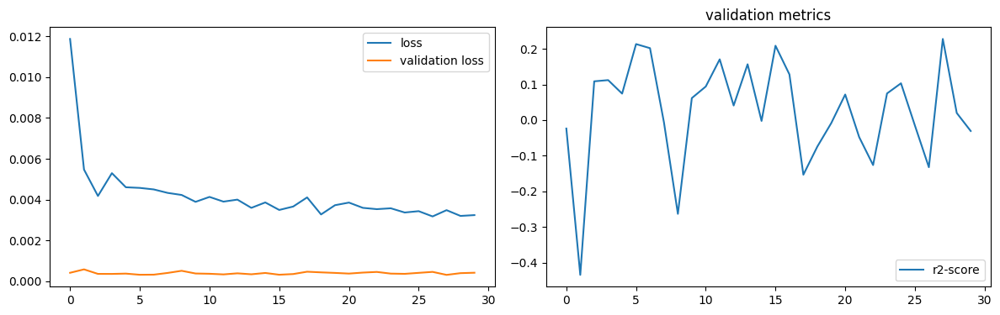

num of dropped: 69
Test: loss: 0.02399548701941967, avg metrics: (0.1341217041015625,)
dropping feature: (18, 'neuron59')


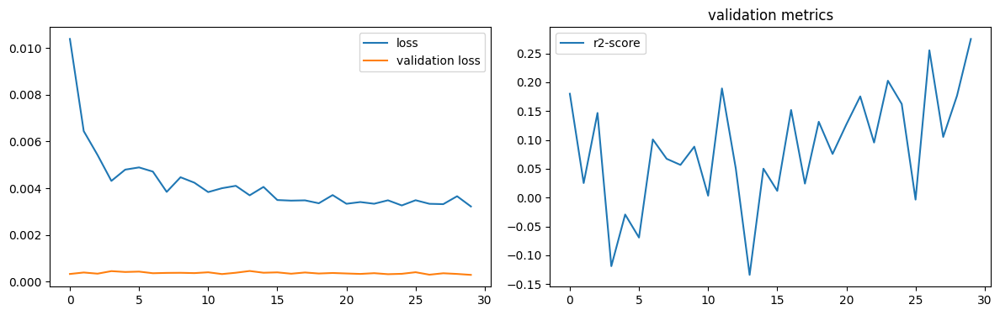

num of dropped: 70
Test: loss: 0.026923665776848793, avg metrics: (0.1132904052734375,)
dropping feature: (18, 'neuron64')


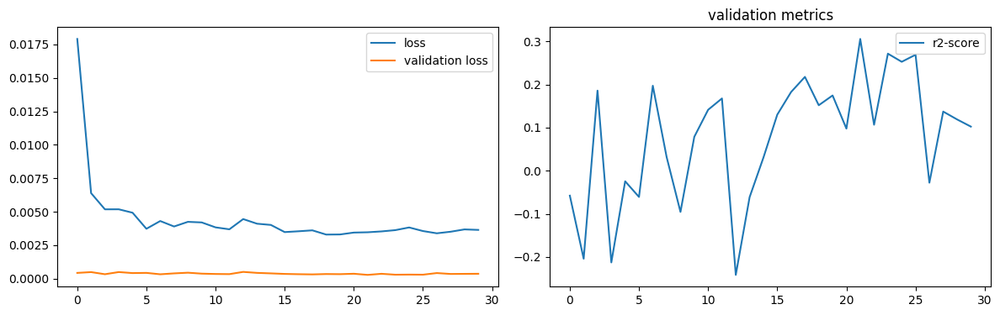

num of dropped: 71
Test: loss: 0.022197896614670753, avg metrics: (0.15251245498657226,)
dropping feature: (19, 'neuron71')


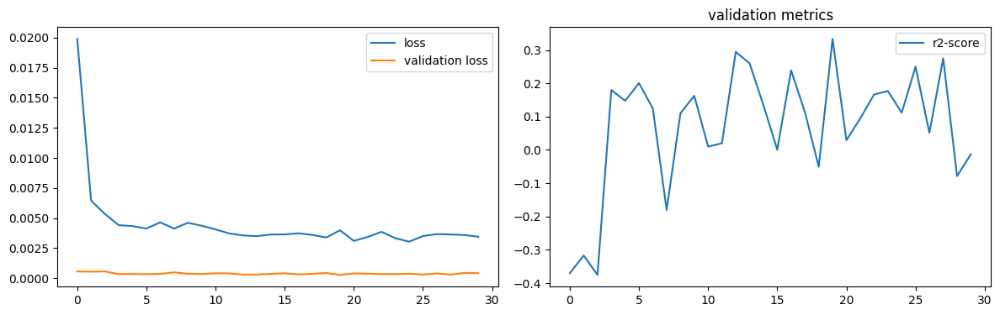

num of dropped: 72
Test: loss: 0.02486528642475605, avg metrics: (0.06974868774414063,)
dropping feature: (10, 'neuron36')


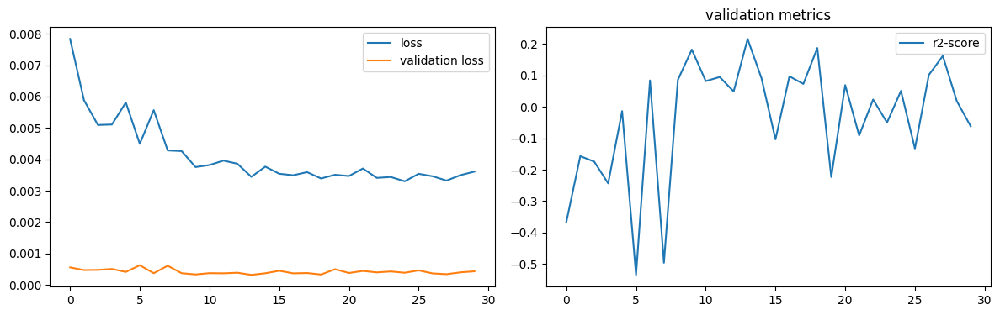

num of dropped: 73
Test: loss: 0.02501525729894638, avg metrics: (0.11026508808135986,)
dropping feature: (3, 'neuron7')


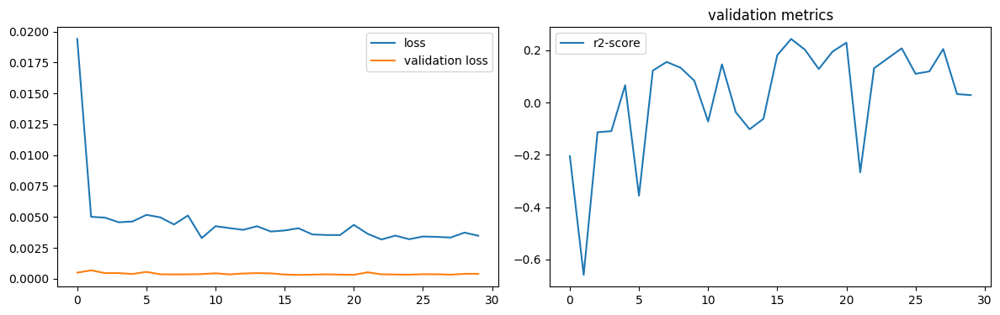

num of dropped: 74
Test: loss: 0.023351293057203293, avg metrics: (0.09205725193023681,)
dropping feature: (6, 'neuron19')


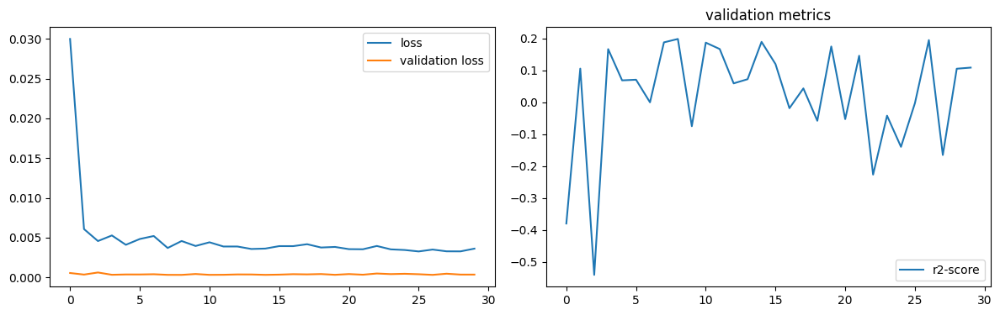

num of dropped: 75
Test: loss: 0.02419068105518818, avg metrics: (0.12245849370956421,)
dropping feature: (20, 'neuron90')


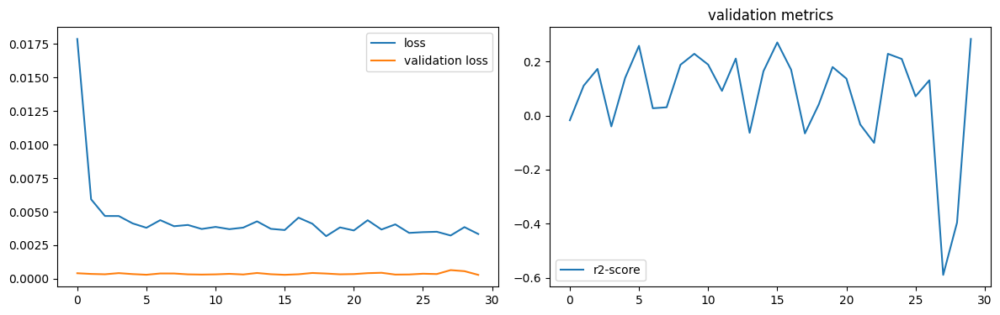

num of dropped: 76
Test: loss: 0.024627812206745148, avg metrics: (0.003783559799194336,)
dropping feature: (23, 'neuron97')


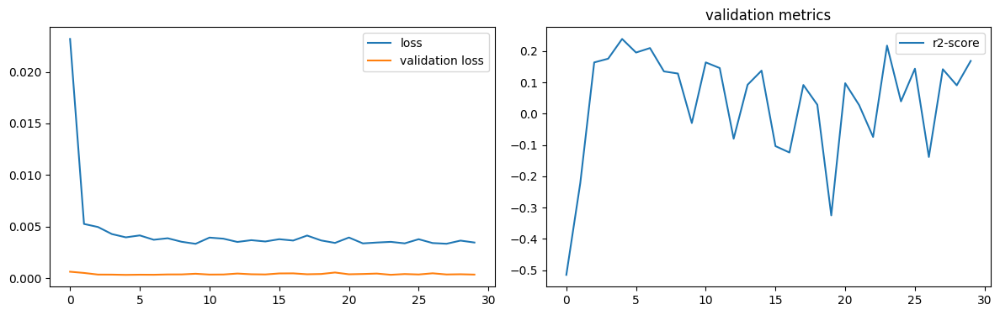

num of dropped: 77
Test: loss: 0.027234816923737526, avg metrics: (0.13033441305160523,)
dropping feature: (17, 'neuron74')


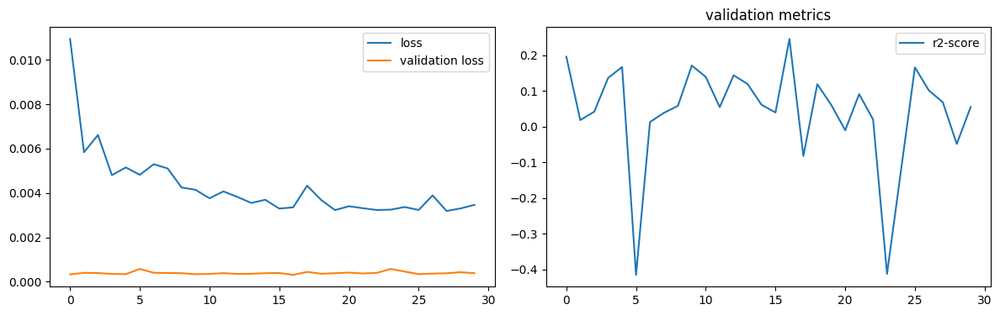

num of dropped: 78
Test: loss: 0.026677750051021576, avg metrics: (0.10551291704177856,)
dropping feature: (13, 'neuron53')


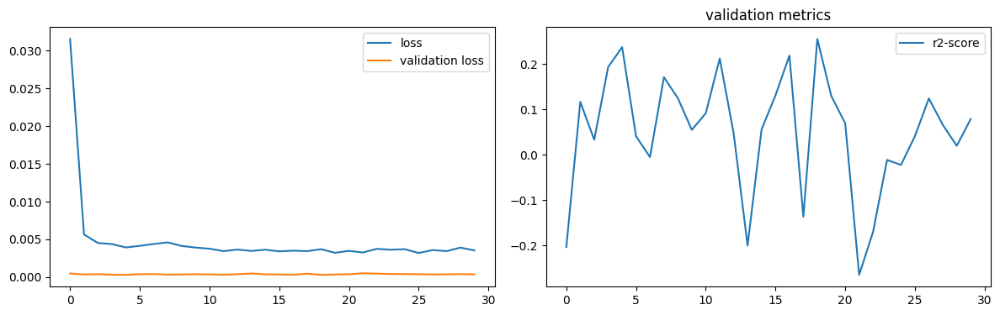

num of dropped: 79
Test: loss: 0.023631904274225235, avg metrics: (0.06697134971618653,)
dropping feature: (5, 'neuron17')


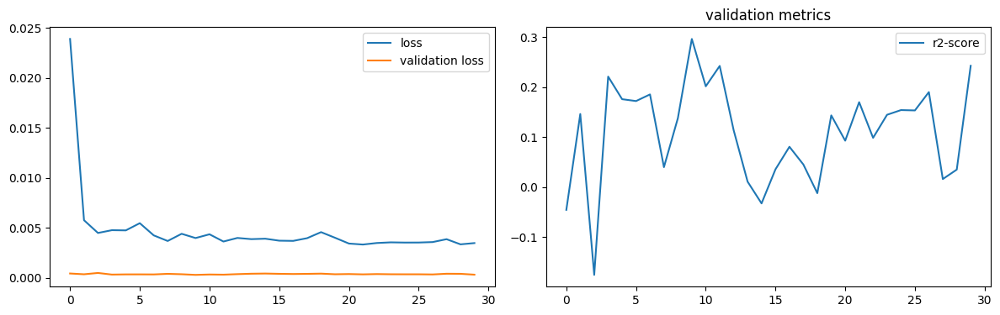

num of dropped: 80
Test: loss: 0.03042377345263958, avg metrics: (0.09345017671585083,)
dropping feature: (6, 'neuron24')


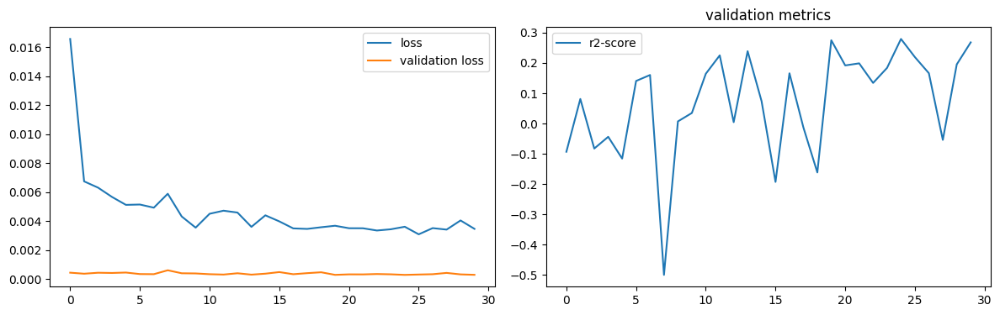

num of dropped: 81
Test: loss: 0.024961620569229126, avg metrics: (0.11972593069076538,)
dropping feature: (6, 'neuron38')


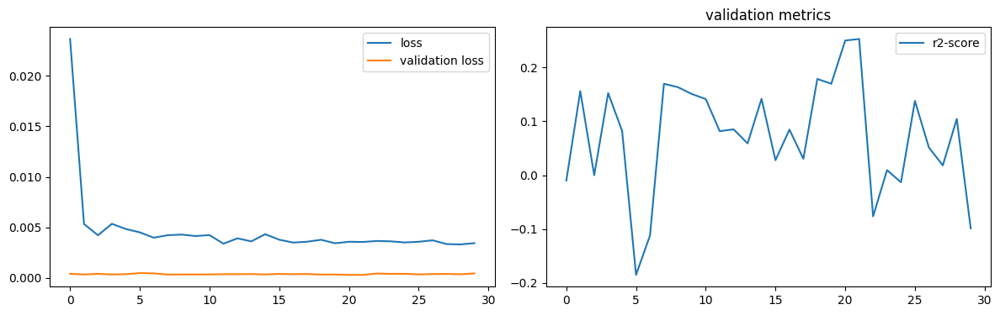

num of dropped: 82
Test: loss: 0.024702129885554314, avg metrics: (0.08908145427703858,)
dropping feature: (9, 'neuron52')


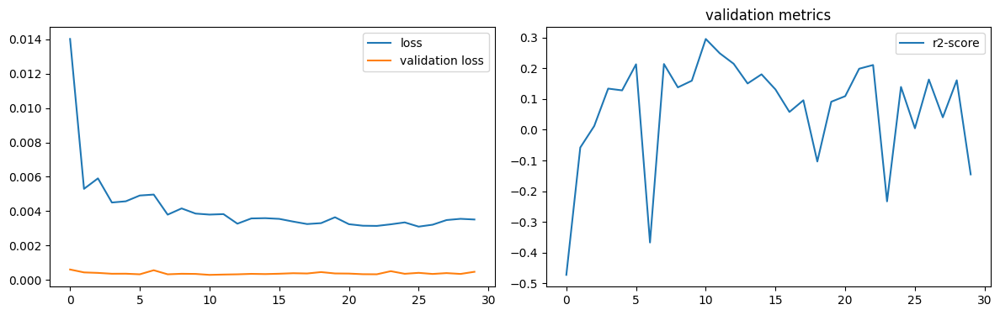

num of dropped: 83
Test: loss: 0.02709861844778061, avg metrics: (0.07015417814254761,)
dropping feature: (10, 'neuron69')


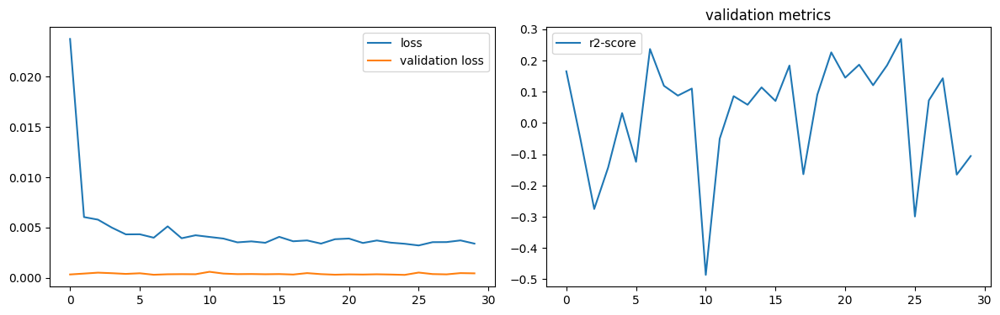

num of dropped: 84
Test: loss: 0.02780197188258171, avg metrics: (0.07629289627075195,)
dropping feature: (4, 'neuron16')


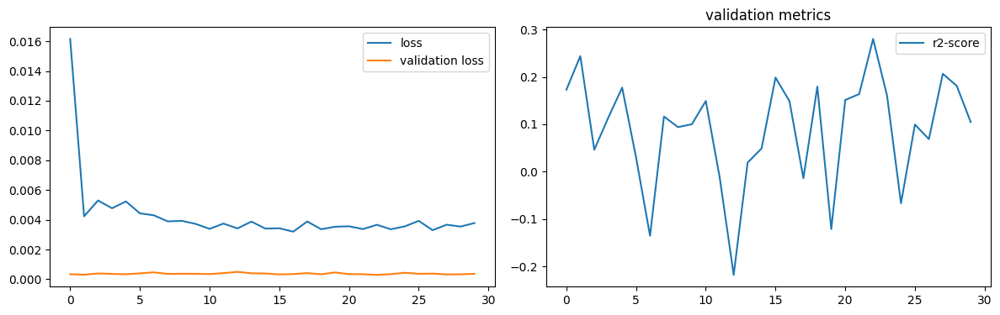

num of dropped: 85
Test: loss: 0.02602357603609562, avg metrics: (0.05800338983535767,)
dropping feature: (5, 'neuron44')


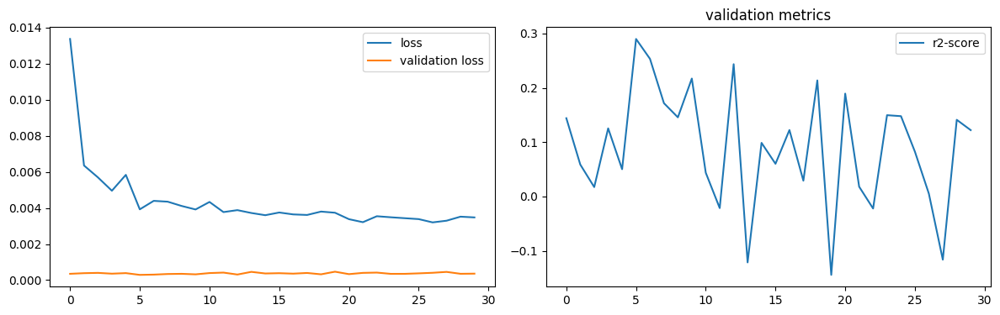

num of dropped: 86
Test: loss: 0.025229301303625107, avg metrics: (0.13847062587738038,)
dropping feature: (2, 'neuron6')


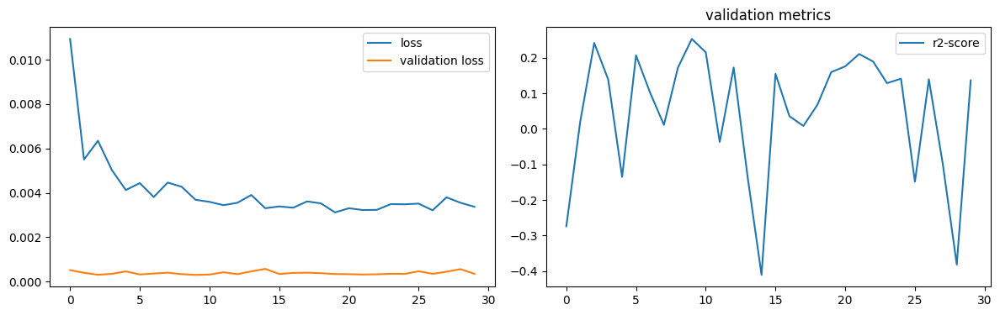

num of dropped: 87
Test: loss: 0.025166593492031097, avg metrics: (0.043391299247741696,)
dropping feature: (4, 'neuron48')


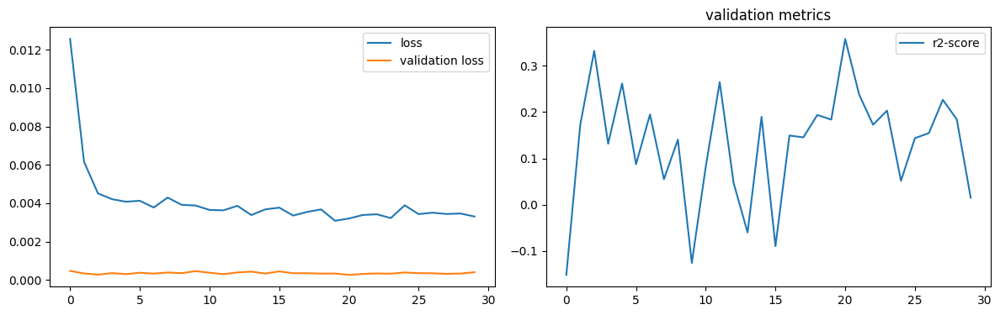

num of dropped: 88
Test: loss: 0.0244221743196249, avg metrics: (0.1591504454612732,)
dropping feature: (10, 'neuron93')


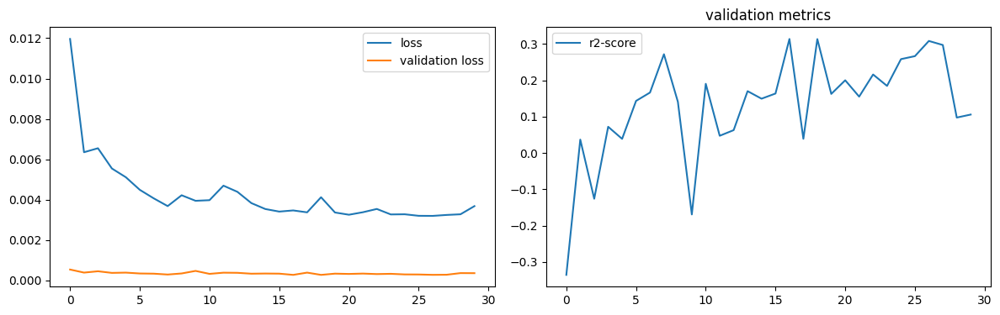

num of dropped: 89
Test: loss: 0.02532886527478695, avg metrics: (0.12897045612335206,)
dropping feature: (6, 'neuron73')


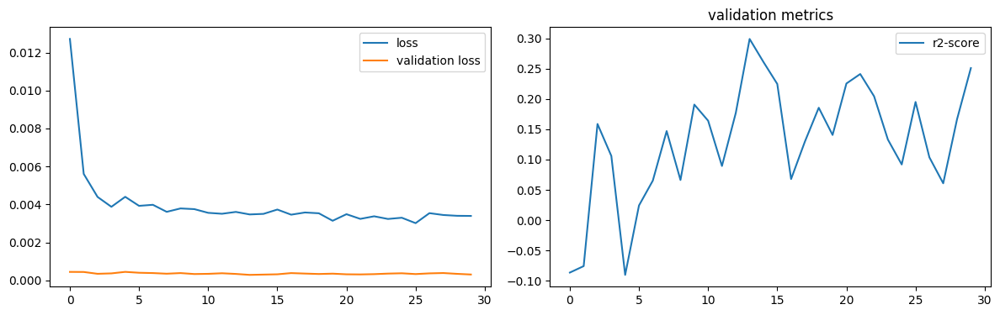

num of dropped: 90
Test: loss: 0.023920662701129913, avg metrics: (0.15253411531448363,)
dropping feature: (8, 'neuron91')


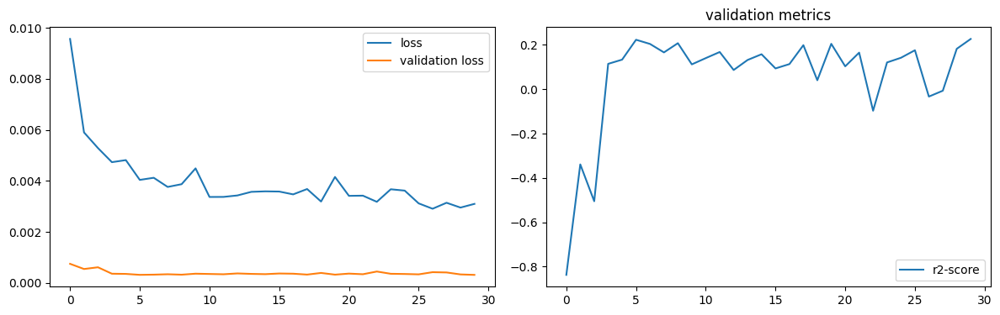

num of dropped: 91
Test: loss: 0.024078091606497765, avg metrics: (0.018318796157836915,)
dropping feature: (2, 'neuron8')


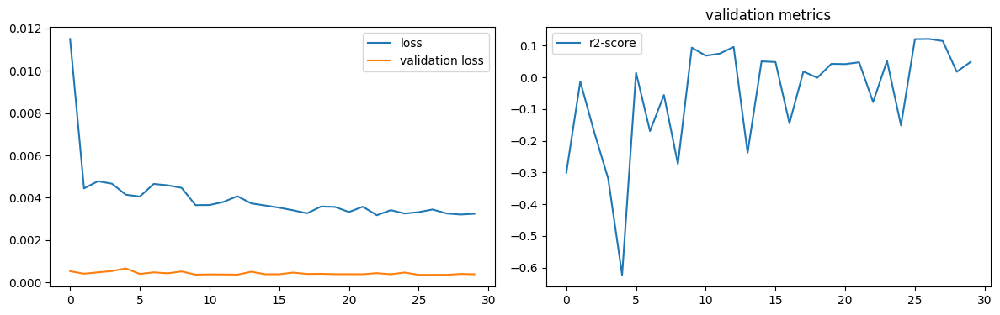

num of dropped: 92
Test: loss: 0.024544479325413704, avg metrics: (0.08228399753570556,)
dropping feature: (1, 'neuron4')


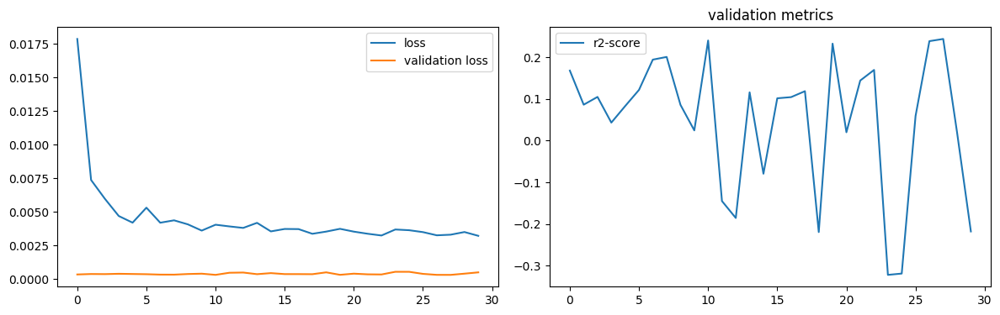

num of dropped: 93
Test: loss: 0.025035474449396133, avg metrics: (0.11579030752182007,)
dropping feature: (6, 'neuron96')


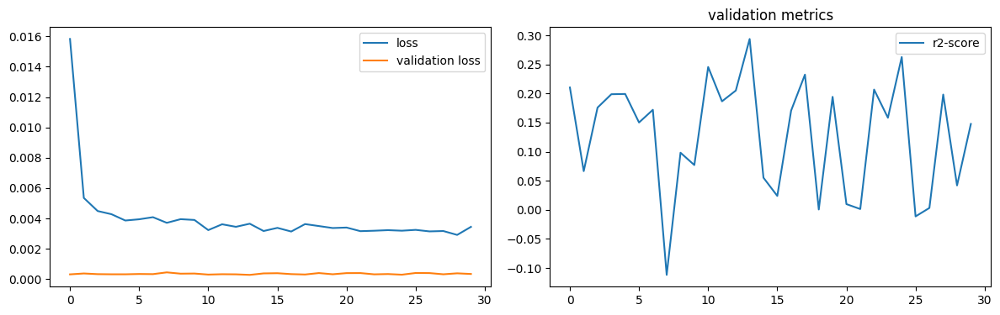

num of dropped: 94
Test: loss: 0.022507037967443466, avg metrics: (0.17715388536453247,)
dropping feature: (1, 'neuron21')


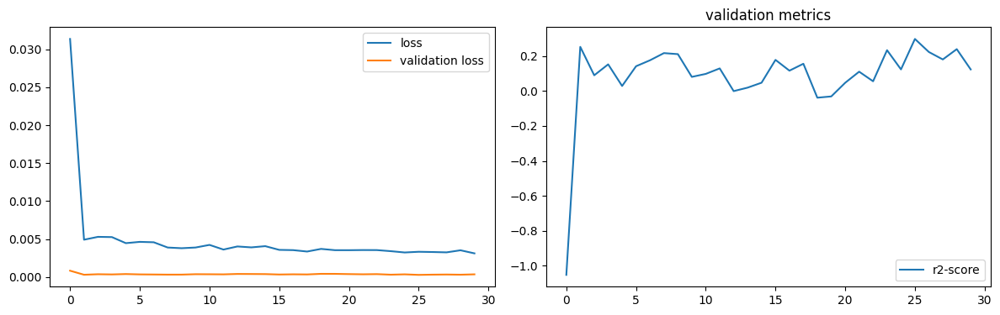

num of dropped: 95
Test: loss: 0.024247877299785614, avg metrics: (0.12931760549545288,)
dropping feature: (2, 'neuron54')


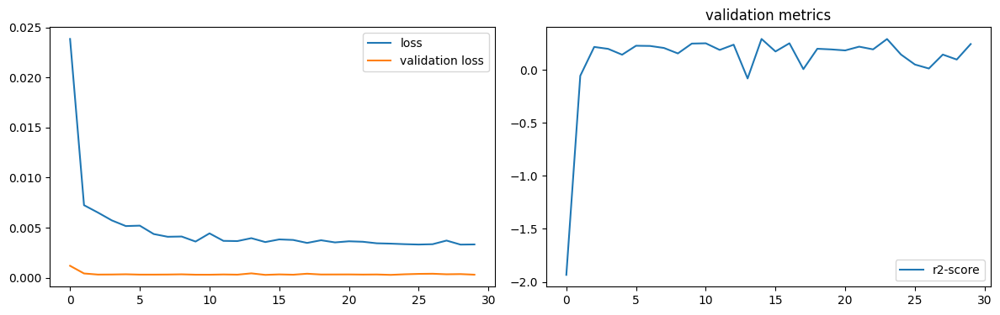

num of dropped: 96
Test: loss: 0.029466548934578896, avg metrics: (0.03971275091171265,)
dropping feature: (1, 'neuron49')


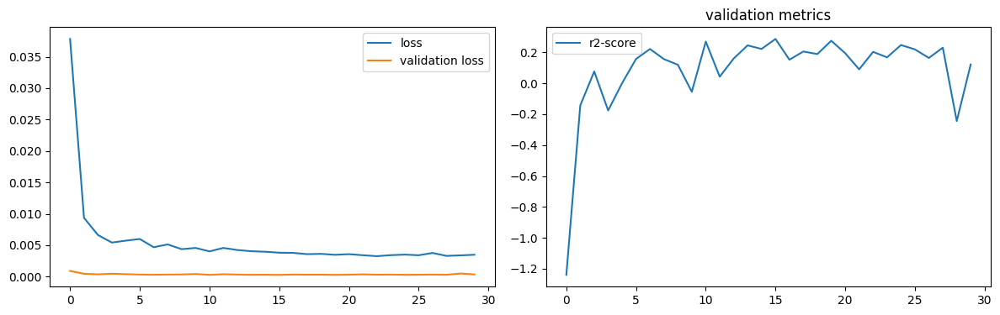

num of dropped: 97
Test: loss: 0.028383174911141396, avg metrics: (-0.017908644676208497,)
dropping feature: (2, 'neuron81')


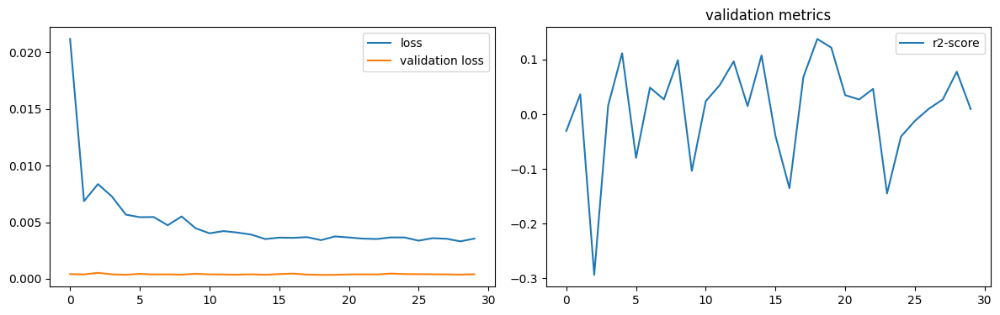

num of dropped: 98
Test: loss: 0.03495398163795471, avg metrics: (-0.007740974426269531,)
dropping feature: (1, 'neuron77')


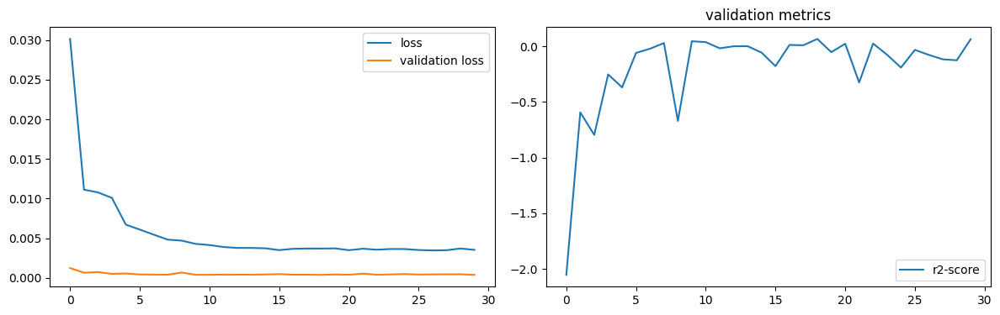

num of dropped: 99
Test: loss: 0.028064746409654617, avg metrics: (0.0025099754333496095,)


In [16]:
torch.manual_seed(2024)

headers = [f"neuron{i}" for i in range(100)]


def model_factory(size):
    model = StudentsNN(1, (size, 100))
    model.layer1 = nn.Identity()
    return model


test_metrics, dropped, models = prune(
    datasets, headers, analyze_dgsm,
    model_factory, optimizer_factory, criterion, score_outputs, 30,
    labels, "", None
)

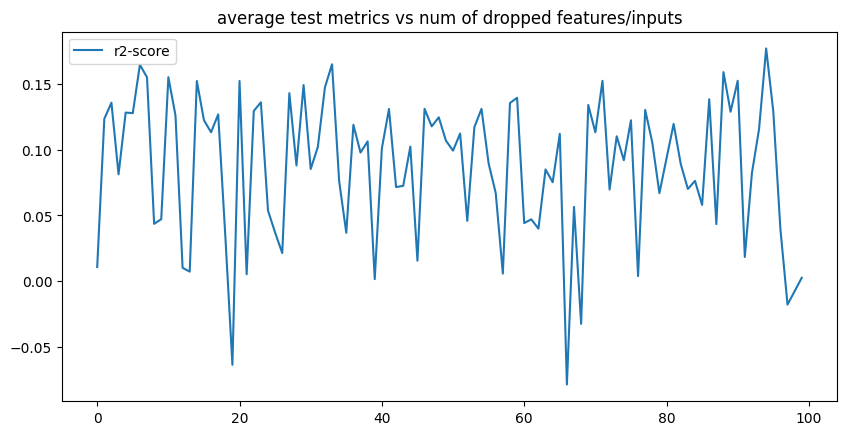

In [17]:
plot_dropping_metrics(test_metrics, labels)

In [18]:
num_drop_neurons = 97

save_models("students", "dgsm-layer2", models, dropped)

reduced_datasets, reduced_headers = reduce_datasets(datasets, headers, dropped, num_drop_neurons)
layer = models[num_drop_neurons].layer2

best_model.layer2 = layer
best_model.layer1[0] = reduce_linear(best_model.layer1[0], dropped, num_drop_neurons)
best_model.layer1[1] = nn.BatchNorm1d(100 - num_drop_neurons)

features left [3]:  ['neuron1', 'neuron77', 'neuron81']


### 2nd hidden layer

In [19]:
layer.eval()

datasets = {
    key: TensorDataset(
        layer(dataset.tensors[0]).detach(),
        dataset.tensors[1]
    )
    for key, dataset in reduced_datasets.items()
}

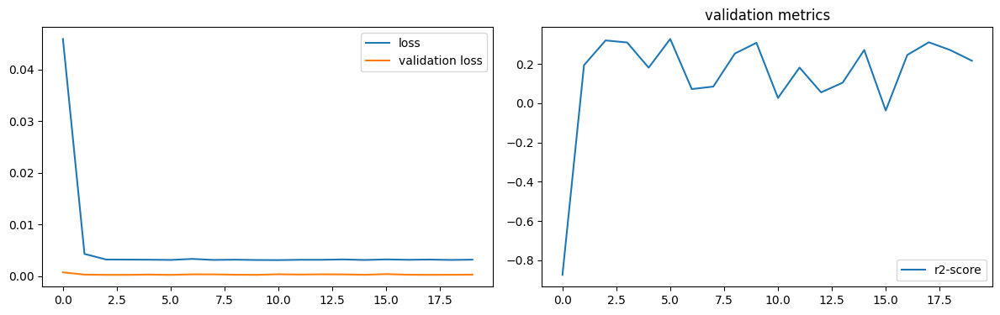

num of dropped: 0
Test: loss: 0.02631351724267006, avg metrics: (0.05350346565246582,)
dropping feature: (99, 'neuron99')


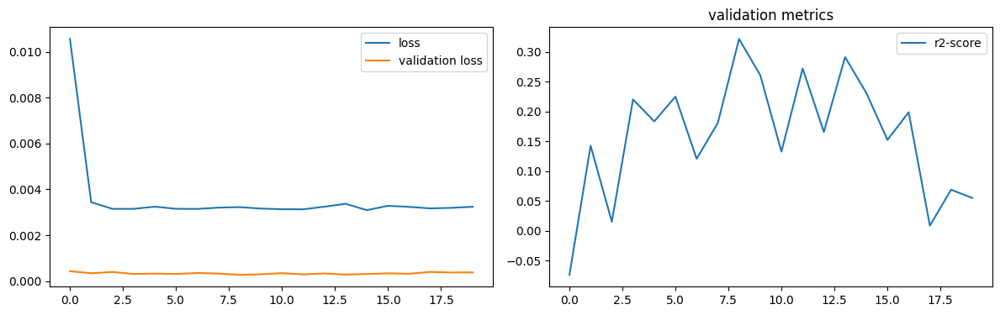

num of dropped: 1
Test: loss: 0.028543194755911827, avg metrics: (0.042982423305511476,)
dropping feature: (9, 'neuron9')


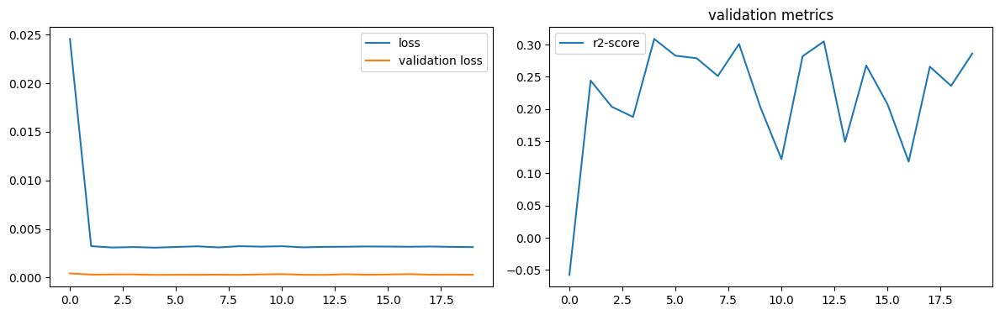

num of dropped: 2
Test: loss: 0.025028102099895477, avg metrics: (0.05284818410873413,)
dropping feature: (77, 'neuron78')


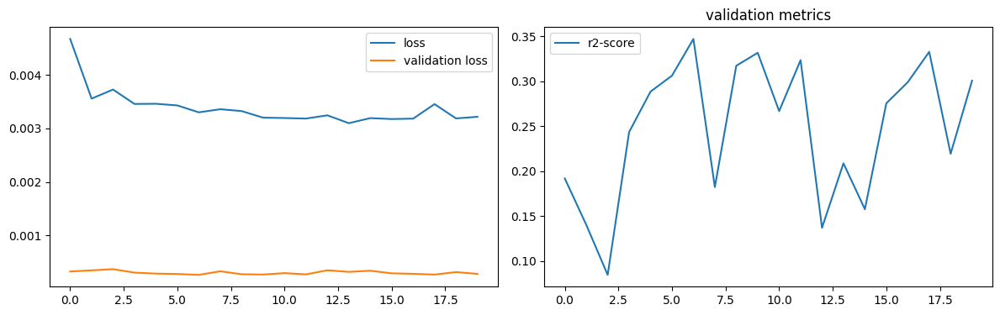

num of dropped: 3
Test: loss: 0.026215380057692528, avg metrics: (0.06034352779388428,)
dropping feature: (53, 'neuron54')


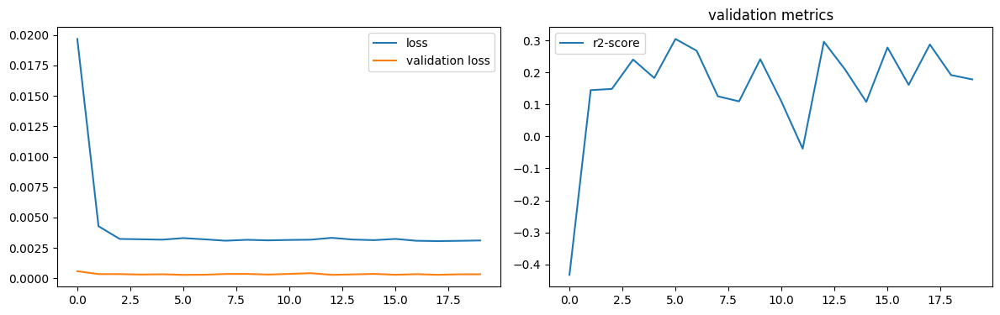

num of dropped: 4
Test: loss: 0.025478459894657135, avg metrics: (0.06341763734817504,)
dropping feature: (94, 'neuron97')


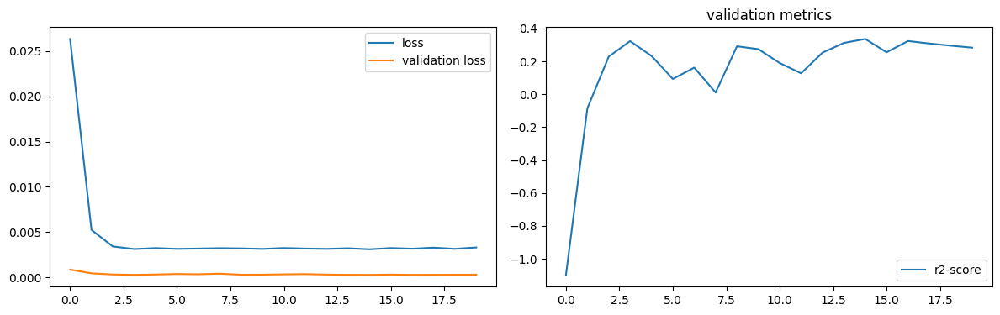

num of dropped: 5
Test: loss: 0.027959022670984268, avg metrics: (0.052265846729278566,)
dropping feature: (8, 'neuron8')


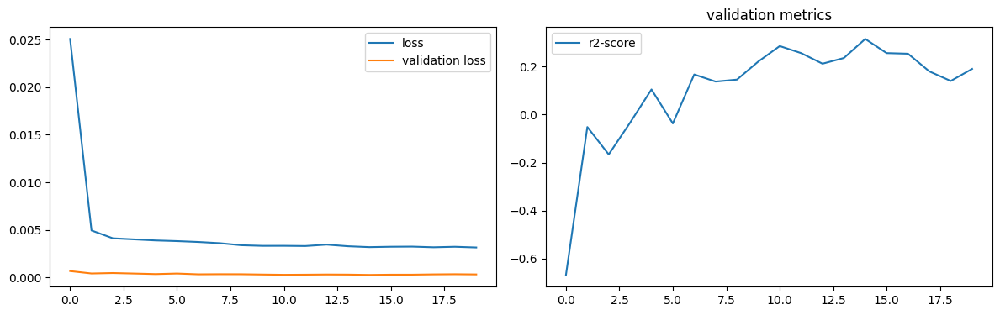

num of dropped: 6
Test: loss: 0.026306960731744766, avg metrics: (0.03849867582321167,)
dropping feature: (56, 'neuron59')


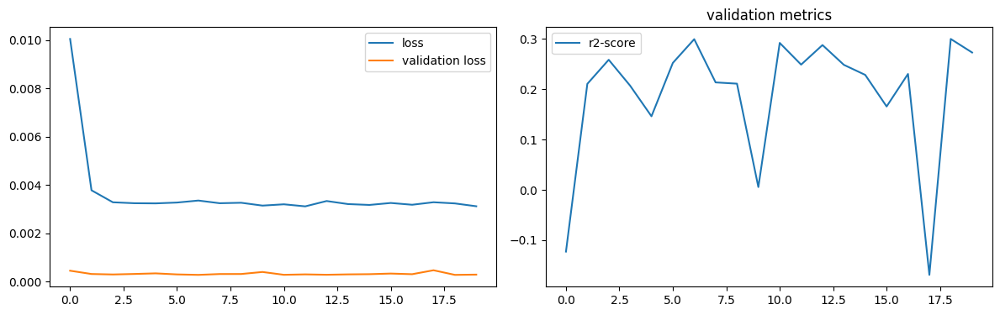

num of dropped: 7
Test: loss: 0.02648949809372425, avg metrics: (0.09394530057907105,)
dropping feature: (55, 'neuron58')


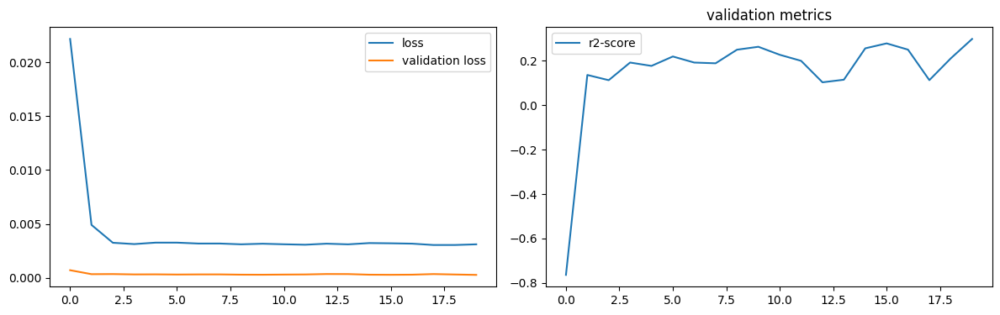

num of dropped: 8
Test: loss: 0.026202529668807983, avg metrics: (0.06017826795578003,)
dropping feature: (84, 'neuron90')


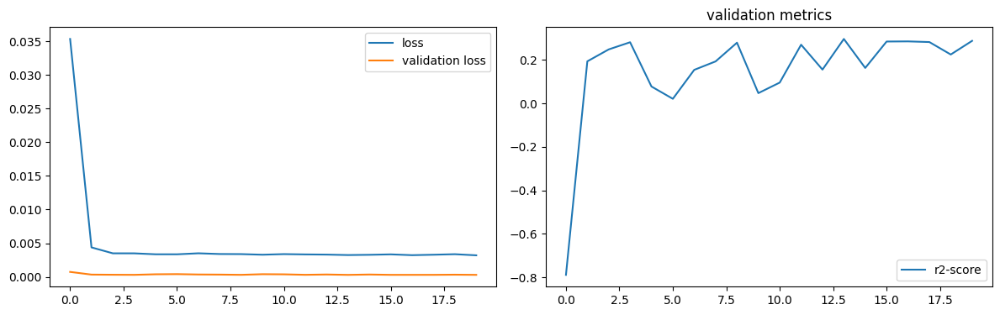

num of dropped: 9
Test: loss: 0.025597713887691498, avg metrics: (0.0809355616569519,)
dropping feature: (52, 'neuron55')


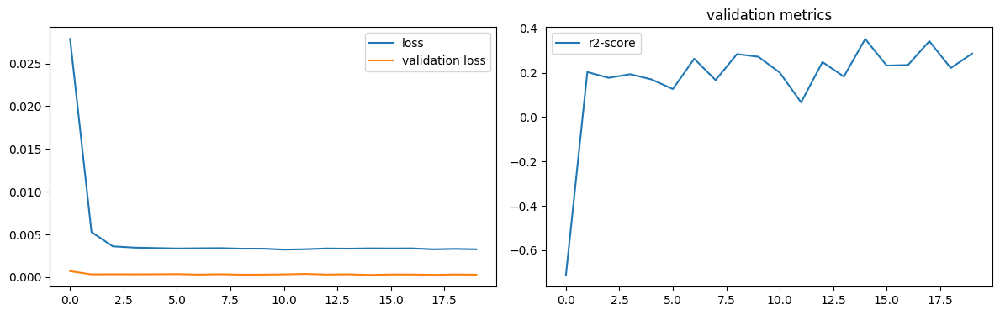

num of dropped: 10
Test: loss: 0.026299769058823586, avg metrics: (0.09260928630828857,)
dropping feature: (2, 'neuron2')


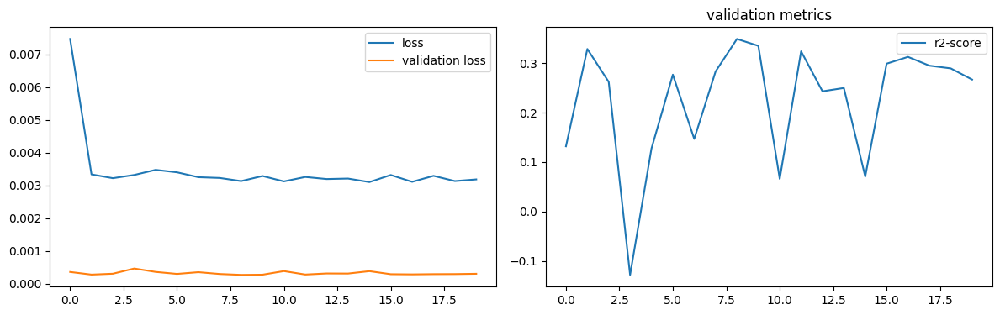

num of dropped: 11
Test: loss: 0.025709345936775208, avg metrics: (0.0783858060836792,)
dropping feature: (7, 'neuron10')


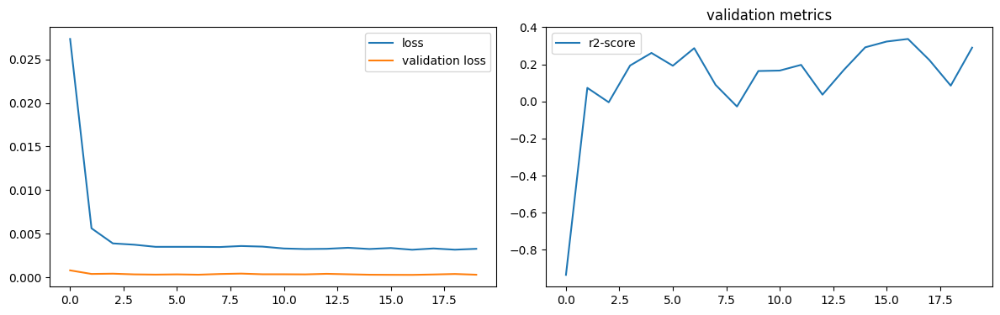

num of dropped: 12
Test: loss: 0.027888569980859756, avg metrics: (0.08032221794128418,)
dropping feature: (70, 'neuron79')


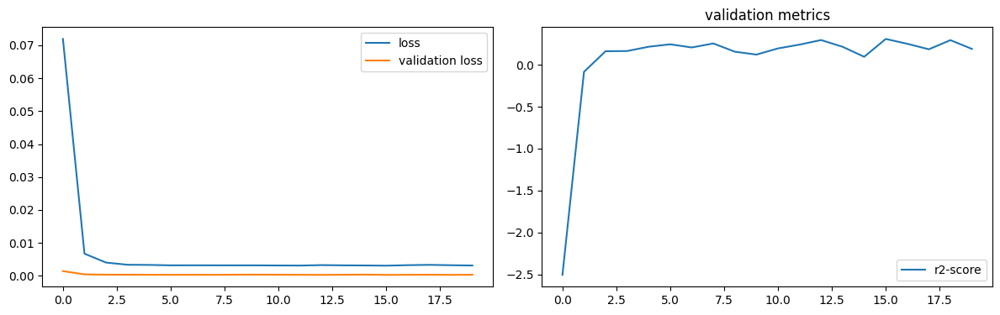

num of dropped: 13
Test: loss: 0.025794262066483498, avg metrics: (0.07100235223770142,)
dropping feature: (58, 'neuron66')


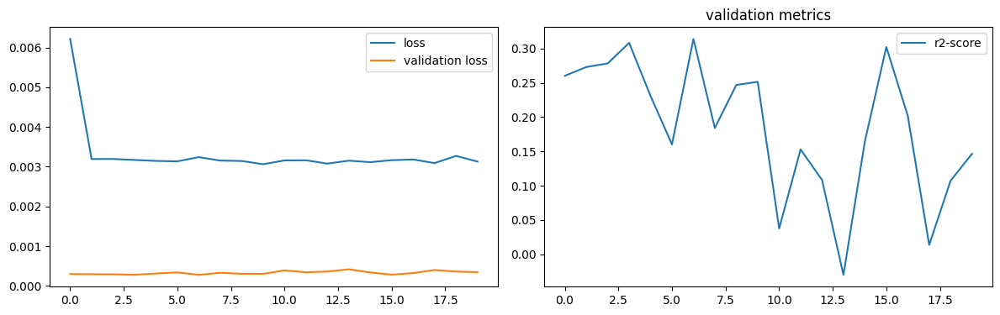

num of dropped: 14
Test: loss: 0.025550970807671547, avg metrics: (0.09200303554534912,)
dropping feature: (10, 'neuron14')


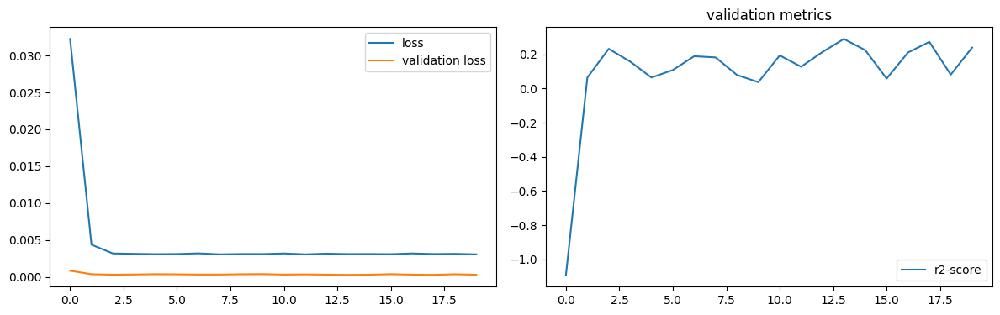

num of dropped: 15
Test: loss: 0.025761278346180916, avg metrics: (0.0704767107963562,)
dropping feature: (16, 'neuron21')


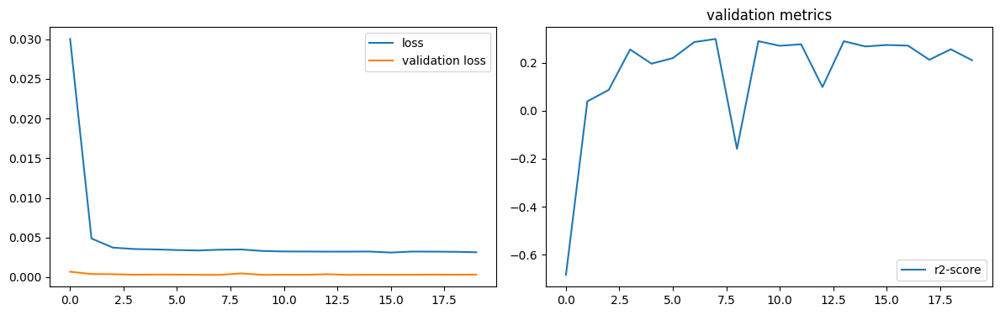

num of dropped: 16
Test: loss: 0.025601696223020554, avg metrics: (0.07945994138717652,)
dropping feature: (33, 'neuron39')


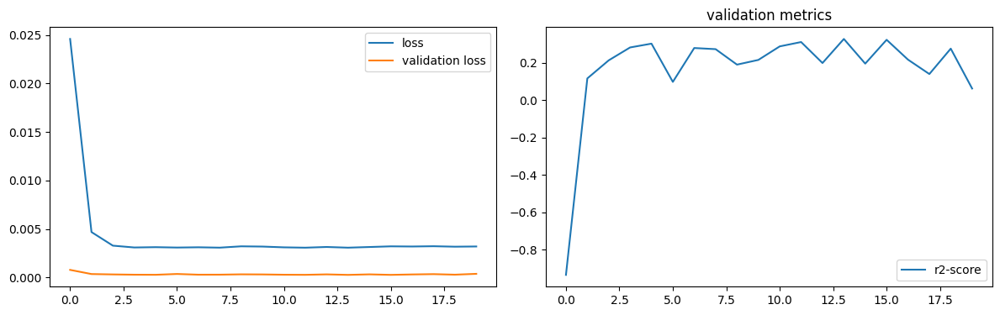

num of dropped: 17
Test: loss: 0.025972435250878334, avg metrics: (0.06297475099563599,)
dropping feature: (37, 'neuron44')


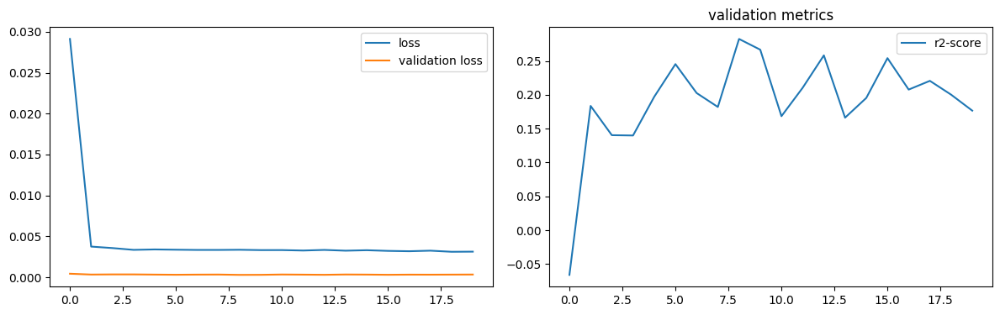

num of dropped: 18
Test: loss: 0.027623213827610016, avg metrics: (0.08777260780334473,)
dropping feature: (22, 'neuron28')


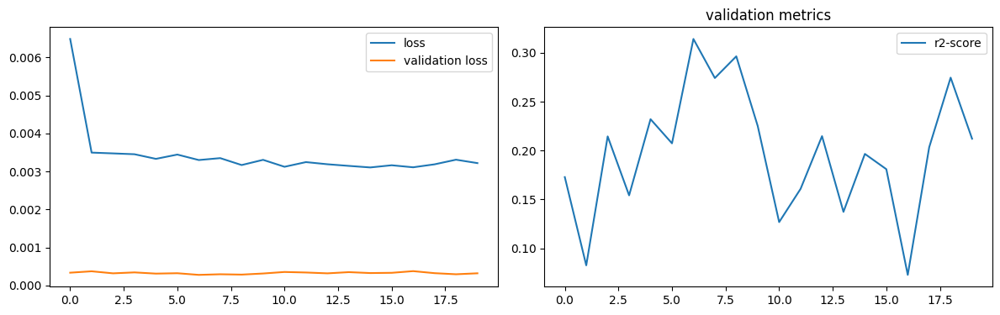

num of dropped: 19
Test: loss: 0.02524901181459427, avg metrics: (0.09066176414489746,)
dropping feature: (79, 'neuron96')


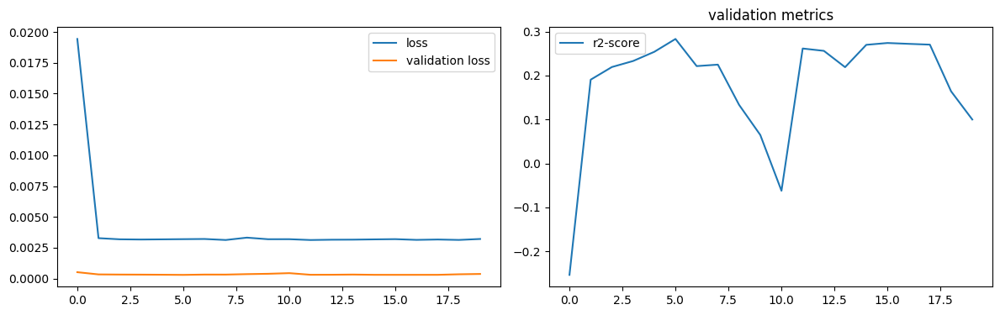

num of dropped: 20
Test: loss: 0.02654246985912323, avg metrics: (0.08948689699172974,)
dropping feature: (3, 'neuron4')


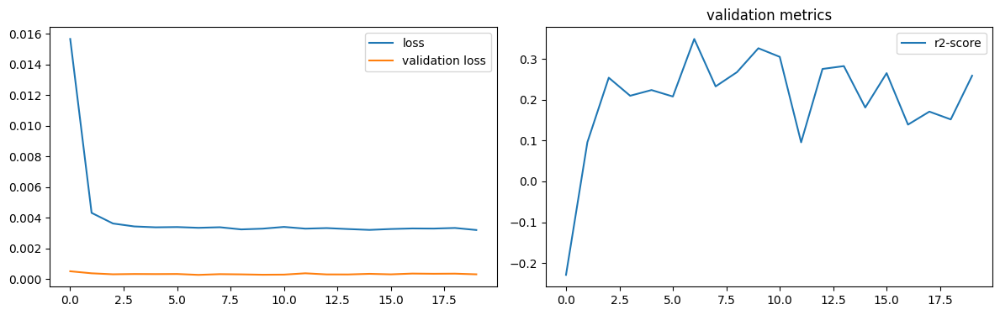

num of dropped: 21
Test: loss: 0.025152841582894325, avg metrics: (0.06383242607116699,)
dropping feature: (36, 'neuron46')


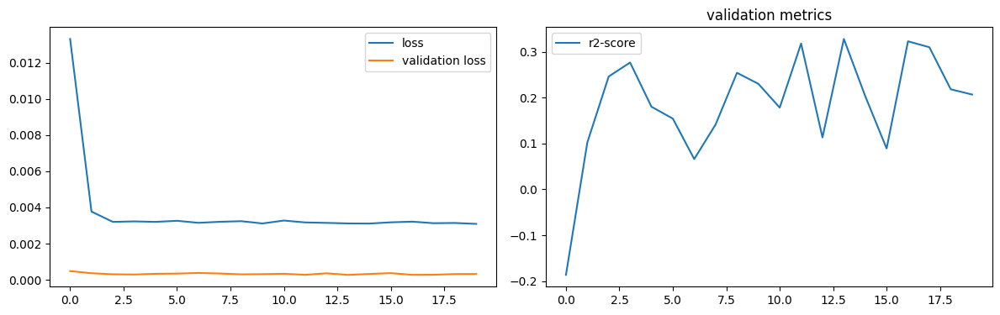

num of dropped: 22
Test: loss: 0.026171430945396423, avg metrics: (0.06901725530624389,)
dropping feature: (14, 'neuron20')


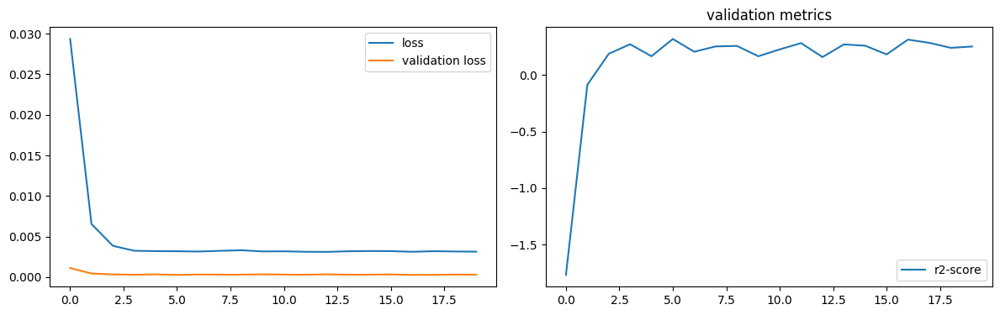

num of dropped: 23
Test: loss: 0.025573866441845894, avg metrics: (0.0742907166481018,)
dropping feature: (30, 'neuron40')


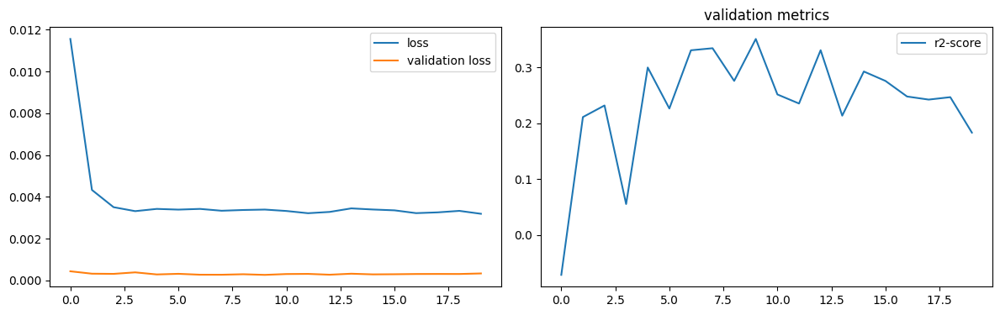

num of dropped: 24
Test: loss: 0.028249073773622513, avg metrics: (0.06258530616760254,)
dropping feature: (65, 'neuron85')


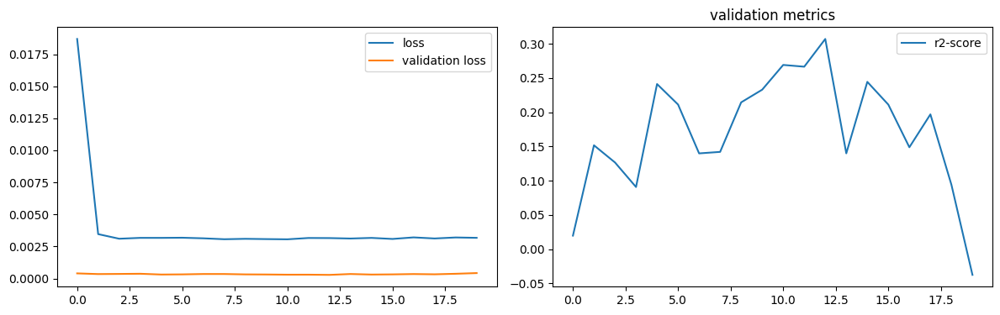

num of dropped: 25
Test: loss: 0.027503306046128273, avg metrics: (0.03743363618850708,)
dropping feature: (4, 'neuron6')


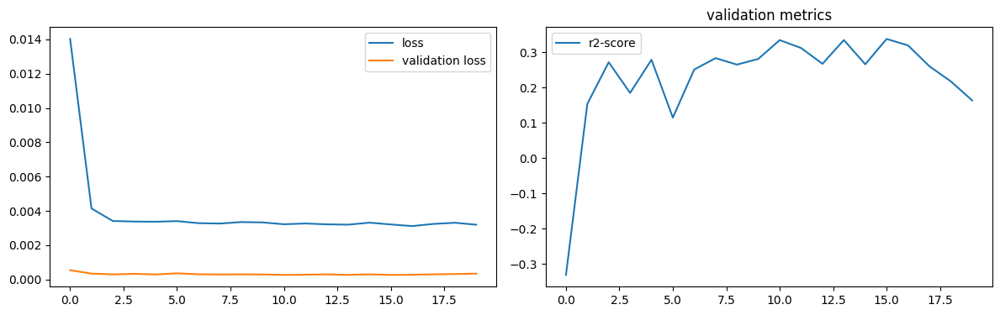

num of dropped: 26
Test: loss: 0.026477988809347153, avg metrics: (0.06693594455718994,)
dropping feature: (50, 'neuron69')


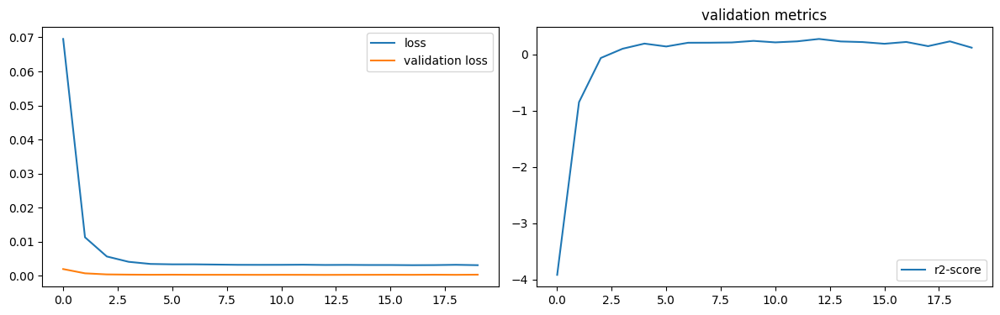

num of dropped: 27
Test: loss: 0.02657204493880272, avg metrics: (0.07411279678344726,)
dropping feature: (23, 'neuron33')


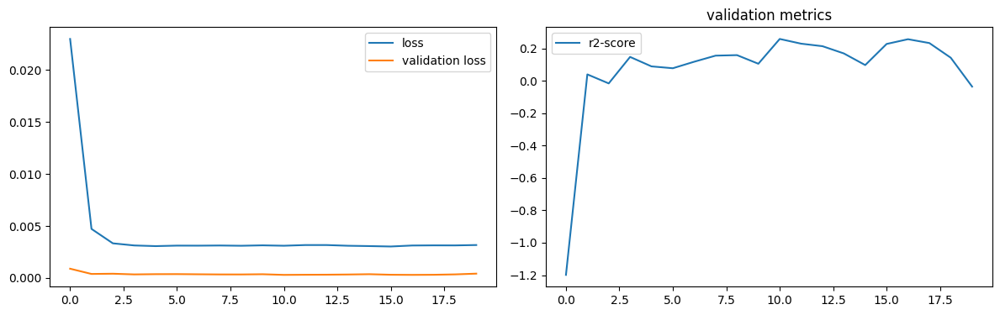

num of dropped: 28
Test: loss: 0.02665874920785427, avg metrics: (0.06440081596374511,)
dropping feature: (67, 'neuron92')


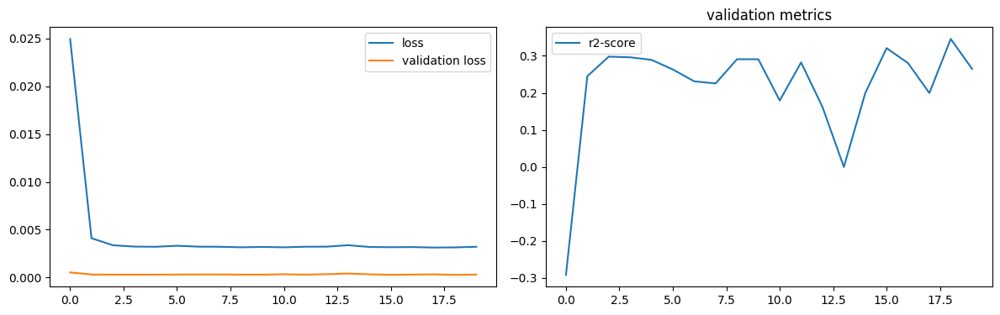

num of dropped: 29
Test: loss: 0.02587149851024151, avg metrics: (0.057934033870697024,)
dropping feature: (5, 'neuron11')


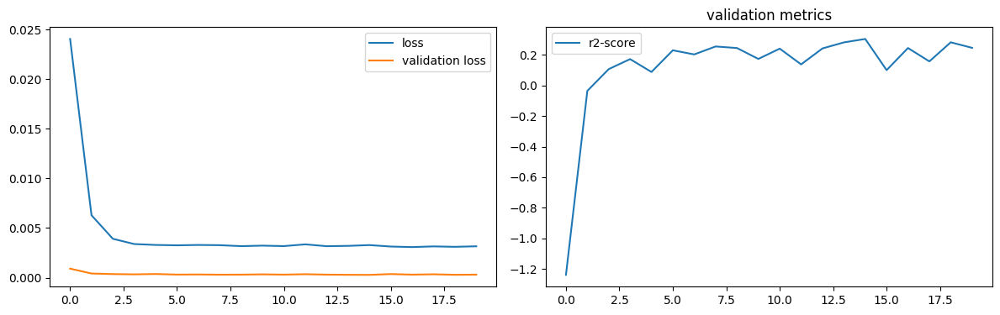

num of dropped: 30
Test: loss: 0.027329783886671066, avg metrics: (0.033247184753417966,)
dropping feature: (22, 'neuron34')


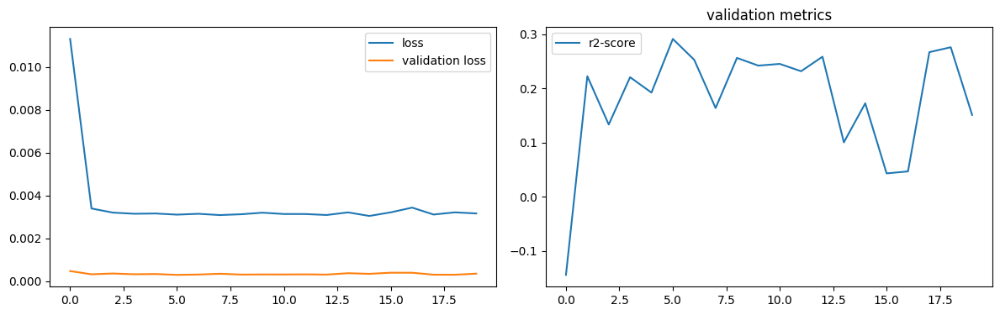

num of dropped: 31
Test: loss: 0.02459646202623844, avg metrics: (0.07168045043945312,)
dropping feature: (1, 'neuron1')


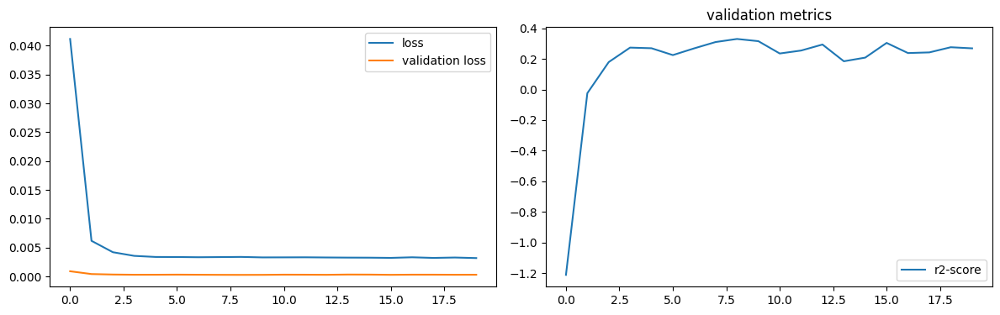

num of dropped: 32
Test: loss: 0.026585236191749573, avg metrics: (0.07408449649810792,)
dropping feature: (49, 'neuron73')


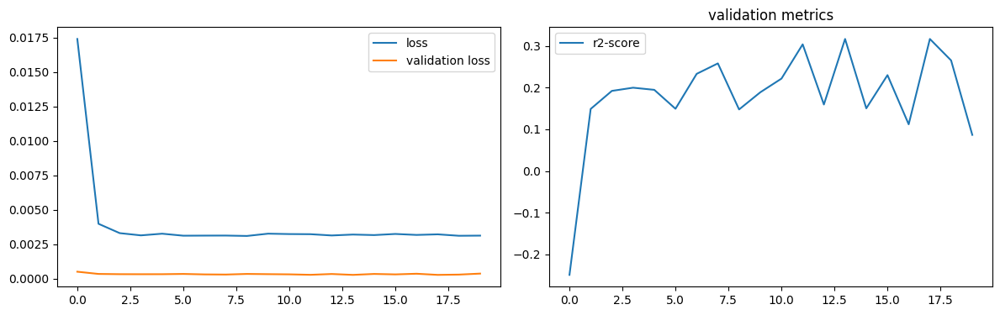

num of dropped: 33
Test: loss: 0.026172010228037834, avg metrics: (0.04889726638793945,)
dropping feature: (50, 'neuron75')


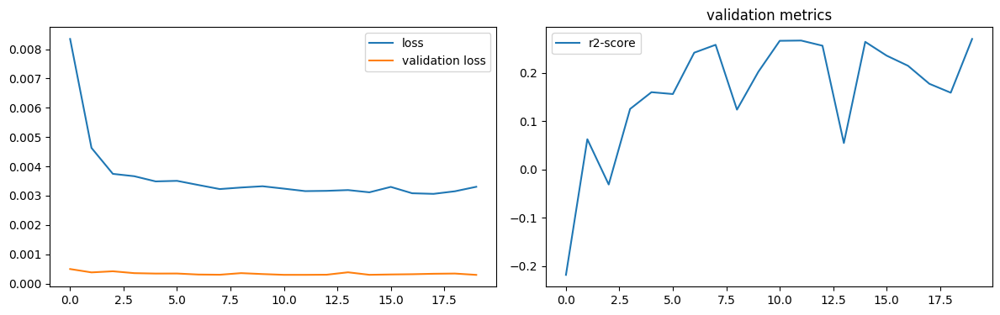

num of dropped: 34
Test: loss: 0.02704860456287861, avg metrics: (0.06970244646072388,)
dropping feature: (12, 'neuron23')


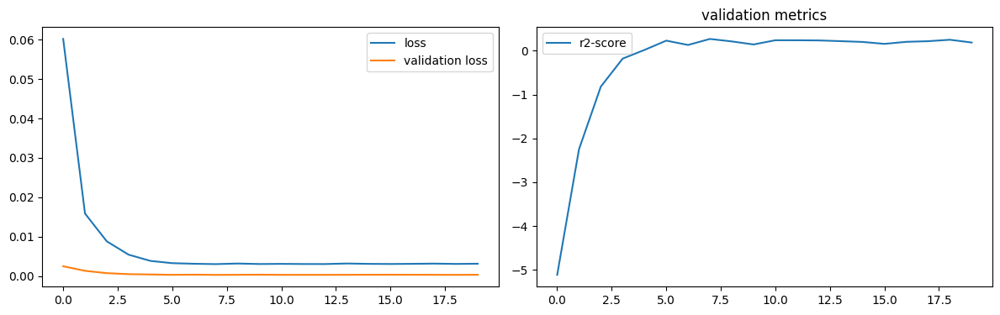

num of dropped: 35
Test: loss: 0.0245467908680439, avg metrics: (0.09319429397583008,)
dropping feature: (29, 'neuron48')


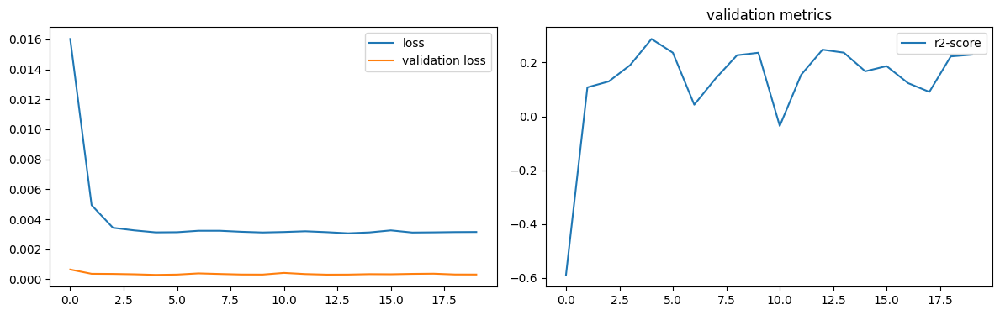

num of dropped: 36
Test: loss: 0.02529815025627613, avg metrics: (0.05923330783843994,)
dropping feature: (2, 'neuron5')


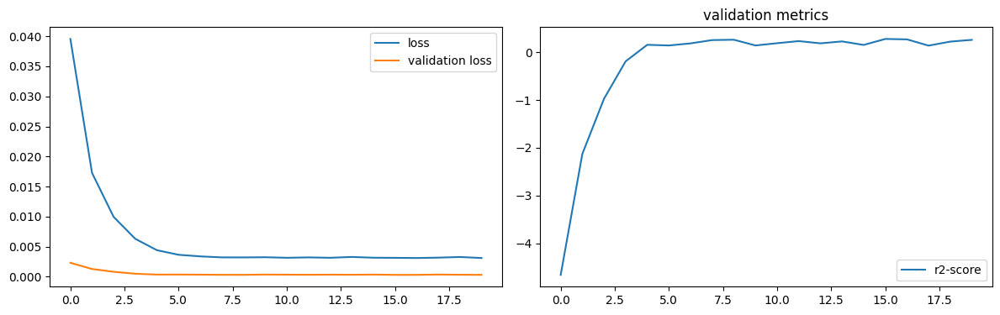

num of dropped: 37
Test: loss: 0.025478165596723557, avg metrics: (0.12072526216506958,)
dropping feature: (56, 'neuron88')


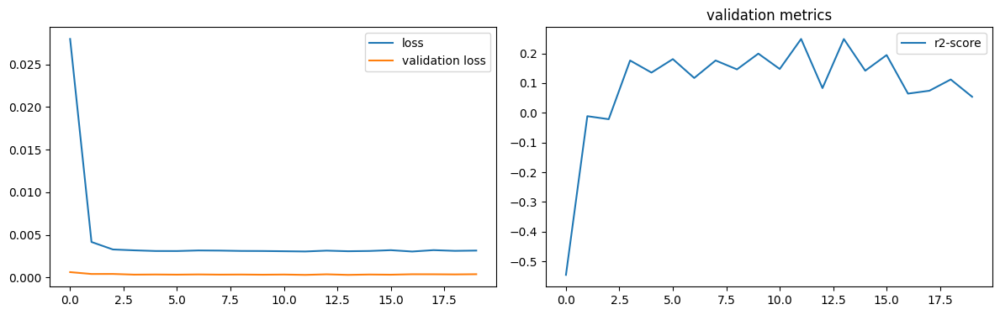

num of dropped: 38
Test: loss: 0.024817777797579765, avg metrics: (0.07350863218307495,)
dropping feature: (40, 'neuron65')


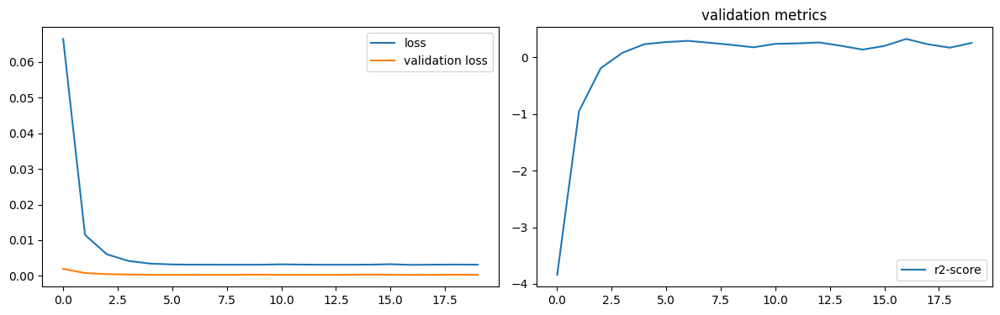

num of dropped: 39
Test: loss: 0.0254336129873991, avg metrics: (0.05874665975570679,)
dropping feature: (30, 'neuron51')


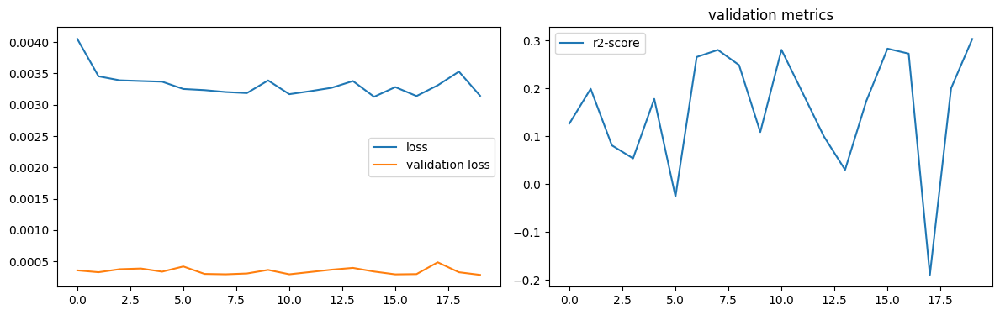

num of dropped: 40
Test: loss: 0.025891028344631195, avg metrics: (0.0811728596687317,)
dropping feature: (9, 'neuron19')


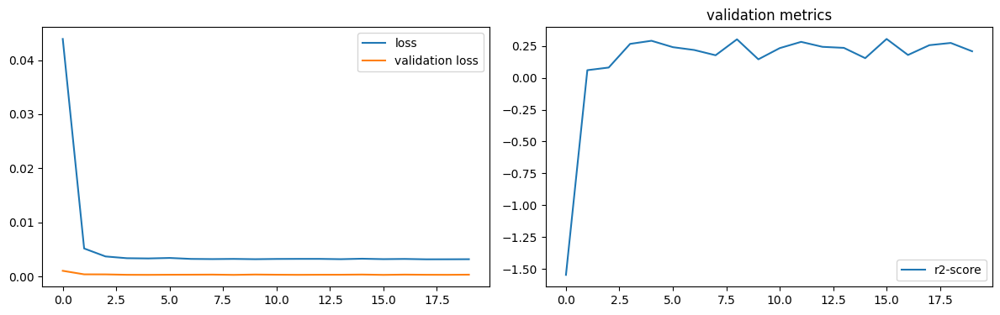

num of dropped: 41
Test: loss: 0.0258322861045599, avg metrics: (0.10745021104812622,)
dropping feature: (23, 'neuron42')


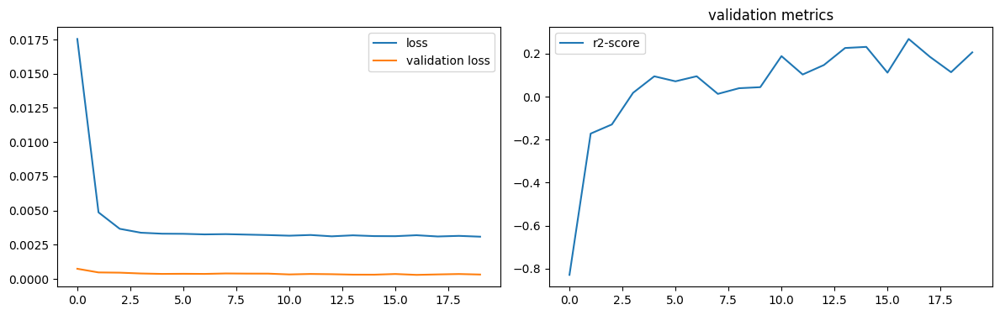

num of dropped: 42
Test: loss: 0.02482621744275093, avg metrics: (0.10908546447753906,)
dropping feature: (56, 'neuron95')


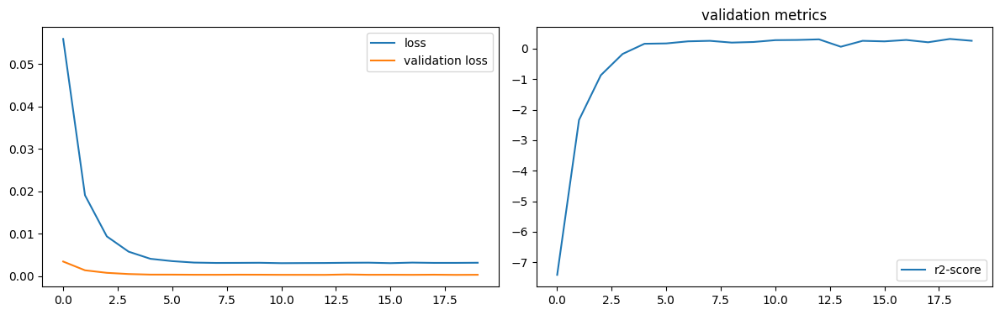

num of dropped: 43
Test: loss: 0.025509247556328773, avg metrics: (0.09462555646896362,)
dropping feature: (0, 'neuron0')


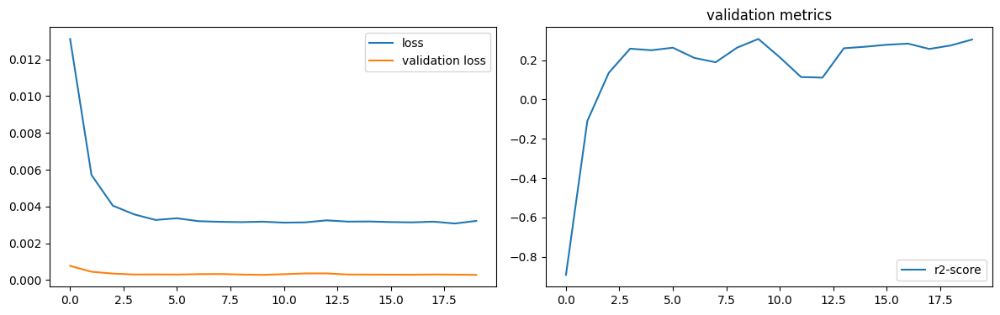

num of dropped: 44
Test: loss: 0.02561117149889469, avg metrics: (0.08409672975540161,)
dropping feature: (20, 'neuron38')


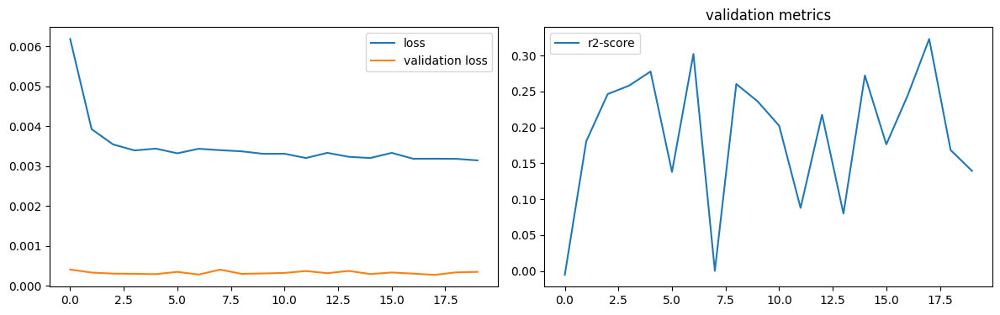

num of dropped: 45
Test: loss: 0.027424592524766922, avg metrics: (0.0634928822517395,)
dropping feature: (45, 'neuron82')


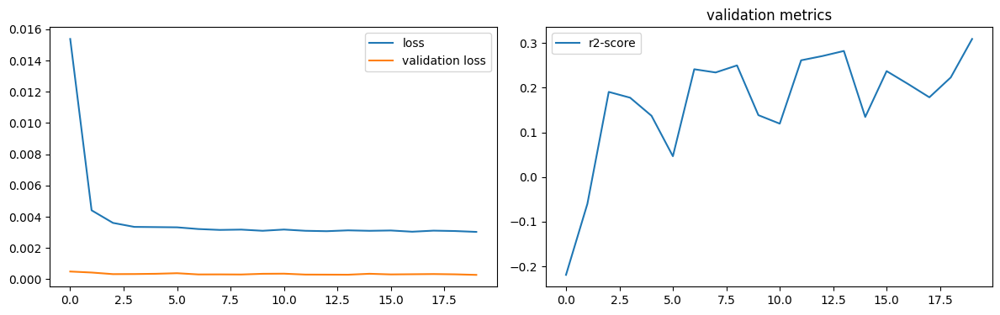

num of dropped: 46
Test: loss: 0.025636818259954453, avg metrics: (0.08479143381118774,)
dropping feature: (48, 'neuron87')


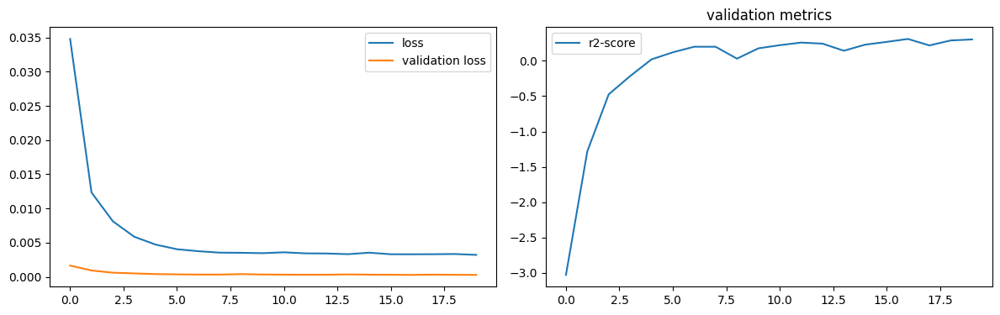

num of dropped: 47
Test: loss: 0.02757243439555168, avg metrics: (0.07244373559951782,)
dropping feature: (31, 'neuron61')


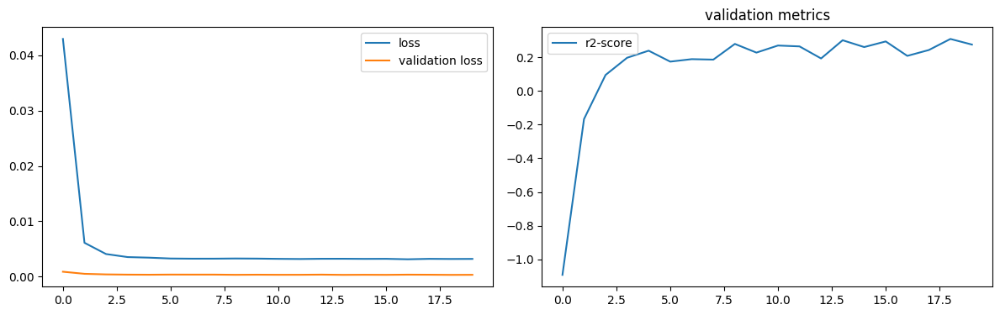

num of dropped: 48
Test: loss: 0.025788169354200363, avg metrics: (0.1024559497833252,)
dropping feature: (37, 'neuron71')


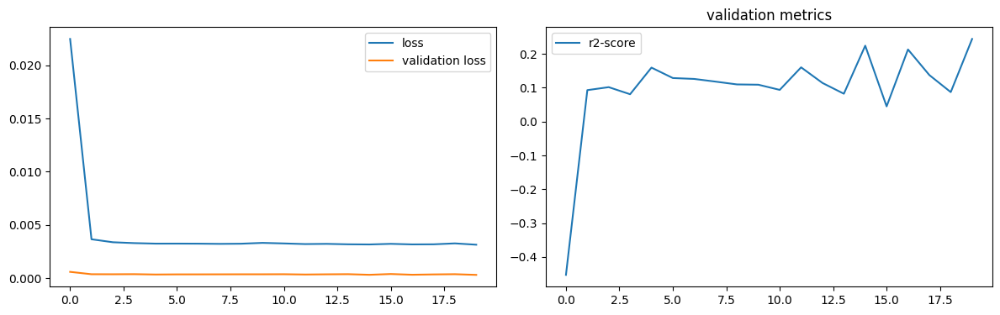

num of dropped: 49
Test: loss: 0.026342881843447685, avg metrics: (0.07458142042160035,)
dropping feature: (25, 'neuron50')


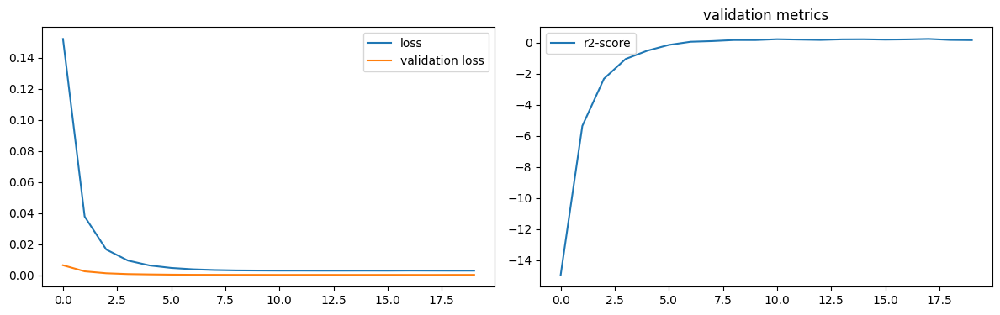

num of dropped: 50
Test: loss: 0.0247041042894125, avg metrics: (0.06969029903411865,)
dropping feature: (25, 'neuron52')


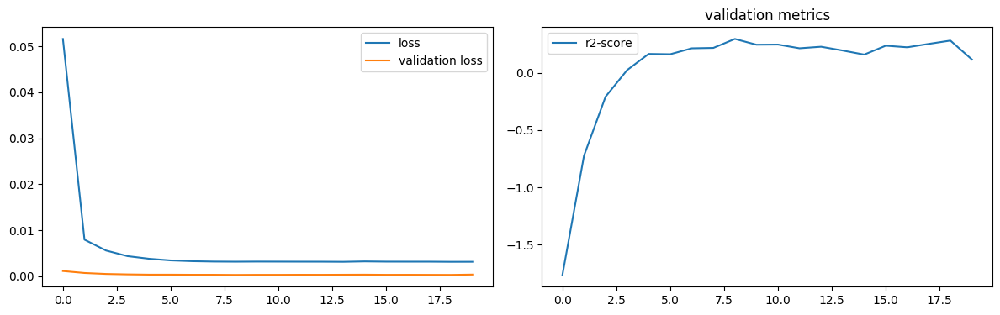

num of dropped: 51
Test: loss: 0.02630978263914585, avg metrics: (0.07543240785598755,)
dropping feature: (22, 'neuron45')


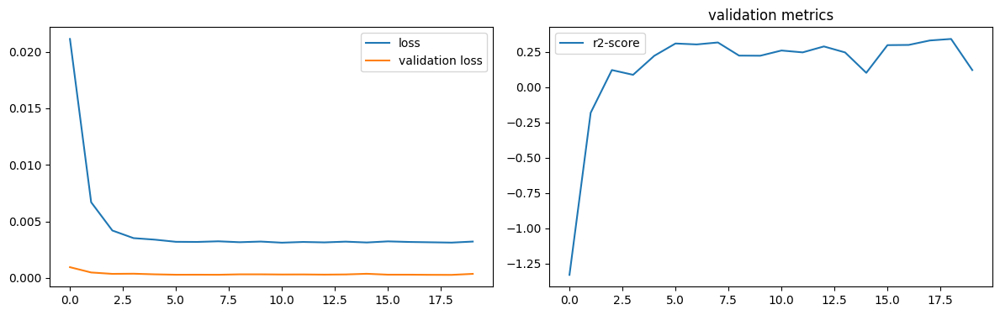

num of dropped: 52
Test: loss: 0.027163807302713394, avg metrics: (0.0764725685119629,)
dropping feature: (25, 'neuron56')


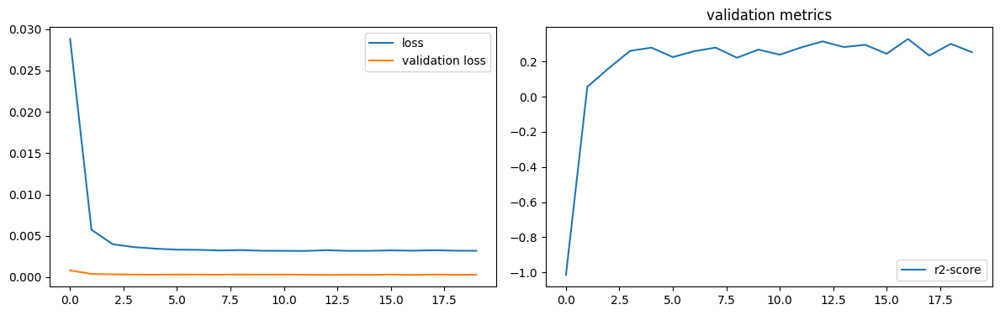

num of dropped: 53
Test: loss: 0.02598247490823269, avg metrics: (0.09117072820663452,)
dropping feature: (34, 'neuron74')


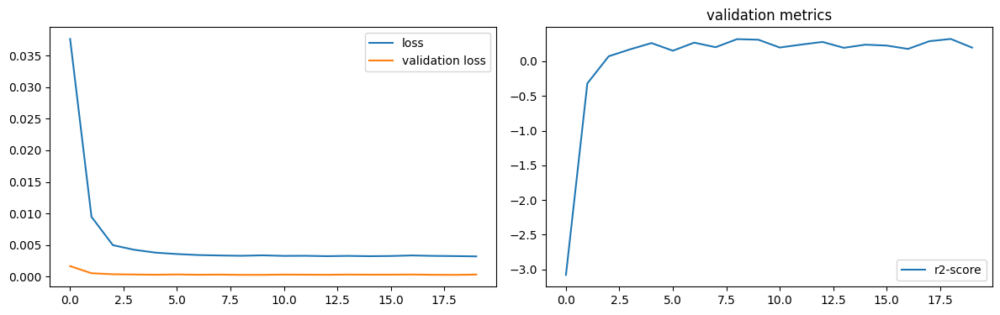

num of dropped: 54
Test: loss: 0.027148718014359474, avg metrics: (0.08132895231246948,)
dropping feature: (37, 'neuron81')


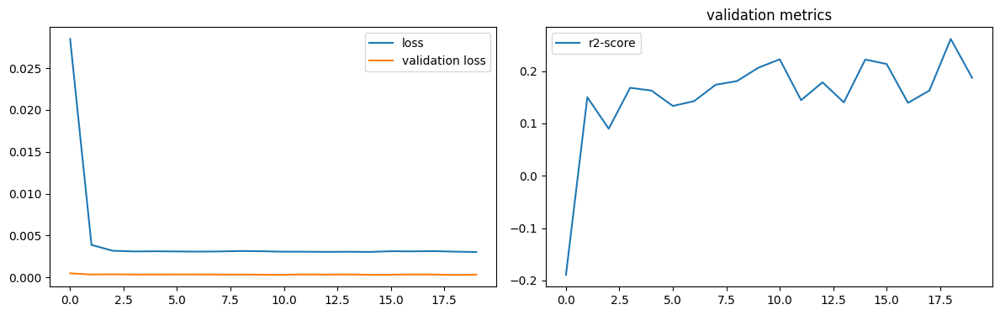

num of dropped: 55
Test: loss: 0.02414761483669281, avg metrics: (0.1116667628288269,)
dropping feature: (40, 'neuron89')


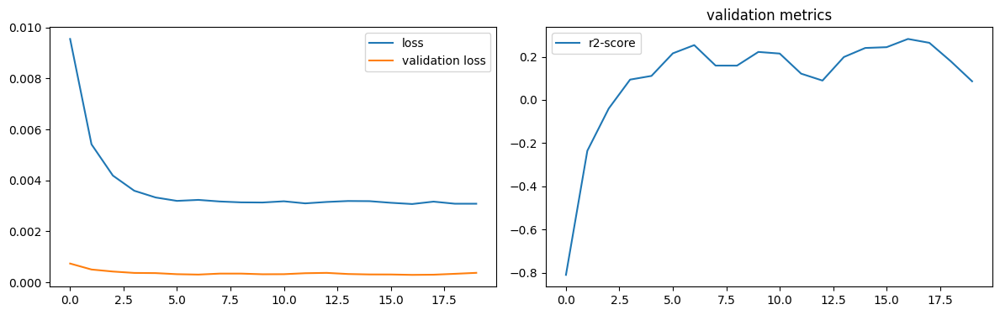

num of dropped: 56
Test: loss: 0.02529364638030529, avg metrics: (0.09561704397201538,)
dropping feature: (2, 'neuron12')


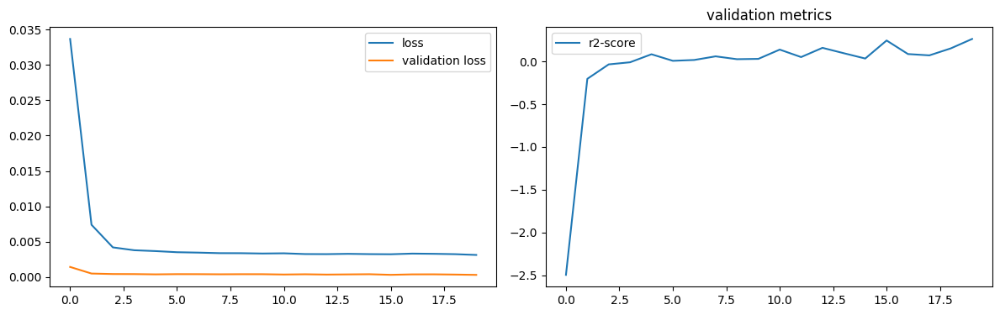

num of dropped: 57
Test: loss: 0.02599993534386158, avg metrics: (0.06221659183502197,)
dropping feature: (29, 'neuron67')


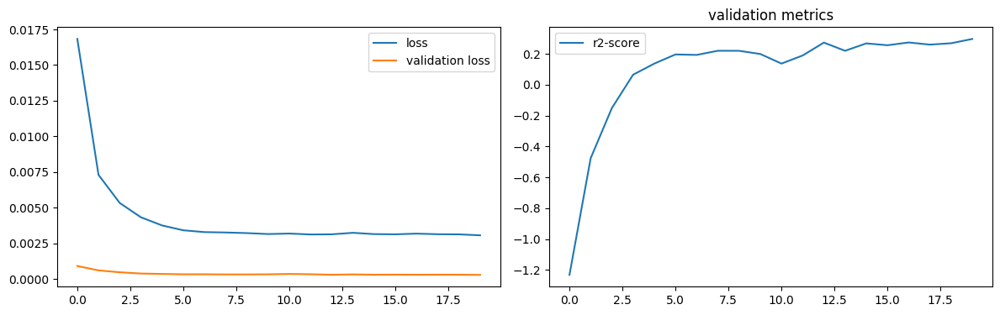

num of dropped: 58
Test: loss: 0.02587159350514412, avg metrics: (0.10751290321350097,)
dropping feature: (18, 'neuron37')


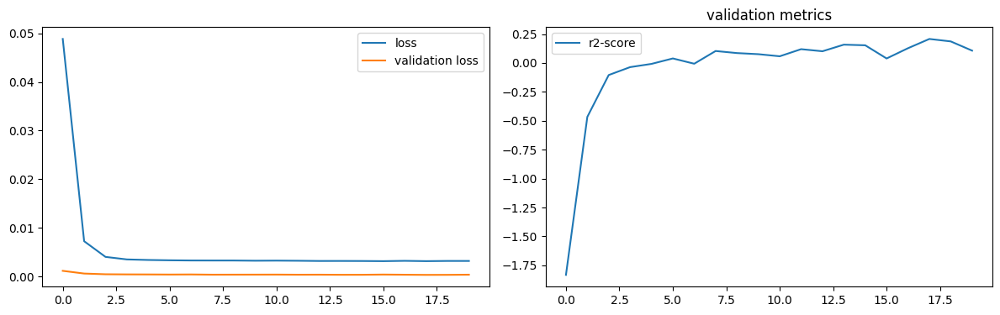

num of dropped: 59
Test: loss: 0.025212358683347702, avg metrics: (0.09092792272567748,)
dropping feature: (10, 'neuron26')


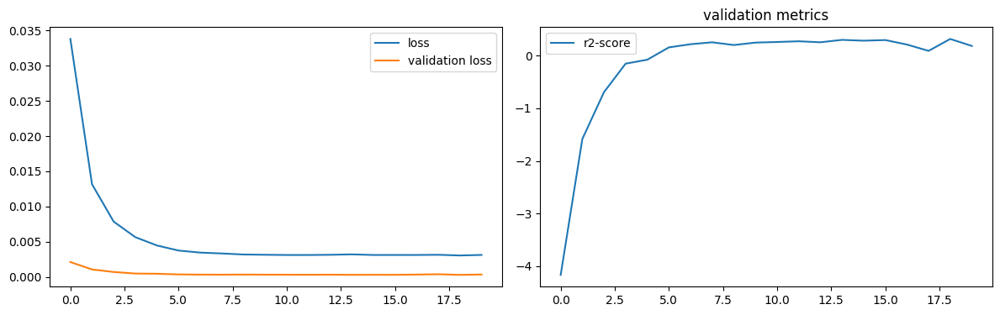

num of dropped: 60
Test: loss: 0.026034248992800713, avg metrics: (0.07245876789093017,)
dropping feature: (27, 'neuron68')


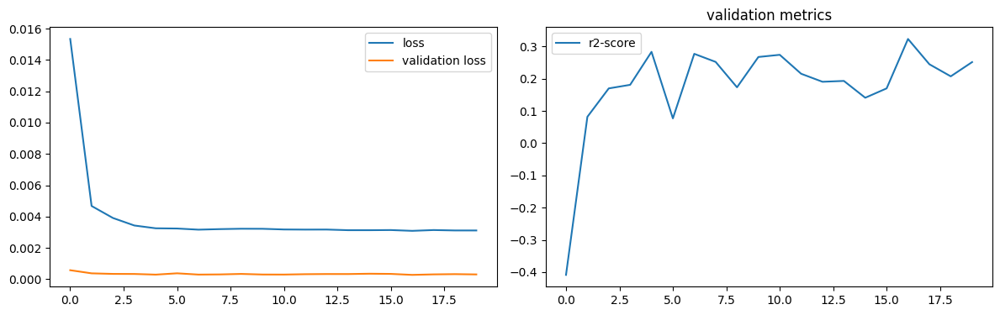

num of dropped: 61
Test: loss: 0.025997167453169823, avg metrics: (0.0675811529159546,)
dropping feature: (7, 'neuron22')


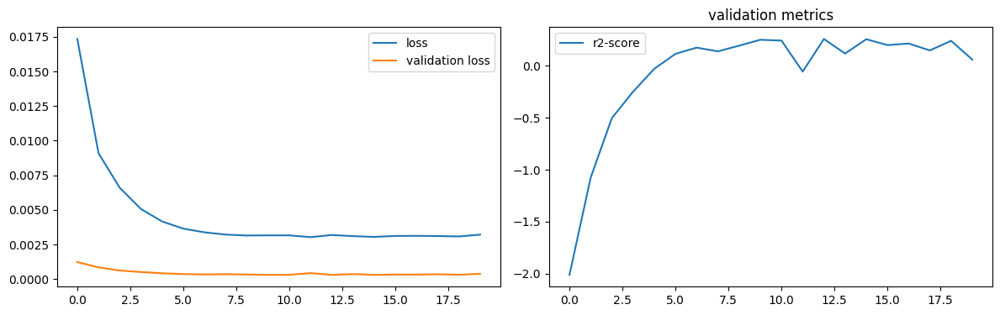

num of dropped: 62
Test: loss: 0.02609739825129509, avg metrics: (0.10072575807571411,)
dropping feature: (35, 'neuron93')


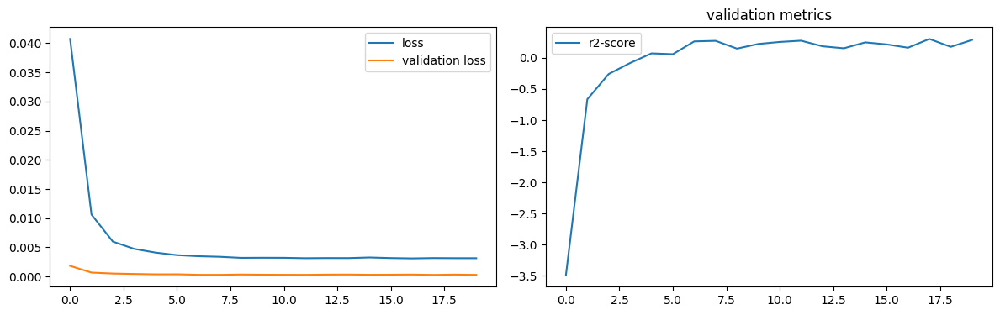

num of dropped: 63
Test: loss: 0.025857146829366684, avg metrics: (0.05655187368392944,)
dropping feature: (0, 'neuron3')


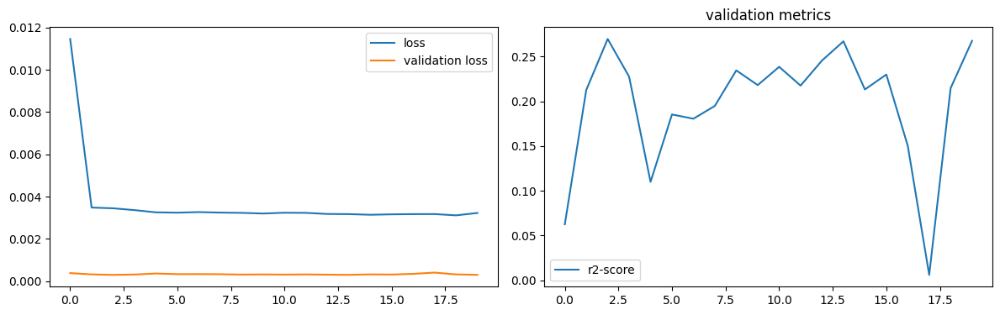

num of dropped: 64
Test: loss: 0.025241142138838768, avg metrics: (0.08981385231018066,)
dropping feature: (17, 'neuron47')


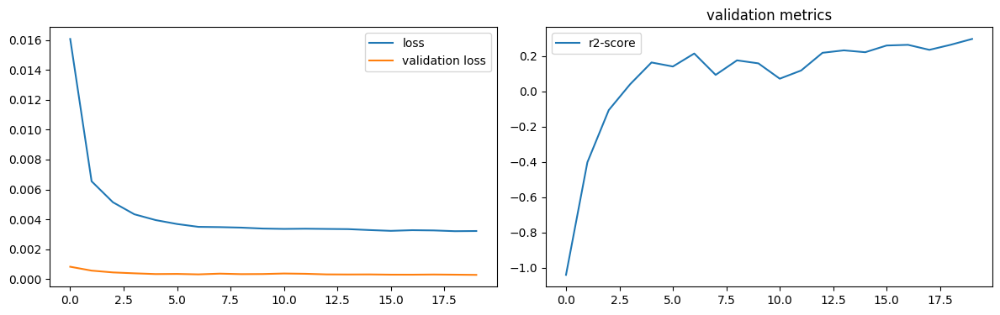

num of dropped: 65
Test: loss: 0.02593396231532097, avg metrics: (0.08305675983428955,)
dropping feature: (31, 'neuron86')


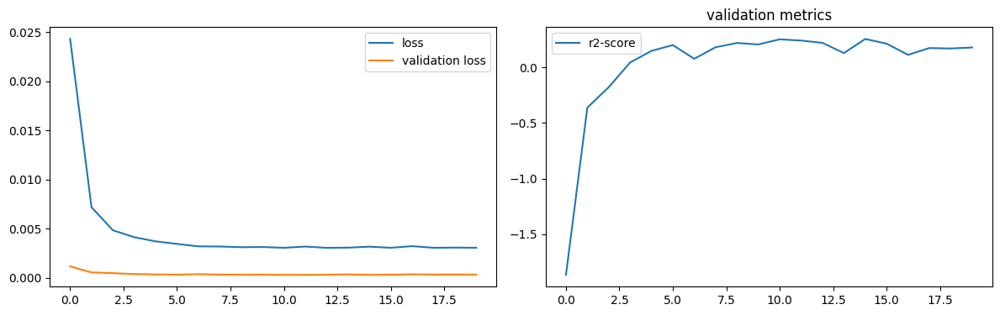

num of dropped: 66
Test: loss: 0.024617034941911697, avg metrics: (0.10242540836334228,)
dropping feature: (14, 'neuron36')


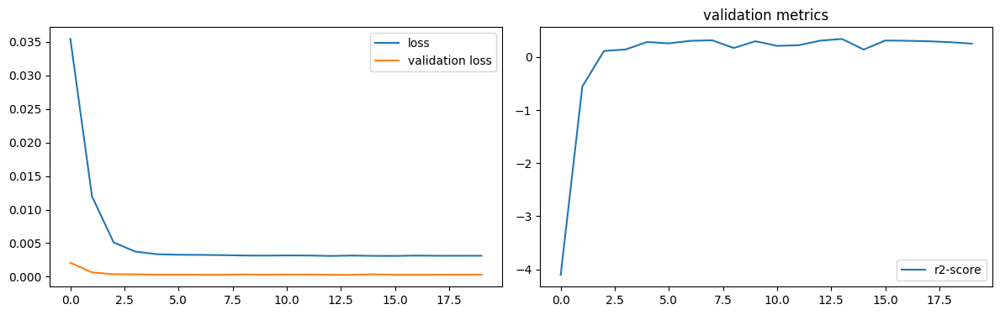

num of dropped: 67
Test: loss: 0.026143765076994896, avg metrics: (0.06977876424789428,)
dropping feature: (11, 'neuron31')


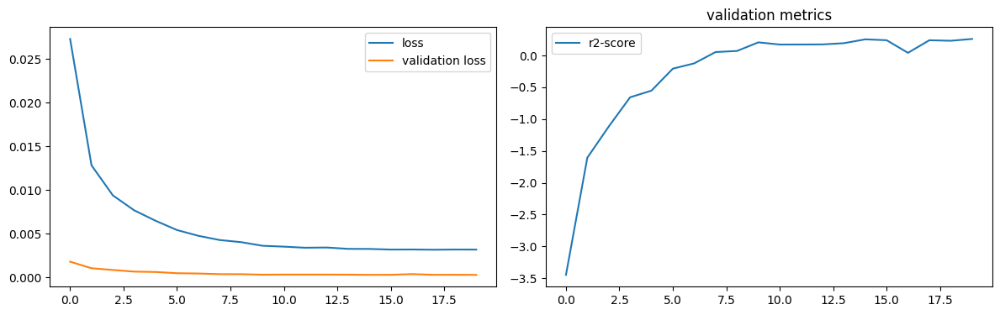

num of dropped: 68
Test: loss: 0.02593851089477539, avg metrics: (0.0908596396446228,)
dropping feature: (18, 'neuron60')


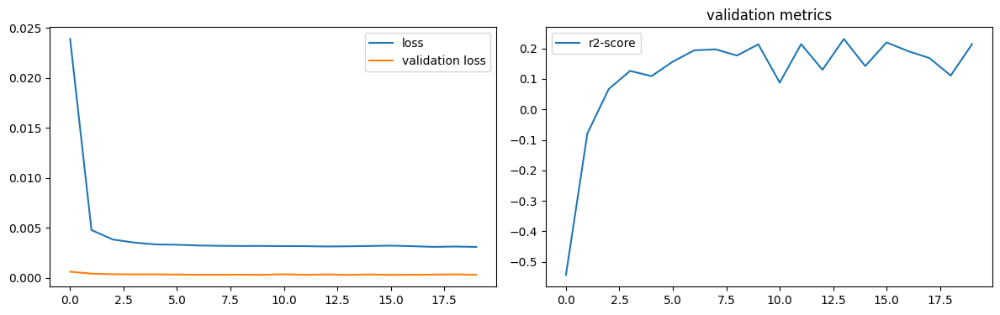

num of dropped: 69
Test: loss: 0.02486133575439453, avg metrics: (0.08125243186950684,)
dropping feature: (6, 'neuron24')


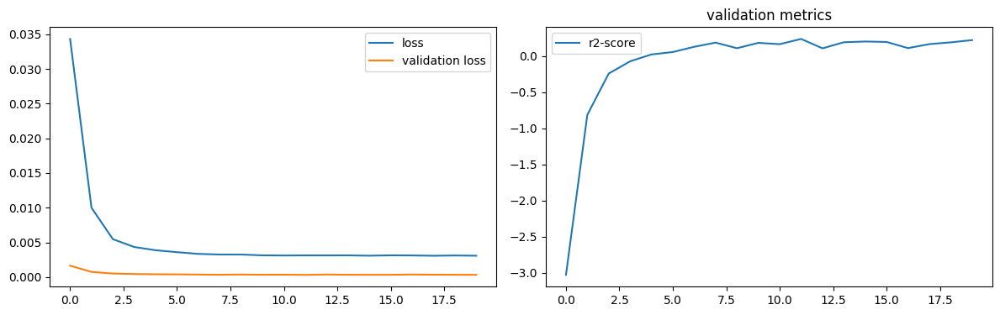

num of dropped: 70
Test: loss: 0.024448666721582413, avg metrics: (0.08928312063217163,)
dropping feature: (10, 'neuron32')


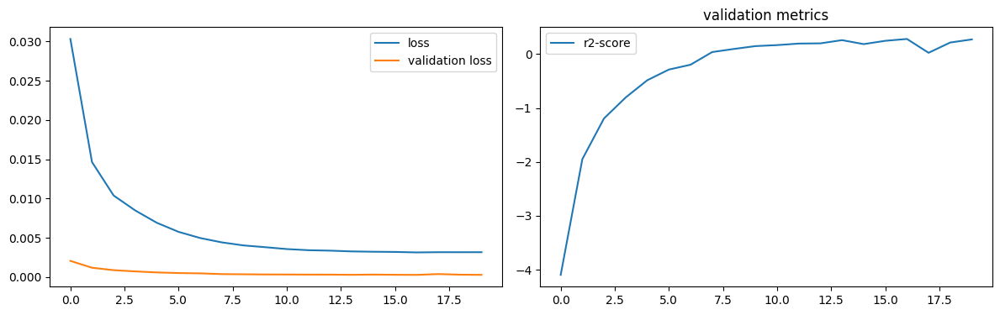

num of dropped: 71
Test: loss: 0.025671014562249184, avg metrics: (0.10872076749801636,)
dropping feature: (1, 'neuron13')


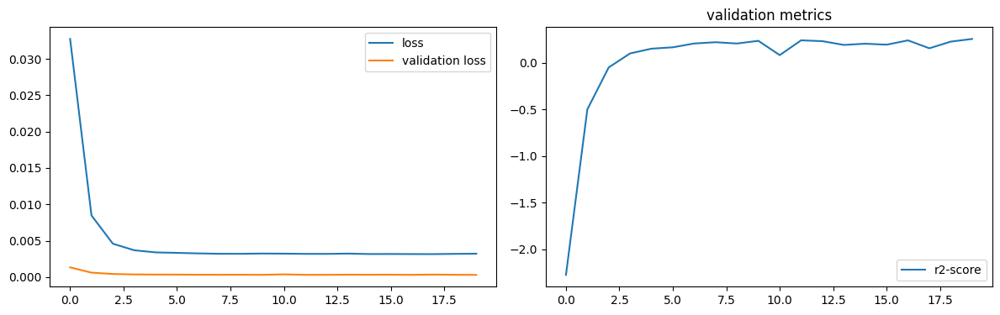

num of dropped: 72
Test: loss: 0.026644578203558922, avg metrics: (0.09206273555755615,)
dropping feature: (8, 'neuron30')


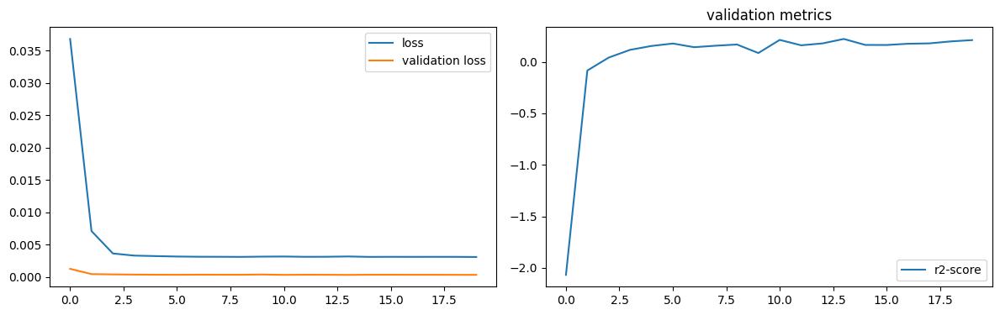

num of dropped: 73
Test: loss: 0.024725358933210373, avg metrics: (0.07638361454010009,)
dropping feature: (6, 'neuron27')


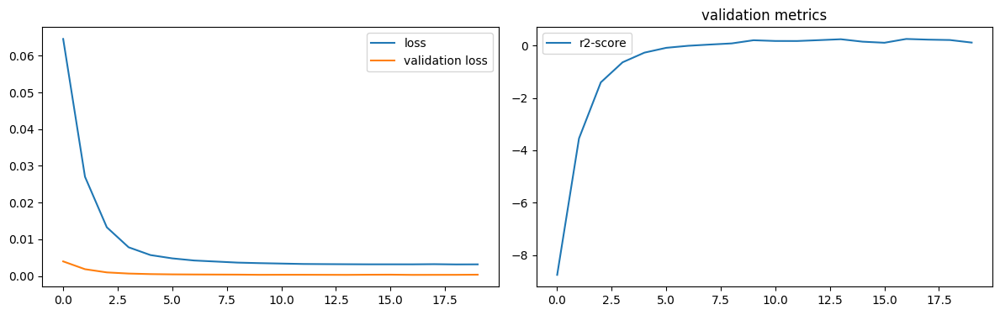

num of dropped: 74
Test: loss: 0.02611803449690342, avg metrics: (0.10267213582992554,)
dropping feature: (7, 'neuron35')


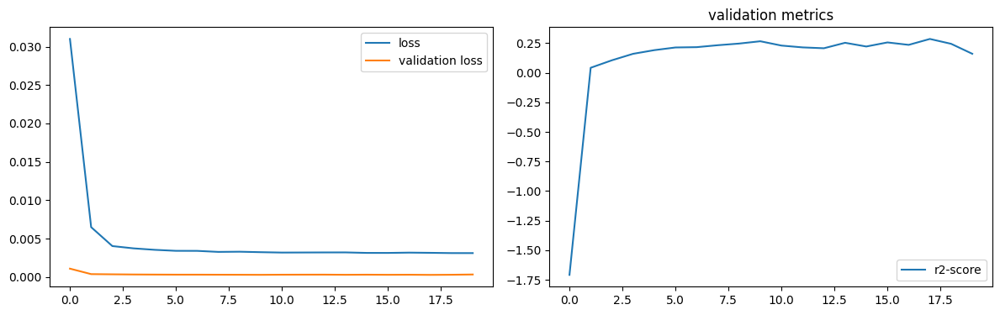

num of dropped: 75
Test: loss: 0.026678424328565598, avg metrics: (0.09755650758743287,)
dropping feature: (24, 'neuron98')


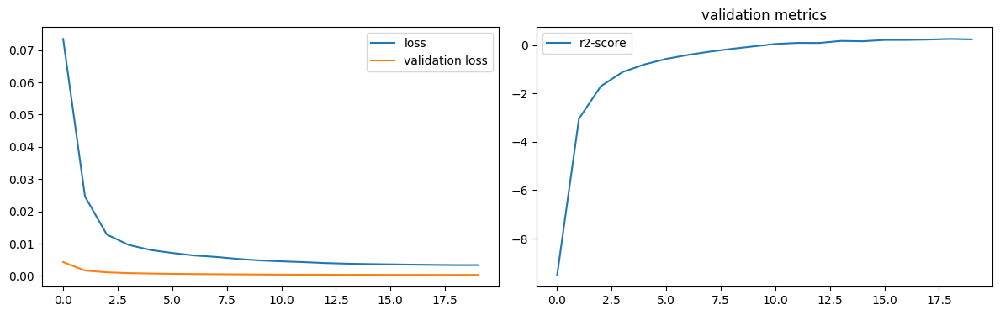

num of dropped: 76
Test: loss: 0.02694721519947052, avg metrics: (0.08753098249435425,)
dropping feature: (14, 'neuron64')


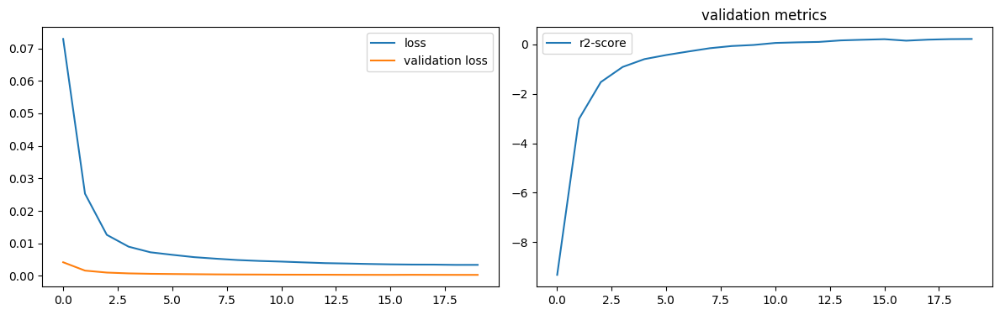

num of dropped: 77
Test: loss: 0.027947092428803444, avg metrics: (0.06295531988143921,)
dropping feature: (0, 'neuron7')


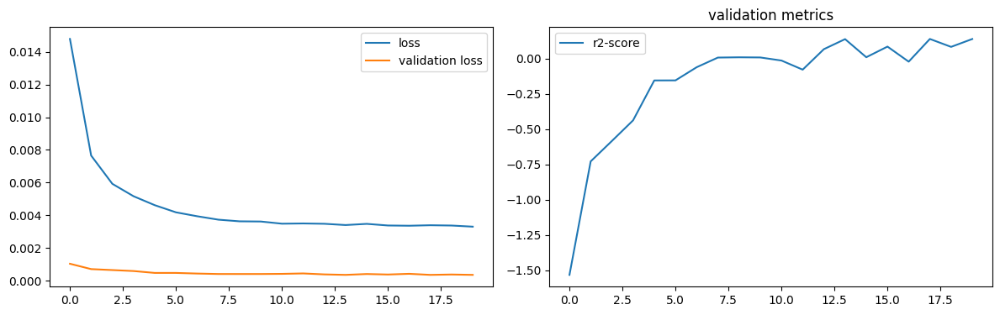

num of dropped: 78
Test: loss: 0.0258899237960577, avg metrics: (0.11254862546920777,)
dropping feature: (15, 'neuron76')


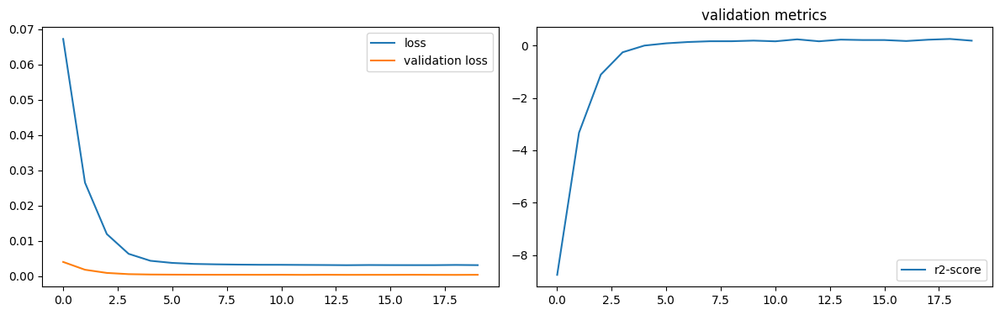

num of dropped: 79
Test: loss: 0.025023557245731354, avg metrics: (0.09116312265396118,)
dropping feature: (19, 'neuron91')


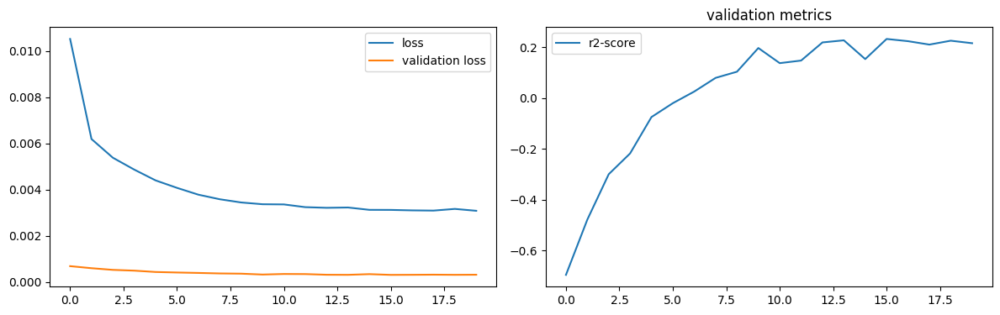

num of dropped: 80
Test: loss: 0.02485577203333378, avg metrics: (0.10836691856384277,)
dropping feature: (7, 'neuron43')


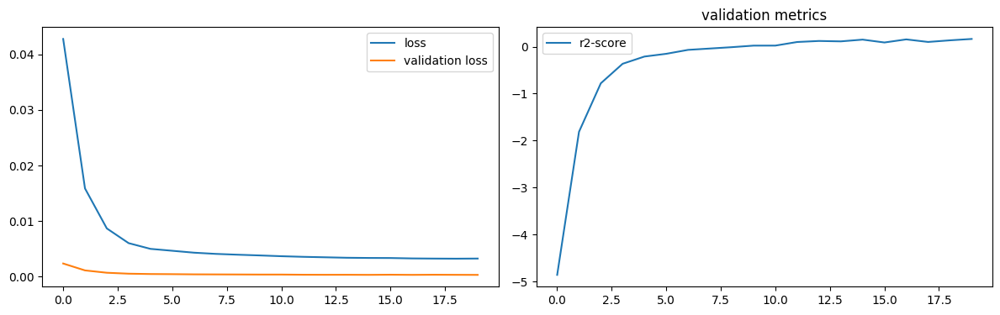

num of dropped: 81
Test: loss: 0.025871610268950462, avg metrics: (0.07606860399246215,)
dropping feature: (4, 'neuron25')


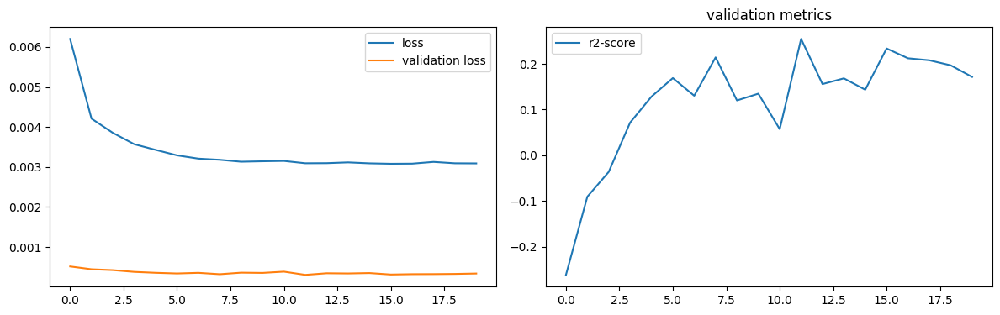

num of dropped: 82
Test: loss: 0.02497895620763302, avg metrics: (0.09054014682769776,)
dropping feature: (0, 'neuron15')


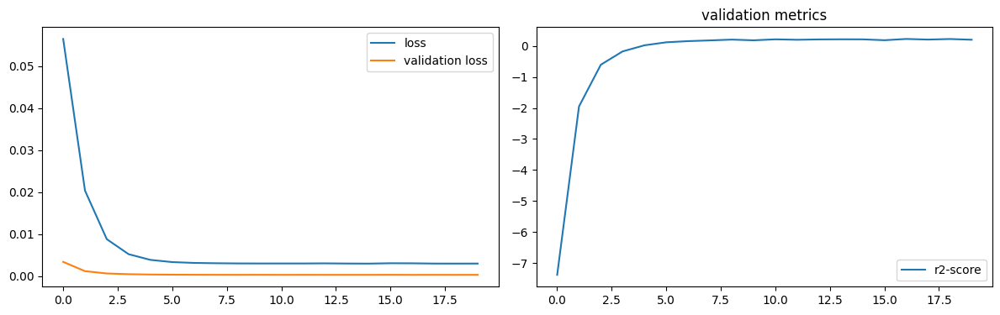

num of dropped: 83
Test: loss: 0.025242028757929802, avg metrics: (0.11695556640625,)
dropping feature: (10, 'neuron70')


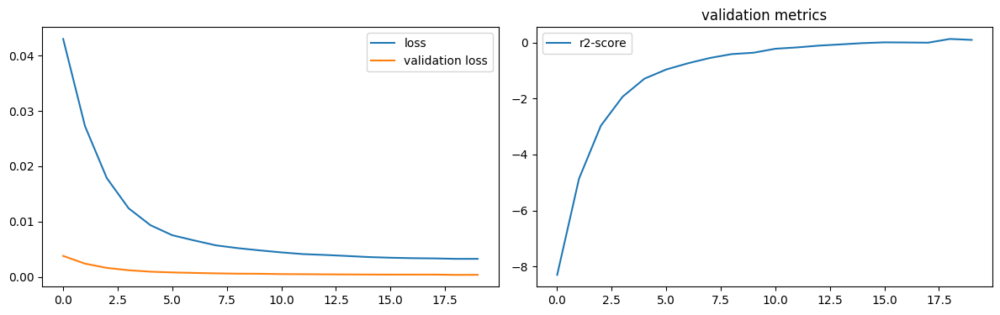

num of dropped: 84
Test: loss: 0.02469795010983944, avg metrics: (0.11192221641540527,)
dropping feature: (6, 'neuron53')


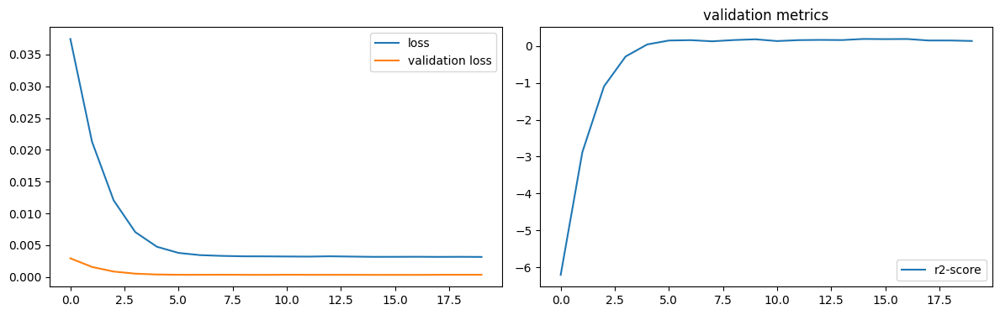

num of dropped: 85
Test: loss: 0.025538254529237747, avg metrics: (0.02281605005264282,)
dropping feature: (6, 'neuron57')


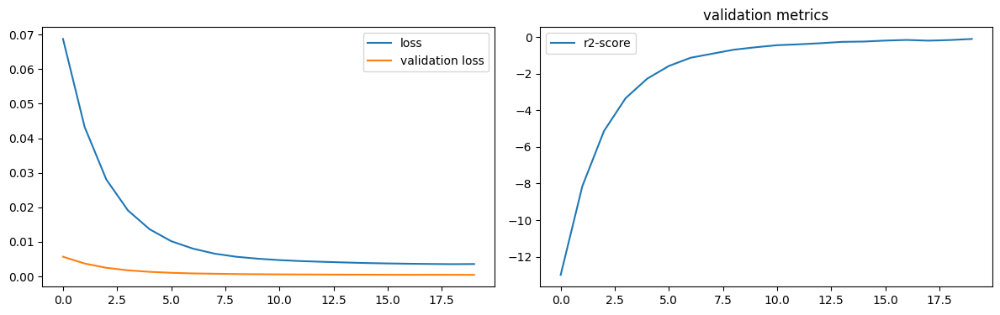

num of dropped: 86
Test: loss: 0.02672666124999523, avg metrics: (0.0734753131866455,)
dropping feature: (3, 'neuron29')


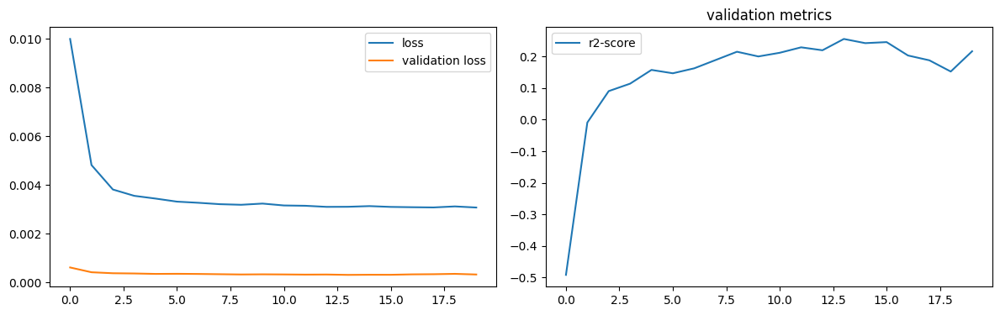

num of dropped: 87
Test: loss: 0.02552134171128273, avg metrics: (0.11434412002563477,)
dropping feature: (10, 'neuron83')


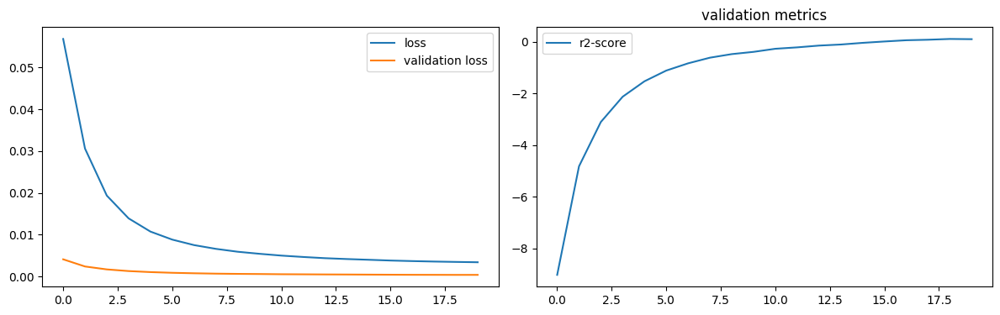

num of dropped: 88
Test: loss: 0.027130167931318283, avg metrics: (0.10975550413131714,)
dropping feature: (1, 'neuron17')


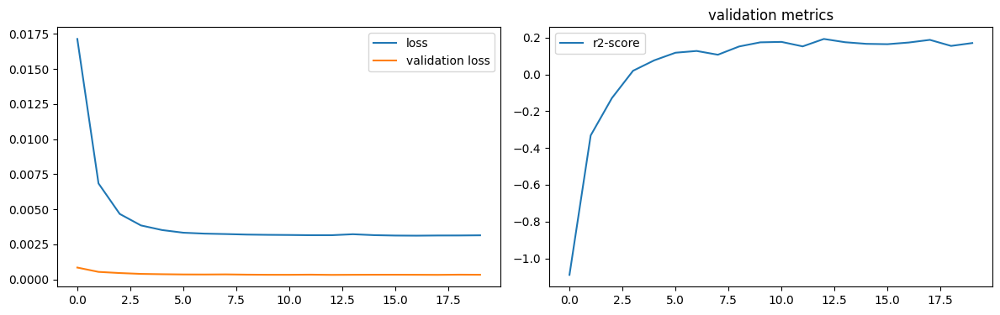

num of dropped: 89
Test: loss: 0.02497059665620327, avg metrics: (0.08979876041412353,)
dropping feature: (8, 'neuron80')


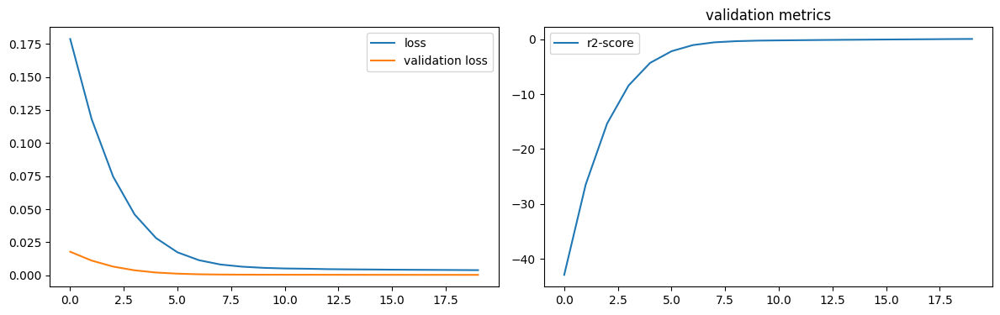

num of dropped: 90
Test: loss: 0.03269876912236214, avg metrics: (-0.0028372645378112794,)
dropping feature: (3, 'neuron49')


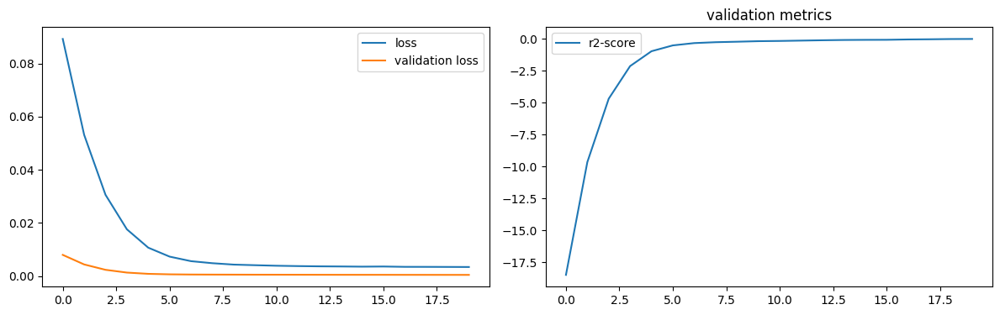

num of dropped: 91
Test: loss: 0.02526349015533924, avg metrics: (0.07039304971694946,)
dropping feature: (4, 'neuron63')


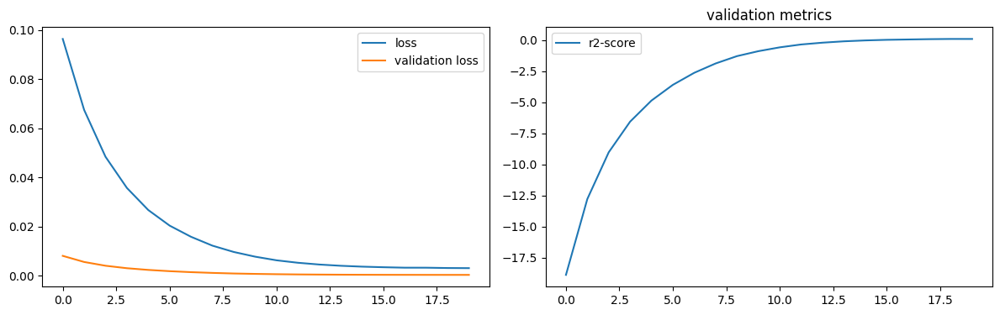

num of dropped: 92
Test: loss: 0.024155884981155396, avg metrics: (-0.10435595512390136,)
dropping feature: (5, 'neuron77')


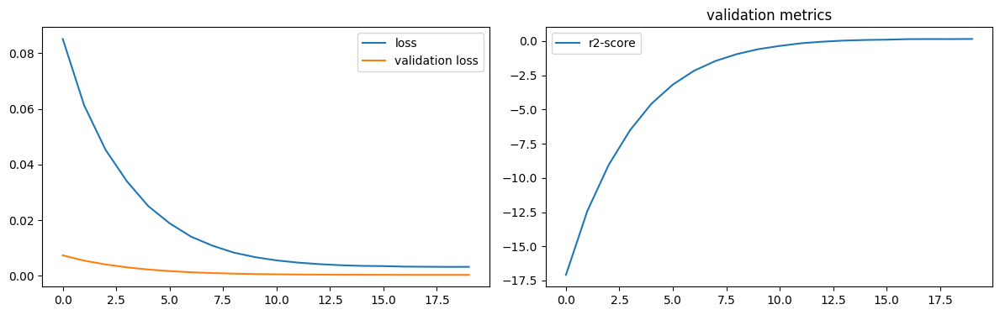

num of dropped: 93
Test: loss: 0.025421783328056335, avg metrics: (0.0461311936378479,)
dropping feature: (4, 'neuron72')


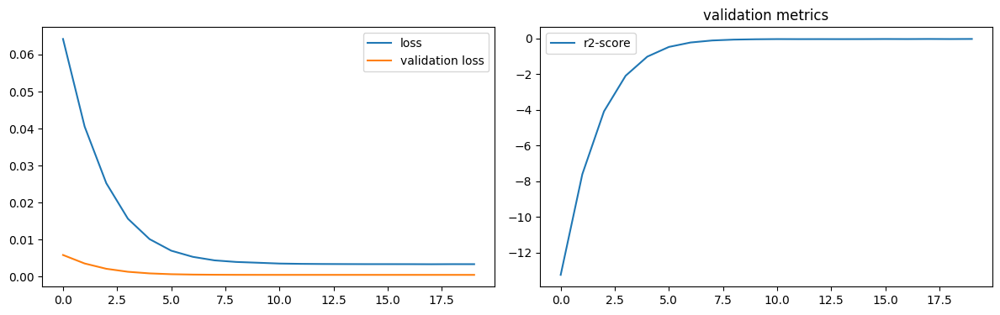

num of dropped: 94
Test: loss: 0.025437023490667343, avg metrics: (0.03676761388778686,)
dropping feature: (5, 'neuron94')


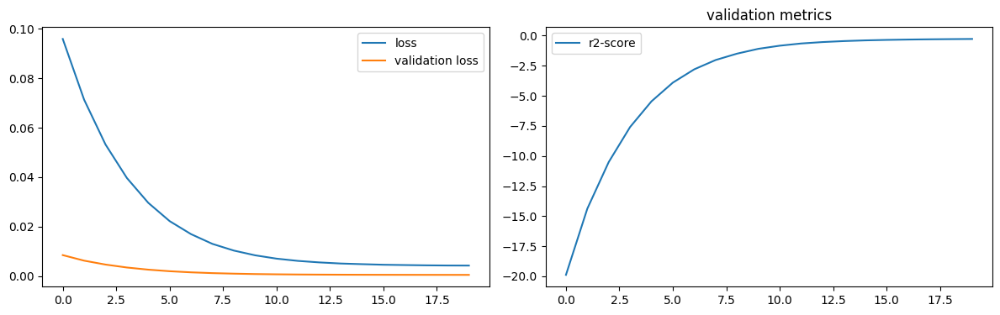

num of dropped: 95
Test: loss: 0.0337955541908741, avg metrics: (-0.1546944260597229,)
dropping feature: (0, 'neuron16')


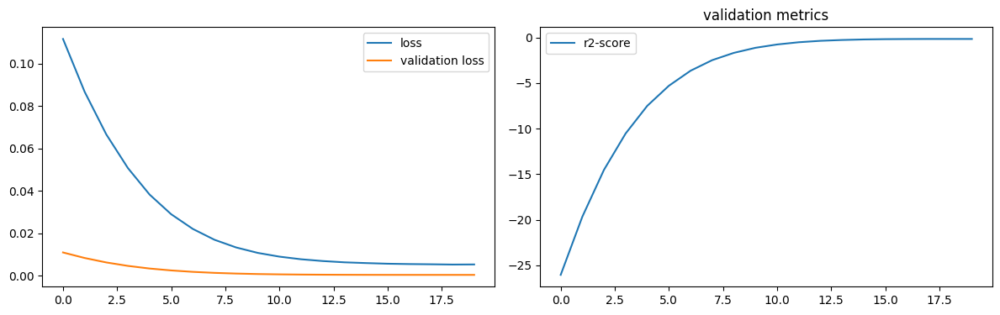

num of dropped: 96
Test: loss: 0.043334465473890305, avg metrics: (-0.2285372495651245,)
dropping feature: (2, 'neuron62')


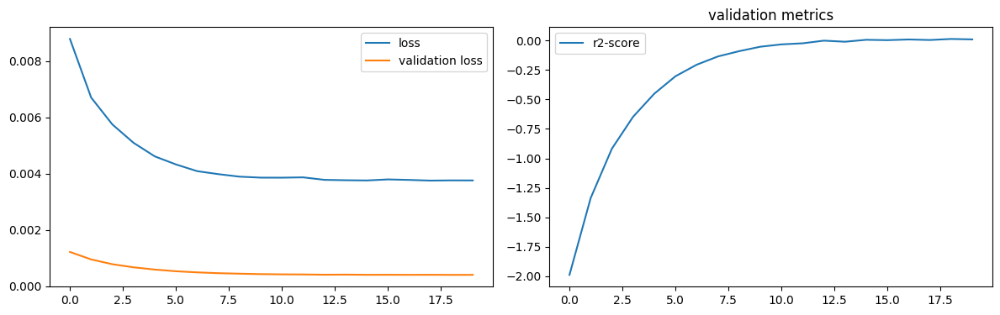

num of dropped: 97
Test: loss: 0.030136730521917343, avg metrics: (-0.9352566957473755,)
dropping feature: (2, 'neuron84')


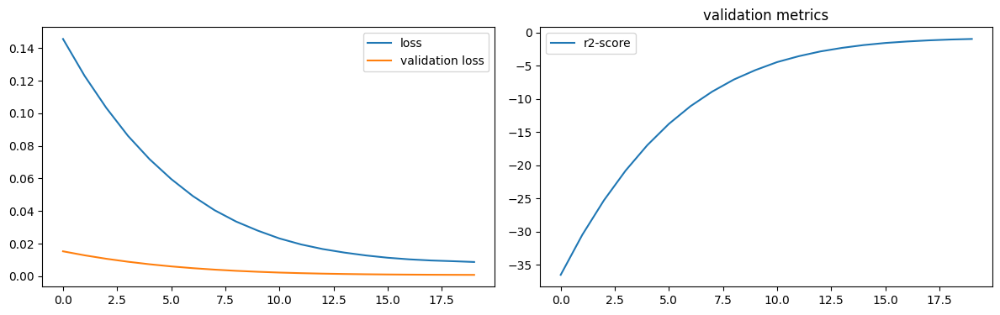

num of dropped: 98
Test: loss: 0.06862431019544601, avg metrics: (-2.256272923946381,)
dropping feature: (1, 'neuron41')


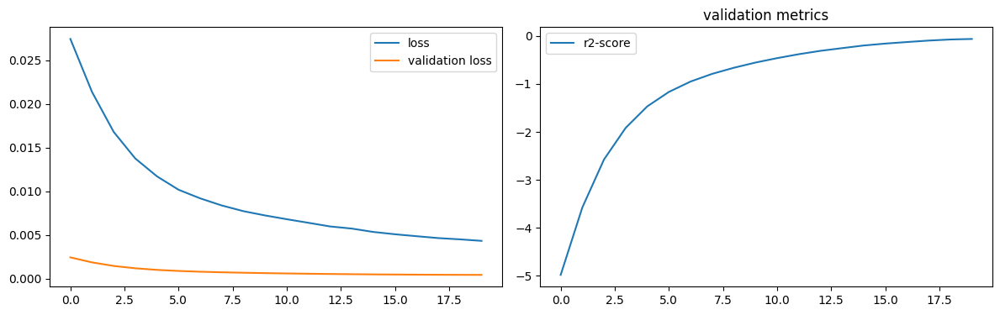

num of dropped: 99
Test: loss: 0.03360285982489586, avg metrics: (-0.5753040790557862,)


In [20]:
torch.manual_seed(2024)

headers = [f"neuron{i}" for i in range(100)]


def model_factory(size):
    model = StudentsNN(1, (1, size))
    model.layer1 = nn.Identity()
    model.layer2 = nn.Identity()
    return model


test_metrics, dropped, models = prune(
    datasets, headers, analyze_dgsm,
    model_factory, optimizer_factory, criterion, score_outputs, 20,
    labels, "", None
)

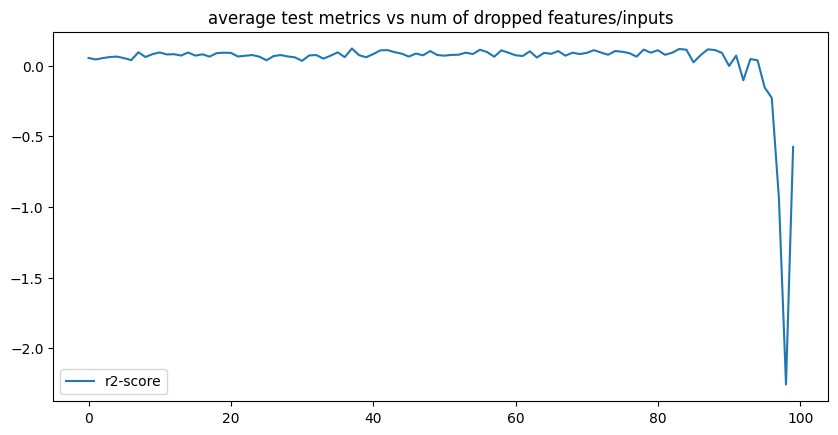

In [21]:
plot_dropping_metrics(test_metrics, labels)

In [22]:
num_drop_neurons = 87

save_models("students", "dgsm-layer3", models, dropped)

reduced_datasets, reduced_headers = reduce_datasets(datasets, headers, dropped, num_drop_neurons)
layer = models[num_drop_neurons].out

best_model.out = layer
best_model.layer2[0] = reduce_linear(best_model.layer2[0], dropped, num_drop_neurons)
best_model.layer2[1] = nn.BatchNorm1d(100 - num_drop_neurons)

features left [13]:  ['neuron16', 'neuron17', 'neuron18', 'neuron41', 'neuron49', 'neuron62', 'neuron63', 'neuron72', 'neuron77', 'neuron80', 'neuron83', 'neuron84', 'neuron94']


### pruned

In [23]:
best_model

StudentsNN(
  (layer1): Sequential(
    (0): Linear(in_features=3, out_features=3, bias=True)
    (1): BatchNorm1d(3, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (layer2): Sequential(
    (0): Linear(in_features=3, out_features=13, bias=True)
    (1): BatchNorm1d(13, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (out): Linear(in_features=13, out_features=1, bias=True)
)

In [24]:
best_model.eval()
with torch.no_grad():
    inputs, targets = dgsm_datasets["test"][:]
    outputs = best_model(inputs)

    test_metrics = score_outputs(outputs, targets)

print(f"test {labels}: {test_metrics}")

test r2-score: (-1.6217083930969238,)


test: r2-score: (0.059829771518707275,)


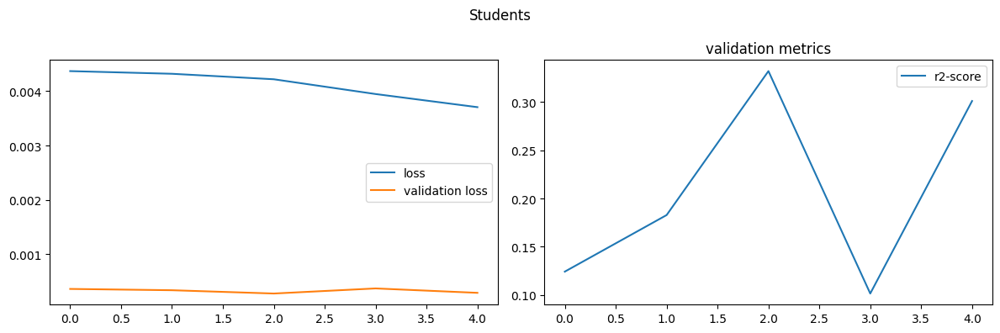

In [25]:
optimizer = optimizer_factory(best_model)
metrics = model_train(dgsm_datasets, best_model, optimizer, criterion, score_outputs, 5)

best_model.eval()
with torch.no_grad():
    inputs, targets = dgsm_datasets["test"][:]
    outputs = best_model(inputs)

    test_metrics = score_outputs(outputs, targets)

print(f"test: {labels}: {test_metrics}")
plot_metrics('Students', metrics, labels)

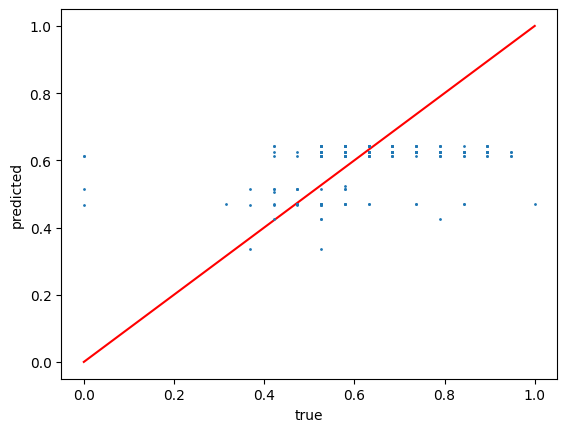

In [26]:
plt.plot([0, 1], [0, 1], c='r')
plt.plot(datasets["test"].tensors[1], outputs, '.', ms=2)
plt.xlabel("true")
plt.ylabel("predicted")
plt.show()

In [27]:
save_models("students", "dgsm-prunned", [best_model], None)

## FAST

In [28]:
best_model = StudentsNN()

### input layer

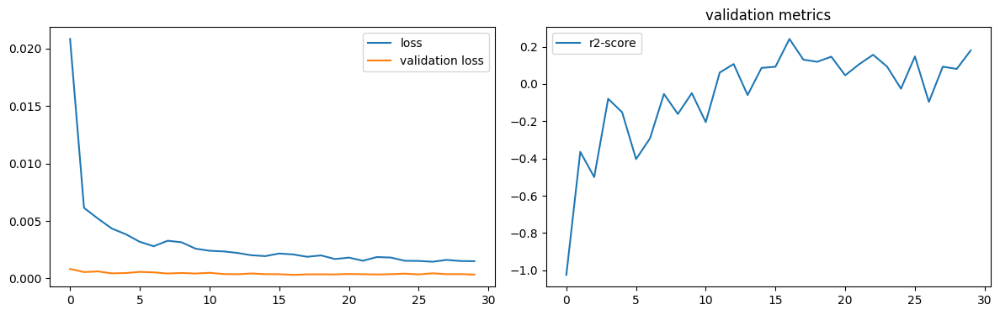

num of dropped: 0
Test: loss: 0.03081713430583477, avg metrics: (-0.10887384414672852,)
dropping feature: (22, 'romantic')


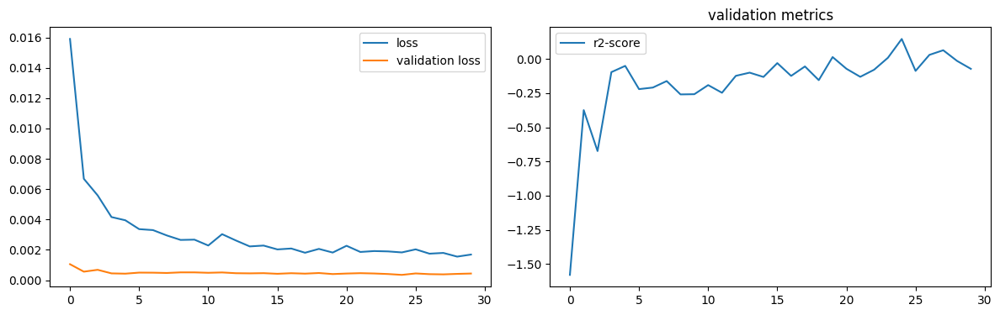

num of dropped: 1
Test: loss: 0.028301922604441643, avg metrics: (-0.11752529144287109,)
dropping feature: (5, 'Pstatus')


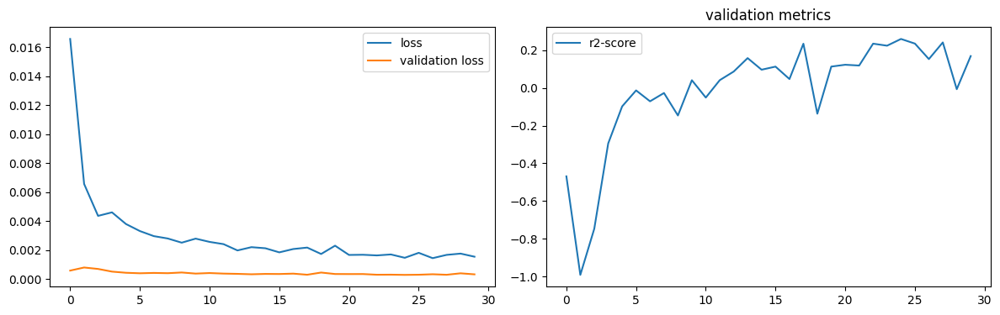

num of dropped: 2
Test: loss: 0.030535047873854637, avg metrics: (-0.049854469299316403,)
dropping feature: (19, 'higher')


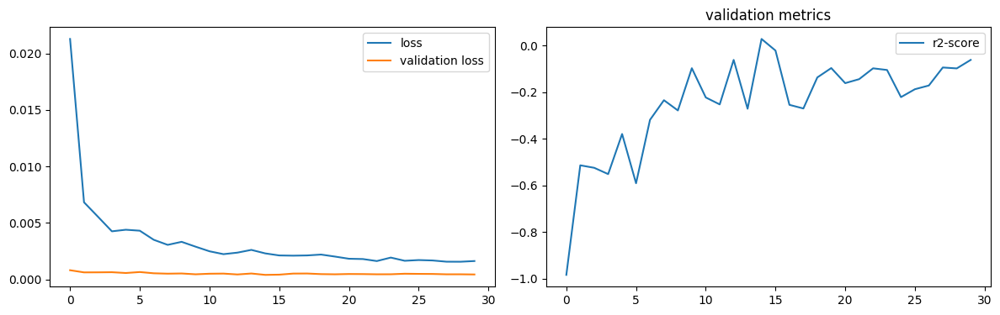

num of dropped: 3
Test: loss: 0.03386889770627022, avg metrics: (-0.17662577629089354,)
dropping feature: (11, 'traveltime')


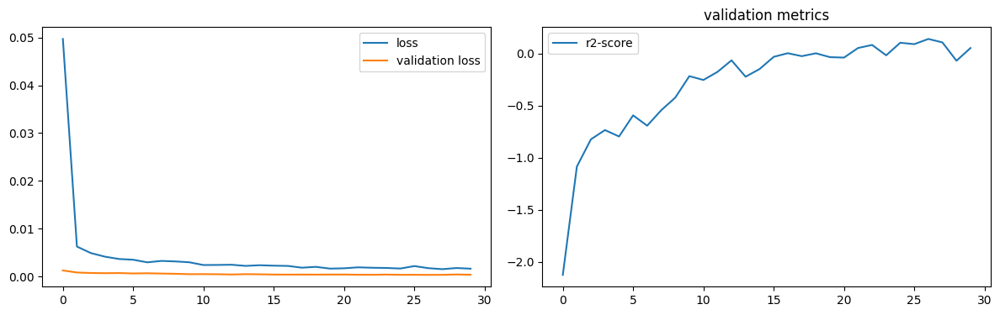

num of dropped: 4
Test: loss: 0.03058628924190998, avg metrics: (-0.0727113962173462,)
dropping feature: (15, 'paid')


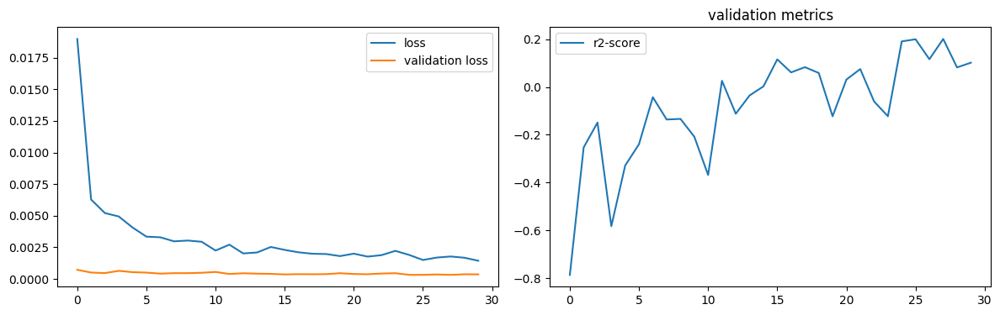

num of dropped: 5
Test: loss: 0.028116028755903244, avg metrics: (-0.05875370502471924,)
dropping feature: (6, 'Fedu')


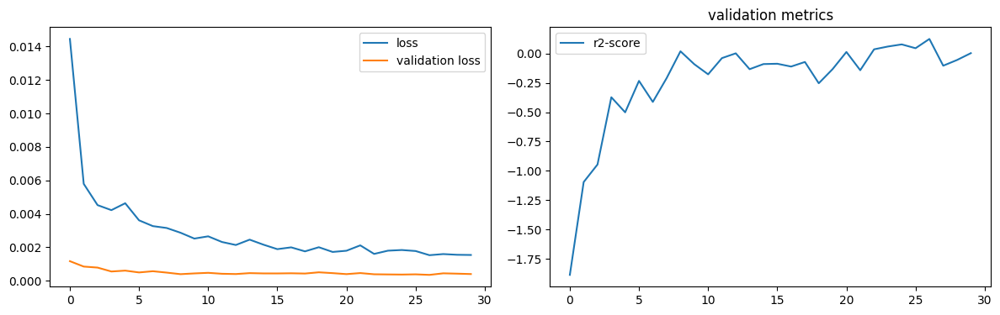

num of dropped: 6
Test: loss: 0.027353884652256966, avg metrics: (-0.07860887050628662,)
dropping feature: (22, 'health')


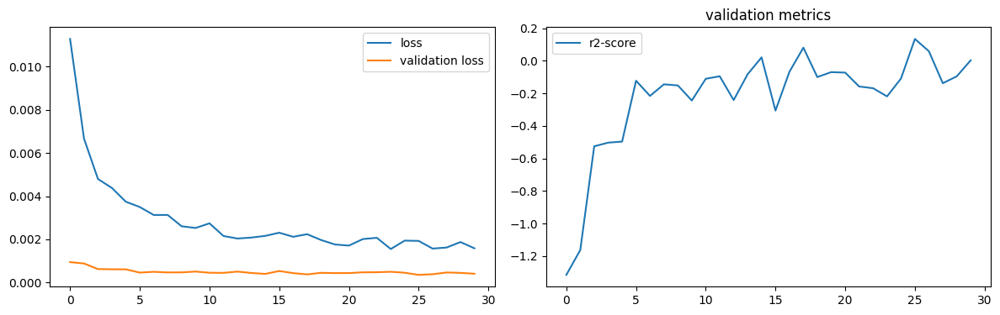

num of dropped: 7
Test: loss: 0.03122277557849884, avg metrics: (-0.1008294939994812,)
dropping feature: (22, 'absences')


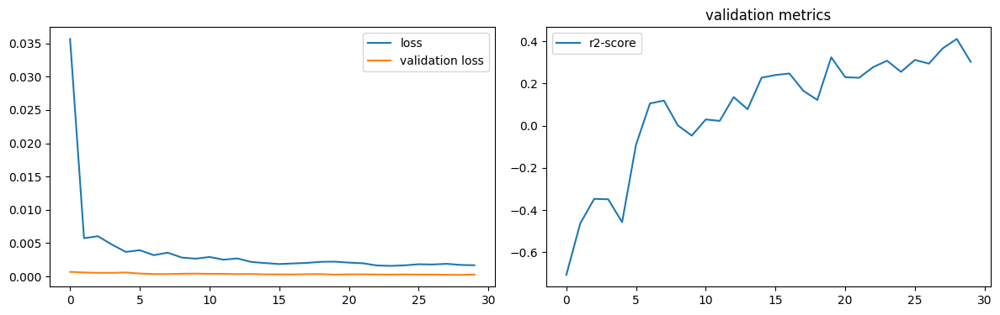

num of dropped: 8
Test: loss: 0.033431265503168106, avg metrics: (-0.037803030014038085,)
dropping feature: (19, 'goout')


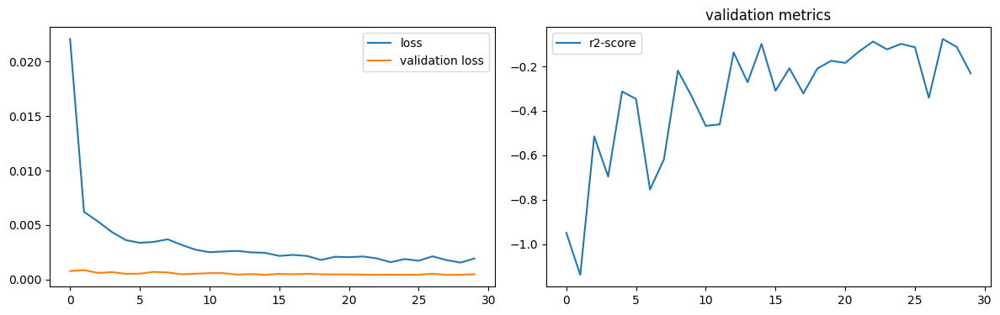

num of dropped: 9
Test: loss: 0.02803746797144413, avg metrics: (-0.0460188627243042,)
dropping feature: (15, 'nursery')


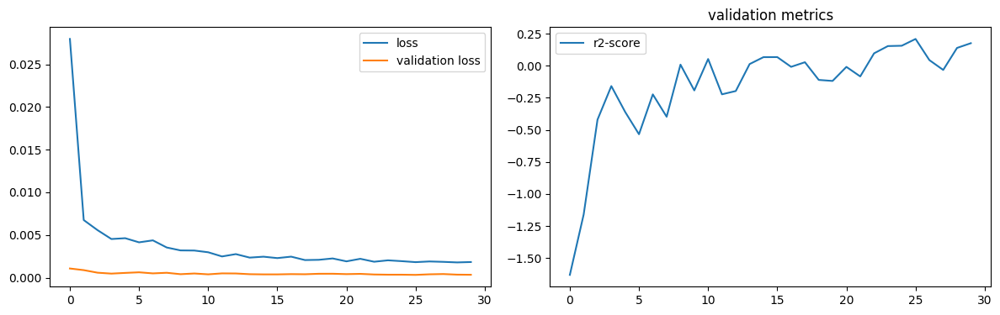

num of dropped: 10
Test: loss: 0.027261914685368538, avg metrics: (-0.11602547168731689,)
dropping feature: (15, 'internet')


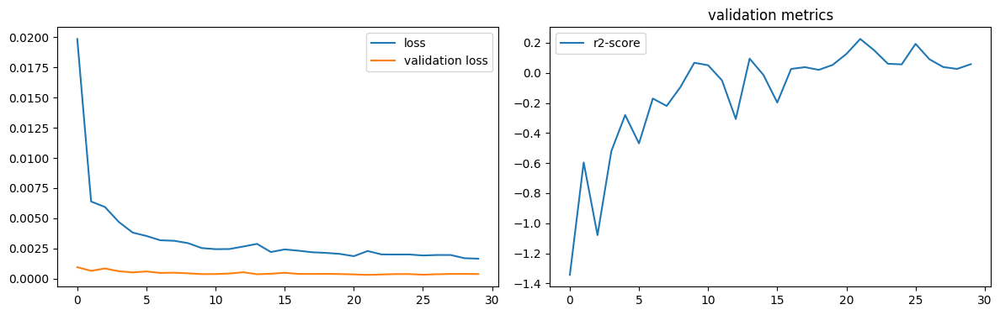

num of dropped: 11
Test: loss: 0.02873224951326847, avg metrics: (-0.06634020805358887,)
dropping feature: (7, 'Fjob')


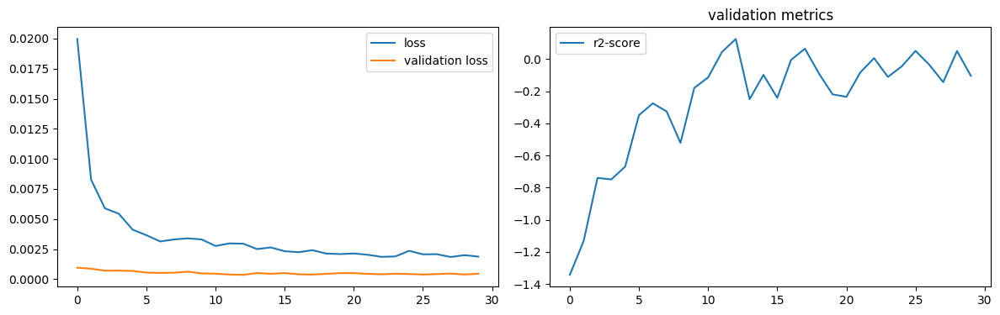

num of dropped: 12
Test: loss: 0.030433669686317444, avg metrics: (-0.04318234920501709,)
dropping feature: (15, 'freetime')


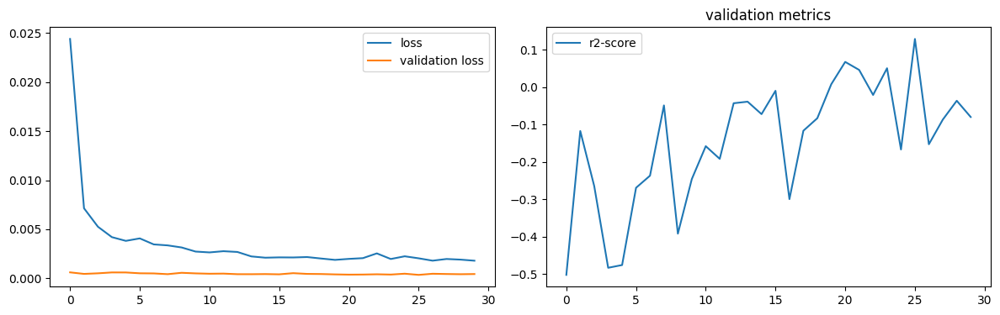

num of dropped: 13
Test: loss: 0.027088910341262817, avg metrics: (-0.06534359455108643,)
dropping feature: (7, 'reason')


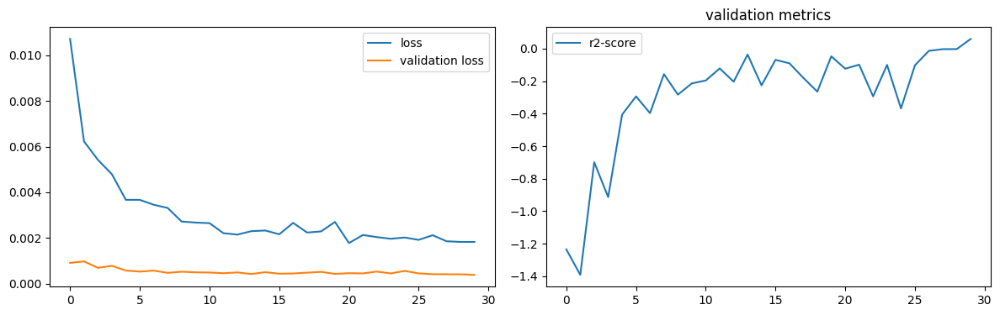

num of dropped: 14
Test: loss: 0.02942906878888607, avg metrics: (-0.09364738464355468,)
dropping feature: (1, 'sex')


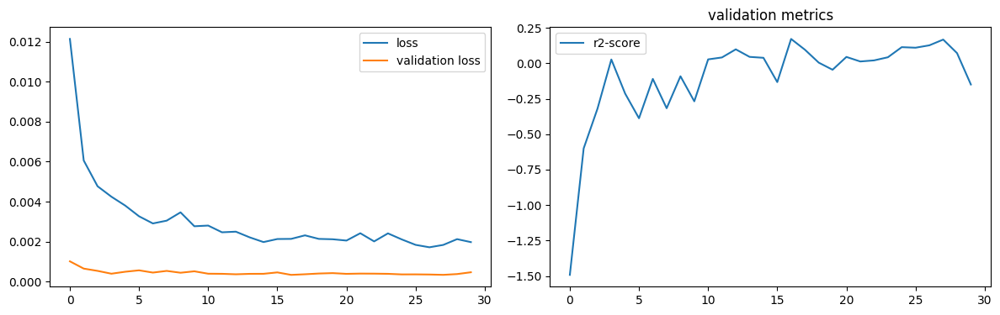

num of dropped: 15
Test: loss: 0.031970568001270294, avg metrics: (-0.08653007745742798,)
dropping feature: (12, 'famrel')


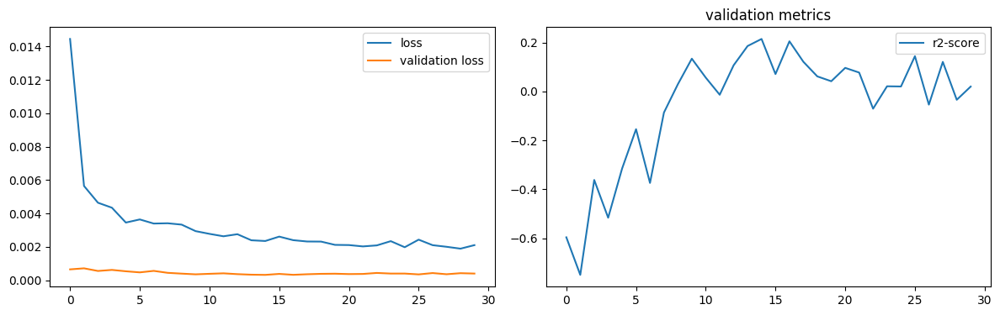

num of dropped: 16
Test: loss: 0.029734468087553978, avg metrics: (-0.13827826976776122,)
dropping feature: (5, 'Mjob')


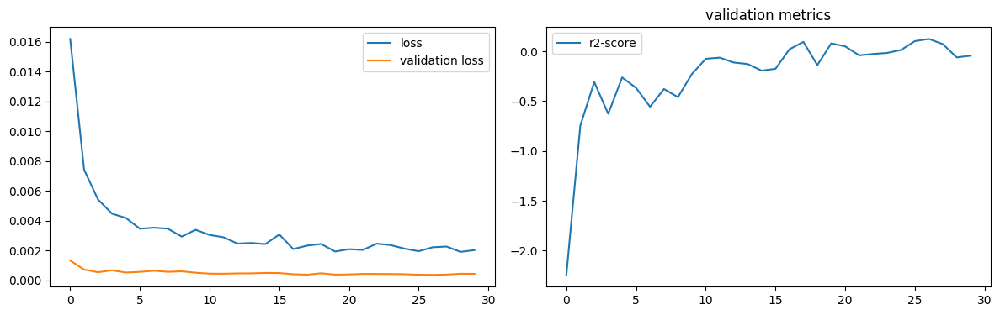

num of dropped: 17
Test: loss: 0.029219411313533783, avg metrics: (-0.0822867512702942,)
dropping feature: (12, 'Walc')


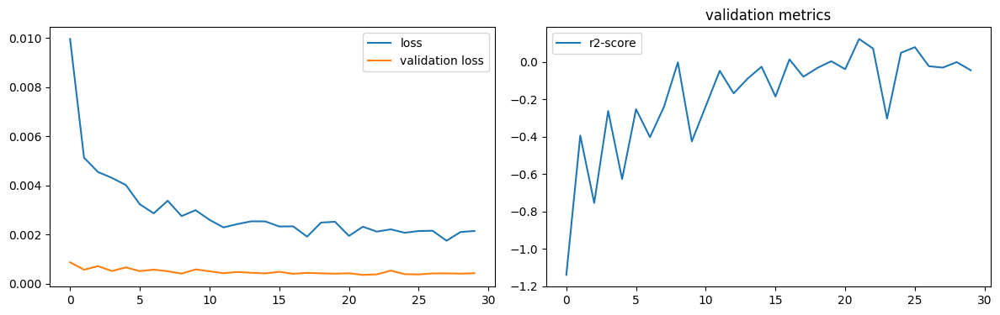

num of dropped: 18
Test: loss: 0.028844524174928665, avg metrics: (-0.16086649894714355,)
dropping feature: (5, 'guardian')


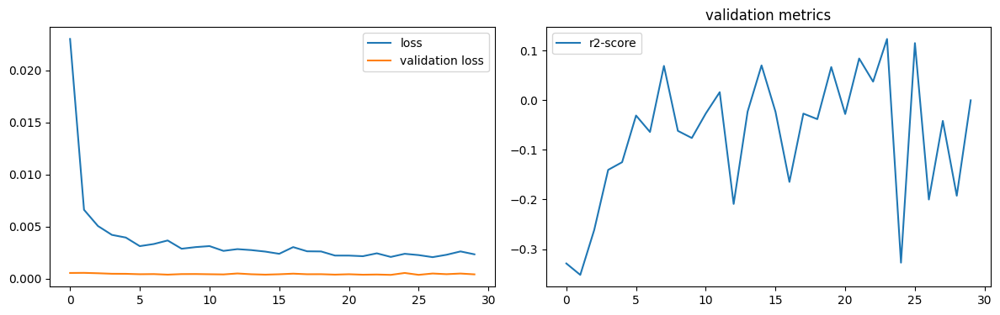

num of dropped: 19
Test: loss: 0.02798677422106266, avg metrics: (-0.01518782377243042,)
dropping feature: (7, 'schoolsup')


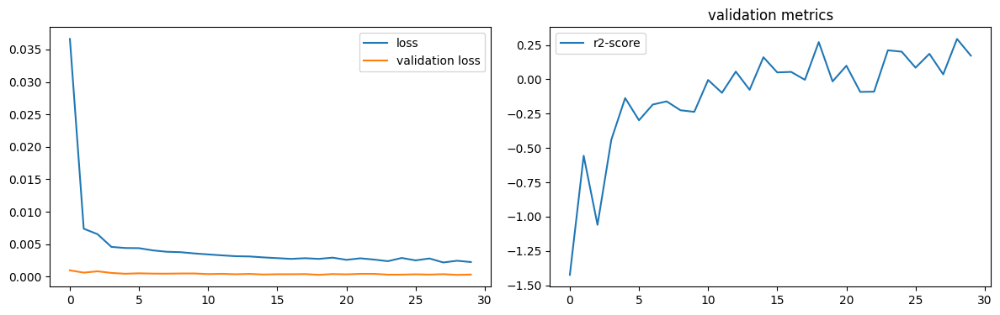

num of dropped: 20
Test: loss: 0.03368917852640152, avg metrics: (-0.025302135944366456,)
dropping feature: (2, 'address')


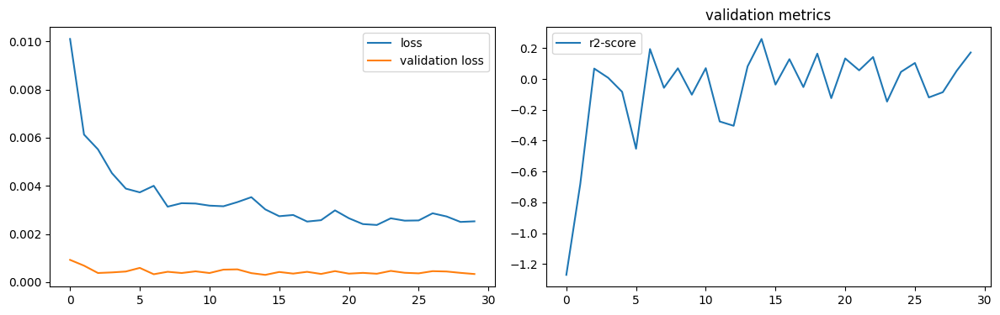

num of dropped: 21
Test: loss: 0.02679656445980072, avg metrics: (-0.01112515926361084,)
dropping feature: (2, 'famsize')


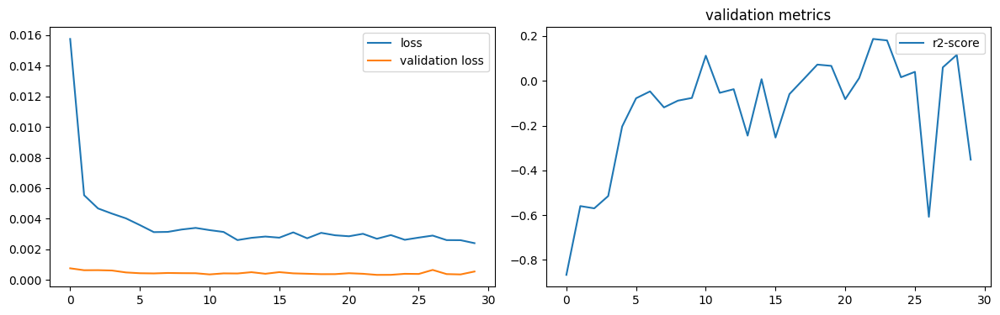

num of dropped: 22
Test: loss: 0.029737962409853935, avg metrics: (-0.009820401668548584,)
dropping feature: (6, 'activities')


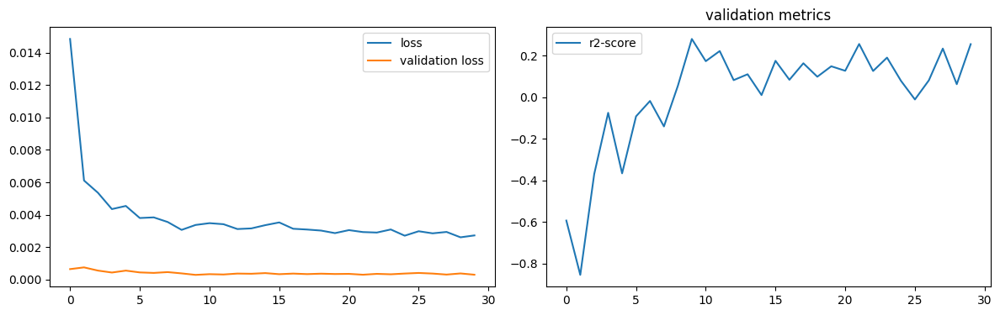

num of dropped: 23
Test: loss: 0.02533543109893799, avg metrics: (0.047510075569152835,)
dropping feature: (1, 'age')


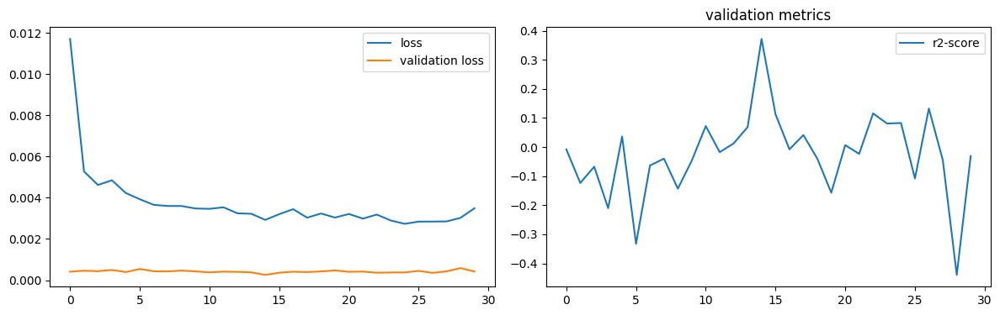

num of dropped: 24
Test: loss: 0.02621246874332428, avg metrics: (0.03117159605026245,)
dropping feature: (5, 'Dalc')


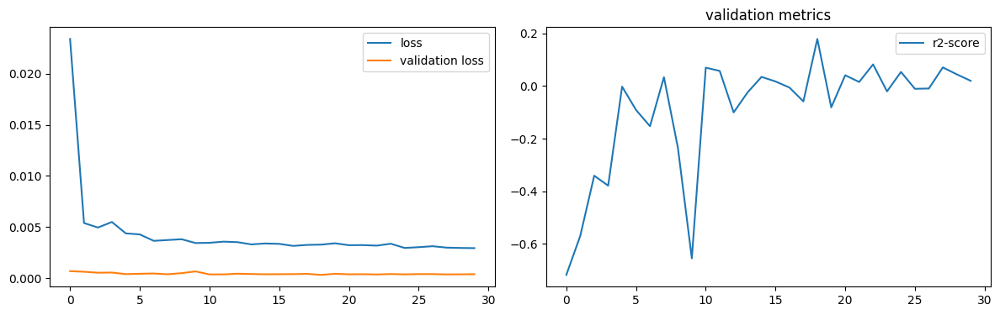

num of dropped: 25
Test: loss: 0.02533700317144394, avg metrics: (0.09411009550094604,)
dropping feature: (0, 'school')


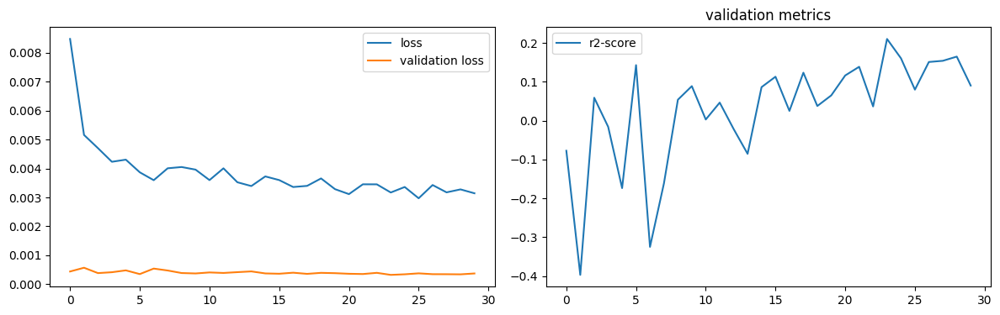

num of dropped: 26
Test: loss: 0.02744704857468605, avg metrics: (0.028096377849578857,)
dropping feature: (0, 'Medu')


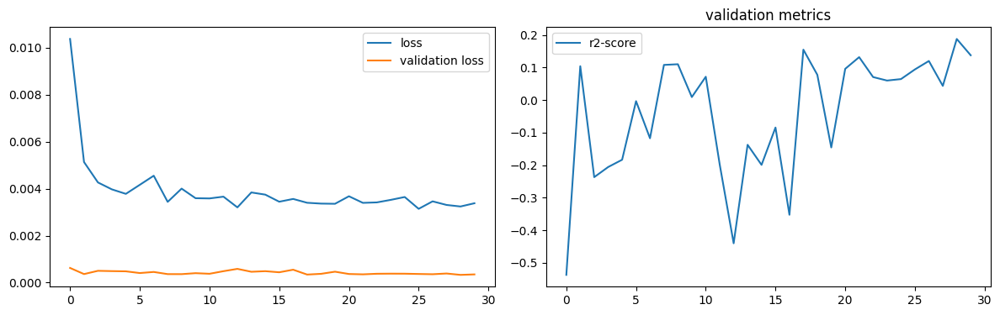

num of dropped: 27
Test: loss: 0.025159964337944984, avg metrics: (0.06094141006469726,)
dropping feature: (0, 'studytime')


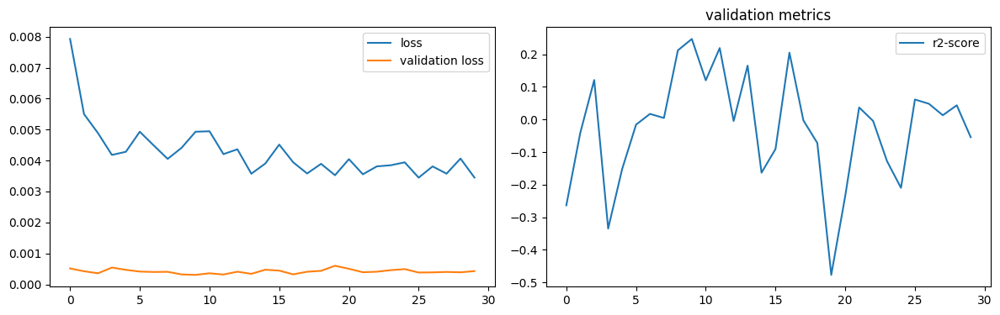

num of dropped: 28
Test: loss: 0.025292295962572098, avg metrics: (0.04353022575378418,)
dropping feature: (1, 'famsup')


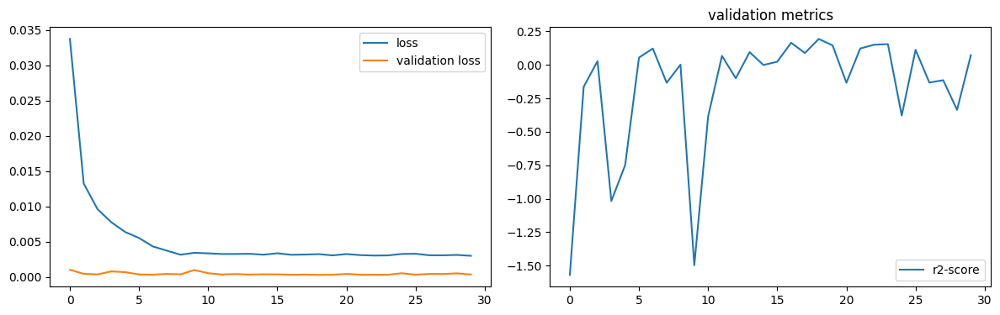

num of dropped: 29
Test: loss: 0.025201981887221336, avg metrics: (-0.8234162569046021,)


In [29]:
torch.manual_seed(2024)

datasets = students_datasets.copy()
headers = students_headers.copy()


def model_factory(size):
    return StudentsNN(size)


test_metrics, dropped, models = prune(
    datasets, headers, analyze_fast,
    model_factory, optimizer_factory, criterion, score_outputs, 30,
    labels, "", None
)

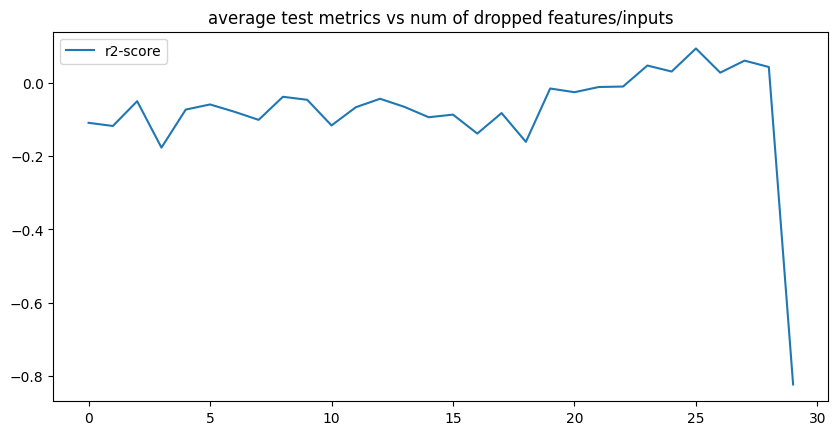

In [30]:
plot_dropping_metrics(test_metrics, labels)

In [31]:
num_drop_features = 25

save_models("students", "fast-layer1", models, dropped)

reduced_datasets, reduced_headers = reduce_datasets(datasets, headers, dropped, num_drop_features)
layer = models[num_drop_features].layer1

best_model.layer1 = layer

fast_dataset = reduced_datasets

features left [5]:  ['school', 'Medu', 'studytime', 'failures', 'famsup']


### 1st hidden layer

In [32]:
layer.eval()

datasets = {
    key: TensorDataset(
        layer(dataset.tensors[0]).detach(),
        dataset.tensors[1]
    )
    for key, dataset in reduced_datasets.items()
}

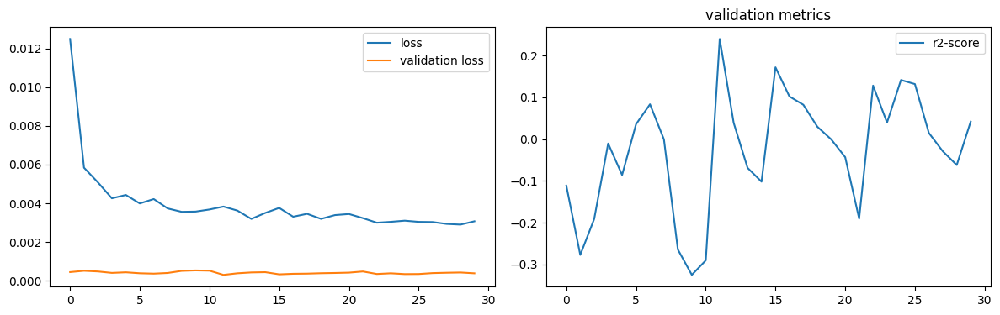

num of dropped: 0
Test: loss: 0.026470741257071495, avg metrics: (0.06189981698989868,)
dropping feature: (45, 'neuron45')


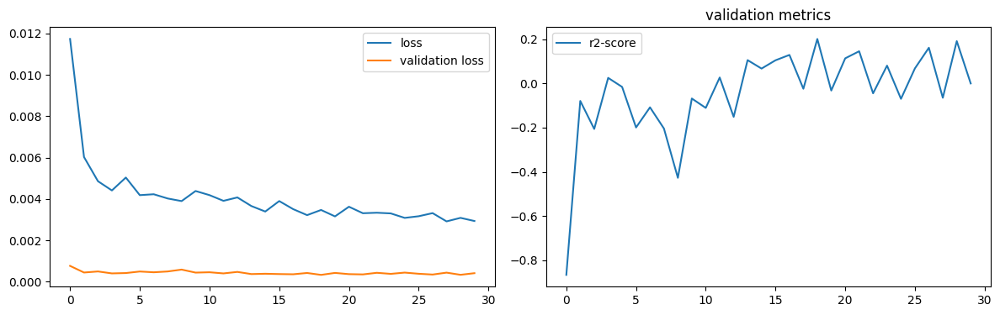

num of dropped: 1
Test: loss: 0.028824737295508385, avg metrics: (-0.06516227722167969,)
dropping feature: (63, 'neuron64')


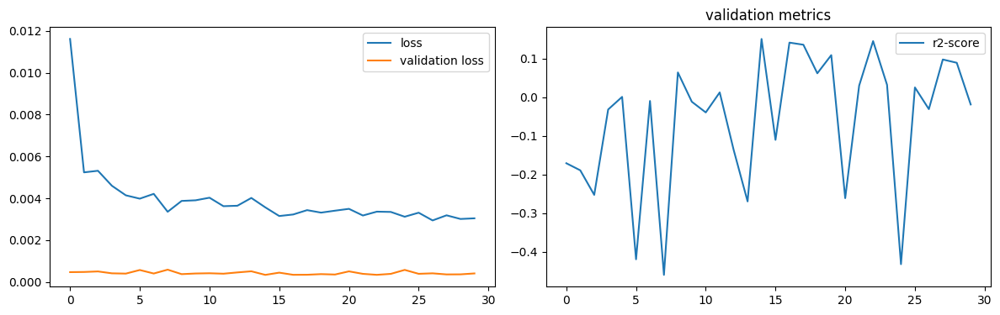

num of dropped: 2
Test: loss: 0.02840551547706127, avg metrics: (0.05973746776580811,)
dropping feature: (82, 'neuron84')


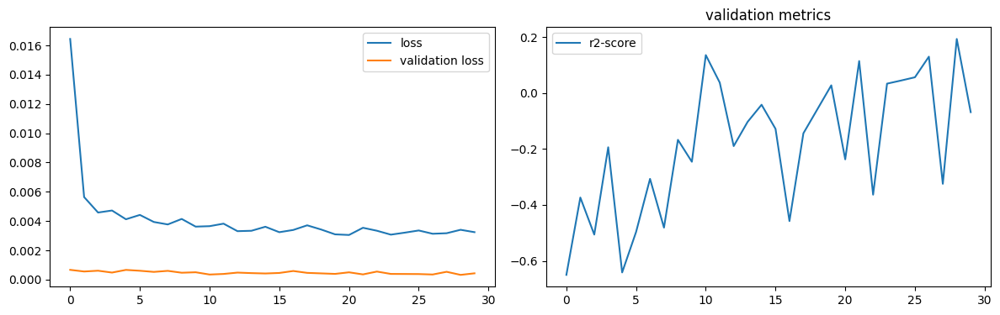

num of dropped: 3
Test: loss: 0.025788497179746628, avg metrics: (0.038310110569000244,)
dropping feature: (34, 'neuron34')


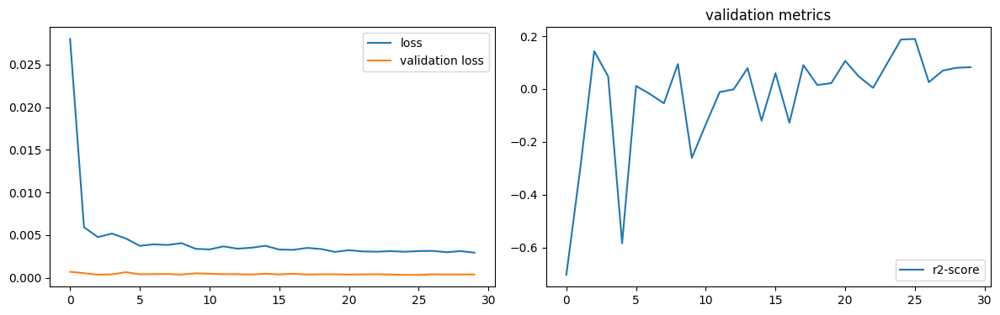

num of dropped: 4
Test: loss: 0.025909120216965675, avg metrics: (0.007646298408508301,)
dropping feature: (41, 'neuron42')


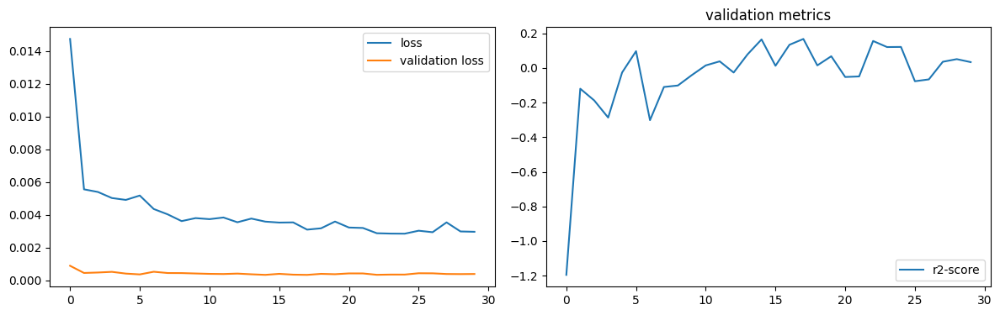

num of dropped: 5
Test: loss: 0.025466857478022575, avg metrics: (0.011211240291595459,)
dropping feature: (66, 'neuron70')


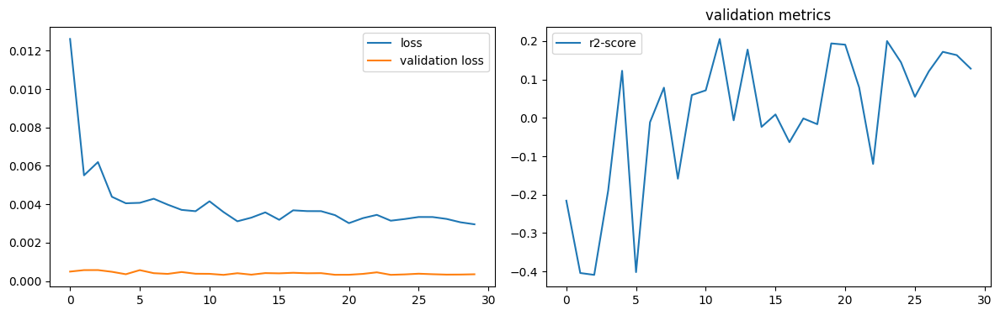

num of dropped: 6
Test: loss: 0.024973249062895775, avg metrics: (0.03618712425231933,)
dropping feature: (59, 'neuron62')


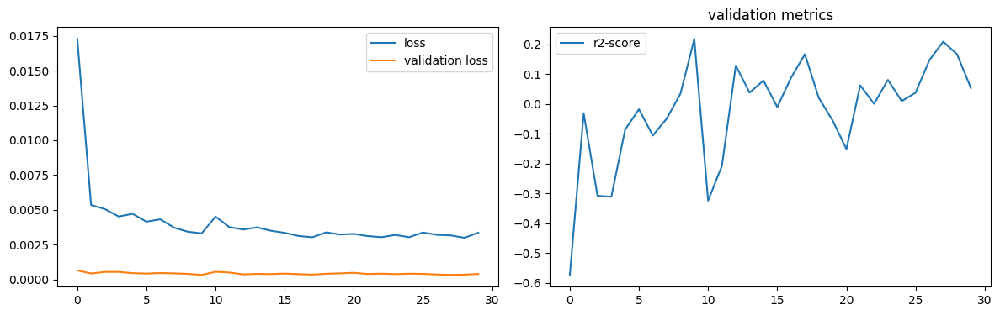

num of dropped: 7
Test: loss: 0.026086559519171715, avg metrics: (0.03280740976333618,)
dropping feature: (88, 'neuron95')


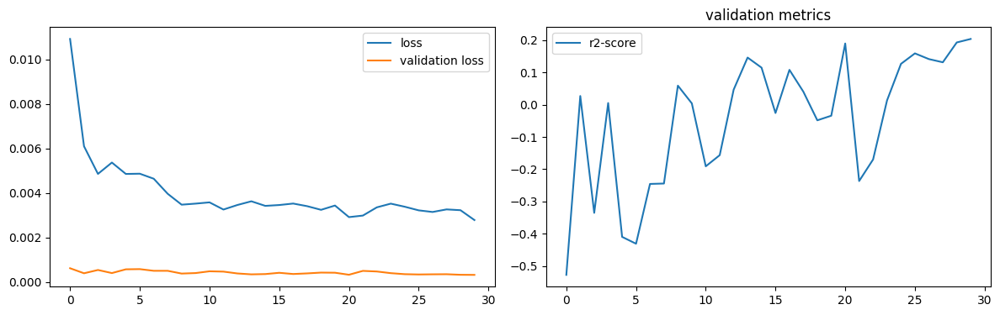

num of dropped: 8
Test: loss: 0.028661714866757393, avg metrics: (0.04569313526153564,)
dropping feature: (14, 'neuron14')


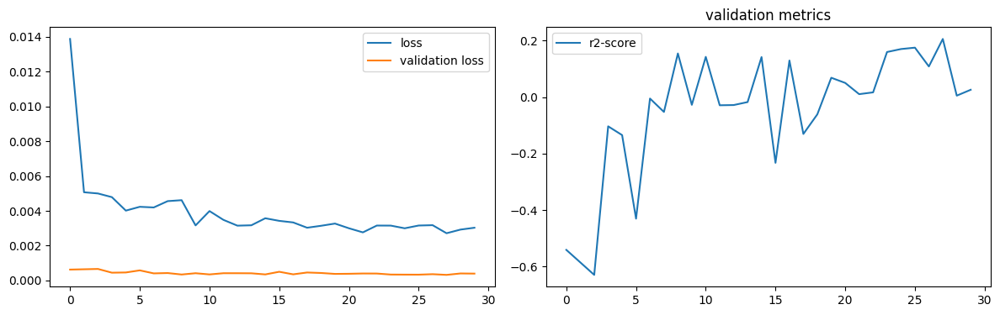

num of dropped: 9
Test: loss: 0.0361090824007988, avg metrics: (-0.007857966423034667,)
dropping feature: (14, 'neuron15')


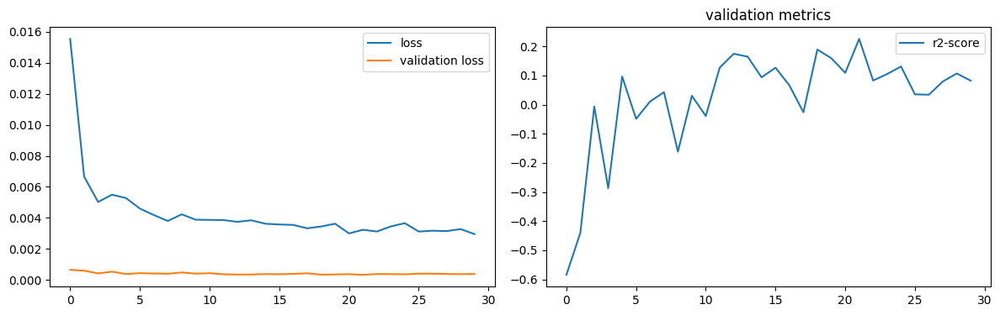

num of dropped: 10
Test: loss: 0.02854977734386921, avg metrics: (0.06766678094863891,)
dropping feature: (73, 'neuron81')


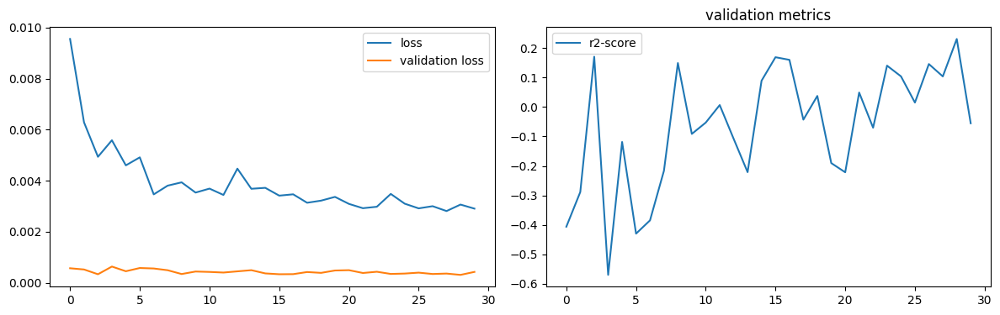

num of dropped: 11
Test: loss: 0.024593636393547058, avg metrics: (-0.013695716857910156,)
dropping feature: (63, 'neuron71')


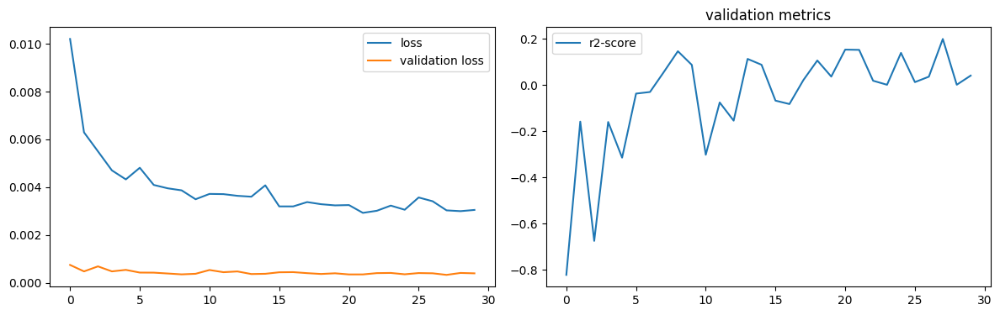

num of dropped: 12
Test: loss: 0.03296787664294243, avg metrics: (-0.03090367317199707,)
dropping feature: (41, 'neuron46')


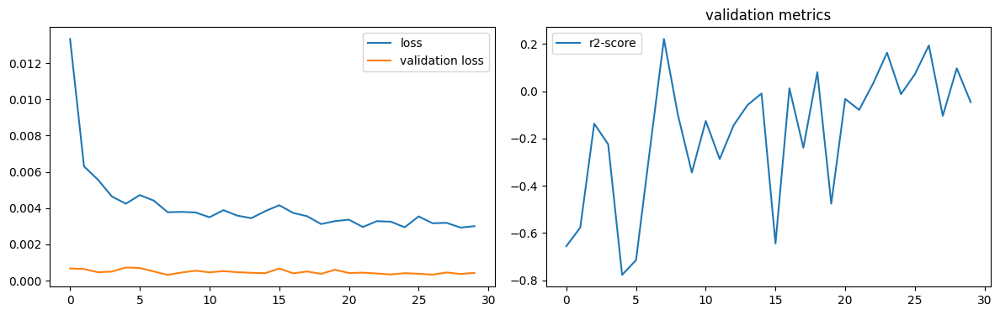

num of dropped: 13
Test: loss: 0.024961836636066437, avg metrics: (0.018624675273895264,)
dropping feature: (72, 'neuron83')


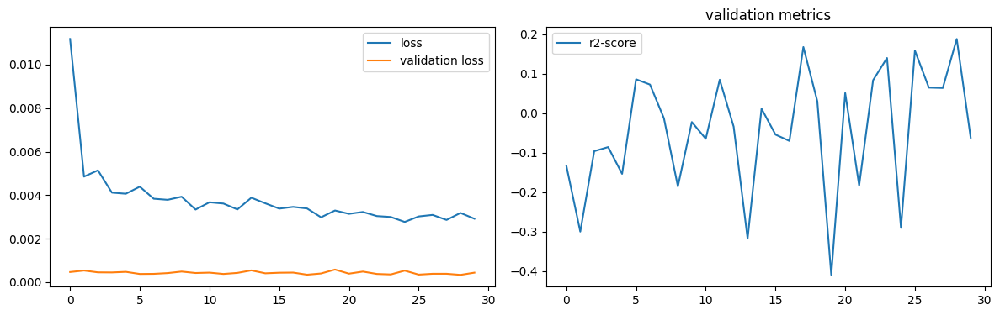

num of dropped: 14
Test: loss: 0.02477521263062954, avg metrics: (0.04873290061950684,)
dropping feature: (57, 'neuron65')


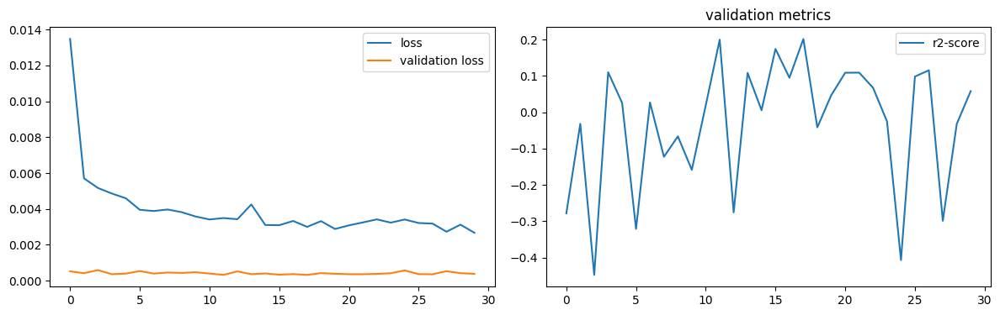

num of dropped: 15
Test: loss: 0.026490960270166397, avg metrics: (0.07059558629989623,)
dropping feature: (11, 'neuron11')


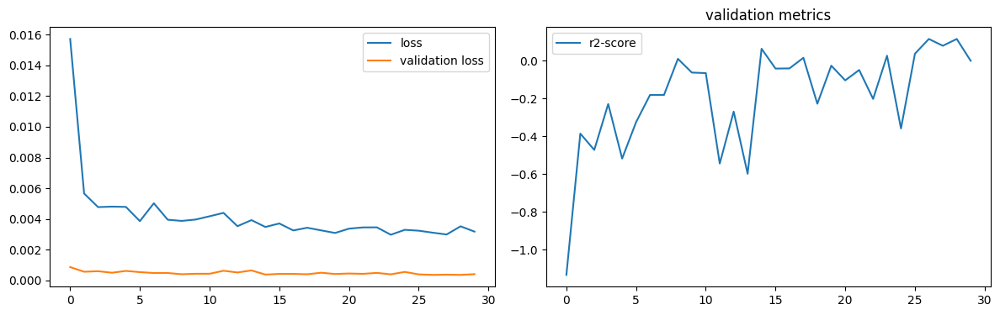

num of dropped: 16
Test: loss: 0.027406660839915276, avg metrics: (0.006754493713378907,)
dropping feature: (77, 'neuron92')


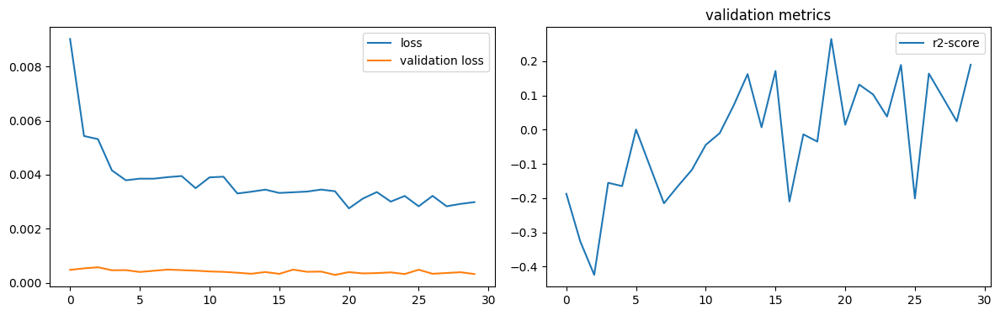

num of dropped: 17
Test: loss: 0.025355800986289978, avg metrics: (0.01966463327407837,)
dropping feature: (73, 'neuron88')


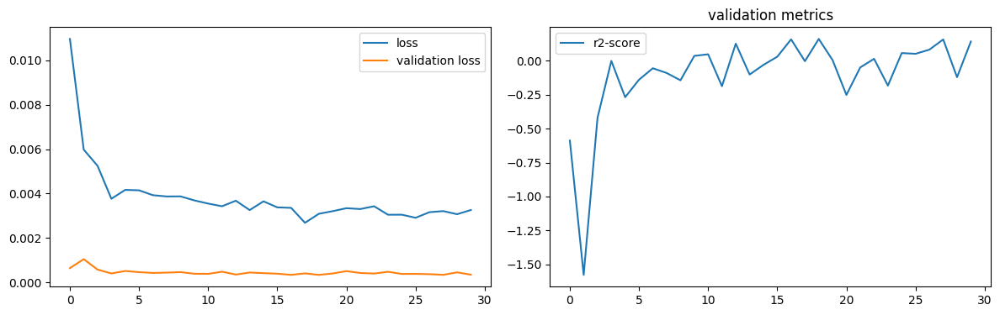

num of dropped: 18
Test: loss: 0.02811337821185589, avg metrics: (-0.01768418550491333,)
dropping feature: (75, 'neuron91')


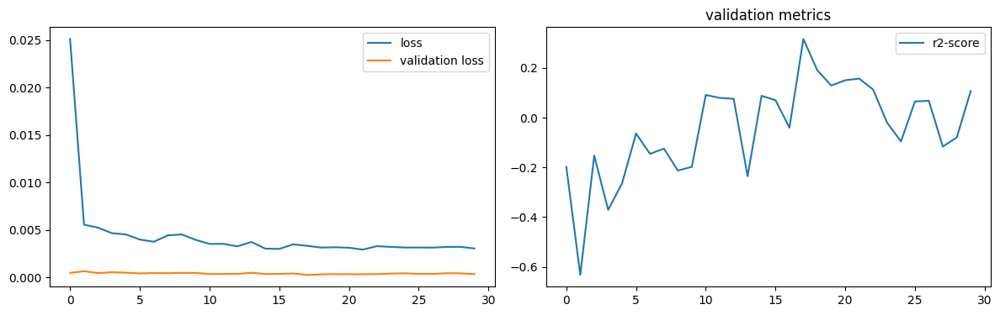

num of dropped: 19
Test: loss: 0.03540420904755592, avg metrics: (-0.12529515027999877,)
dropping feature: (53, 'neuron60')


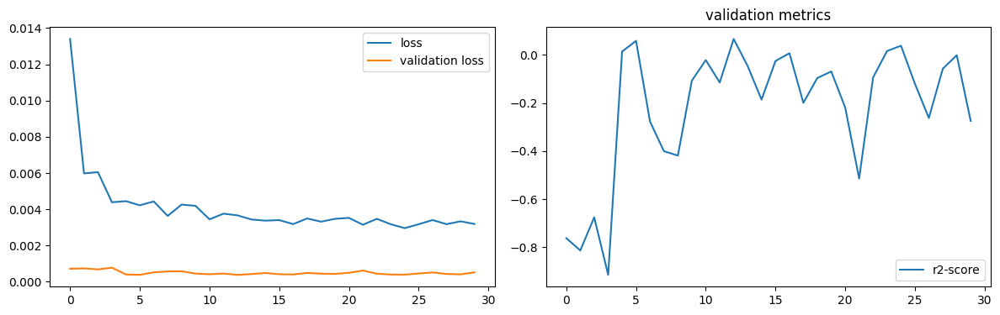

num of dropped: 20
Test: loss: 0.025905082002282143, avg metrics: (0.04942090511322021,)
dropping feature: (22, 'neuron25')


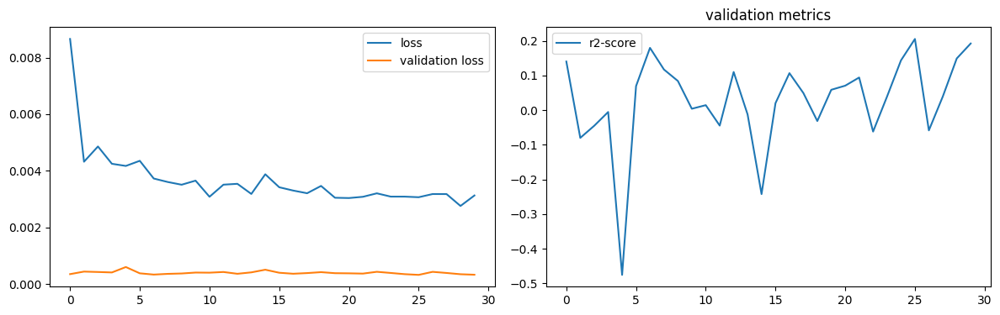

num of dropped: 21
Test: loss: 0.02708500064909458, avg metrics: (-0.012488782405853271,)
dropping feature: (38, 'neuron44')


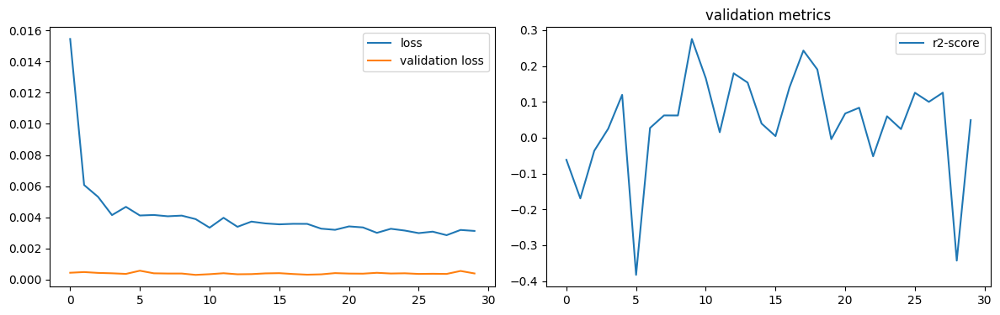

num of dropped: 22
Test: loss: 0.02495167776942253, avg metrics: (0.04061013460159302,)
dropping feature: (1, 'neuron1')


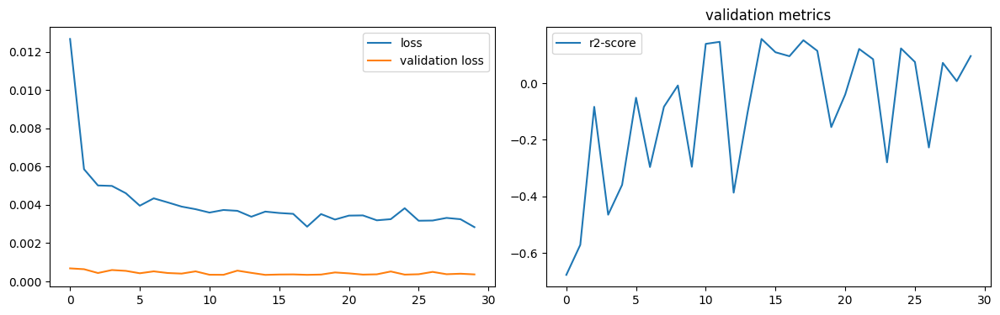

num of dropped: 23
Test: loss: 0.02618248201906681, avg metrics: (0.035299718379974365,)
dropping feature: (31, 'neuron37')


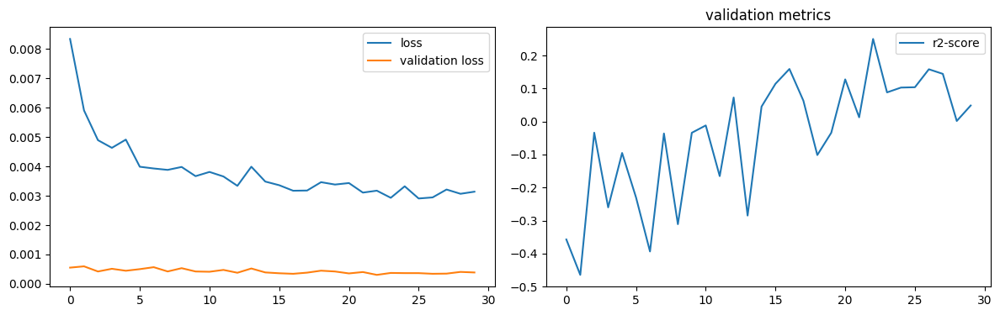

num of dropped: 24
Test: loss: 0.0340859517455101, avg metrics: (0.03705475330352783,)
dropping feature: (43, 'neuron54')


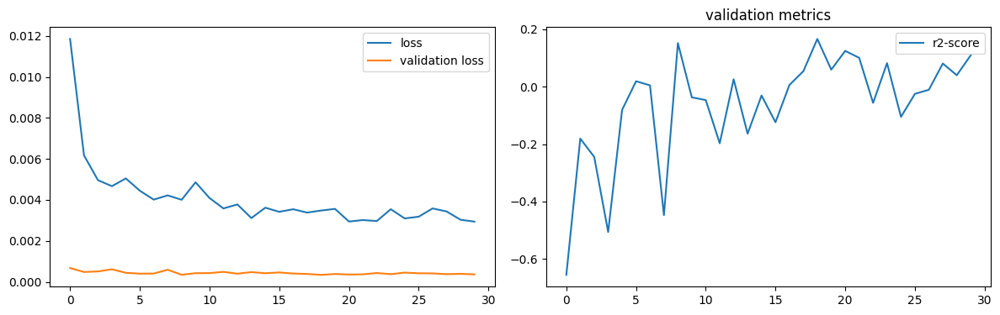

num of dropped: 25
Test: loss: 0.030959326773881912, avg metrics: (-0.07332721948623658,)
dropping feature: (62, 'neuron80')


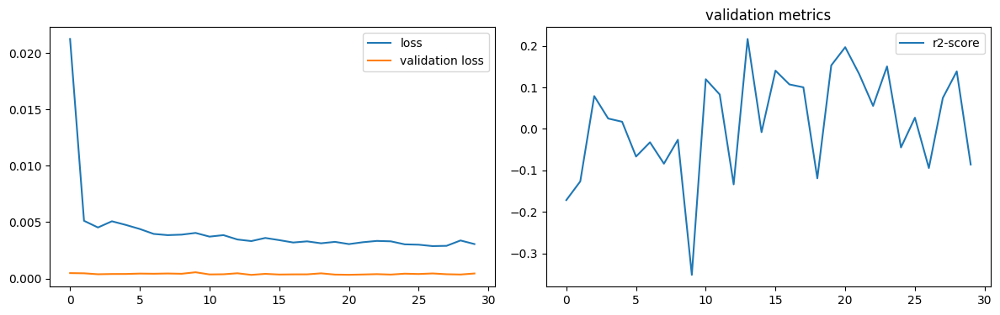

num of dropped: 26
Test: loss: 0.026045633479952812, avg metrics: (0.05585743188858032,)
dropping feature: (13, 'neuron17')


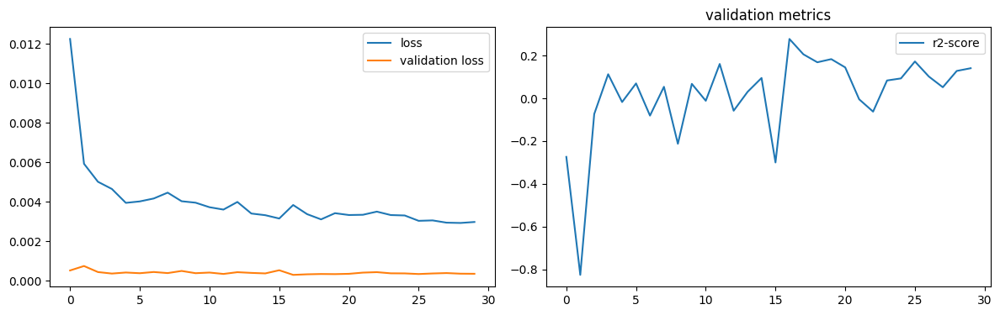

num of dropped: 27
Test: loss: 0.02849378064274788, avg metrics: (0.051882708072662355,)
dropping feature: (18, 'neuron23')


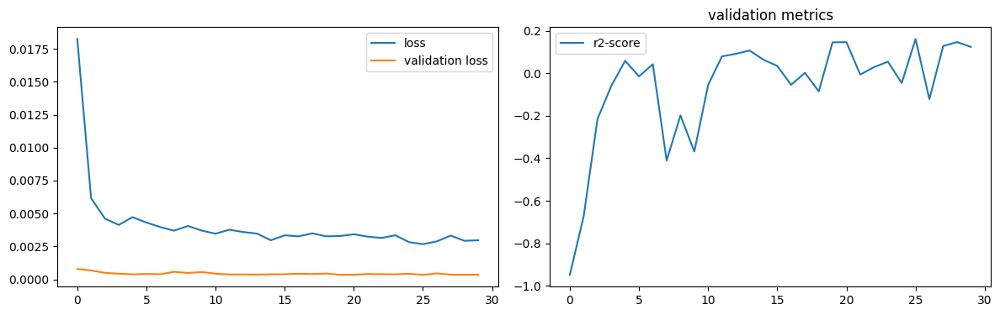

num of dropped: 28
Test: loss: 0.02505095861852169, avg metrics: (0.01862494945526123,)
dropping feature: (63, 'neuron87')


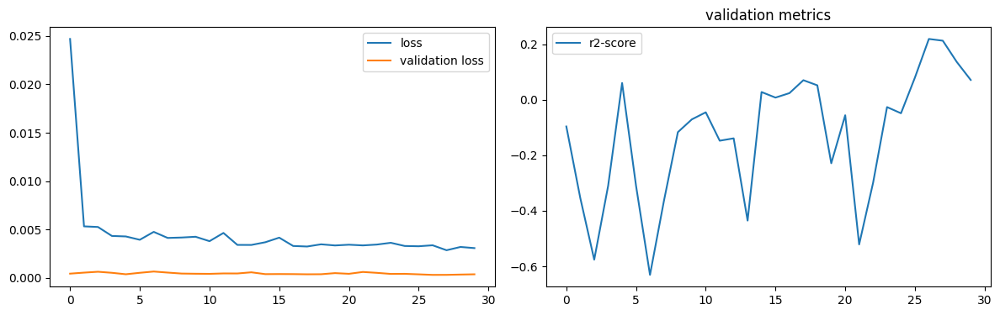

num of dropped: 29
Test: loss: 0.026900505647063255, avg metrics: (0.09210927486419677,)
dropping feature: (52, 'neuron72')


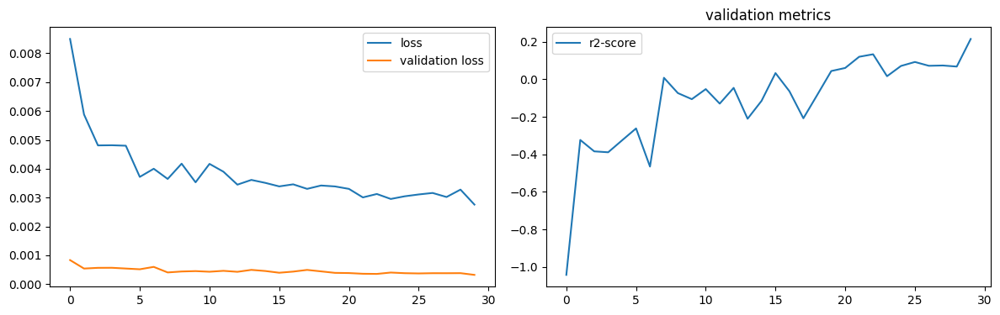

num of dropped: 30
Test: loss: 0.02881120890378952, avg metrics: (-0.04522204399108887,)
dropping feature: (9, 'neuron10')


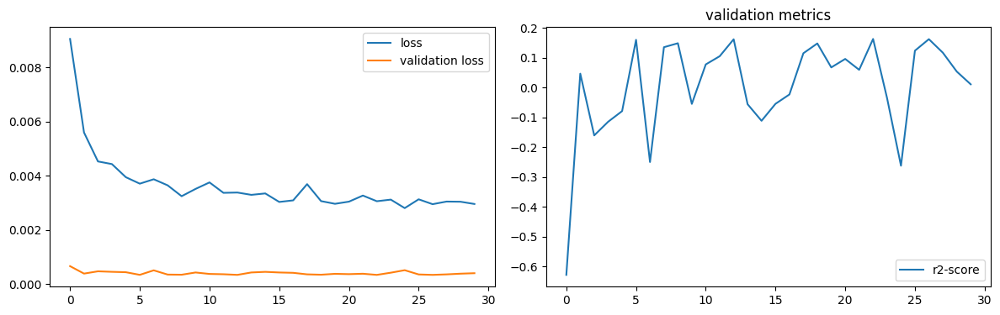

num of dropped: 31
Test: loss: 0.03009246103465557, avg metrics: (0.02151534557342529,)
dropping feature: (57, 'neuron79')


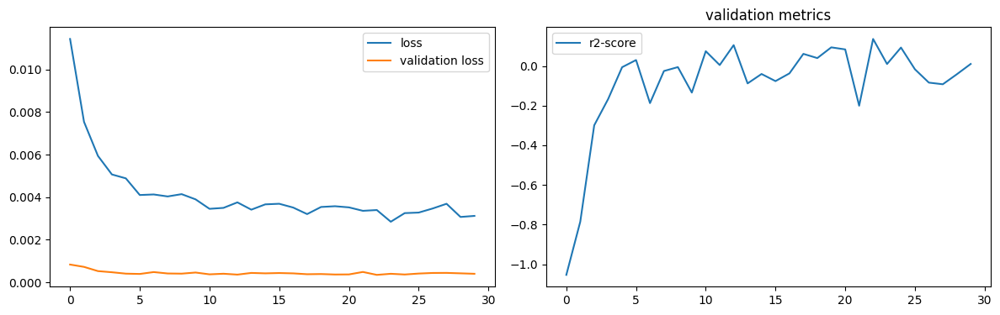

num of dropped: 32
Test: loss: 0.029757976531982422, avg metrics: (-0.019545209407806397,)
dropping feature: (0, 'neuron0')


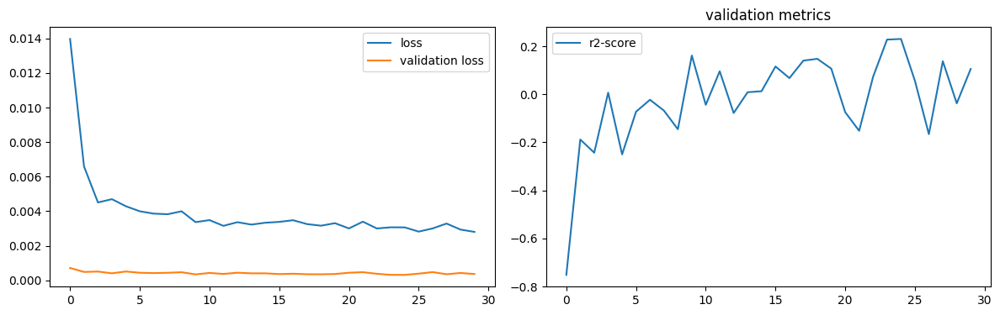

num of dropped: 33
Test: loss: 0.02819659747183323, avg metrics: (0.06145808696746826,)
dropping feature: (11, 'neuron18')


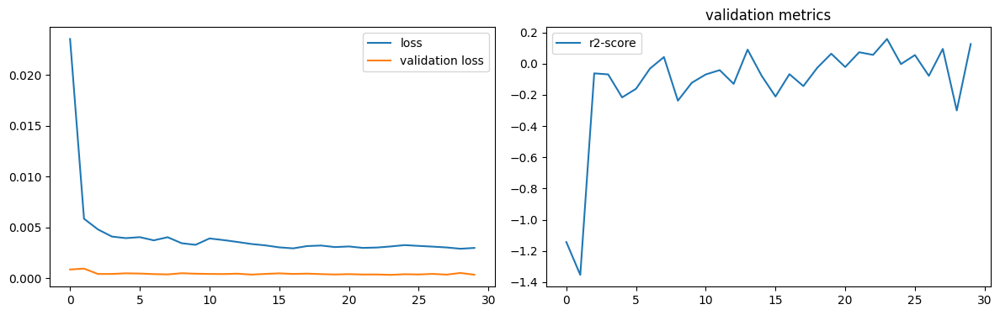

num of dropped: 34
Test: loss: 0.03205952048301697, avg metrics: (0.019779884815216066,)
dropping feature: (48, 'neuron69')


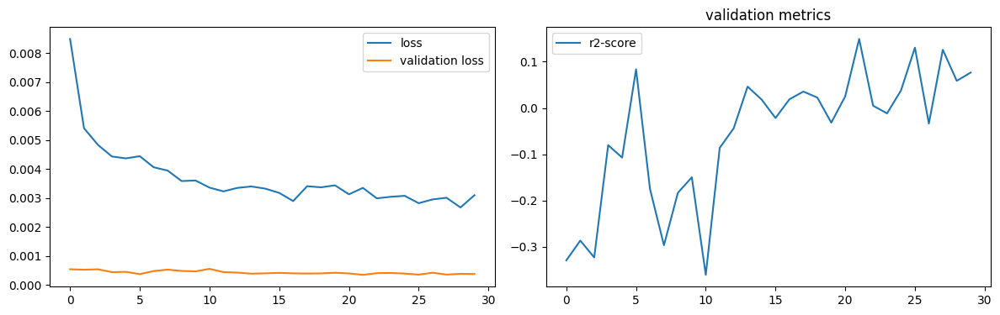

num of dropped: 35
Test: loss: 0.025166699662804604, avg metrics: (0.06359883546829223,)
dropping feature: (38, 'neuron55')


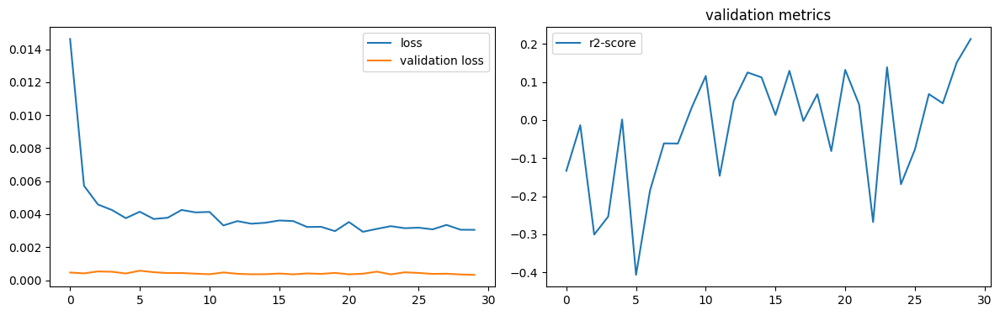

num of dropped: 36
Test: loss: 0.029185200110077858, avg metrics: (-0.035093724727630615,)
dropping feature: (18, 'neuron28')


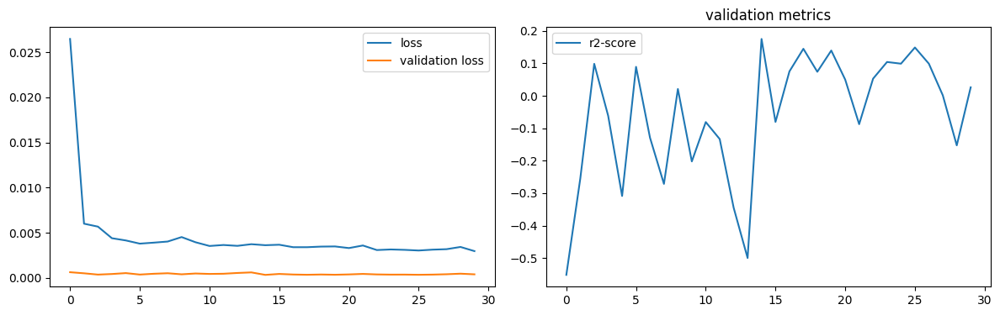

num of dropped: 37
Test: loss: 0.027670038864016533, avg metrics: (0.07733404636383057,)
dropping feature: (50, 'neuron77')


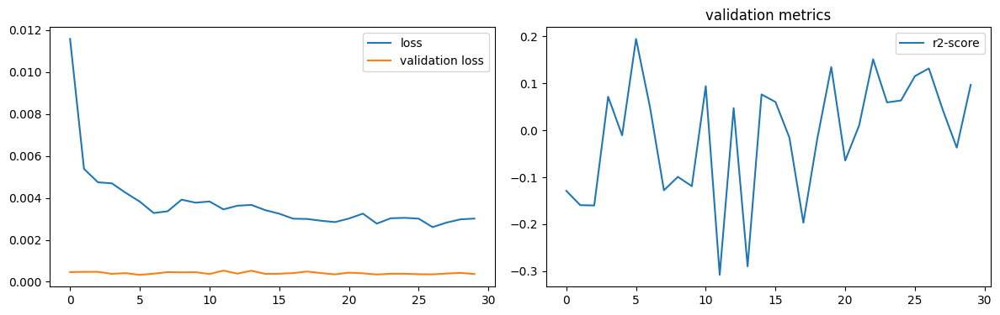

num of dropped: 38
Test: loss: 0.029131049290299416, avg metrics: (-0.031380414962768555,)
dropping feature: (35, 'neuron52')


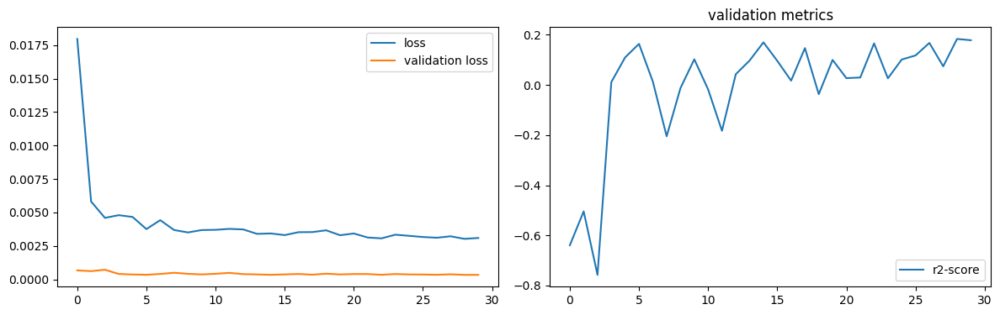

num of dropped: 39
Test: loss: 0.0314771942794323, avg metrics: (-0.14611872434616088,)
dropping feature: (7, 'neuron9')


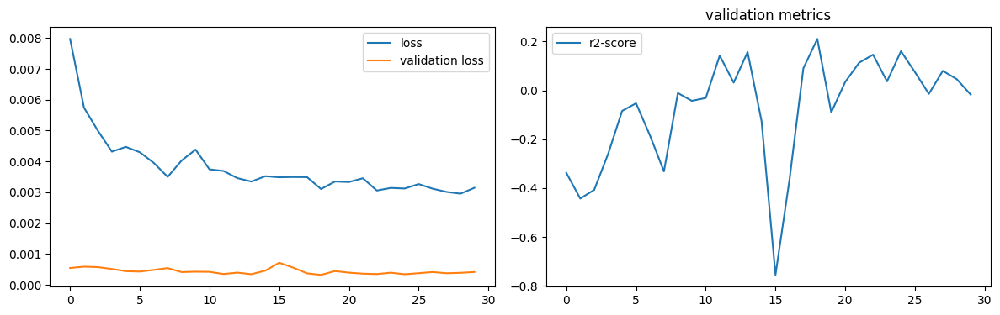

num of dropped: 40
Test: loss: 0.028139326721429825, avg metrics: (0.07743096351623535,)
dropping feature: (30, 'neuron48')


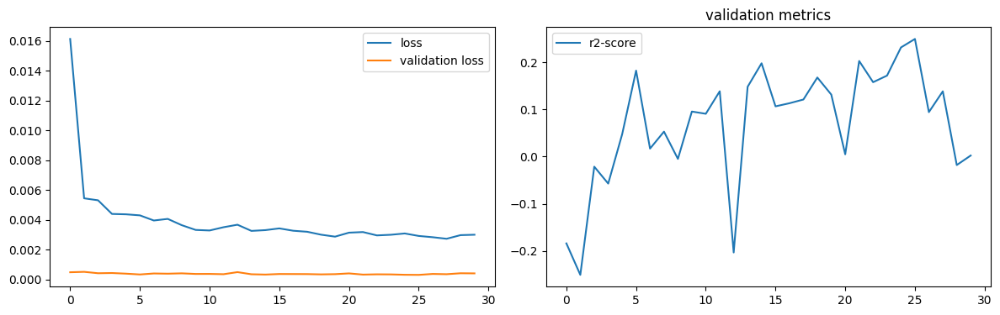

num of dropped: 41
Test: loss: 0.03019804134964943, avg metrics: (0.0491277813911438,)
dropping feature: (14, 'neuron24')


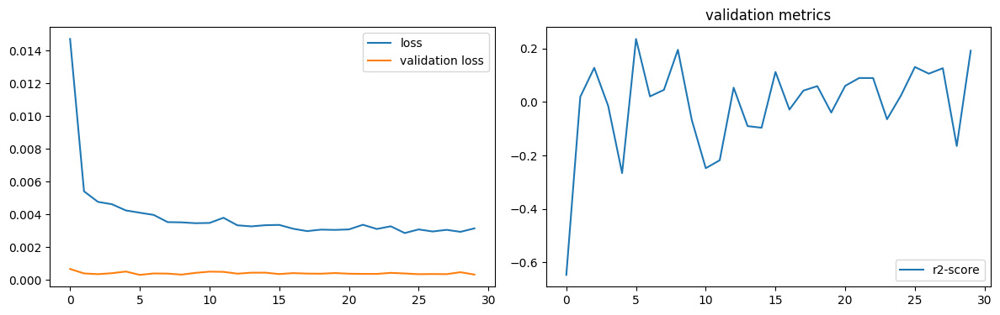

num of dropped: 42
Test: loss: 0.02765098586678505, avg metrics: (0.014562833309173583,)
dropping feature: (35, 'neuron58')


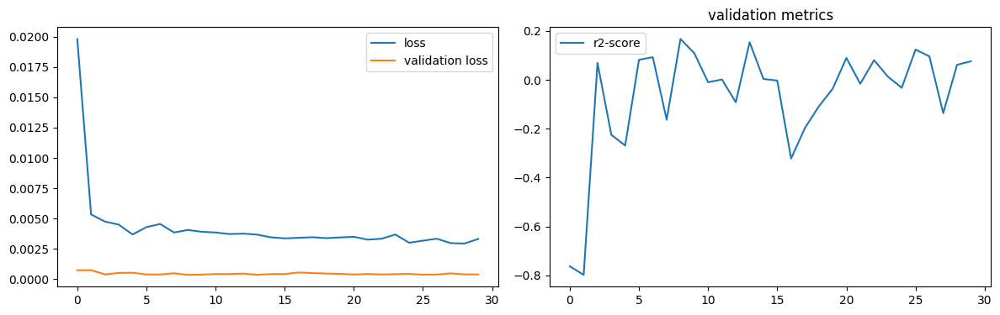

num of dropped: 43
Test: loss: 0.024759411811828613, avg metrics: (0.062499380111694335,)
dropping feature: (43, 'neuron75')


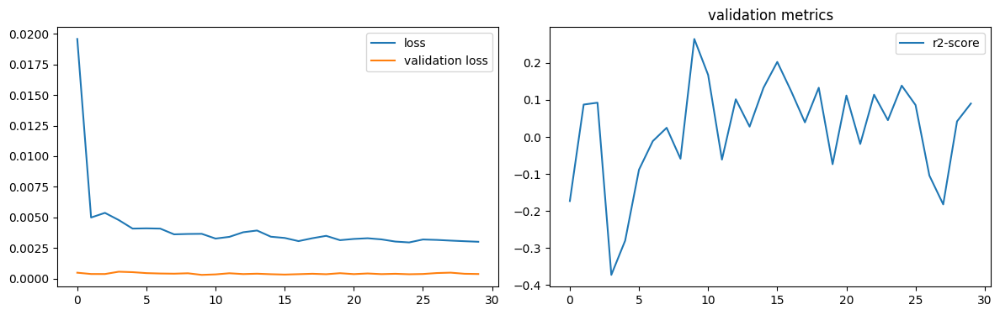

num of dropped: 44
Test: loss: 0.02674385905265808, avg metrics: (0.044137322902679445,)
dropping feature: (55, 'neuron99')


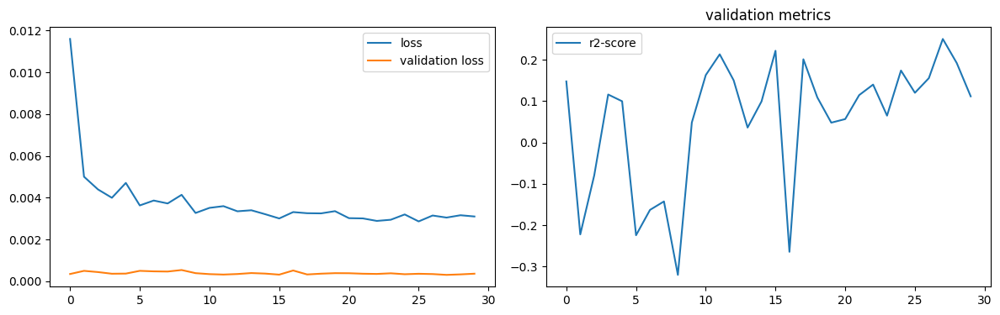

num of dropped: 45
Test: loss: 0.024515921249985695, avg metrics: (0.07312970161437989,)
dropping feature: (1, 'neuron3')


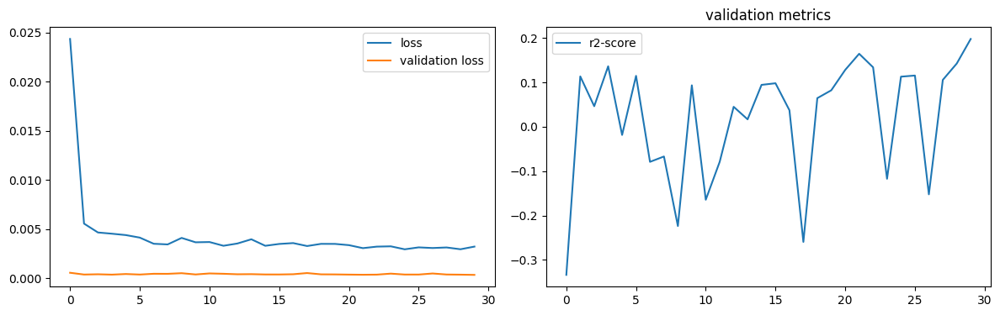

num of dropped: 46
Test: loss: 0.027187751606106758, avg metrics: (0.0197304368019104,)
dropping feature: (27, 'neuron47')


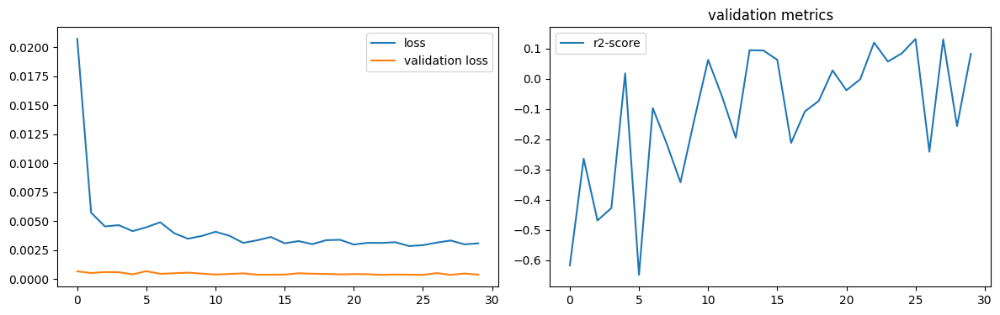

num of dropped: 47
Test: loss: 0.023256367072463036, avg metrics: (0.03812310695648193,)
dropping feature: (2, 'neuron5')


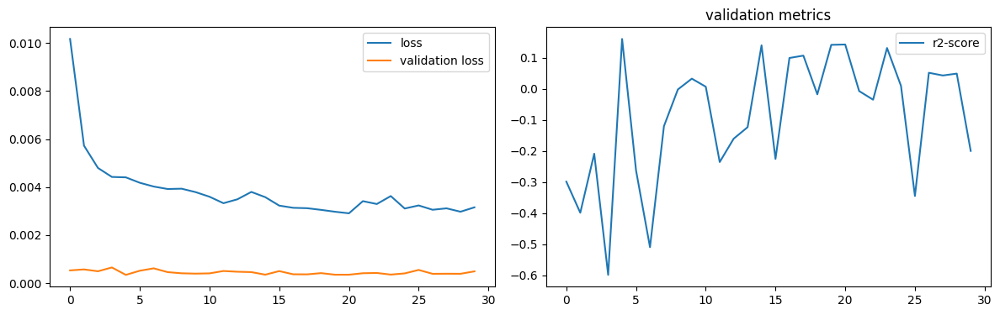

num of dropped: 48
Test: loss: 0.031599558889865875, avg metrics: (-0.038450992107391356,)
dropping feature: (44, 'neuron86')


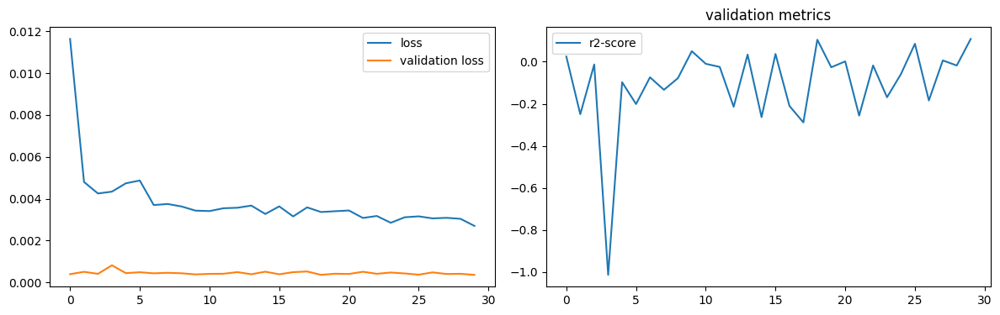

num of dropped: 49
Test: loss: 0.025621019303798676, avg metrics: (0.057914578914642335,)
dropping feature: (42, 'neuron82')


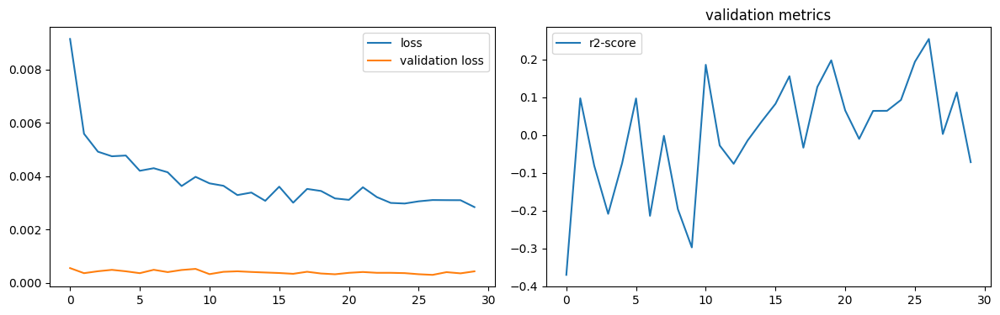

num of dropped: 50
Test: loss: 0.02661435306072235, avg metrics: (0.0680393934249878,)
dropping feature: (14, 'neuron29')


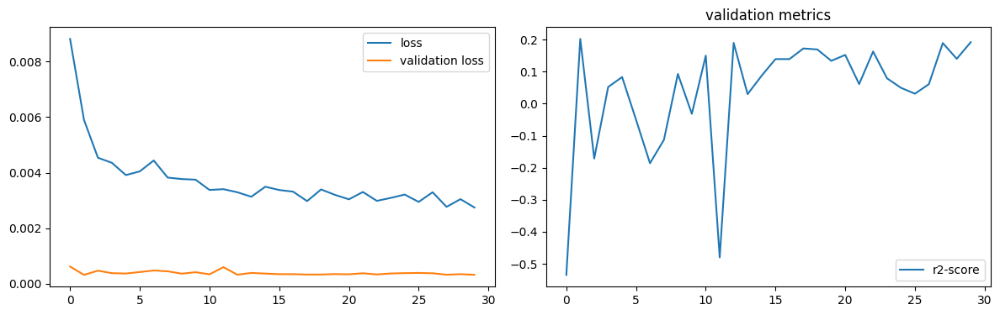

num of dropped: 51
Test: loss: 0.02868514321744442, avg metrics: (0.05554046630859375,)
dropping feature: (48, 'neuron98')


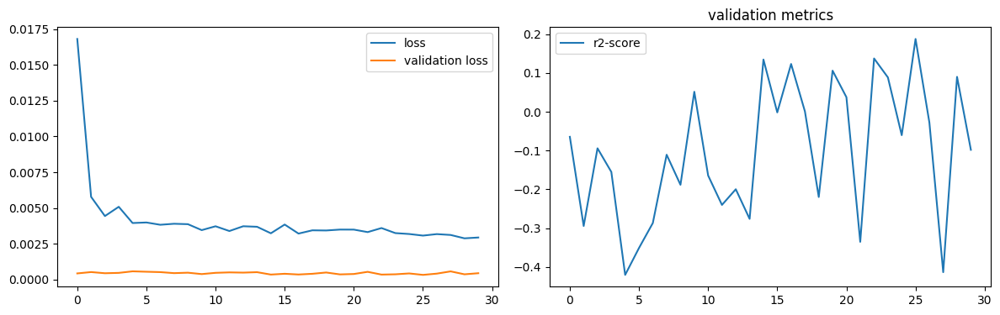

num of dropped: 52
Test: loss: 0.025228014215826988, avg metrics: (-0.05872297286987305,)
dropping feature: (35, 'neuron67')


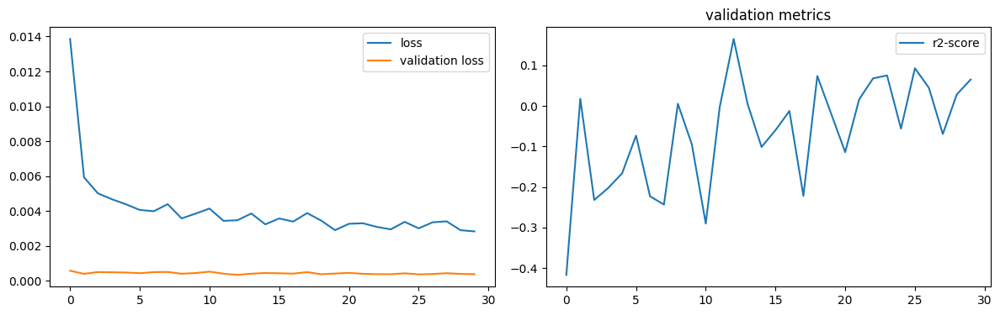

num of dropped: 53
Test: loss: 0.03012513555586338, avg metrics: (0.06881369352340698,)
dropping feature: (14, 'neuron30')


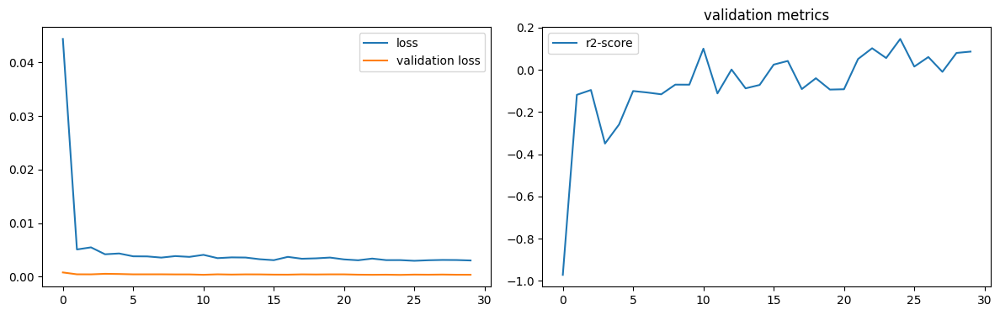

num of dropped: 54
Test: loss: 0.028648342937231064, avg metrics: (0.0027456283569335938,)
dropping feature: (5, 'neuron12')


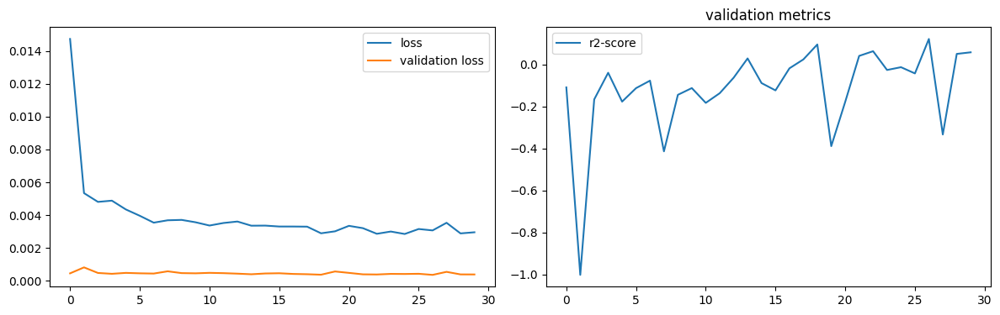

num of dropped: 55
Test: loss: 0.03258056193590164, avg metrics: (-0.03043358325958252,)
dropping feature: (0, 'neuron2')


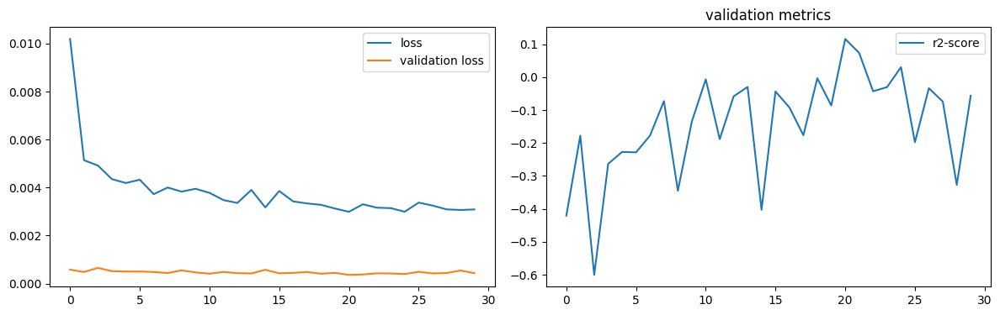

num of dropped: 56
Test: loss: 0.028962891548871994, avg metrics: (0.01925133466720581,)
dropping feature: (25, 'neuron53')


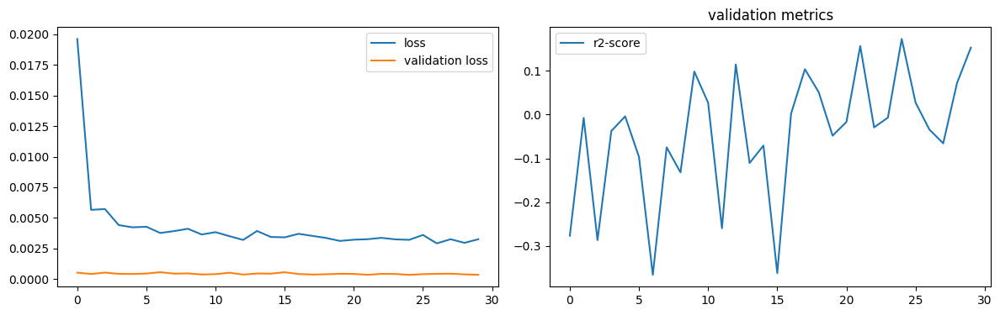

num of dropped: 57
Test: loss: 0.02596745267510414, avg metrics: (-0.014924097061157226,)
dropping feature: (22, 'neuron49')


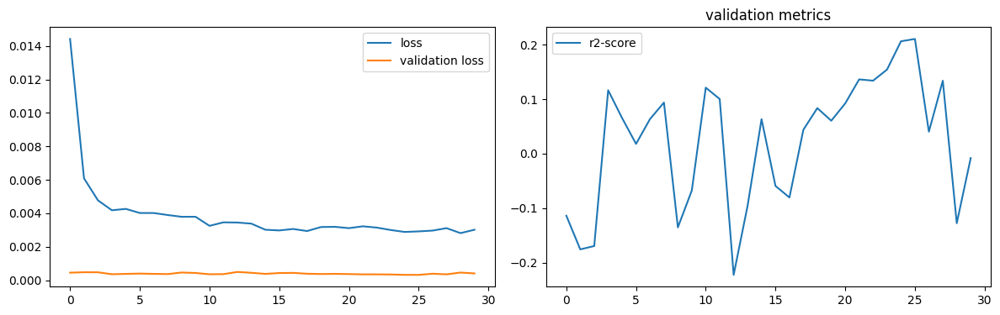

num of dropped: 58
Test: loss: 0.027830256149172783, avg metrics: (0.040087223052978516,)
dropping feature: (37, 'neuron90')


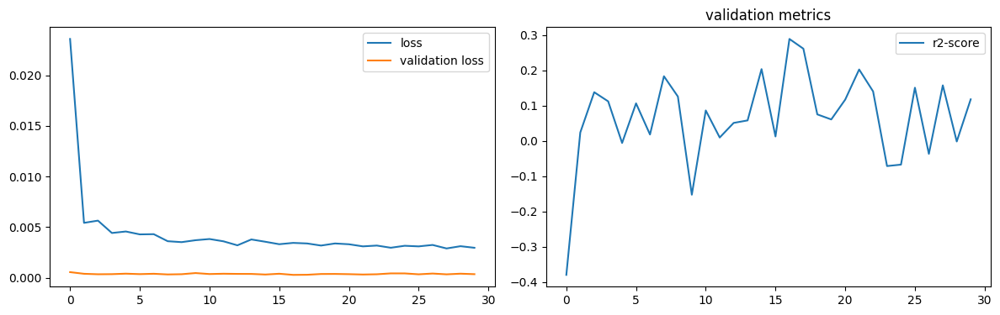

num of dropped: 59
Test: loss: 0.027470145374536514, avg metrics: (0.019656598567962646,)
dropping feature: (35, 'neuron85')


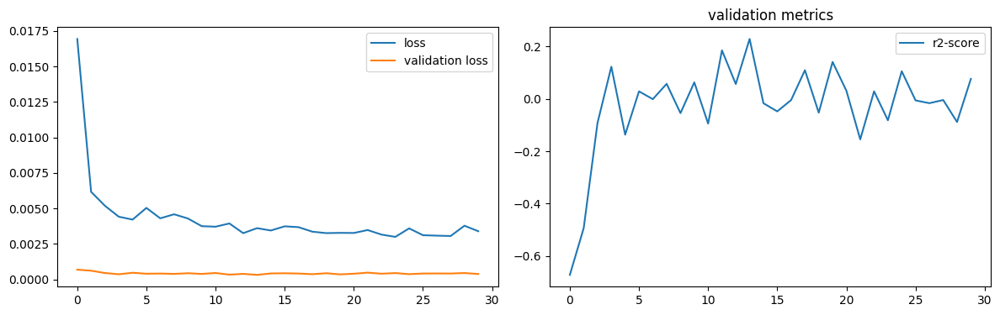

num of dropped: 60
Test: loss: 0.03224312514066696, avg metrics: (0.01682192087173462,)
dropping feature: (4, 'neuron13')


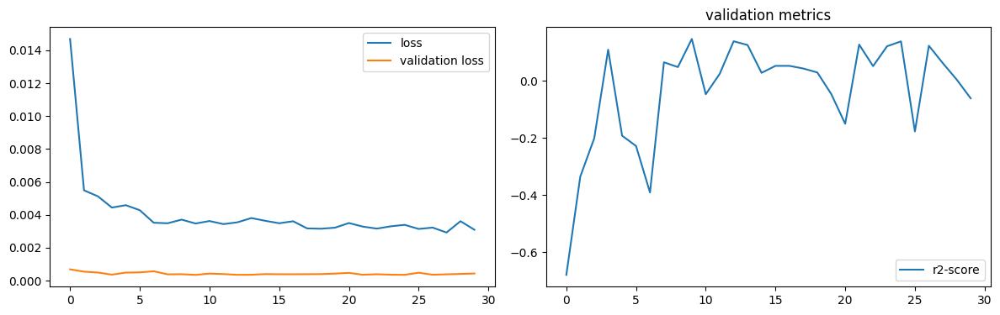

num of dropped: 61
Test: loss: 0.028755290433764458, avg metrics: (0.04443236589431763,)
dropping feature: (9, 'neuron26')


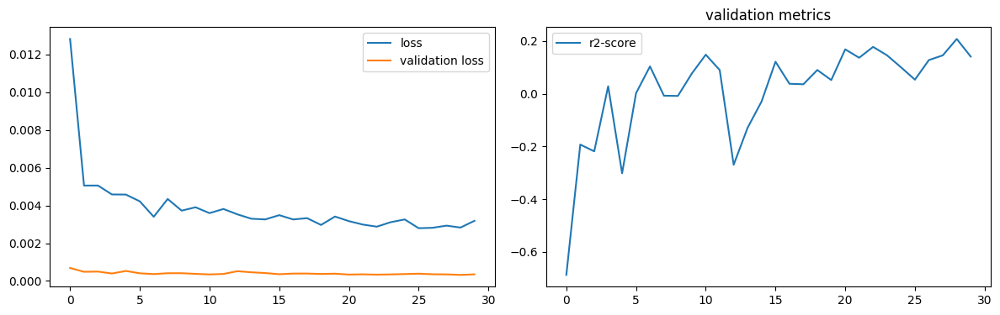

num of dropped: 62
Test: loss: 0.027747830376029015, avg metrics: (0.02229299545288086,)
dropping feature: (32, 'neuron78')


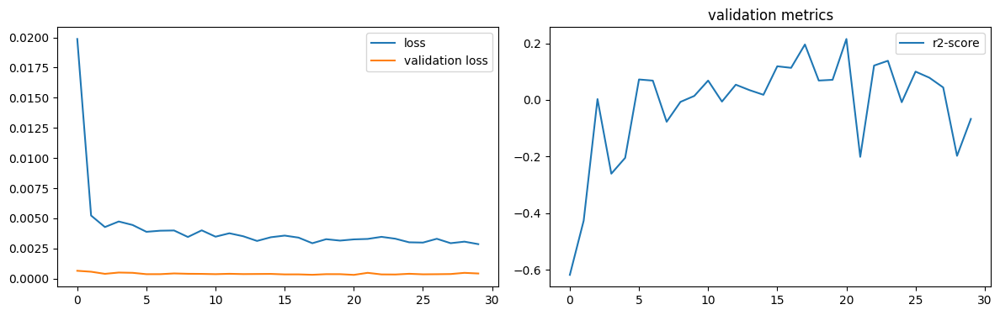

num of dropped: 63
Test: loss: 0.02643956057727337, avg metrics: (0.05056618452072144,)
dropping feature: (19, 'neuron43')


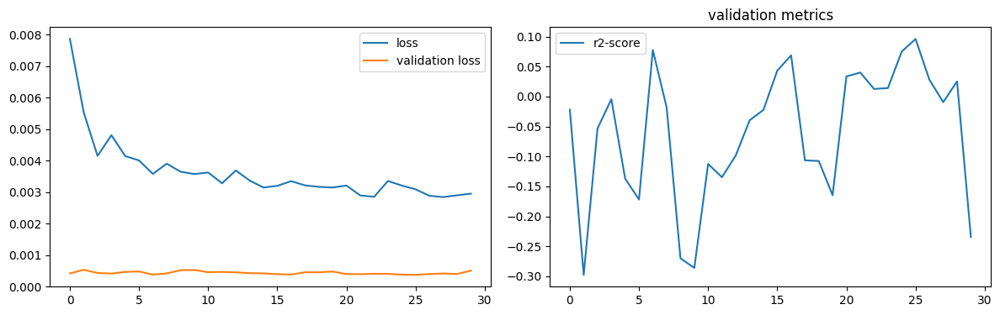

num of dropped: 64
Test: loss: 0.030572565272450447, avg metrics: (-0.07370580434799194,)
dropping feature: (7, 'neuron21')


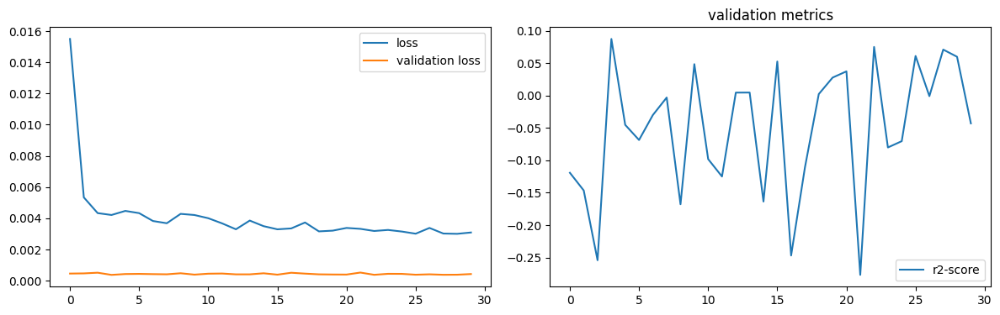

num of dropped: 65
Test: loss: 0.02557952143251896, avg metrics: (0.07548514604568482,)
dropping feature: (29, 'neuron76')


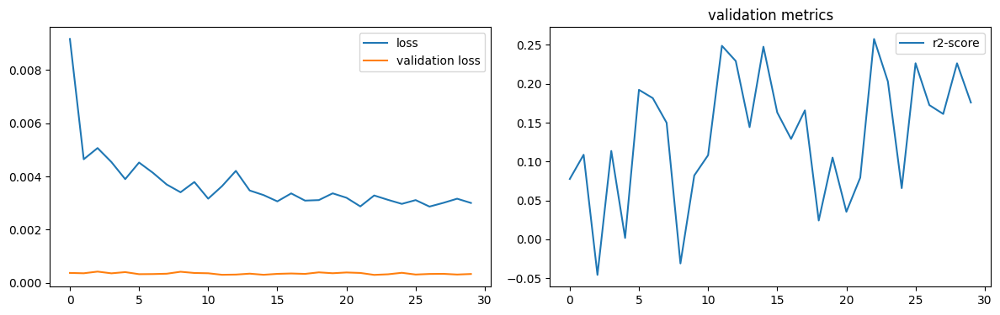

num of dropped: 66
Test: loss: 0.02571040764451027, avg metrics: (-0.0013818621635437011,)
dropping feature: (25, 'neuron66')


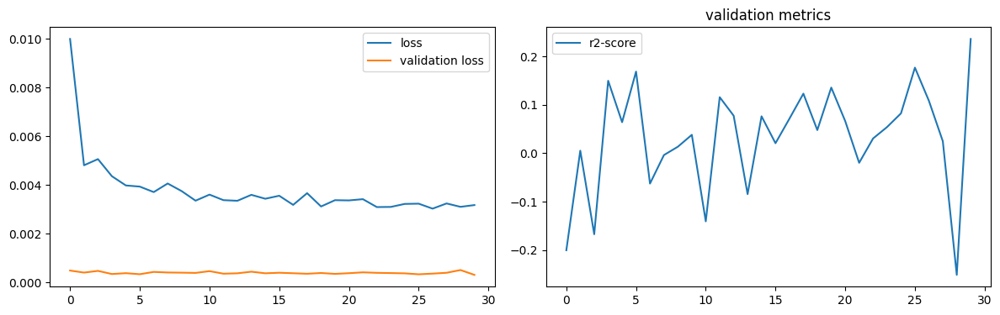

num of dropped: 67
Test: loss: 0.026784148067235947, avg metrics: (0.017554605007171632,)
dropping feature: (1, 'neuron6')


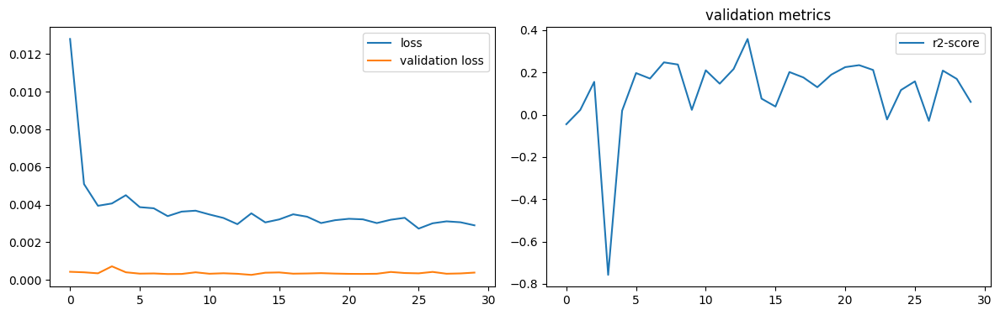

num of dropped: 68
Test: loss: 0.02742815762758255, avg metrics: (-0.020674467086791992,)
dropping feature: (4, 'neuron19')


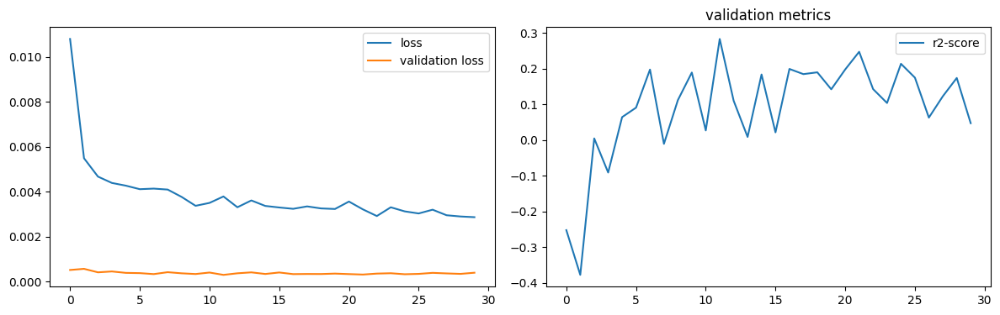

num of dropped: 69
Test: loss: 0.02585155889391899, avg metrics: (0.008088886737823486,)
dropping feature: (16, 'neuron50')


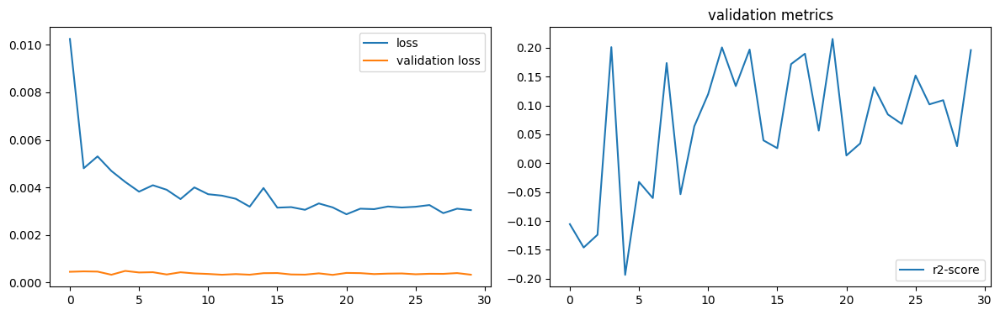

num of dropped: 70
Test: loss: 0.03539271652698517, avg metrics: (-0.04066823720932007,)
dropping feature: (25, 'neuron89')


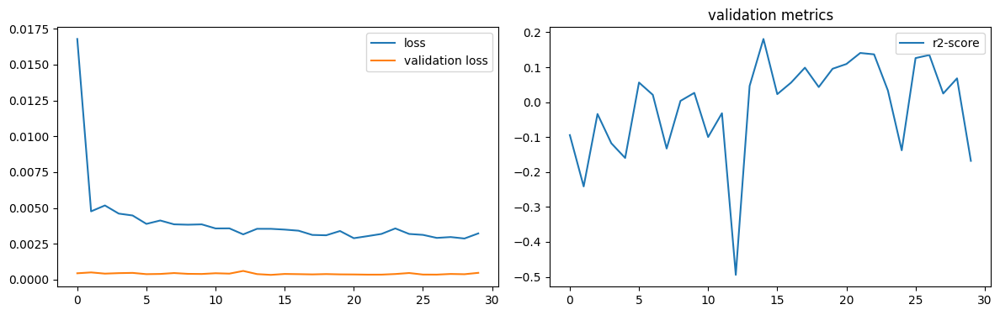

num of dropped: 71
Test: loss: 0.02587019093334675, avg metrics: (0.057551658153533934,)
dropping feature: (3, 'neuron16')


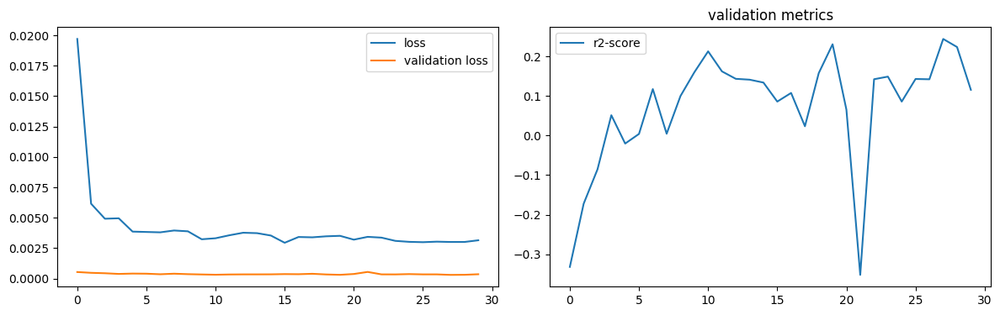

num of dropped: 72
Test: loss: 0.029876168817281723, avg metrics: (0.06179724931716919,)
dropping feature: (1, 'neuron7')


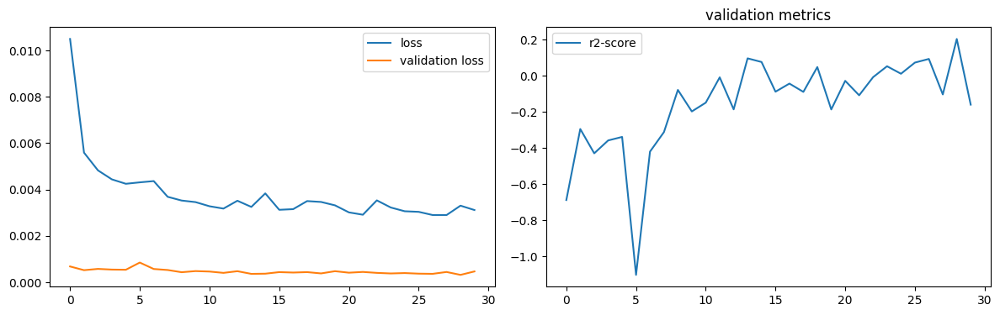

num of dropped: 73
Test: loss: 0.026422522962093353, avg metrics: (0.08738529682159424,)
dropping feature: (0, 'neuron4')


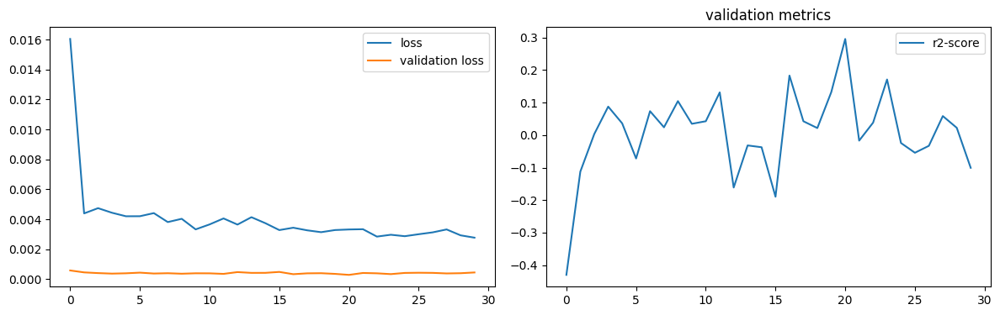

num of dropped: 74
Test: loss: 0.027052205055952072, avg metrics: (0.042354142665863036,)
dropping feature: (22, 'neuron93')


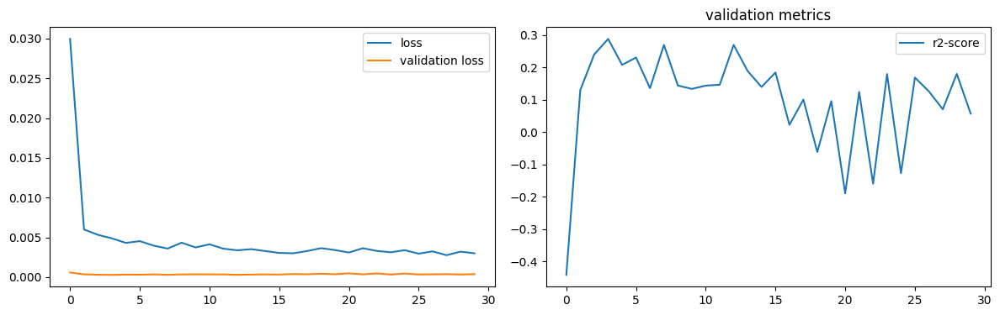

num of dropped: 75
Test: loss: 0.02650764025747776, avg metrics: (0.08286434412002563,)
dropping feature: (9, 'neuron38')


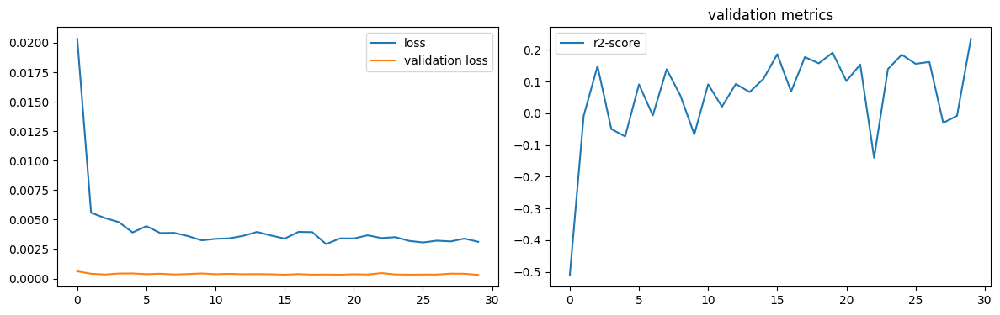

num of dropped: 76
Test: loss: 0.028286287561058998, avg metrics: (0.03343719244003296,)
dropping feature: (14, 'neuron57')


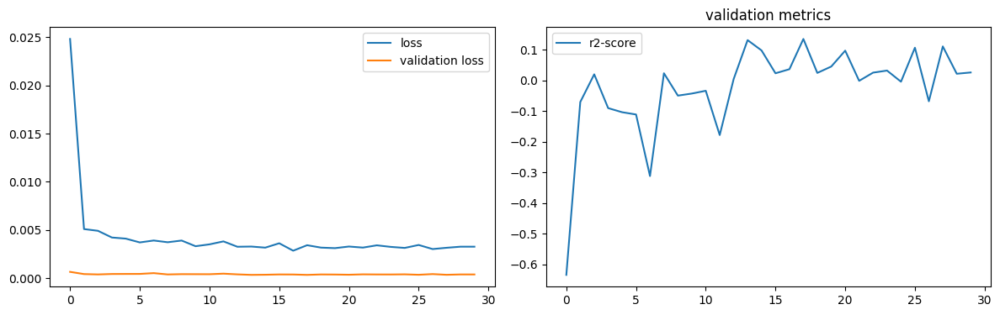

num of dropped: 77
Test: loss: 0.028871506452560425, avg metrics: (0.045063579082489015,)
dropping feature: (15, 'neuron61')


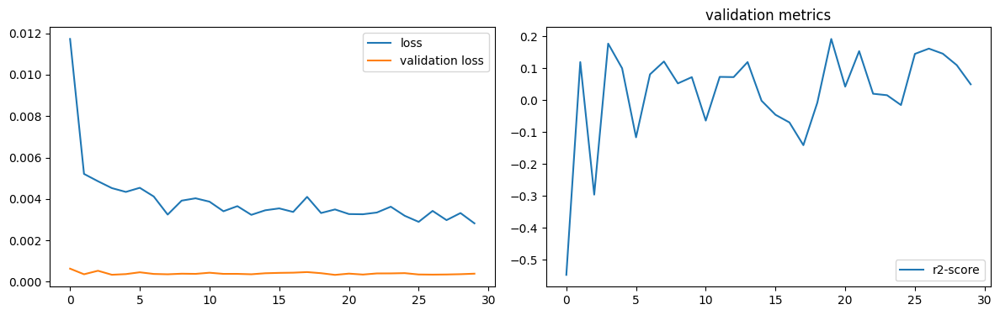

num of dropped: 78
Test: loss: 0.025245079770684242, avg metrics: (0.09537484645843505,)
dropping feature: (7, 'neuron35')


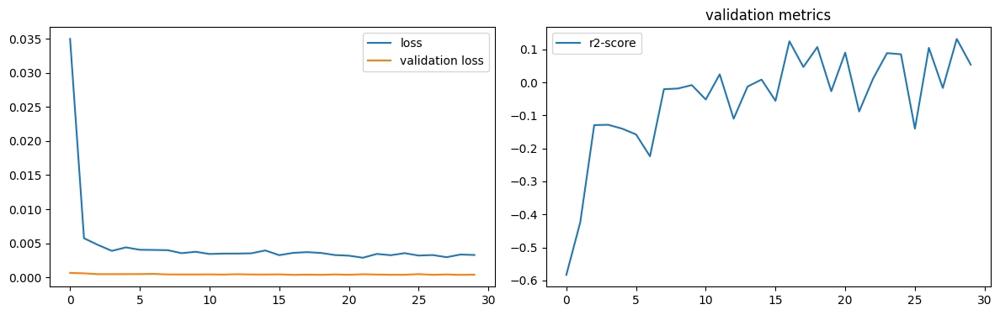

num of dropped: 79
Test: loss: 0.025844059884548187, avg metrics: (0.030818378925323485,)
dropping feature: (1, 'neuron20')


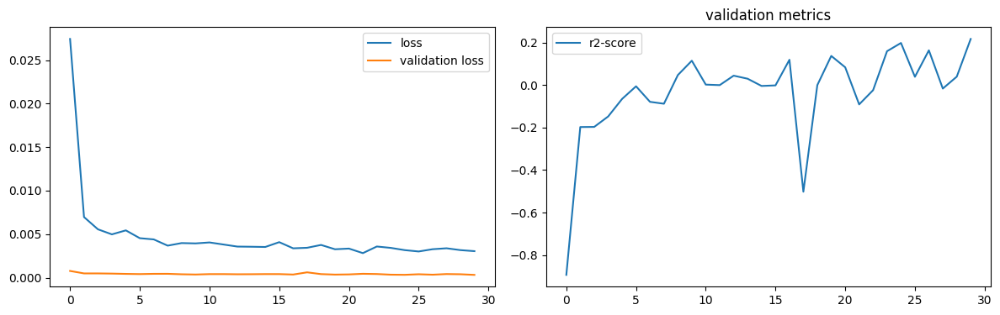

num of dropped: 80
Test: loss: 0.026419218629598618, avg metrics: (0.013994717597961425,)
dropping feature: (7, 'neuron39')


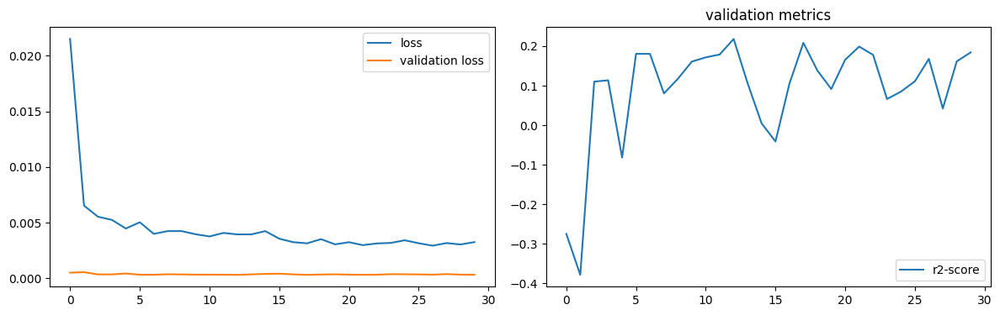

num of dropped: 81
Test: loss: 0.027204306796193123, avg metrics: (0.04299643039703369,)
dropping feature: (14, 'neuron73')


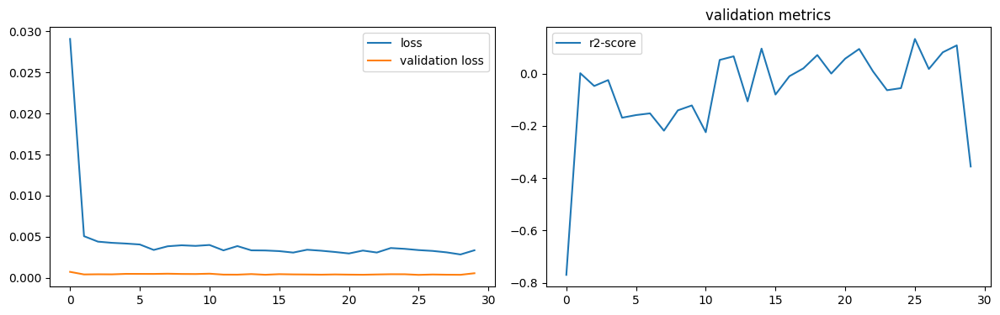

num of dropped: 82
Test: loss: 0.028223806992173195, avg metrics: (-0.023792314529418945,)
dropping feature: (5, 'neuron33')


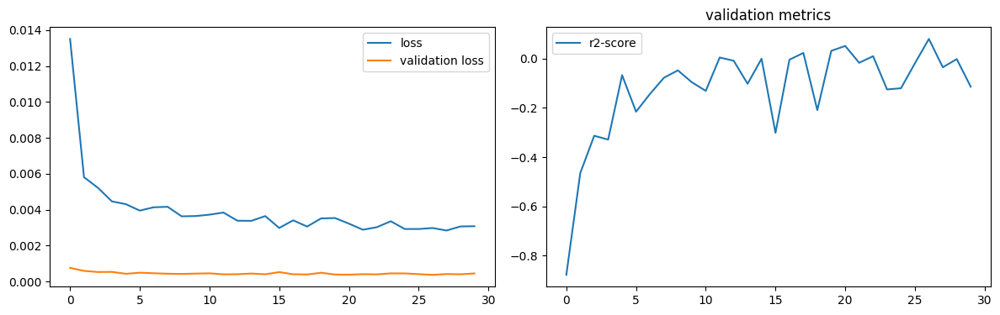

num of dropped: 83
Test: loss: 0.0257409755140543, avg metrics: (0.05515998601913452,)
dropping feature: (4, 'neuron32')


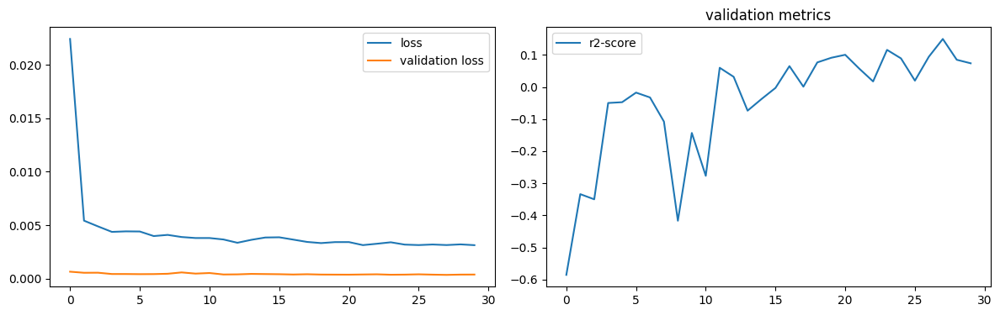

num of dropped: 84
Test: loss: 0.029700804501771927, avg metrics: (0.06147122383117676,)
dropping feature: (7, 'neuron51')


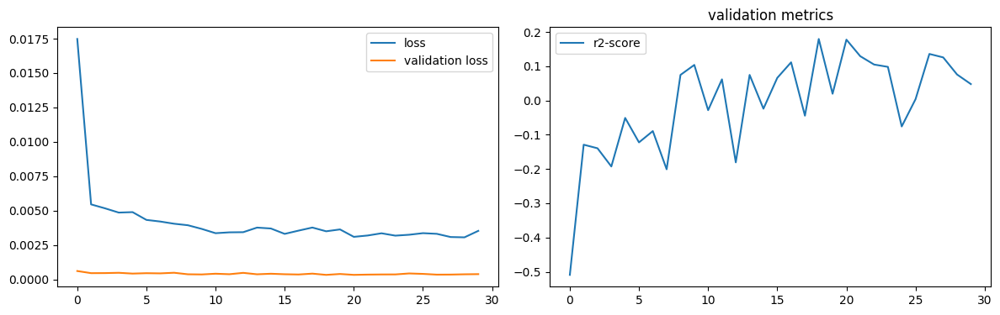

num of dropped: 85
Test: loss: 0.029233725741505623, avg metrics: (0.049074995517730716,)
dropping feature: (0, 'neuron8')


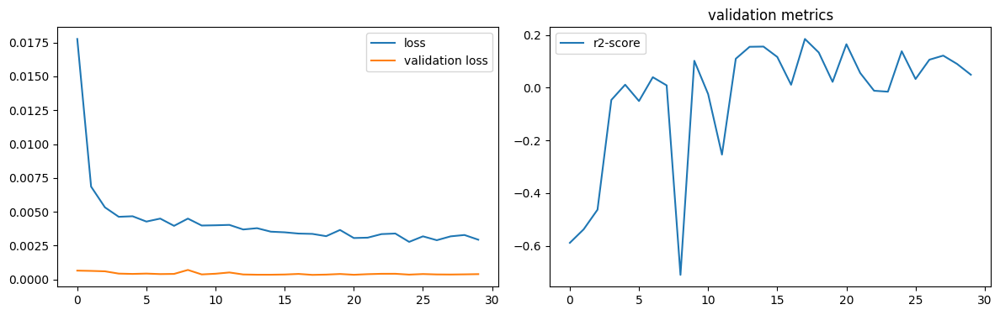

num of dropped: 86
Test: loss: 0.027986042201519012, avg metrics: (0.05637085437774658,)
dropping feature: (7, 'neuron59')


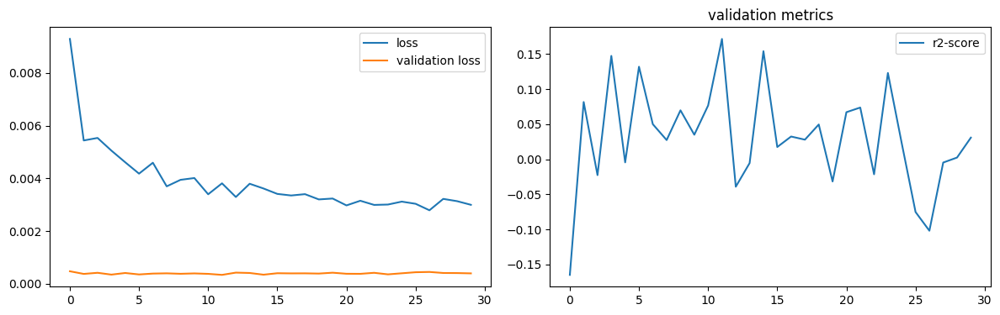

num of dropped: 87
Test: loss: 0.0253825131803751, avg metrics: (0.05773531198501587,)
dropping feature: (11, 'neuron96')


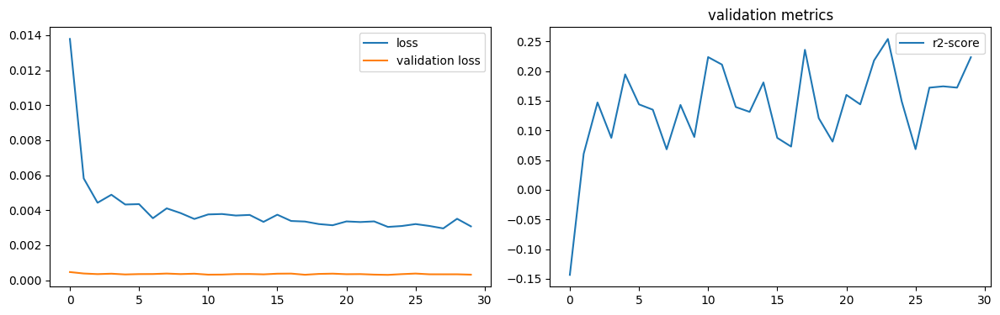

num of dropped: 88
Test: loss: 0.024543261155486107, avg metrics: (0.09795446395874023,)
dropping feature: (4, 'neuron40')


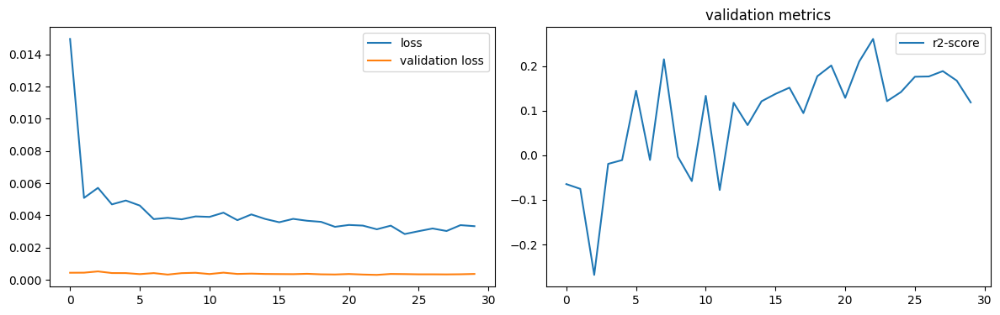

num of dropped: 89
Test: loss: 0.02481003664433956, avg metrics: (0.04662872552871704,)
dropping feature: (6, 'neuron63')


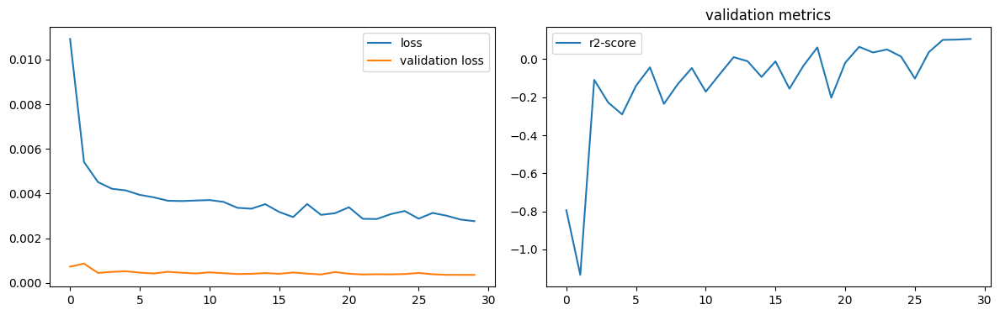

num of dropped: 90
Test: loss: 0.028570715337991714, avg metrics: (0.09052846431732178,)
dropping feature: (0, 'neuron22')


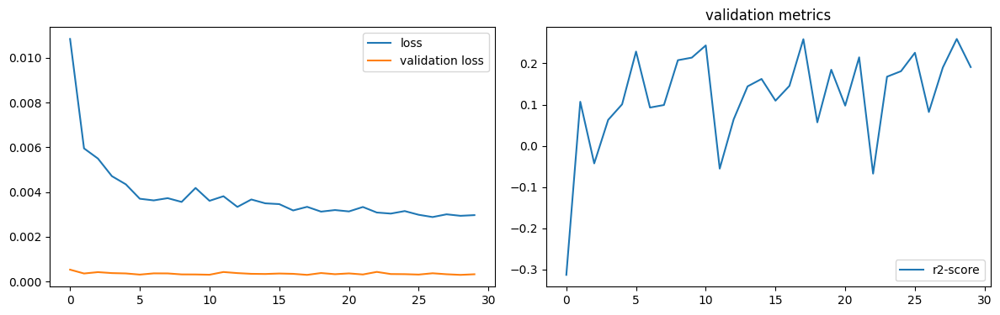

num of dropped: 91
Test: loss: 0.02654031291604042, avg metrics: (-0.012360918521881103,)
dropping feature: (8, 'neuron97')


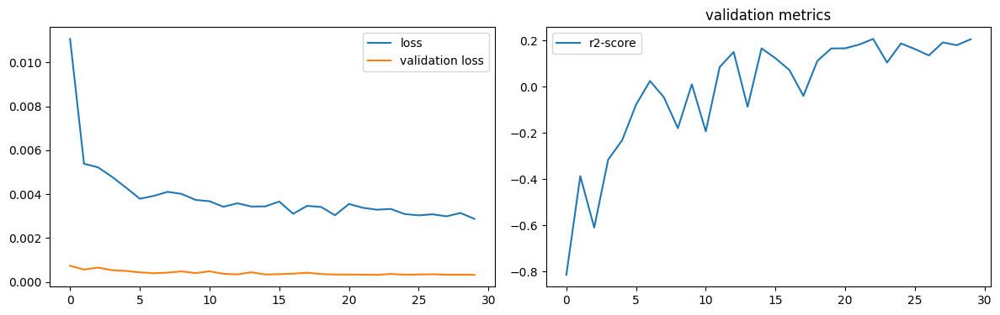

num of dropped: 92
Test: loss: 0.026180721819400787, avg metrics: (0.07378302812576294,)
dropping feature: (4, 'neuron56')


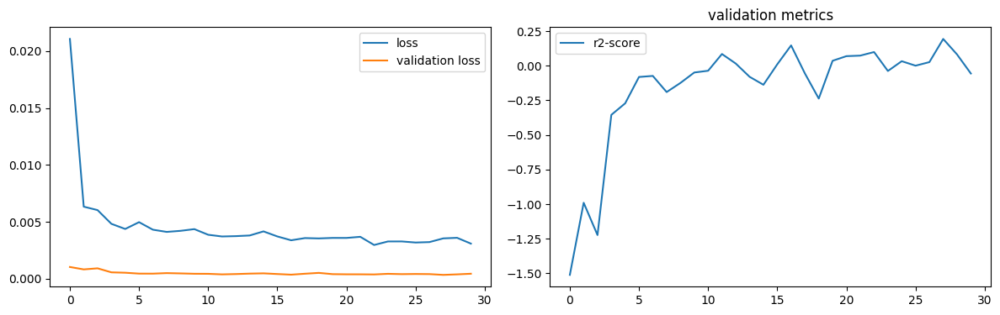

num of dropped: 93
Test: loss: 0.026365479454398155, avg metrics: (0.1499741792678833,)
dropping feature: (3, 'neuron41')


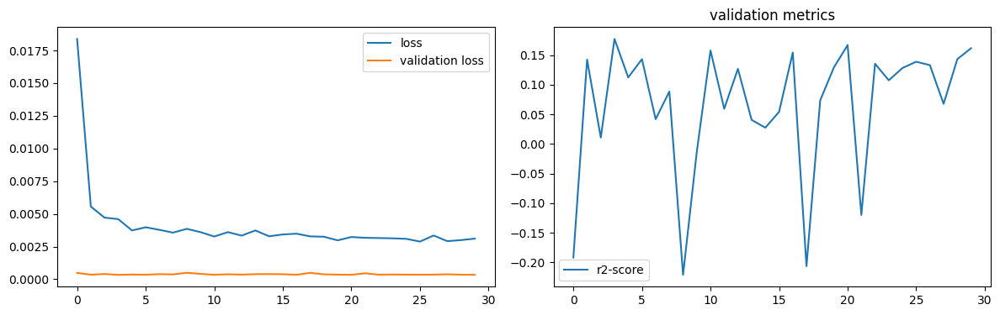

num of dropped: 94
Test: loss: 0.024373585358262062, avg metrics: (0.15892215967178344,)
dropping feature: (0, 'neuron27')


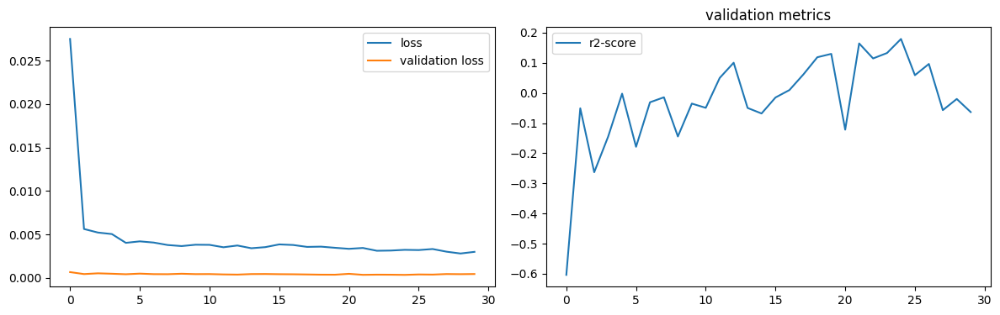

num of dropped: 95
Test: loss: 0.029688864946365356, avg metrics: (-0.019268608093261717,)
dropping feature: (0, 'neuron31')


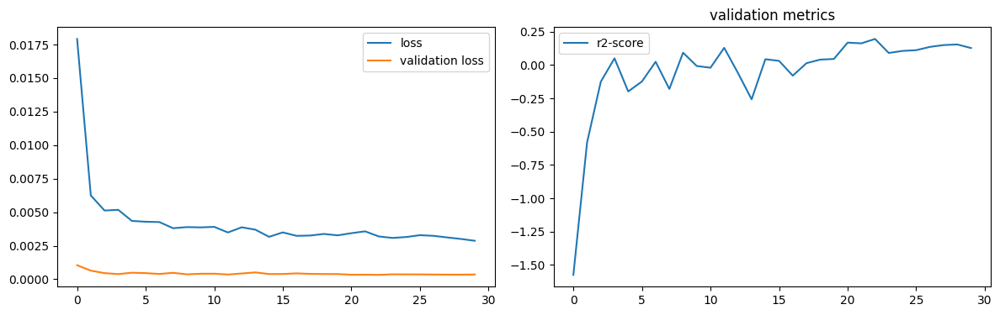

num of dropped: 96
Test: loss: 0.023171784356236458, avg metrics: (0.15361971855163575,)
dropping feature: (2, 'neuron74')


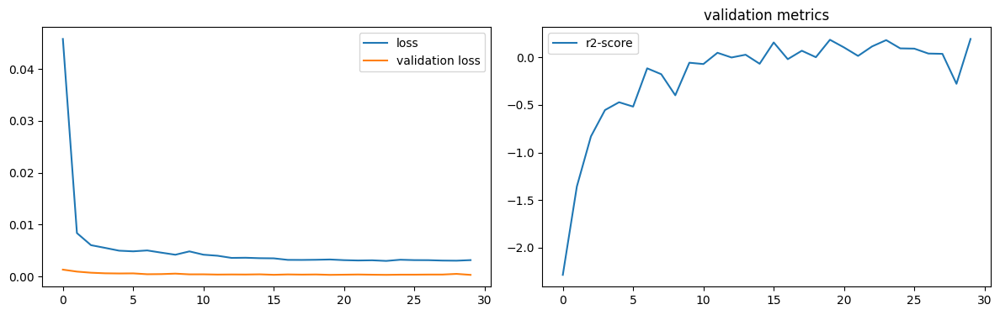

num of dropped: 97
Test: loss: 0.02299020253121853, avg metrics: (0.17370508909225463,)
dropping feature: (1, 'neuron68')


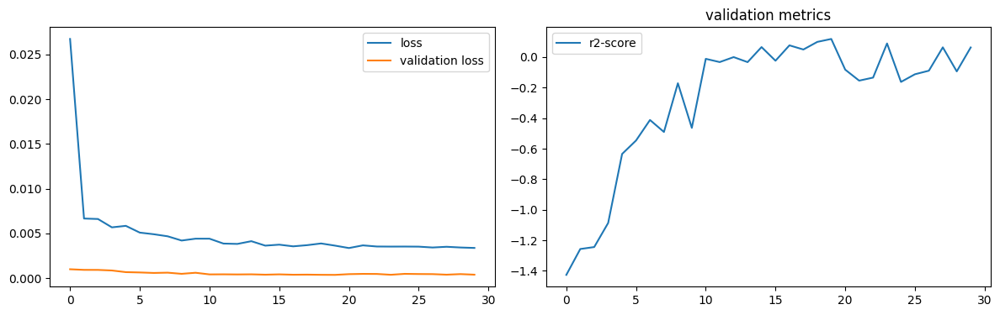

num of dropped: 98
Test: loss: 0.034274496138095856, avg metrics: (-0.11858367919921875,)
dropping feature: (0, 'neuron36')


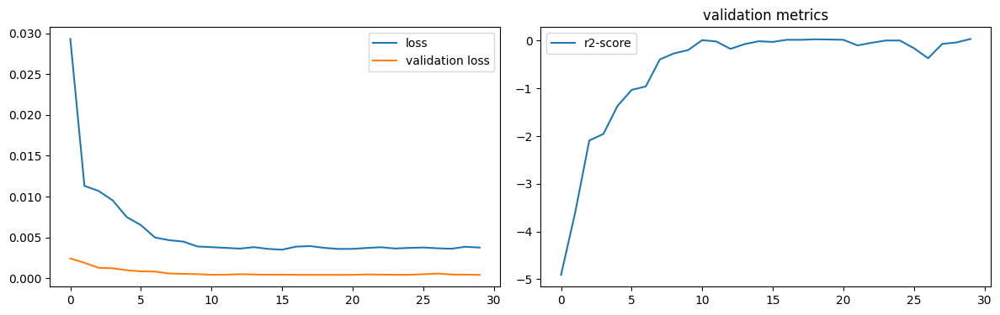

num of dropped: 99
Test: loss: 0.028679173439741135, avg metrics: (-0.03431733846664429,)


In [33]:
torch.manual_seed(2024)

headers = [f"neuron{i}" for i in range(100)]

def model_factory(size):
    model = StudentsNN(1, (size, 100))
    model.layer1 = nn.Identity()
    return model


test_metrics, dropped, models = prune(
    datasets, headers, analyze_fast,
    model_factory, optimizer_factory, criterion, score_outputs, 30,
    labels, "", None
)

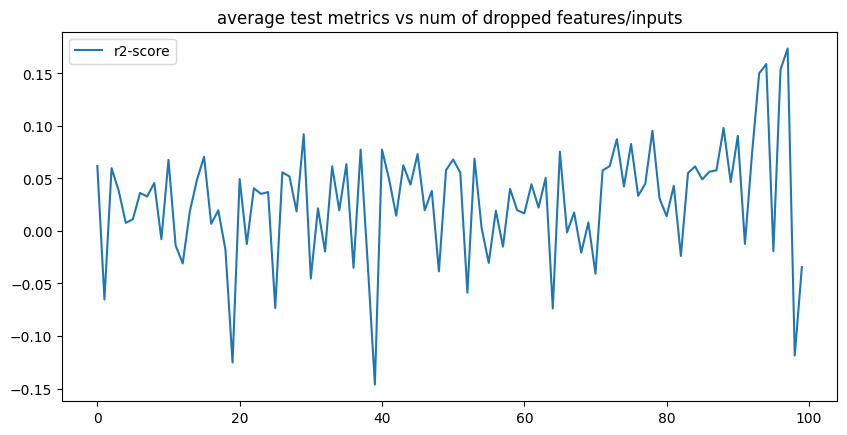

In [34]:
plot_dropping_metrics(test_metrics, labels)

In [35]:
num_drop_neurons = 96

save_models("students", "fast-layer2", models, dropped)

reduced_datasets, reduced_headers = reduce_datasets(datasets, headers, dropped, num_drop_neurons)
layer = models[num_drop_neurons].layer2

best_model.layer2 = layer
best_model.layer1[0] = reduce_linear(best_model.layer1[0], dropped, num_drop_neurons)
best_model.layer1[1] = nn.BatchNorm1d(100 - num_drop_neurons)

features left [4]:  ['neuron36', 'neuron68', 'neuron74', 'neuron94']


### 2nd hidden layer

In [36]:
layer.eval()

datasets = {
    key: TensorDataset(
        layer(dataset.tensors[0]).detach(),
        dataset.tensors[1]
    )
    for key, dataset in reduced_datasets.items()
}

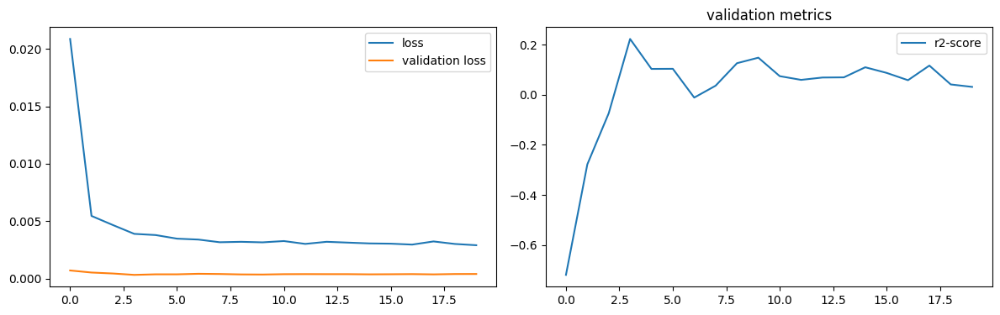

num of dropped: 0
Test: loss: 0.022663123905658722, avg metrics: (0.10523004531860351,)
dropping feature: (34, 'neuron34')


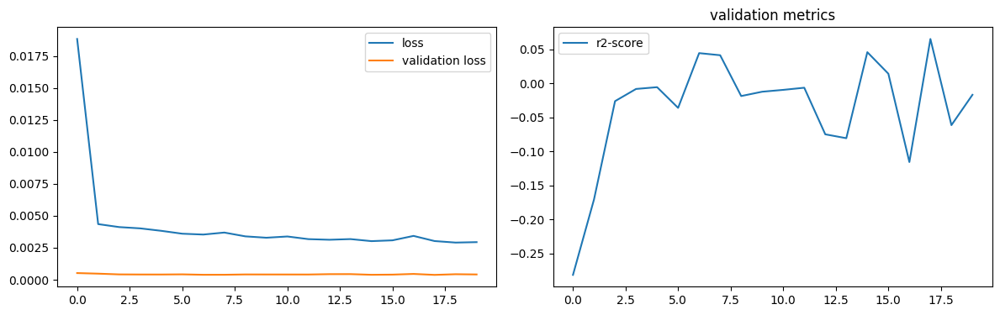

num of dropped: 1
Test: loss: 0.026292799040675163, avg metrics: (0.029451441764831544,)
dropping feature: (98, 'neuron99')


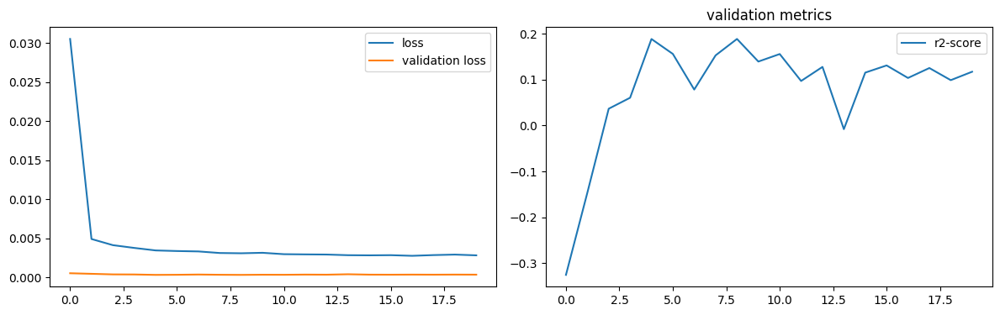

num of dropped: 2
Test: loss: 0.025235621258616447, avg metrics: (0.06436614990234375,)
dropping feature: (61, 'neuron62')


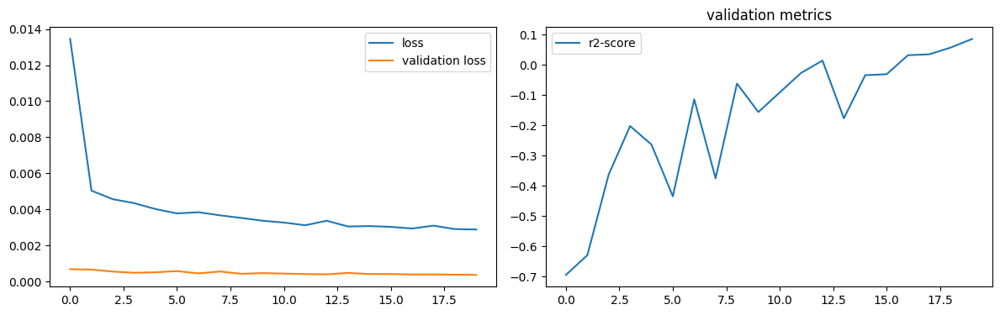

num of dropped: 3
Test: loss: 0.025105176493525505, avg metrics: (0.12825365066528321,)
dropping feature: (82, 'neuron84')


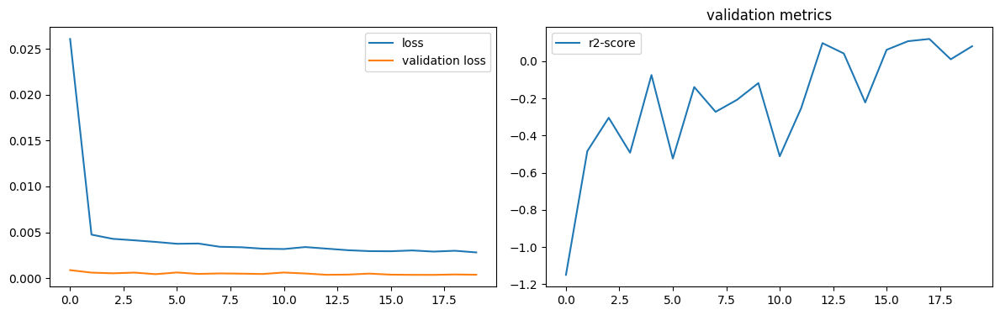

num of dropped: 4
Test: loss: 0.02652355283498764, avg metrics: (0.1086394190788269,)
dropping feature: (68, 'neuron70')


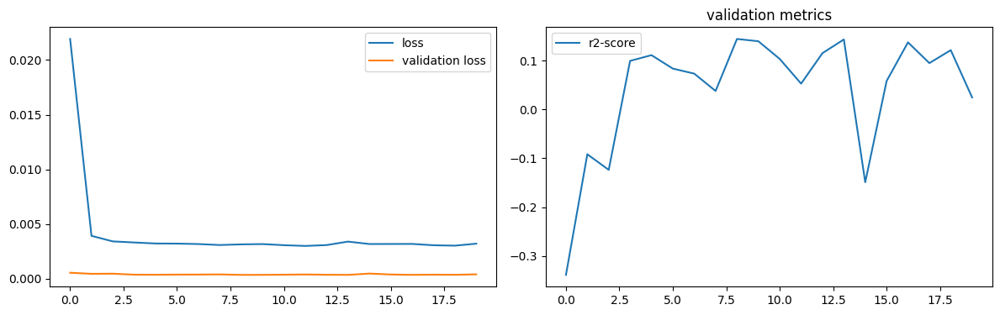

num of dropped: 5
Test: loss: 0.025092635303735733, avg metrics: (0.11479134559631347,)
dropping feature: (35, 'neuron36')


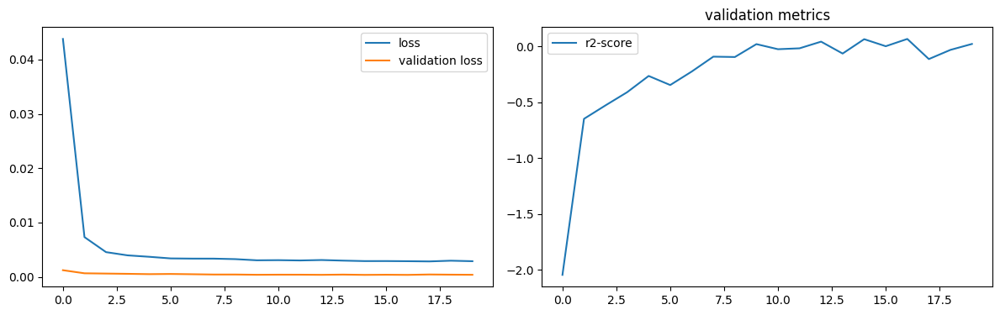

num of dropped: 6
Test: loss: 0.025011194869875908, avg metrics: (0.1272214889526367,)
dropping feature: (28, 'neuron28')


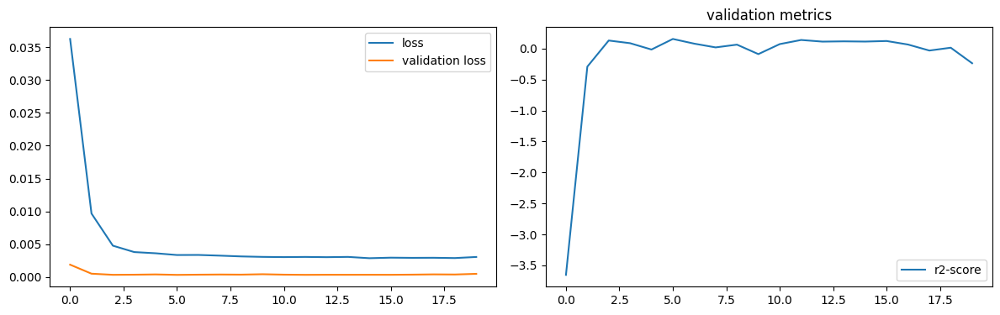

num of dropped: 7
Test: loss: 0.026118343695998192, avg metrics: (0.13930362462997437,)
dropping feature: (10, 'neuron10')


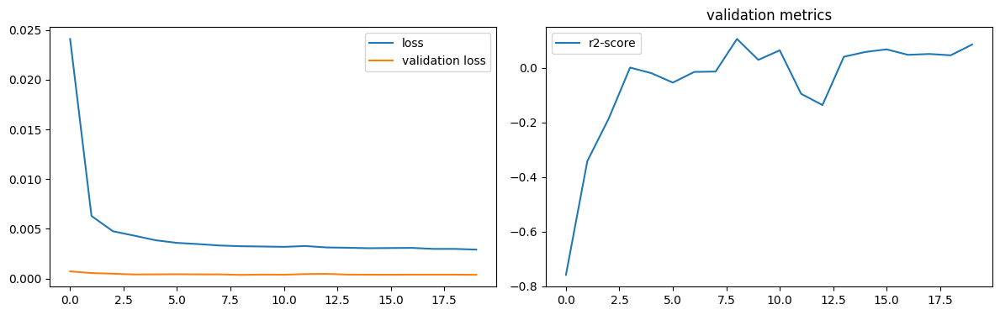

num of dropped: 8
Test: loss: 0.024883590638637543, avg metrics: (0.10464931726455688,)
dropping feature: (51, 'neuron55')


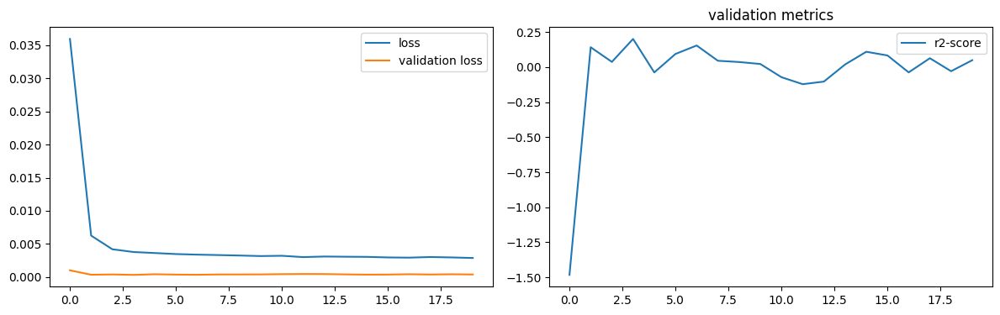

num of dropped: 9
Test: loss: 0.024619413539767265, avg metrics: (0.1563584566116333,)
dropping feature: (58, 'neuron64')


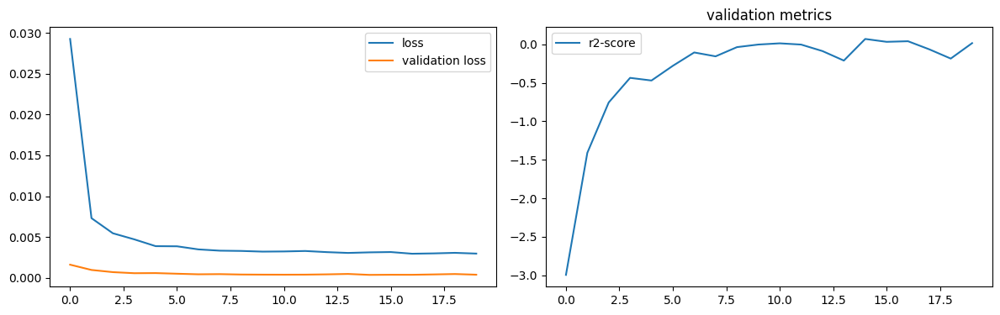

num of dropped: 10
Test: loss: 0.023743145167827606, avg metrics: (0.09075663089752198,)
dropping feature: (24, 'neuron25')


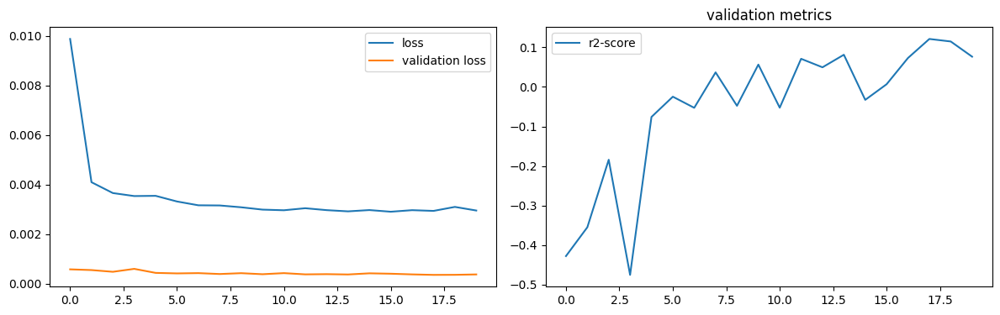

num of dropped: 11
Test: loss: 0.027831465005874634, avg metrics: (0.05101876258850098,)
dropping feature: (3, 'neuron3')


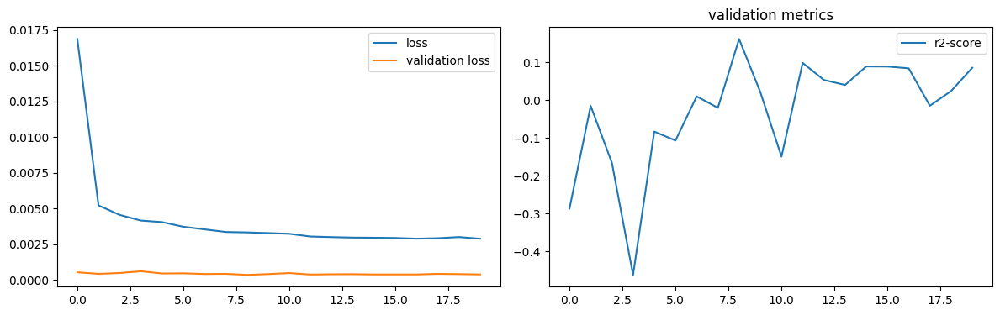

num of dropped: 12
Test: loss: 0.026391983032226562, avg metrics: (0.061308646202087404,)
dropping feature: (67, 'neuron77')


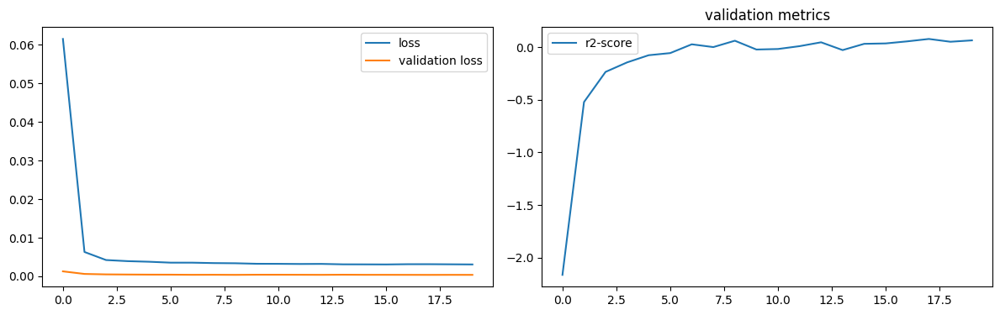

num of dropped: 13
Test: loss: 0.0261077880859375, avg metrics: (0.08769716024398803,)
dropping feature: (29, 'neuron33')


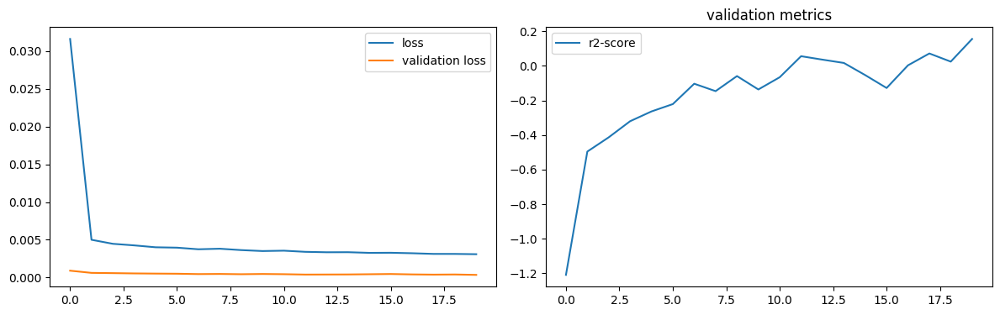

num of dropped: 14
Test: loss: 0.028041353449225426, avg metrics: (0.07239739894866944,)
dropping feature: (14, 'neuron16')


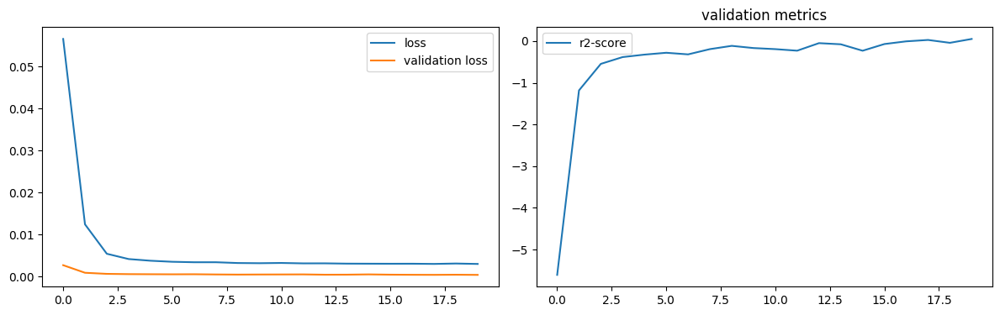

num of dropped: 15
Test: loss: 0.02566491812467575, avg metrics: (0.1334849238395691,)
dropping feature: (78, 'neuron92')


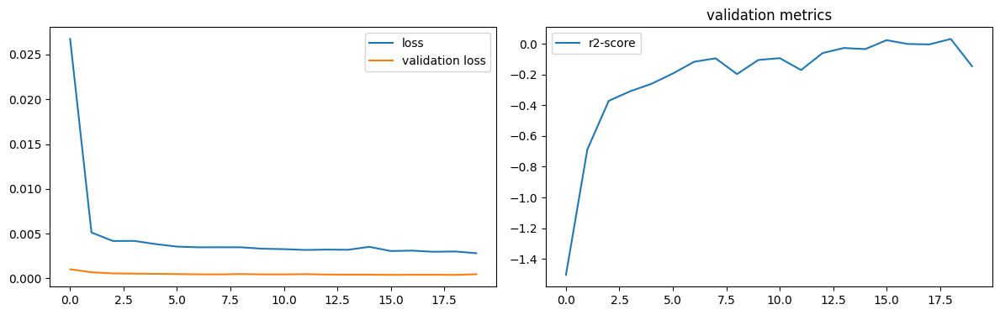

num of dropped: 16
Test: loss: 0.0248260498046875, avg metrics: (0.08926315307617187,)
dropping feature: (60, 'neuron72')


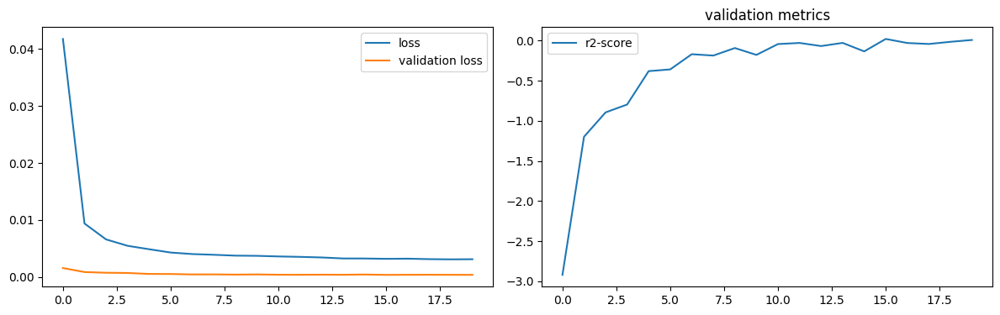

num of dropped: 17
Test: loss: 0.026320314034819603, avg metrics: (0.10297869443893433,)
dropping feature: (19, 'neuron22')


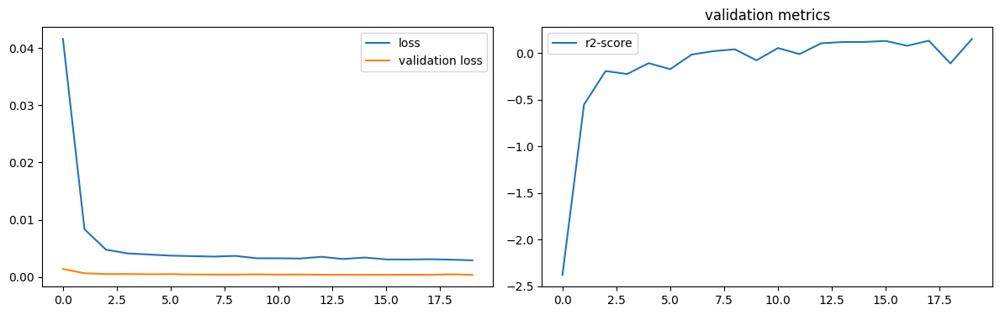

num of dropped: 18
Test: loss: 0.025375692173838615, avg metrics: (0.1023365616798401,)
dropping feature: (52, 'neuron63')


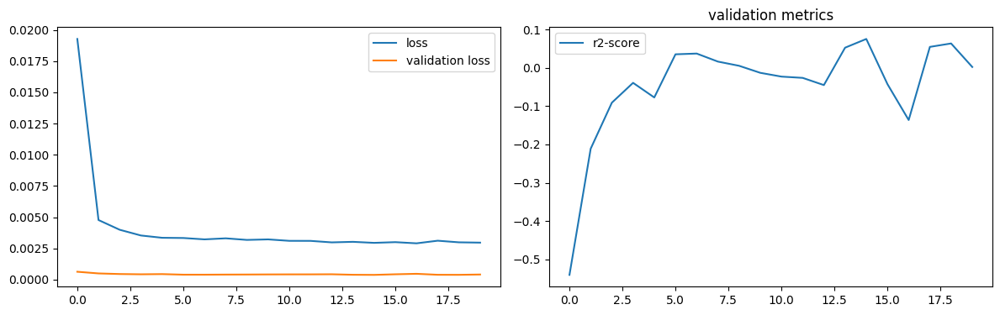

num of dropped: 19
Test: loss: 0.0237885694950819, avg metrics: (0.1283444046974182,)
dropping feature: (41, 'neuron50')


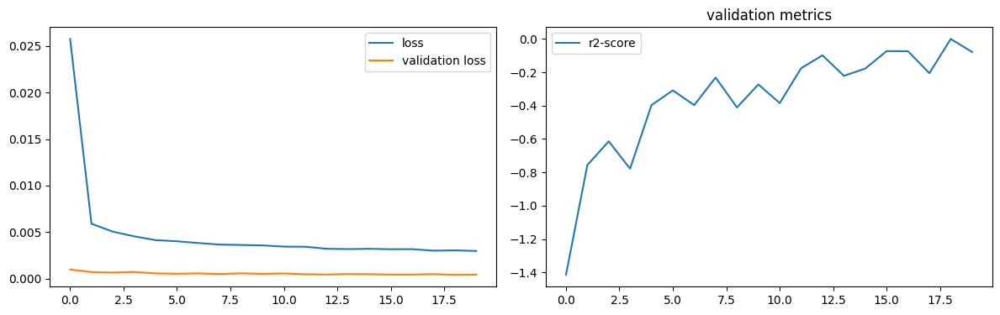

num of dropped: 20
Test: loss: 0.023035472258925438, avg metrics: (0.08771733045578003,)
dropping feature: (8, 'neuron9')


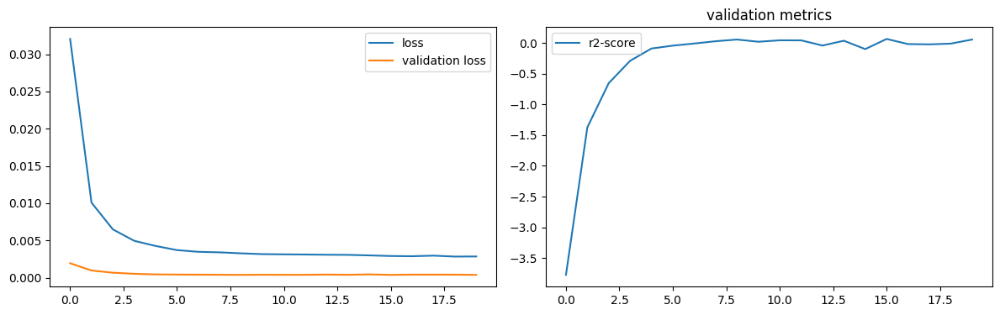

num of dropped: 21
Test: loss: 0.025324217975139618, avg metrics: (0.11760011911392212,)
dropping feature: (54, 'neuron69')


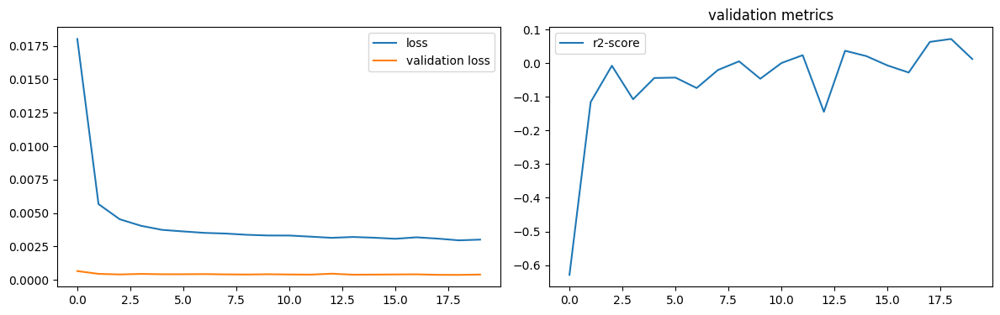

num of dropped: 22
Test: loss: 0.02632955089211464, avg metrics: (0.12100781202316284,)
dropping feature: (50, 'neuron65')


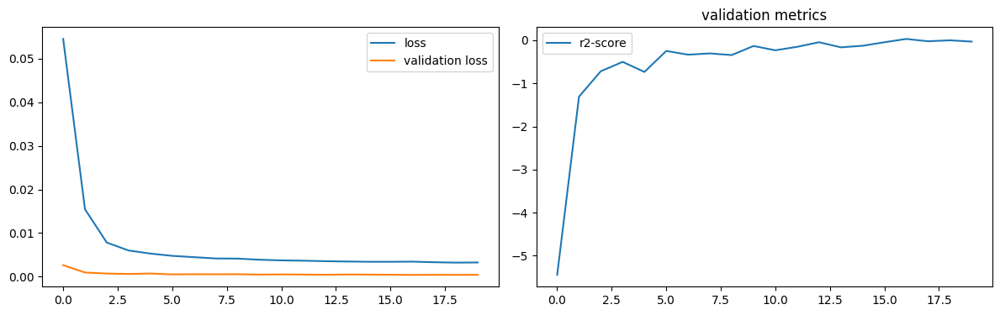

num of dropped: 23
Test: loss: 0.025735385715961456, avg metrics: (0.10968575477600098,)
dropping feature: (41, 'neuron52')


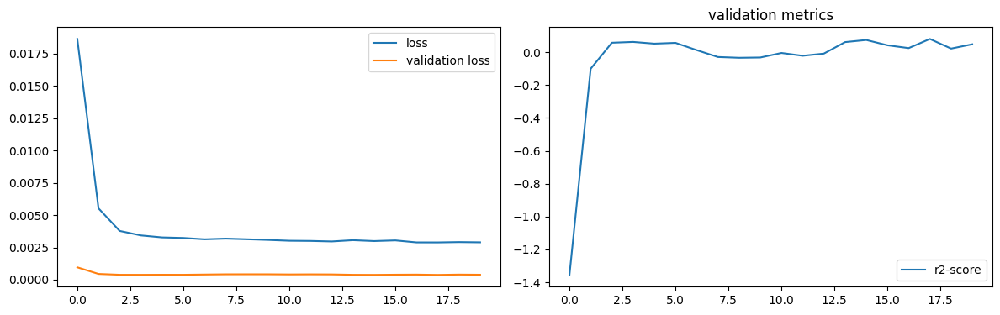

num of dropped: 24
Test: loss: 0.024120857939124107, avg metrics: (0.16662957668304443,)
dropping feature: (69, 'neuron91')


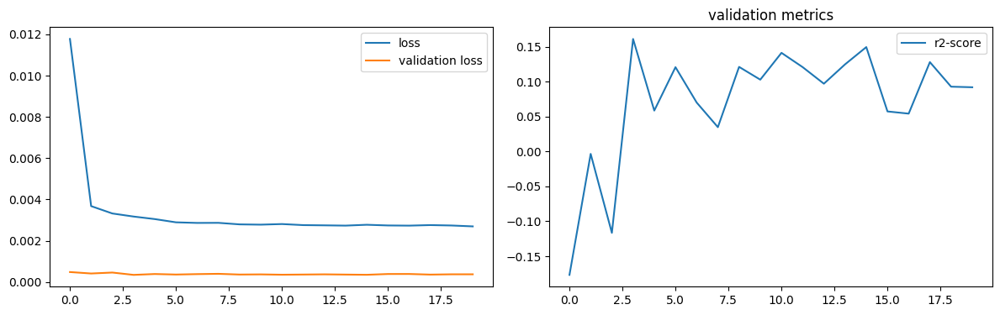

num of dropped: 25
Test: loss: 0.022959962487220764, avg metrics: (0.16638833284378052,)
dropping feature: (4, 'neuron5')


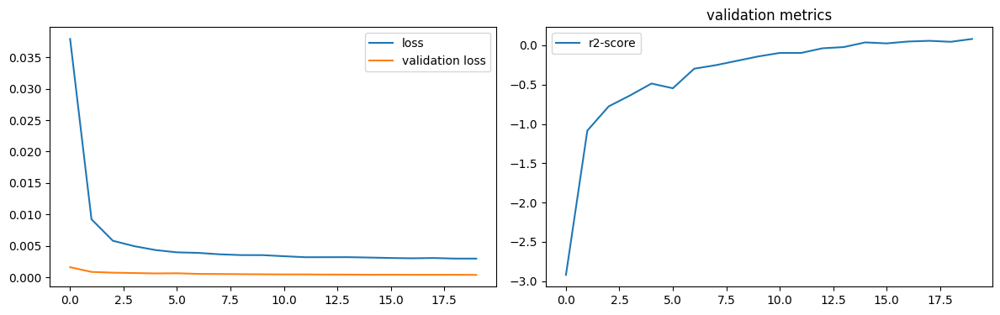

num of dropped: 26
Test: loss: 0.026120593771338463, avg metrics: (0.11695946455001831,)
dropping feature: (46, 'neuron60')


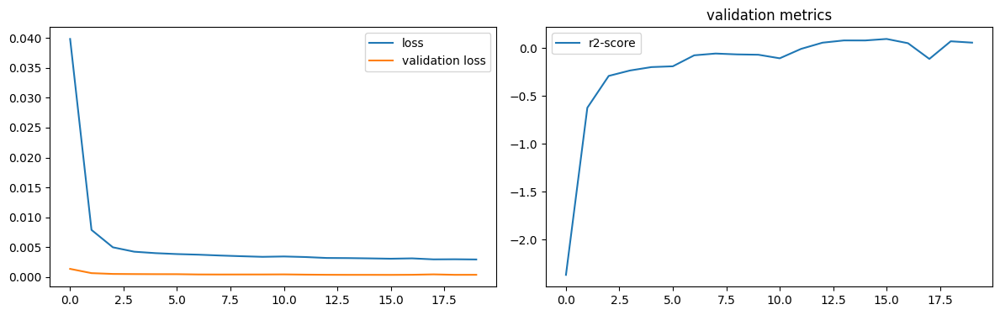

num of dropped: 27
Test: loss: 0.02400464005768299, avg metrics: (0.09792418479919433,)
dropping feature: (57, 'neuron80')


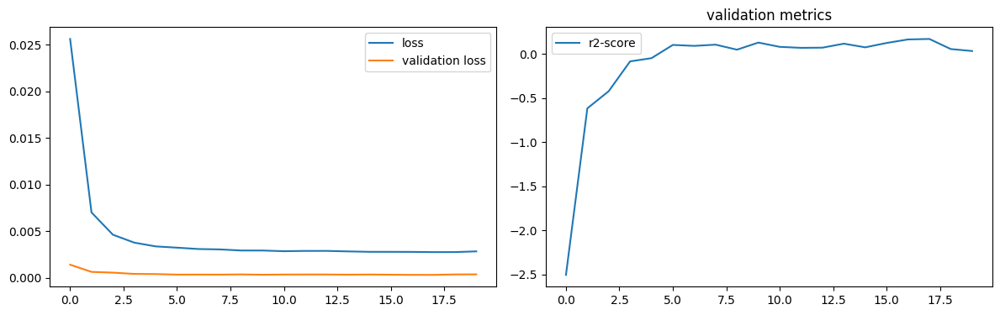

num of dropped: 28
Test: loss: 0.022475359961390495, avg metrics: (0.054690444469451906,)
dropping feature: (17, 'neuron23')


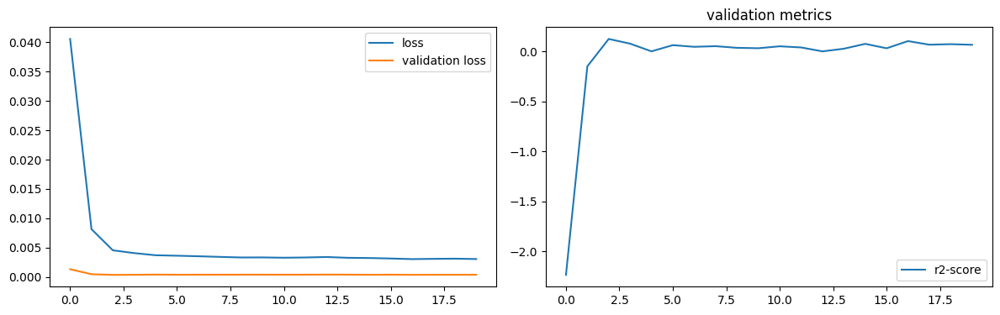

num of dropped: 29
Test: loss: 0.026300795376300812, avg metrics: (0.12335460186004639,)
dropping feature: (60, 'neuron86')


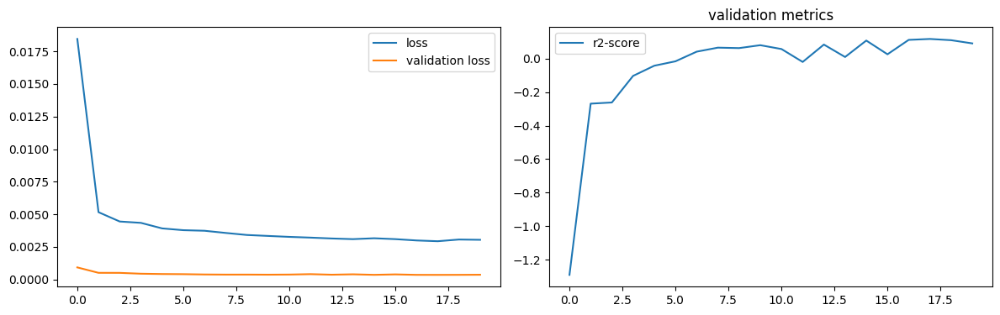

num of dropped: 30
Test: loss: 0.02965695597231388, avg metrics: (0.08084403276443482,)
dropping feature: (14, 'neuron19')


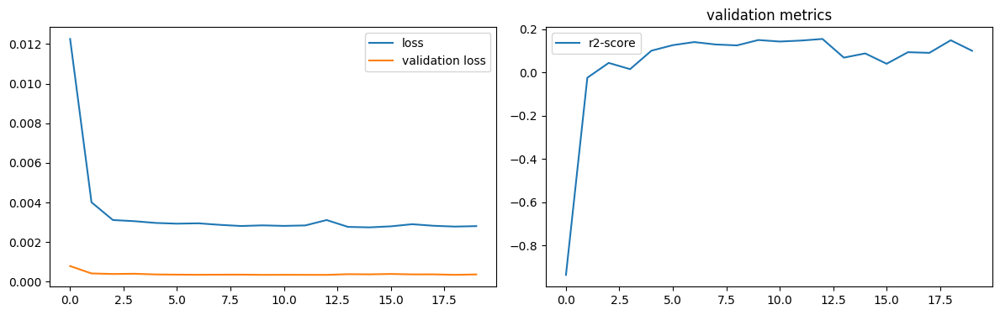

num of dropped: 31
Test: loss: 0.02174520678818226, avg metrics: (0.11571000814437866,)
dropping feature: (55, 'neuron81')


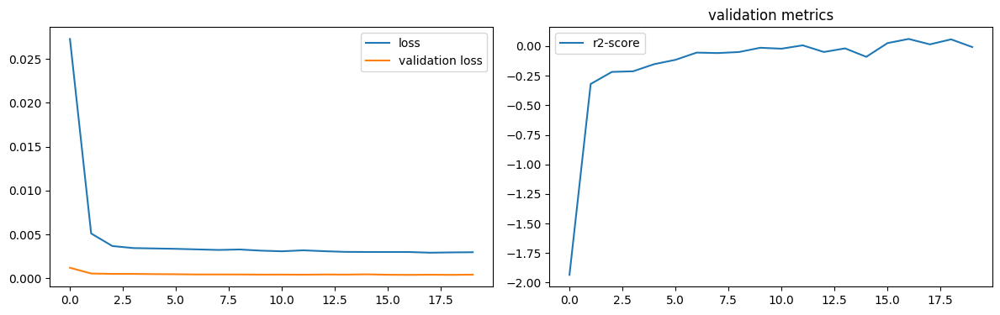

num of dropped: 32
Test: loss: 0.02382533811032772, avg metrics: (0.15186747312545776,)
dropping feature: (55, 'neuron82')


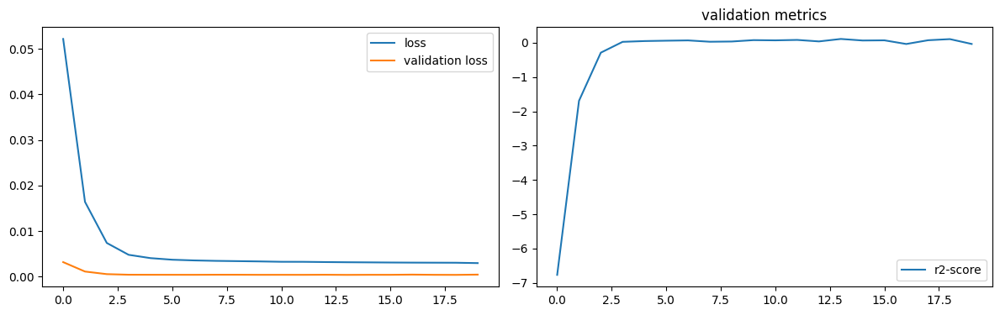

num of dropped: 33
Test: loss: 0.0247186291962862, avg metrics: (0.13373564481735228,)
dropping feature: (13, 'neuron18')


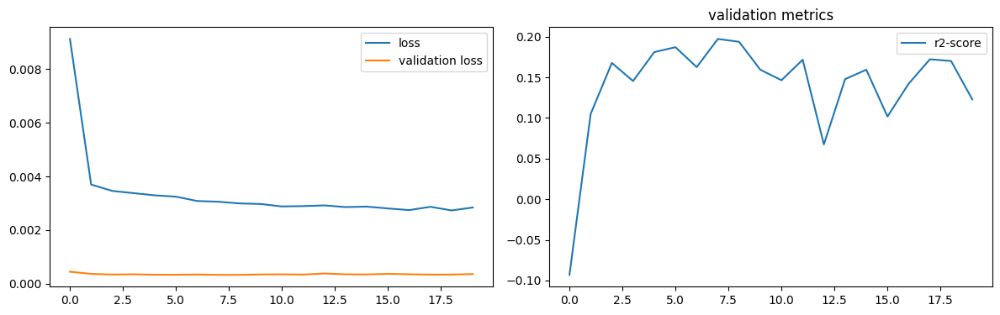

num of dropped: 34
Test: loss: 0.03207491338253021, avg metrics: (0.03660261631011963,)
dropping feature: (21, 'neuron32')


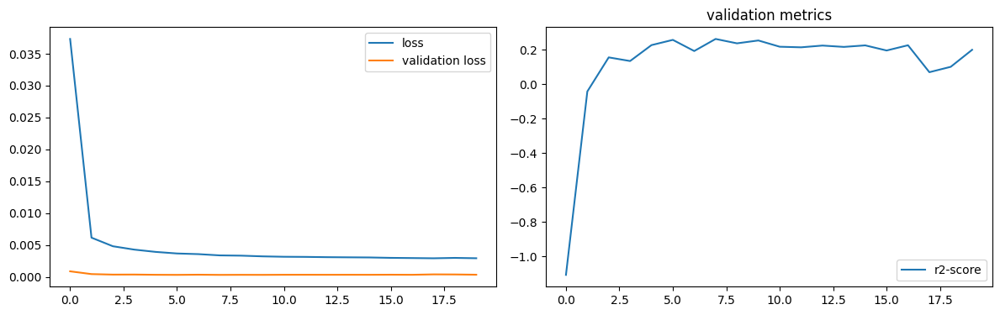

num of dropped: 35
Test: loss: 0.023050734773278236, avg metrics: (0.12008132934570312,)
dropping feature: (11, 'neuron15')


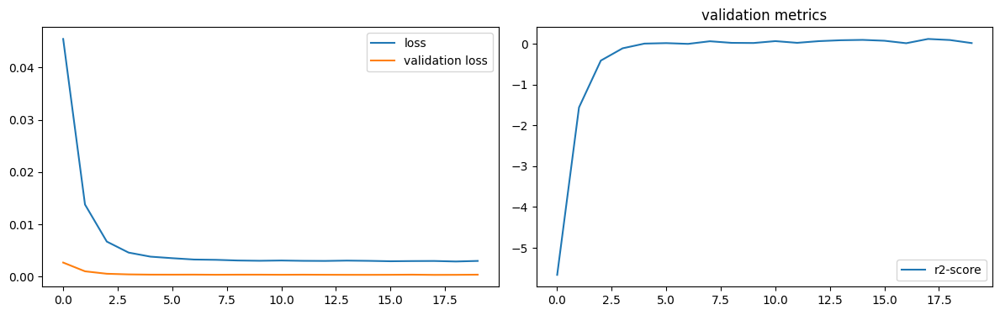

num of dropped: 36
Test: loss: 0.024504605680704117, avg metrics: (0.08592655658721923,)
dropping feature: (46, 'neuron73')


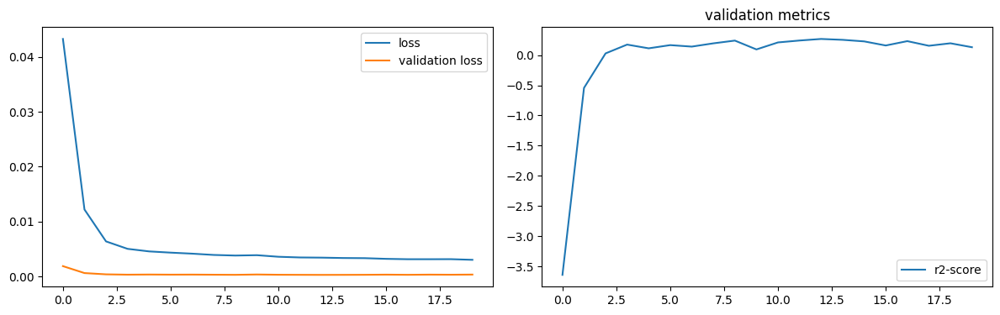

num of dropped: 37
Test: loss: 0.024284426122903824, avg metrics: (0.13473765850067138,)
dropping feature: (10, 'neuron14')


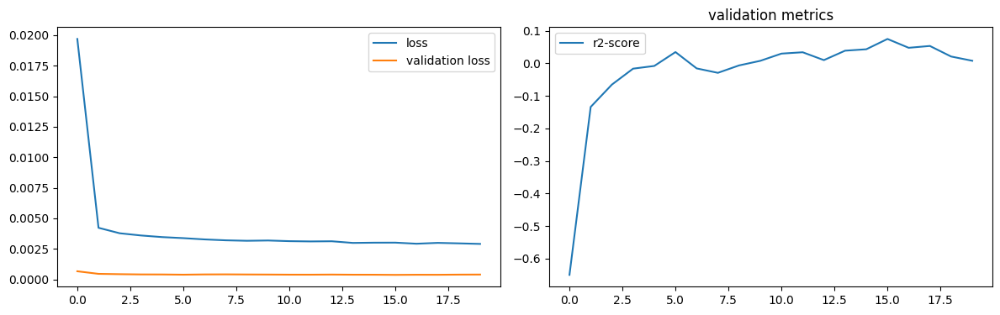

num of dropped: 38
Test: loss: 0.024726947769522667, avg metrics: (0.09078006744384766,)
dropping feature: (44, 'neuron71')


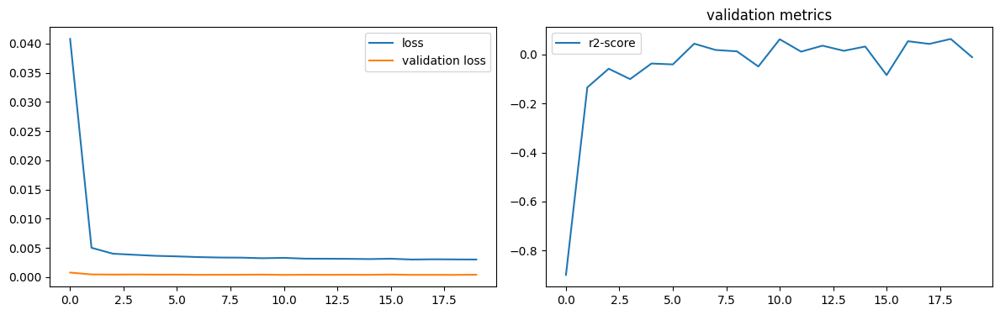

num of dropped: 39
Test: loss: 0.024129388853907585, avg metrics: (0.10029919147491455,)
dropping feature: (42, 'neuron67')


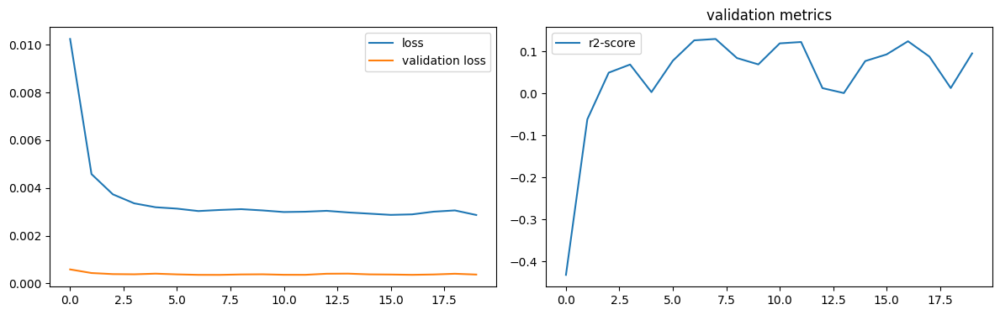

num of dropped: 40
Test: loss: 0.024549094960093498, avg metrics: (0.11417216062545776,)
dropping feature: (9, 'neuron13')


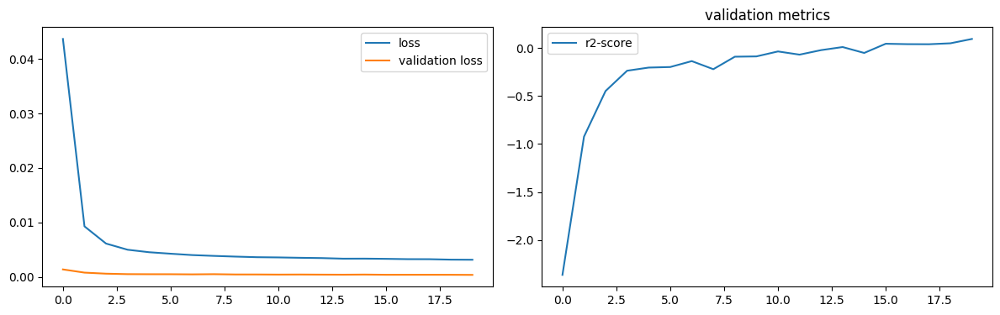

num of dropped: 41
Test: loss: 0.027939913794398308, avg metrics: (0.12068510055541992,)
dropping feature: (7, 'neuron11')


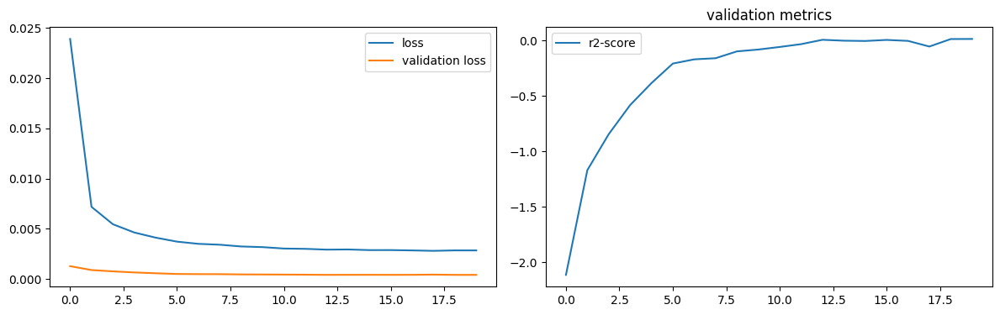

num of dropped: 42
Test: loss: 0.024273918941617012, avg metrics: (0.15931565761566163,)
dropping feature: (17, 'neuron35')


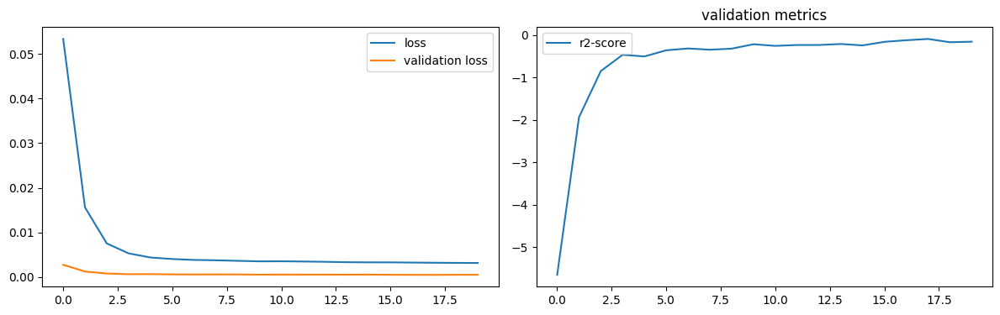

num of dropped: 43
Test: loss: 0.026455020532011986, avg metrics: (0.10663386583328247,)
dropping feature: (10, 'neuron21')


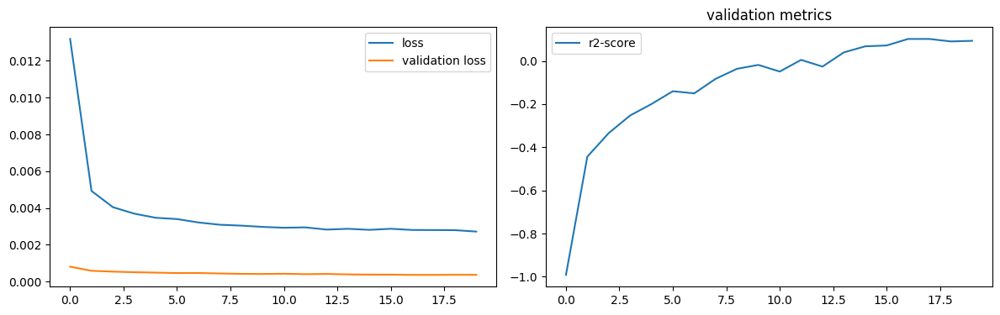

num of dropped: 44
Test: loss: 0.02337186597287655, avg metrics: (0.07618635892868042,)
dropping feature: (18, 'neuron39')


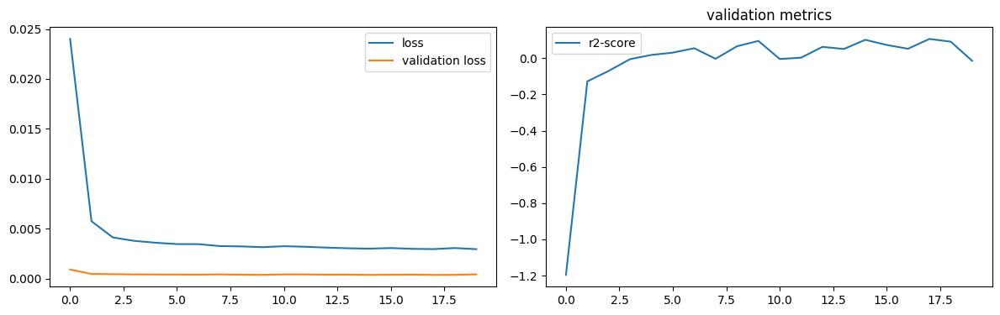

num of dropped: 45
Test: loss: 0.025115665048360825, avg metrics: (0.10207223892211914,)
dropping feature: (52, 'neuron96')


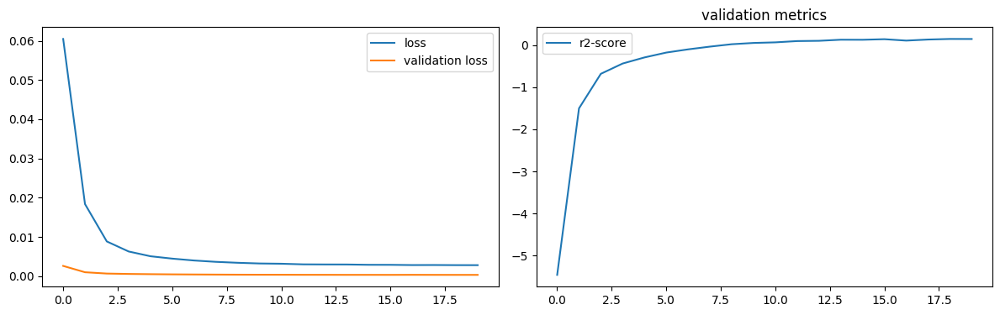

num of dropped: 46
Test: loss: 0.02603277564048767, avg metrics: (0.10774211883544922,)
dropping feature: (11, 'neuron26')


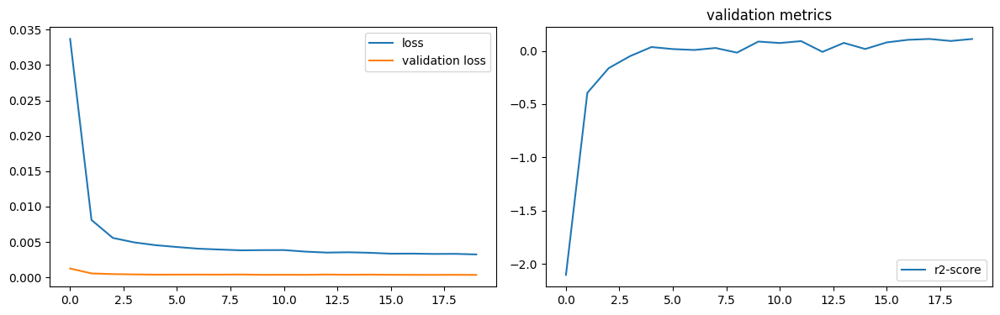

num of dropped: 47
Test: loss: 0.02956763096153736, avg metrics: (0.10618326663970948,)
dropping feature: (31, 'neuron57')


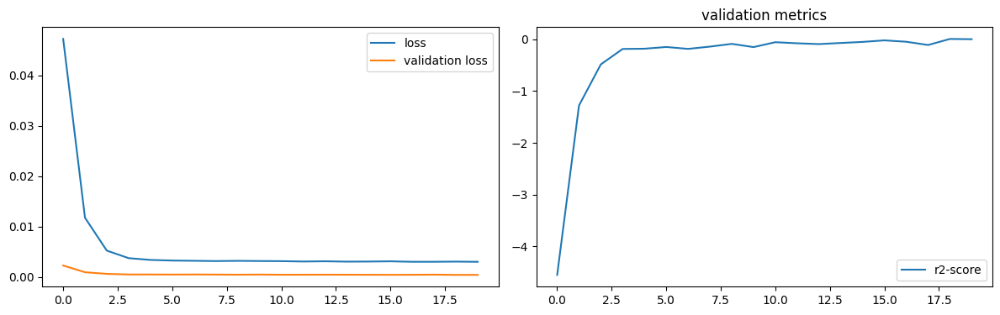

num of dropped: 48
Test: loss: 0.025759896263480186, avg metrics: (0.12031768560409546,)
dropping feature: (13, 'neuron30')


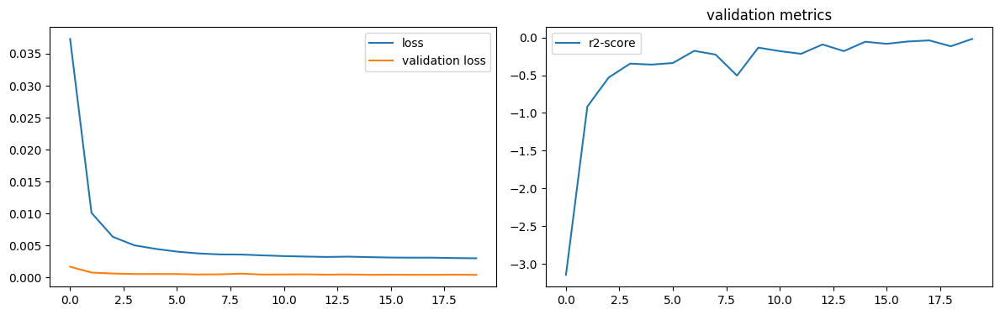

num of dropped: 49
Test: loss: 0.025672219693660736, avg metrics: (0.12856838703155518,)
dropping feature: (20, 'neuron44')


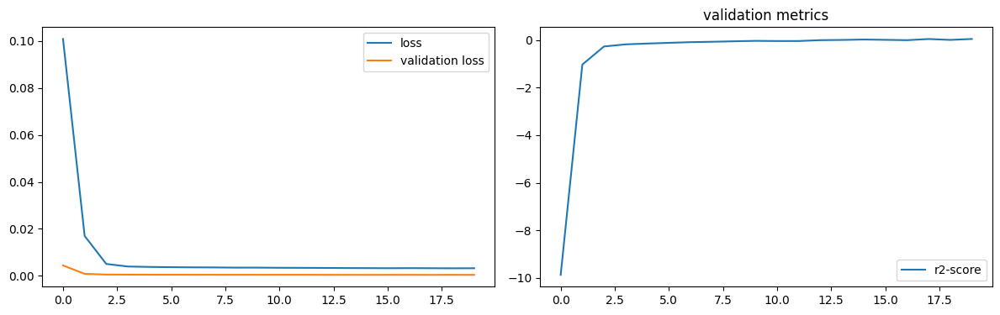

num of dropped: 50
Test: loss: 0.028263941407203674, avg metrics: (0.09034737348556518,)
dropping feature: (9, 'neuron20')


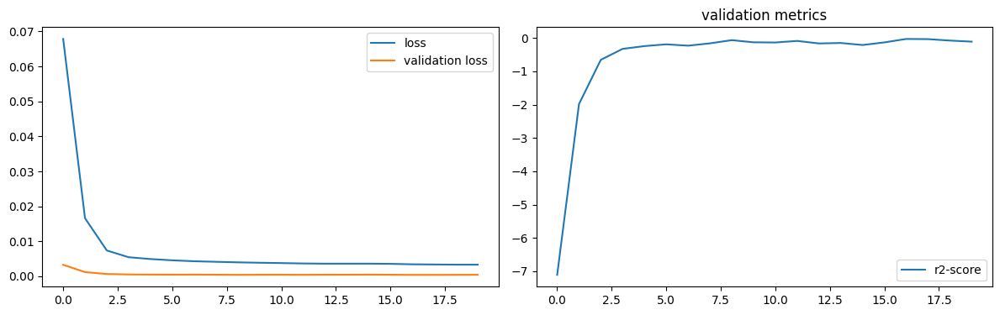

num of dropped: 51
Test: loss: 0.02851288579404354, avg metrics: (0.10963907241821289,)
dropping feature: (7, 'neuron12')


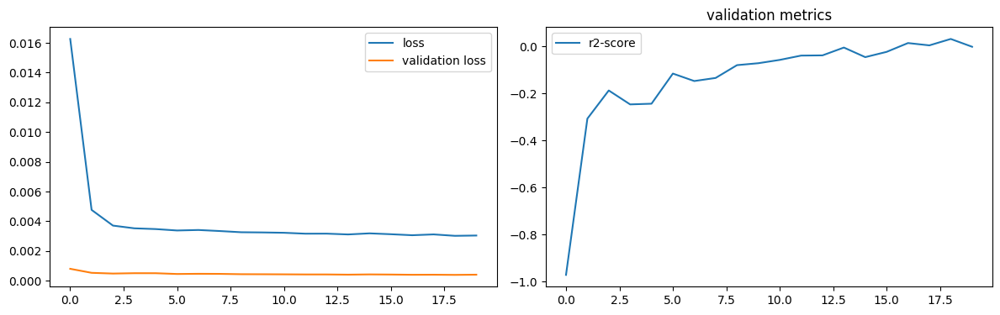

num of dropped: 52
Test: loss: 0.025846820324659348, avg metrics: (0.0935807466506958,)
dropping feature: (22, 'neuron49')


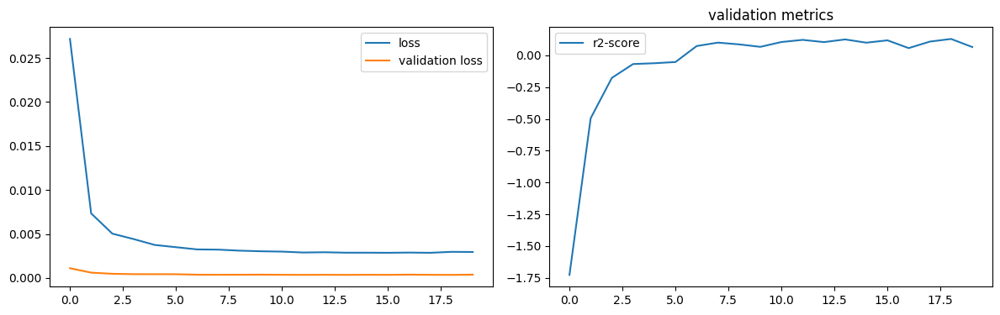

num of dropped: 53
Test: loss: 0.022775880992412567, avg metrics: (0.1382380485534668,)
dropping feature: (37, 'neuron85')


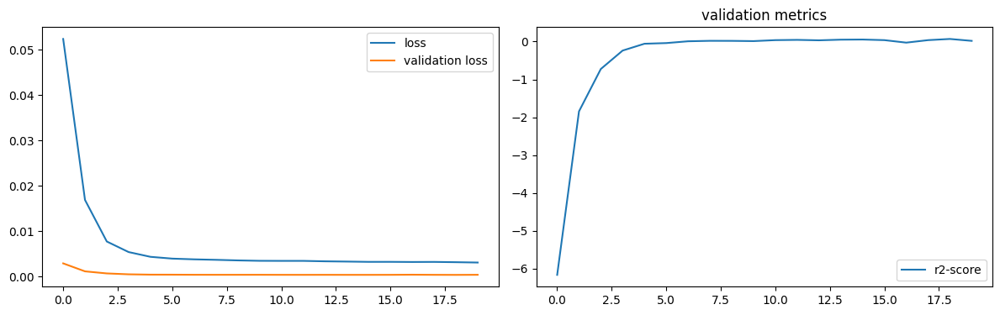

num of dropped: 54
Test: loss: 0.02611728571355343, avg metrics: (0.12908473014831542,)
dropping feature: (10, 'neuron29')


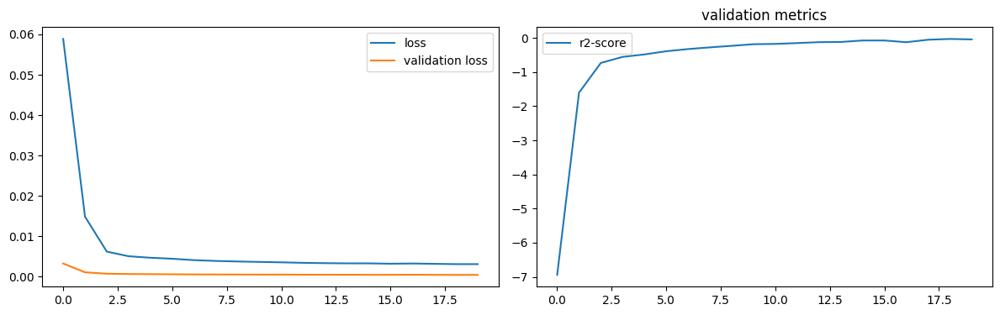

num of dropped: 55
Test: loss: 0.025570068508386612, avg metrics: (0.0851171851158142,)
dropping feature: (16, 'neuron43')


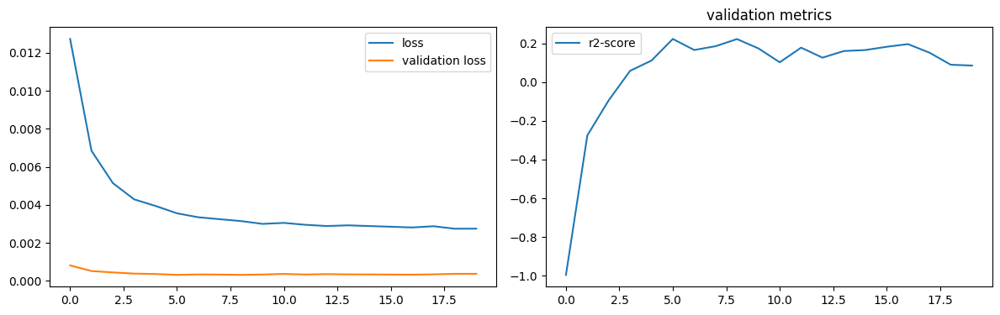

num of dropped: 56
Test: loss: 0.02310102805495262, avg metrics: (0.11662459373474121,)
dropping feature: (0, 'neuron0')


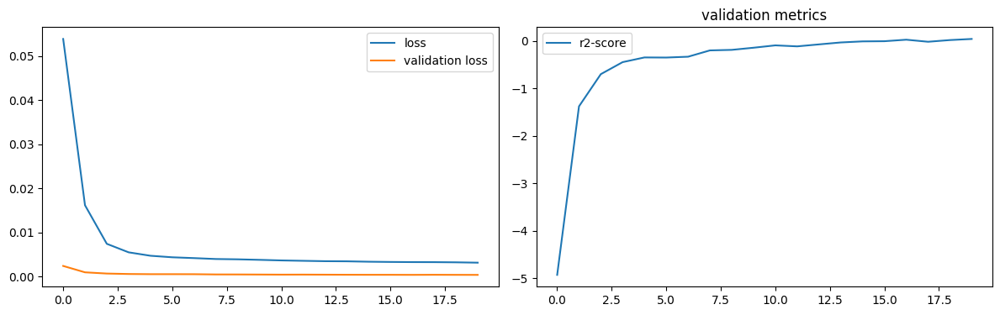

num of dropped: 57
Test: loss: 0.02620886266231537, avg metrics: (0.11616430282592774,)
dropping feature: (23, 'neuron58')


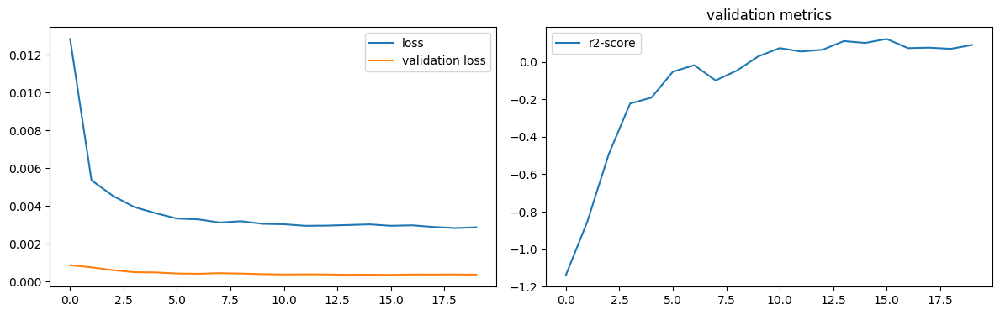

num of dropped: 58
Test: loss: 0.024260088801383972, avg metrics: (0.14045475721359252,)
dropping feature: (37, 'neuron93')


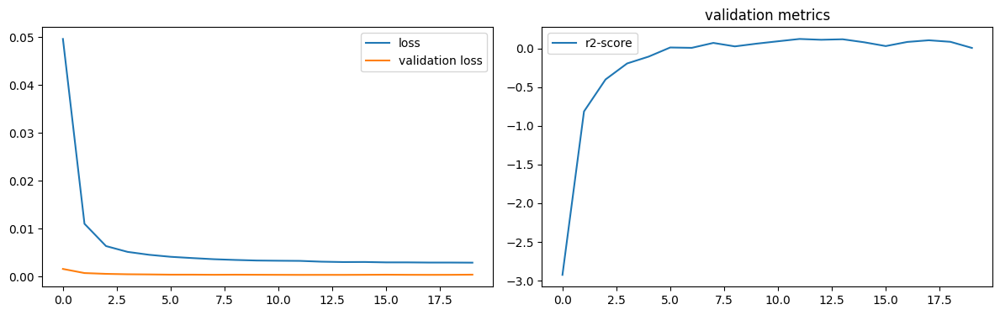

num of dropped: 59
Test: loss: 0.022250758484005928, avg metrics: (0.1256823420524597,)
dropping feature: (27, 'neuron74')


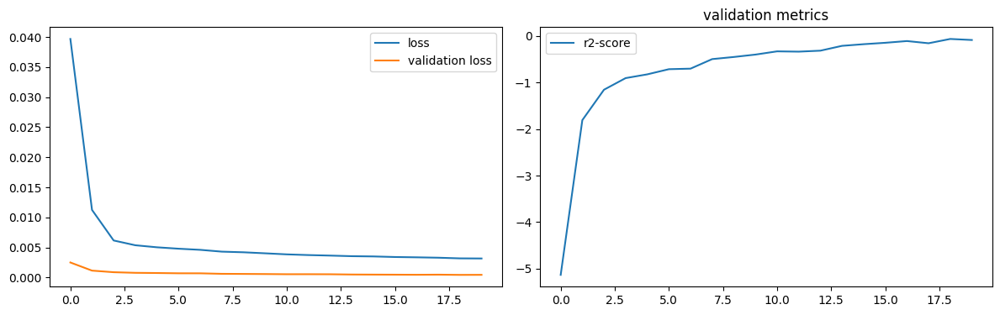

num of dropped: 60
Test: loss: 0.02412232756614685, avg metrics: (0.10645066499710083,)
dropping feature: (27, 'neuron75')


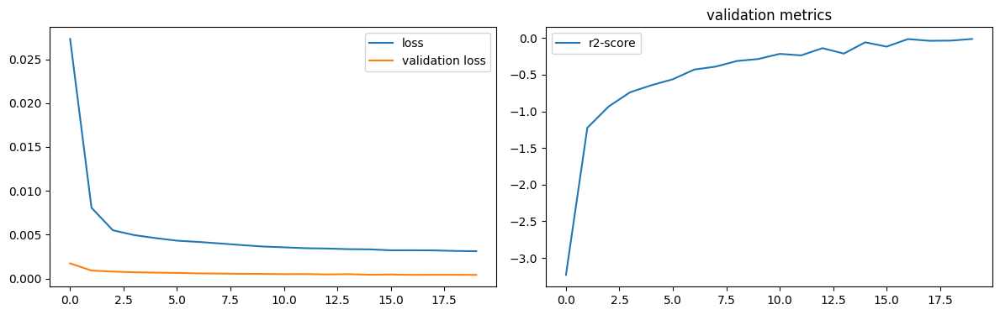

num of dropped: 61
Test: loss: 0.023672303184866905, avg metrics: (0.12436141967773437,)
dropping feature: (11, 'neuron38')


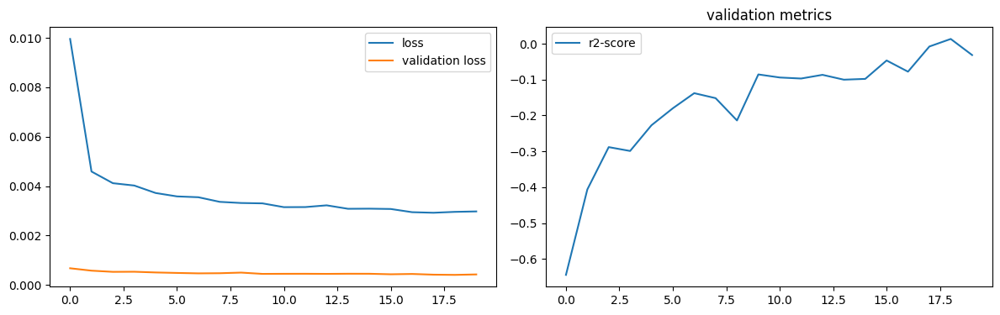

num of dropped: 62
Test: loss: 0.024025410413742065, avg metrics: (0.08822132349014282,)
dropping feature: (22, 'neuron59')


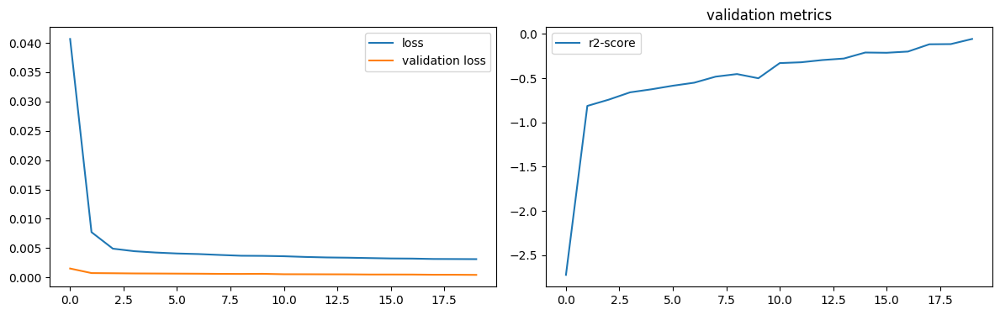

num of dropped: 63
Test: loss: 0.028342140838503838, avg metrics: (0.11713765859603882,)
dropping feature: (28, 'neuron83')


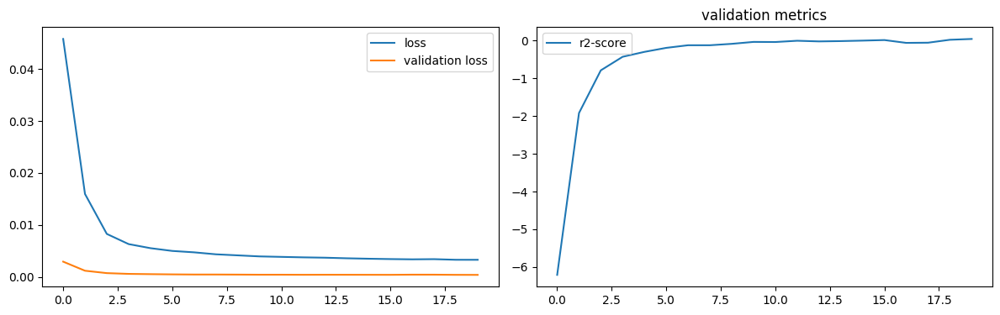

num of dropped: 64
Test: loss: 0.02686159312725067, avg metrics: (0.07028084993362427,)
dropping feature: (3, 'neuron6')


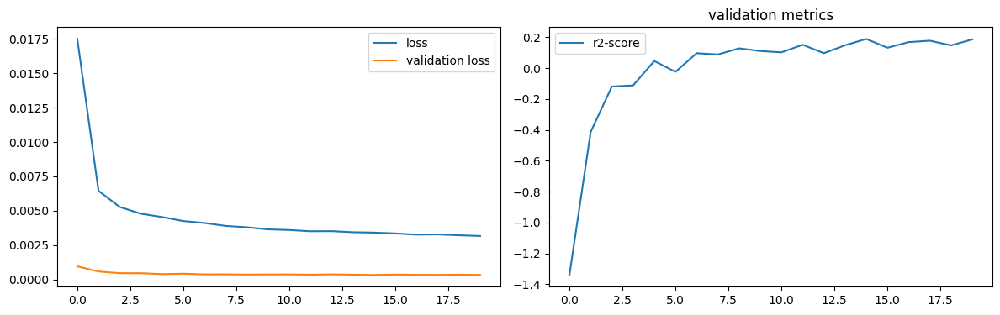

num of dropped: 65
Test: loss: 0.026007238775491714, avg metrics: (0.06515872478485107,)
dropping feature: (15, 'neuron47')


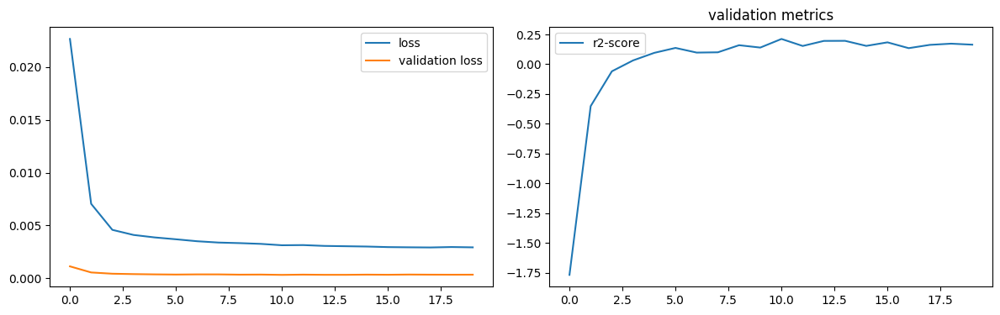

num of dropped: 66
Test: loss: 0.025065993890166283, avg metrics: (0.11686438322067261,)
dropping feature: (33, 'neuron98')


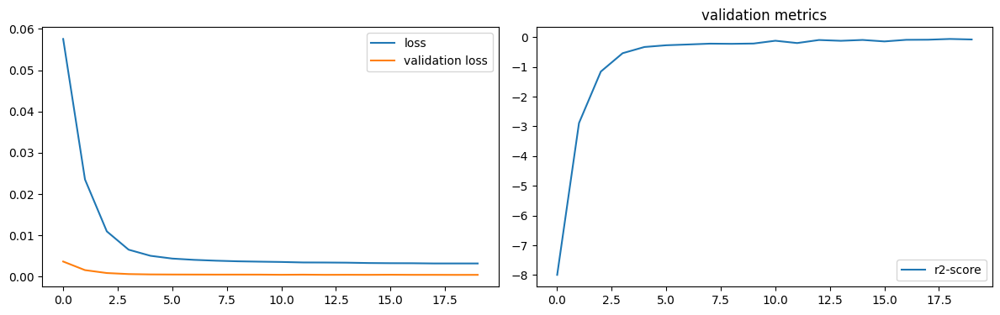

num of dropped: 67
Test: loss: 0.027882276102900505, avg metrics: (0.0747788429260254,)
dropping feature: (30, 'neuron94')


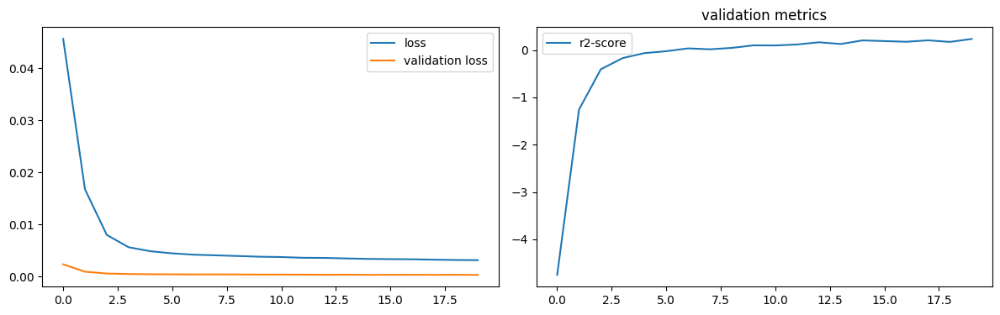

num of dropped: 68
Test: loss: 0.027127912268042564, avg metrics: (0.10911853313446045,)
dropping feature: (13, 'neuron45')


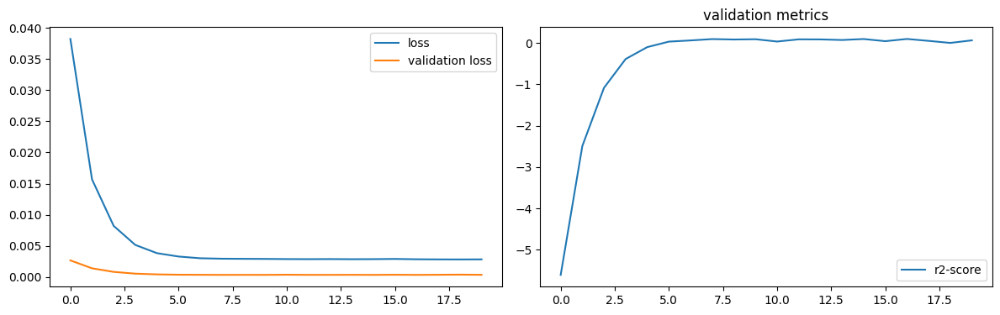

num of dropped: 69
Test: loss: 0.024283453822135925, avg metrics: (0.10420330762863159,)
dropping feature: (2, 'neuron4')


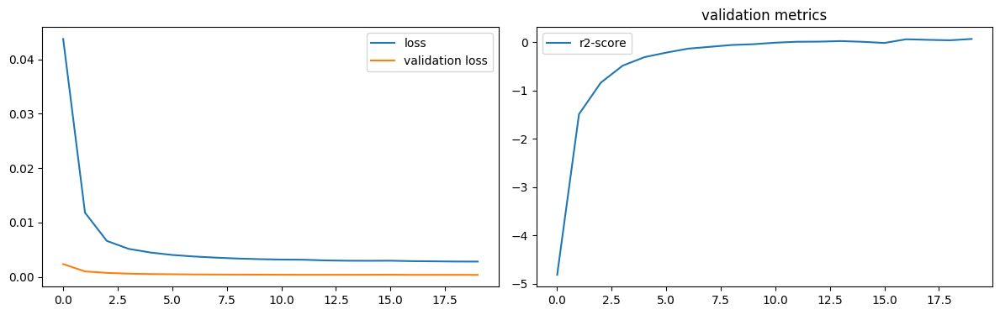

num of dropped: 70
Test: loss: 0.023935144767165184, avg metrics: (0.07009155750274658,)
dropping feature: (13, 'neuron48')


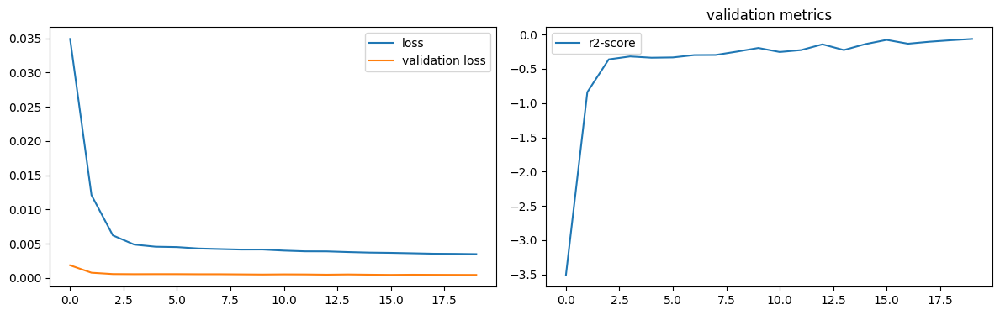

num of dropped: 71
Test: loss: 0.029444385319948196, avg metrics: (0.11260172128677368,)
dropping feature: (25, 'neuron89')


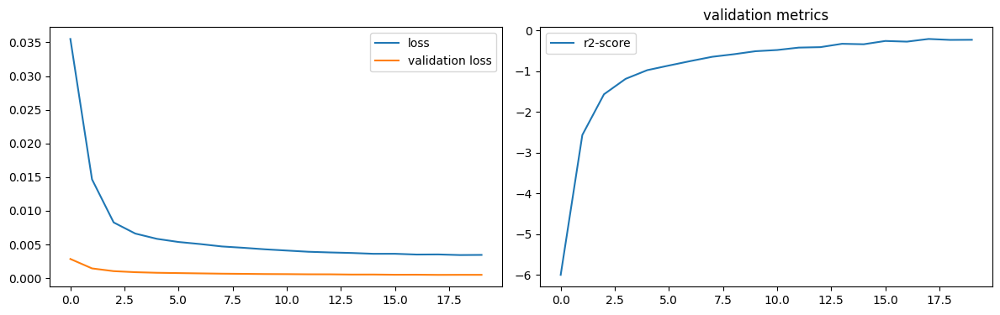

num of dropped: 72
Test: loss: 0.028262406587600708, avg metrics: (0.08466687202453613,)
dropping feature: (26, 'neuron95')


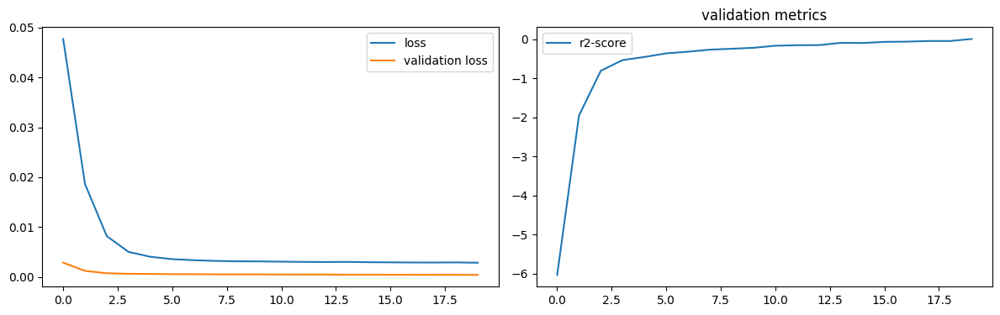

num of dropped: 73
Test: loss: 0.02475931867957115, avg metrics: (0.03987685441970825,)
dropping feature: (12, 'neuron46')


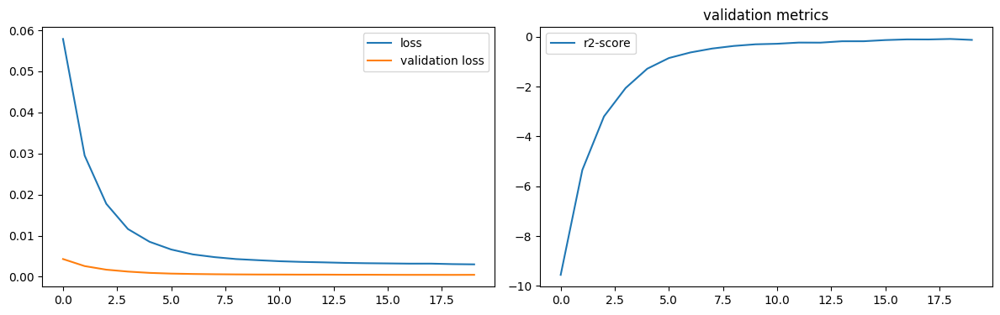

num of dropped: 74
Test: loss: 0.023327548056840897, avg metrics: (0.15467264652252197,)
dropping feature: (15, 'neuron56')


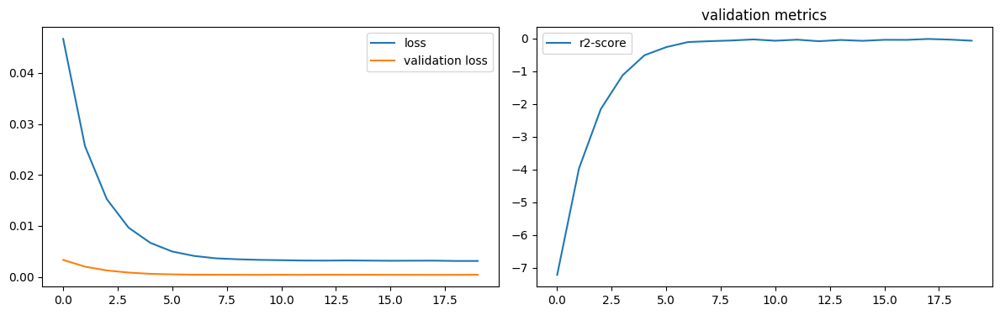

num of dropped: 75
Test: loss: 0.02561311423778534, avg metrics: (0.0013280153274536134,)
dropping feature: (14, 'neuron54')


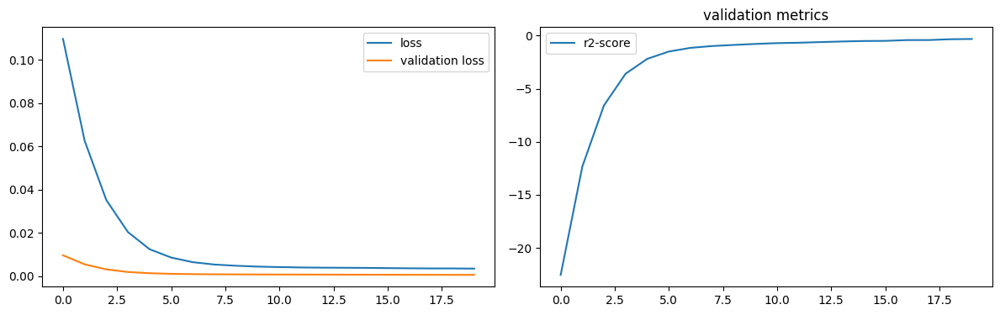

num of dropped: 76
Test: loss: 0.027584746479988098, avg metrics: (0.06623255014419556,)
dropping feature: (16, 'neuron68')


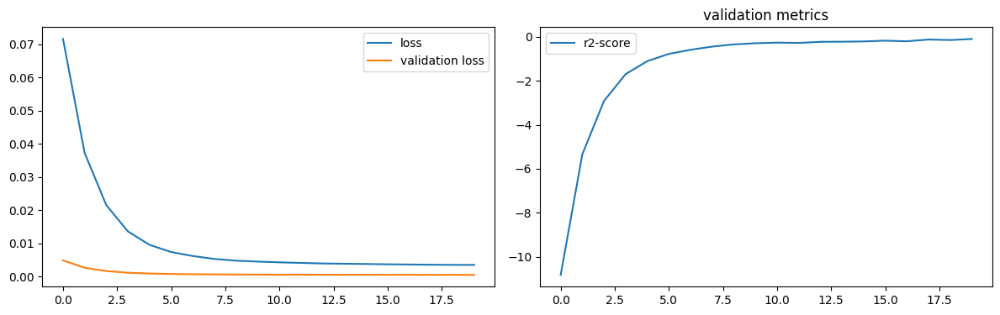

num of dropped: 77
Test: loss: 0.02634933590888977, avg metrics: (0.030248737335205077,)
dropping feature: (11, 'neuron42')


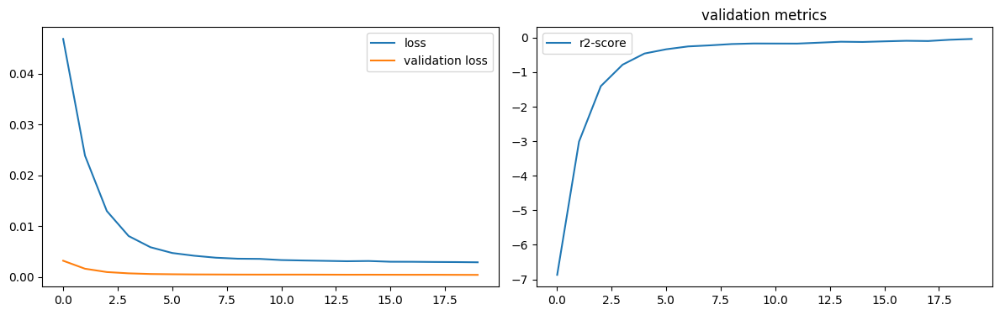

num of dropped: 78
Test: loss: 0.024448879063129425, avg metrics: (0.05948265790939331,)
dropping feature: (15, 'neuron76')


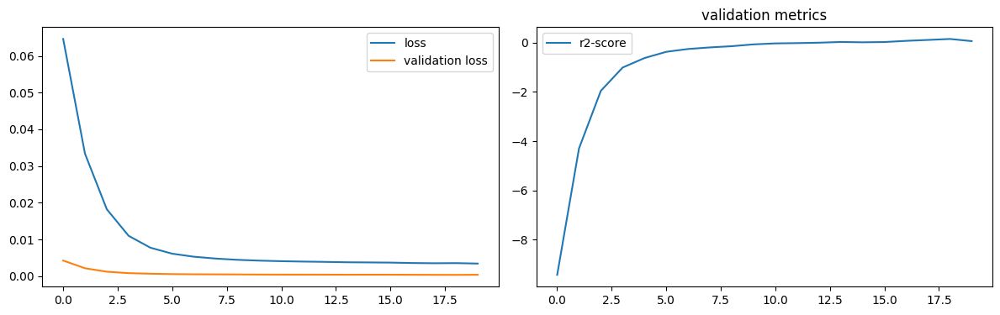

num of dropped: 79
Test: loss: 0.029211552813649178, avg metrics: (0.012459135055541993,)
dropping feature: (2, 'neuron7')


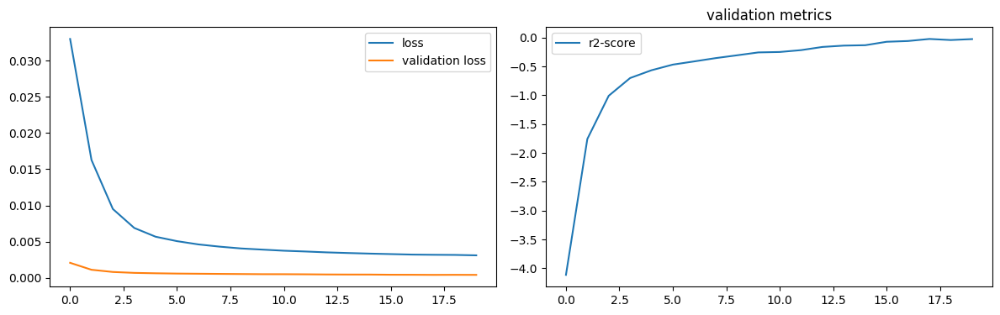

num of dropped: 80
Test: loss: 0.02558058686554432, avg metrics: (0.04800518751144409,)
dropping feature: (10, 'neuron51')


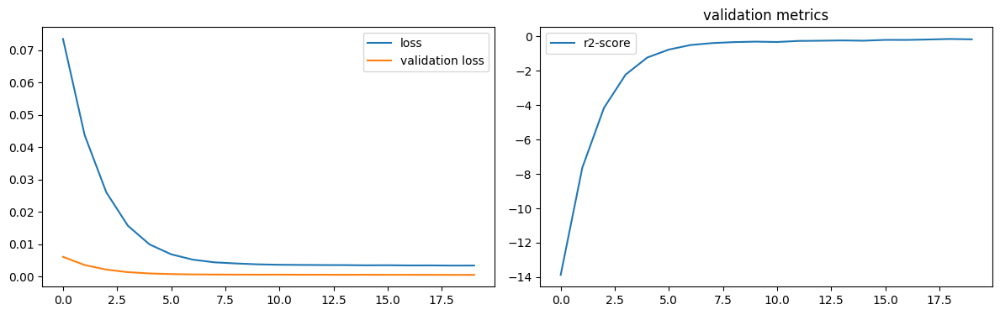

num of dropped: 81
Test: loss: 0.024663398042321205, avg metrics: (0.05371701717376709,)
dropping feature: (17, 'neuron90')


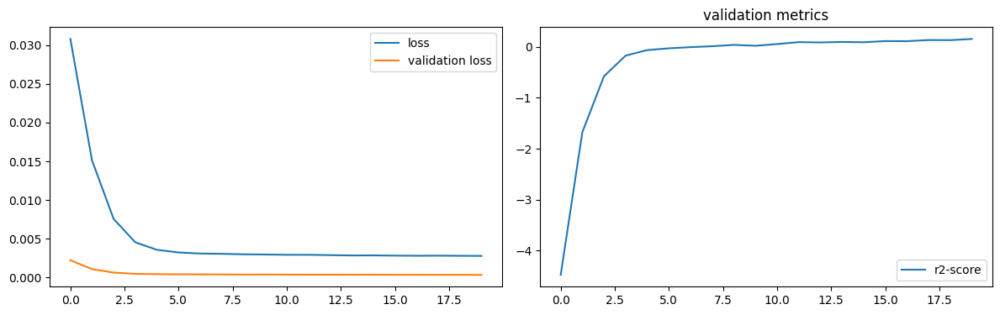

num of dropped: 82
Test: loss: 0.02406625635921955, avg metrics: (0.0905897855758667,)
dropping feature: (7, 'neuron37')


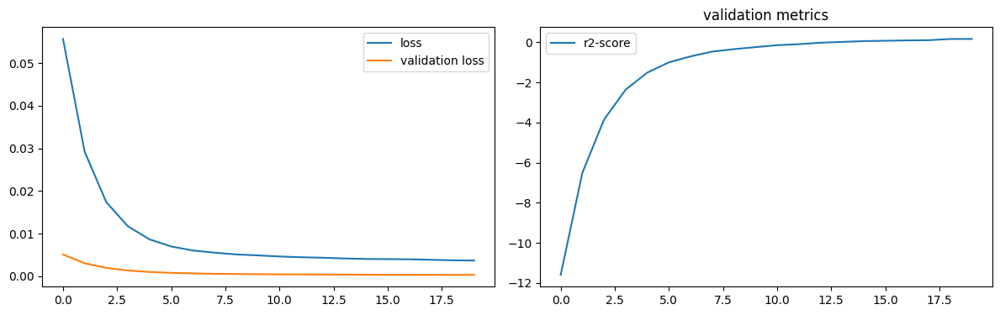

num of dropped: 83
Test: loss: 0.030673403292894363, avg metrics: (0.07142765522003174,)
dropping feature: (9, 'neuron53')


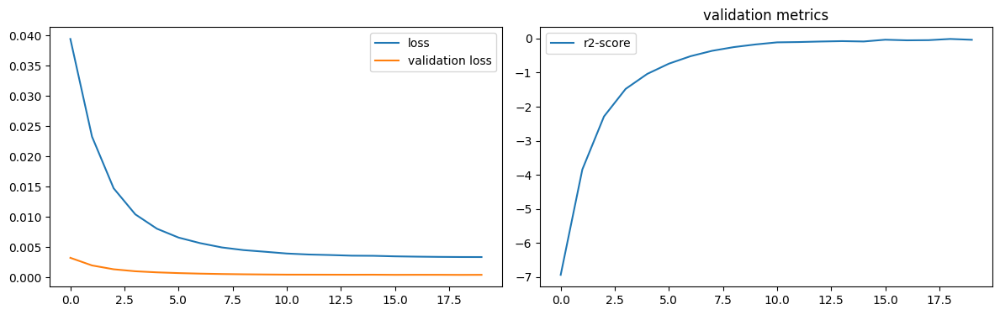

num of dropped: 84
Test: loss: 0.029449287801980972, avg metrics: (-0.005257296562194824,)
dropping feature: (15, 'neuron97')


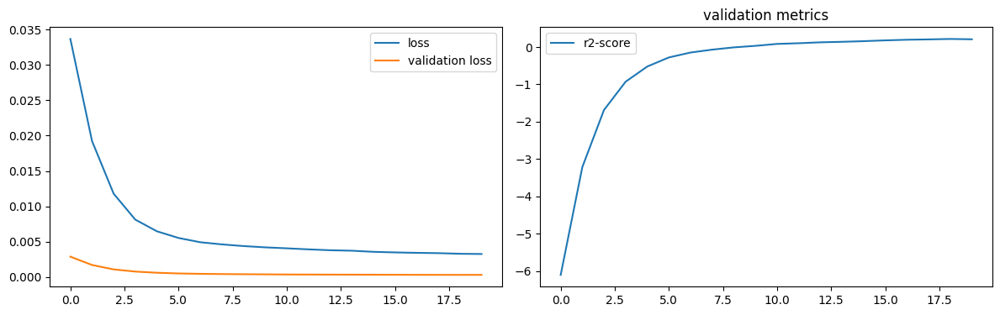

num of dropped: 85
Test: loss: 0.02359377034008503, avg metrics: (-0.08251160383224487,)
dropping feature: (11, 'neuron78')


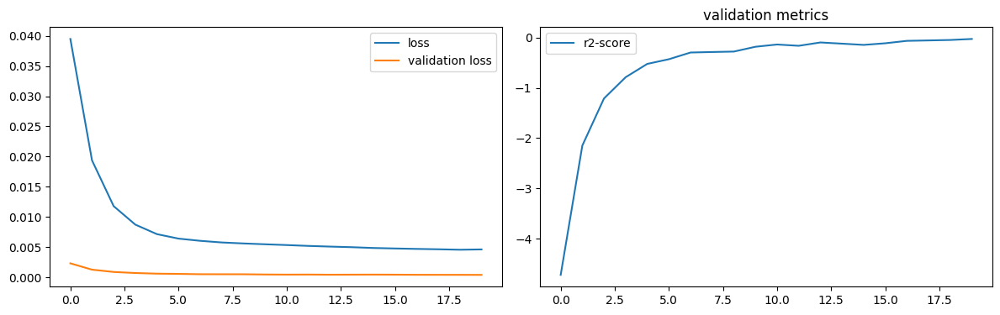

num of dropped: 86
Test: loss: 0.04221005737781525, avg metrics: (-0.10241715908050537,)
dropping feature: (7, 'neuron40')


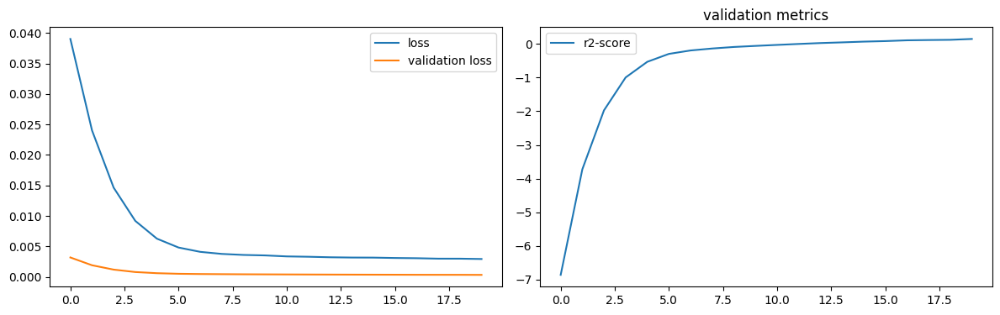

num of dropped: 87
Test: loss: 0.023151732981204987, avg metrics: (0.04267385005950928,)
dropping feature: (9, 'neuron66')


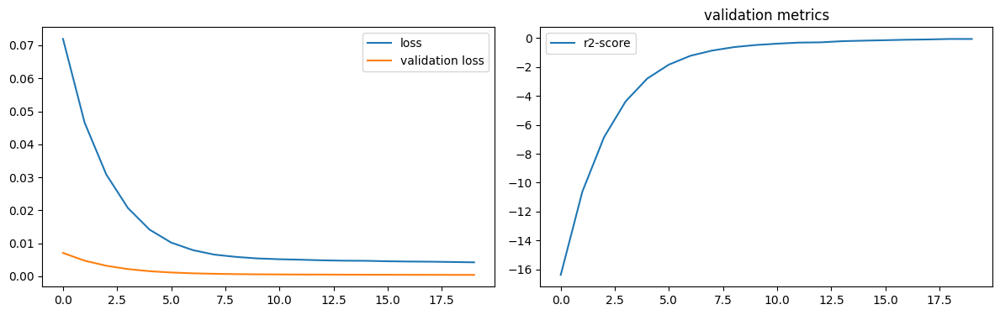

num of dropped: 88
Test: loss: 0.0373794361948967, avg metrics: (0.047935104370117186,)
dropping feature: (11, 'neuron88')


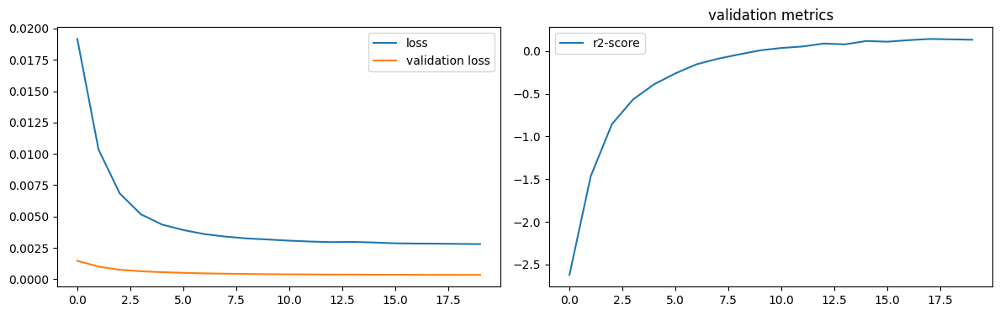

num of dropped: 89
Test: loss: 0.022559428587555885, avg metrics: (0.029653656482696533,)
dropping feature: (6, 'neuron31')


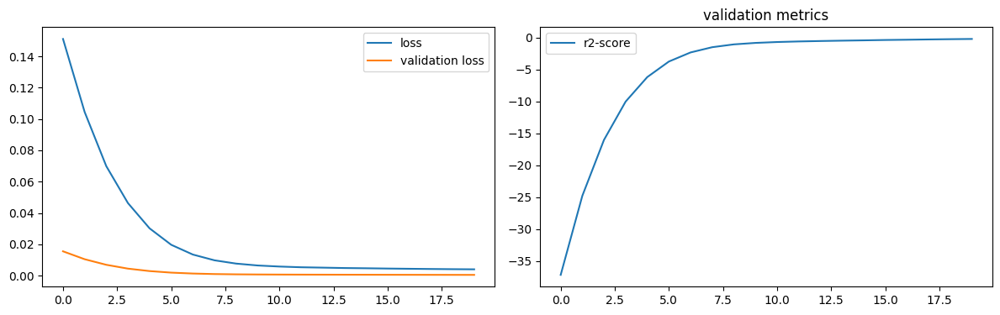

num of dropped: 90
Test: loss: 0.03272250294685364, avg metrics: (-0.10695856809616089,)
dropping feature: (4, 'neuron24')


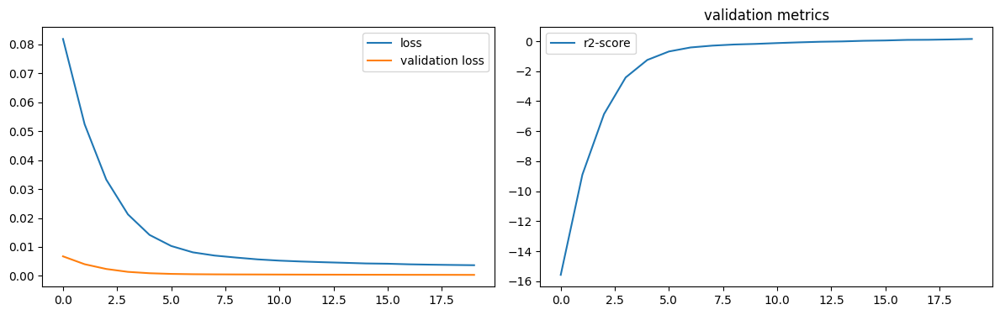

num of dropped: 91
Test: loss: 0.02805434912443161, avg metrics: (-0.14224822521209718,)
dropping feature: (7, 'neuron79')


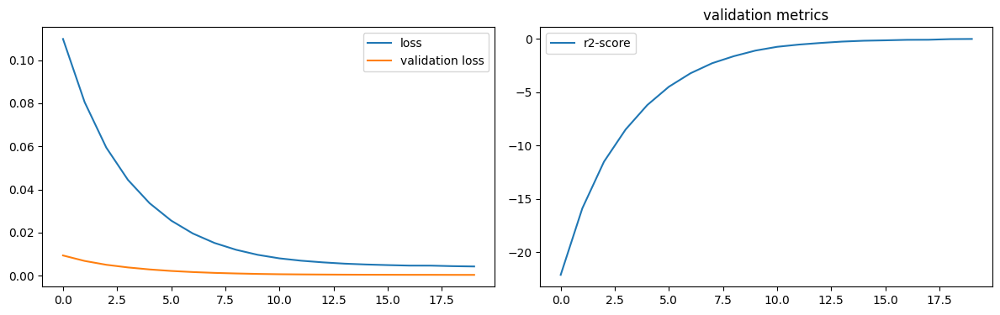

num of dropped: 92
Test: loss: 0.03226061910390854, avg metrics: (-0.2679048180580139,)
dropping feature: (5, 'neuron41')


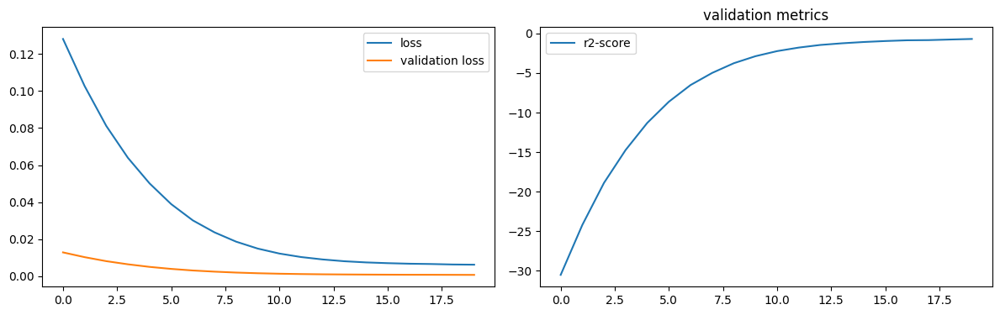

num of dropped: 93
Test: loss: 0.047515202313661575, avg metrics: (-0.601368248462677,)
dropping feature: (2, 'neuron8')


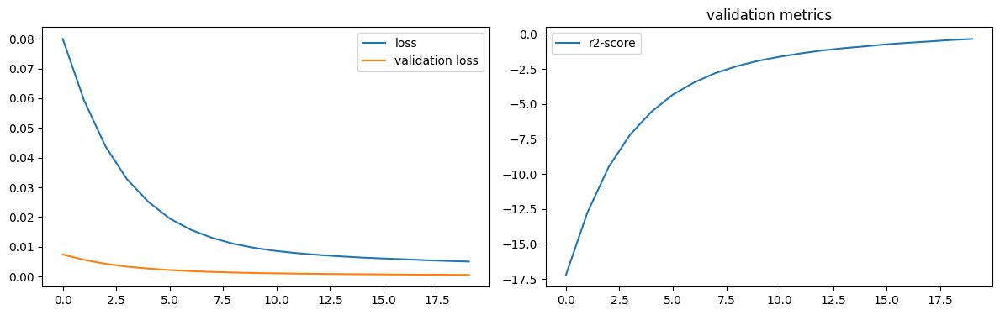

num of dropped: 94
Test: loss: 0.039279814809560776, avg metrics: (-0.2629125237464905,)
dropping feature: (5, 'neuron87')


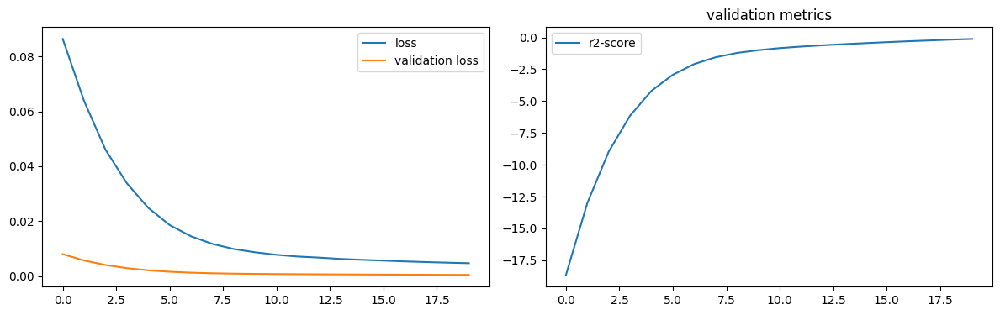

num of dropped: 95
Test: loss: 0.031079959124326706, avg metrics: (-0.07583262920379638,)
dropping feature: (2, 'neuron17')


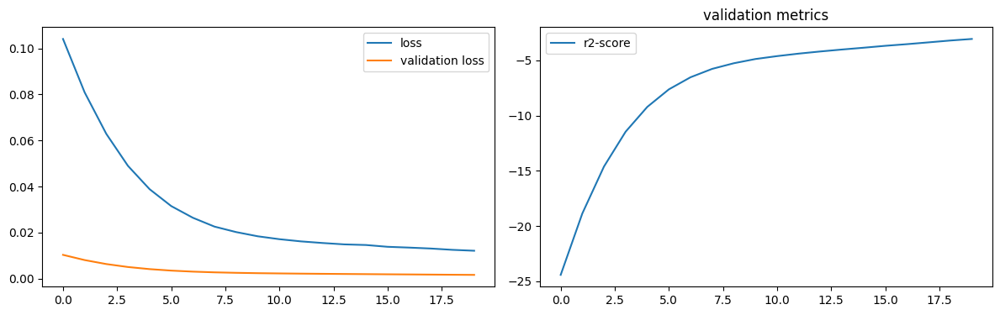

num of dropped: 96
Test: loss: 0.0946030542254448, avg metrics: (-0.6875668287277221,)
dropping feature: (2, 'neuron27')


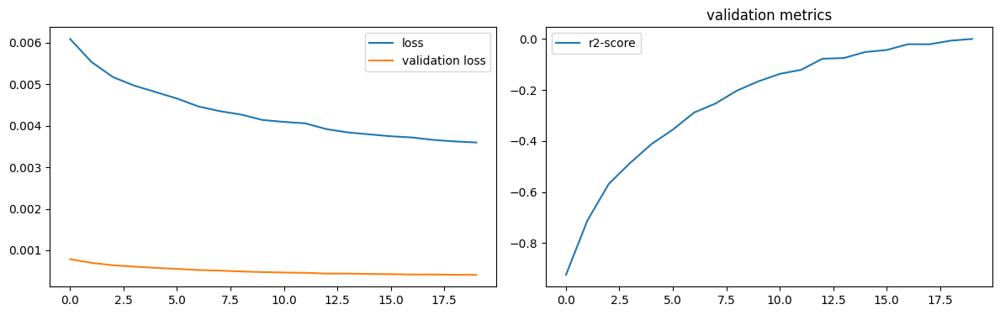

num of dropped: 97
Test: loss: 0.026534533128142357, avg metrics: (-1.537007486820221,)
dropping feature: (0, 'neuron1')


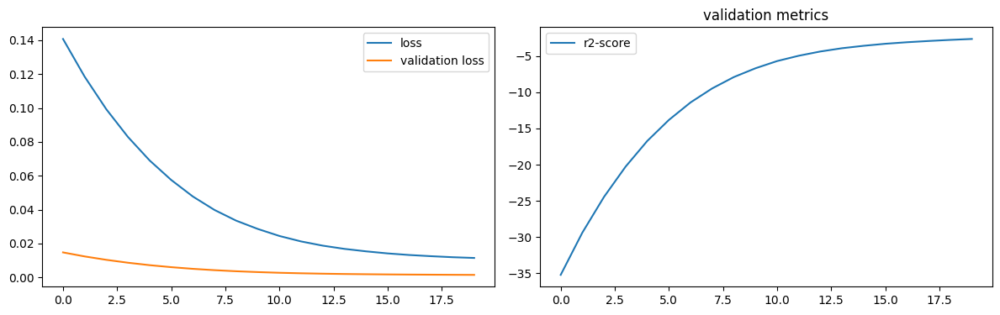

num of dropped: 98
Test: loss: 0.08065912872552872, avg metrics: (-2.150286149978638,)
dropping feature: (1, 'neuron61')


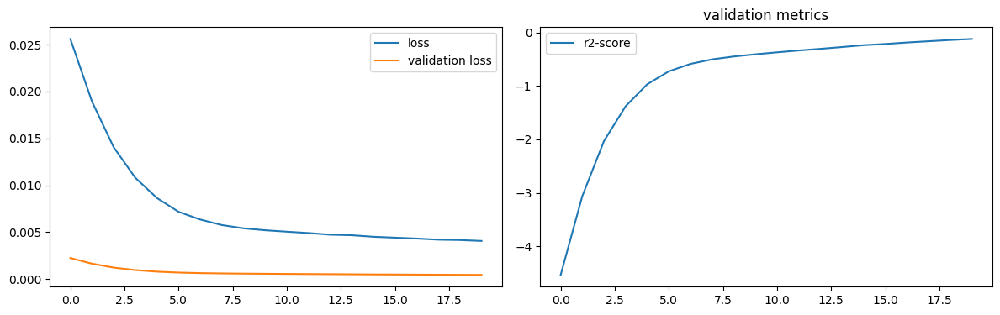

num of dropped: 99
Test: loss: 0.032326873391866684, avg metrics: (-0.4713554382324219,)


In [37]:
torch.manual_seed(2024)

headers = [f"neuron{i}" for i in range(100)]


def model_factory(size):
    model = StudentsNN(1, (1, size))
    model.layer1 = nn.Identity()
    model.layer2 = nn.Identity()
    return model


test_metrics, dropped, models = prune(
    datasets, headers, analyze_dgsm,
    model_factory, optimizer_factory, criterion, score_outputs, 20,
    labels, "", None
)

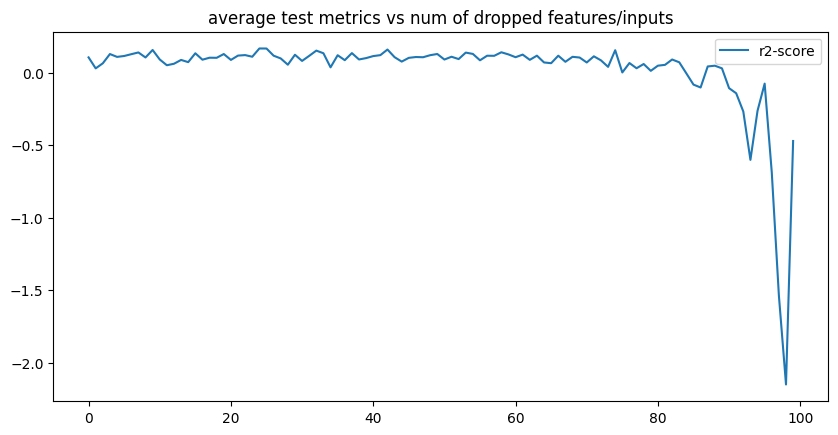

In [38]:
plot_dropping_metrics(test_metrics, labels)

In [39]:
num_drop_neurons = 82

save_models("students", "fast-layer3", models, dropped)

reduced_datasets, reduced_headers = reduce_datasets(datasets, headers, dropped, num_drop_neurons)
layer = models[num_drop_neurons].out

best_model.out = layer
best_model.layer2[0] = reduce_linear(best_model.layer2[0], dropped, num_drop_neurons)
best_model.layer2[1] = nn.BatchNorm1d(100 - num_drop_neurons)

features left [18]:  ['neuron1', 'neuron2', 'neuron8', 'neuron17', 'neuron24', 'neuron27', 'neuron31', 'neuron37', 'neuron40', 'neuron41', 'neuron53', 'neuron61', 'neuron66', 'neuron78', 'neuron79', 'neuron87', 'neuron88', 'neuron97']


### pruned

In [40]:
best_model

StudentsNN(
  (layer1): Sequential(
    (0): Linear(in_features=5, out_features=4, bias=True)
    (1): BatchNorm1d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (layer2): Sequential(
    (0): Linear(in_features=4, out_features=18, bias=True)
    (1): BatchNorm1d(18, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (out): Linear(in_features=18, out_features=1, bias=True)
)

In [41]:
best_model.eval()
with torch.no_grad():
    inputs, targets = fast_dataset["test"][:]
    outputs = best_model(inputs)

    test_metrics = score_outputs(outputs, targets)

print(f"test {labels}: {test_metrics}")

test r2-score: (-1.2240445613861084,)


test: r2-score: (0.19654834270477295,)


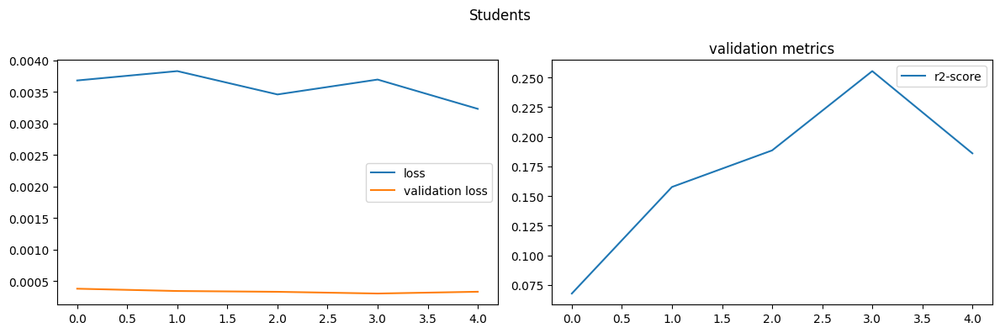

In [42]:
optimizer = optimizer_factory(best_model)
metrics = model_train(fast_dataset, best_model, optimizer, criterion, score_outputs, 5)

best_model.eval()
with torch.no_grad():
    inputs, targets = fast_dataset["test"][:]
    outputs = best_model(inputs)

    test_metrics = score_outputs(outputs, targets)

print(f"test: {labels}: {test_metrics}")
plot_metrics('Students', metrics, labels)

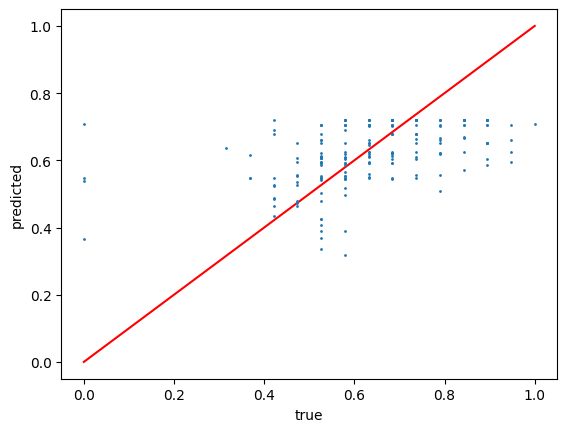

In [43]:
plt.plot([0, 1], [0, 1], c='r')
plt.plot(datasets["test"].tensors[1], outputs, '.', ms=2)
plt.xlabel("true")
plt.ylabel("predicted")
plt.show()

In [44]:
save_models("students", "fast-prunned", [best_model], None)